In [3]:
import os
import csv
import optuna
import numpy as np
import pandas as pd
from tensorflow import keras
from tensorflow.keras.optimizers import Adam, RMSprop, SGD
import tensorflow as tf
from keras.models import Sequential
from keras.layers import Input, LSTM, Dense, Activation, Dropout
from pandas import DataFrame
from pandas import Series
from pandas import concat
from pandas import read_csv
from datetime import datetime
from sklearn.metrics import mean_squared_error
from sklearn.preprocessing import MinMaxScaler
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import KFold
from sklearn.model_selection import train_test_split
from sklearn.model_selection import cross_val_score
from math import sqrt
from matplotlib import pyplot as plt
from matplotlib.patches import Patch
from numpy import array
import keras.backend as K
import itertools
#!pip install pydot

# date-time parsing function for loading the dataset
def parser(x):
    return datetime.strptime('190'+x, '%Y-%m')
    
def rmse (y_true, y_pred):
    return K.sqrt(K.mean(K.square(y_pred - y_true)))
    
def mape (y_true, y_pred):
    return 100*K.mean(K.sqrt(K.square(y_true - y_pred))/y_true)
    
def pearson (y_true, y_pred):
    return (K.square(K.mean((y_true - K.mean(y_true))*(y_pred - K.mean(y_pred)))))/(K.mean(K.square(y_true - K.mean(y_true)))*K.mean(K.square(y_pred - K.mean(y_pred))))
    
# convert time series into a supervised learning problem
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
# convert time series into a supervised learning problem
def series_to_supervised(data, n_in=1, n_out=1, dropnan=True):

    n_vars = 1 if type(data) is list else data.shape[1]
    cols, names = list(), list()
    df = DataFrame(data)
    # input sequence (t-n, ... t-1)
    for i in range(n_in, 0, -1):
    	cols.append(df.shift(i))
    	names += [('var%d(t-%d)' % (j+1, i)) for j in range(n_vars)]
    # forecast sequence (t, t+1, ... t+n)
    for i in range(0, n_out):
        cols.append(df[0].shift(-i)) # df[0] for temperature
        if i == 0:
            names += [('var%d(t)' % (1))] # % (1) for temperature
        else:            
            names += [('var%d(t+%d)' % (1, i))] # % (1) for temperature
    
    # put it all together
    agg = concat(cols, axis=1)

    if dropnan:
        #Drop rows containing NaN
        agg.dropna(inplace=True)

    agg.columns = names

    return agg
     
# create a differenced series
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def difference(dataset, interval=1):
    diff = list()
    for i in range(interval, len(dataset)):
        value = dataset[i] - dataset[i - interval]
        diff.append(value)
    return Series(diff)
     
# transform series into training sets for supervised learning
def prepare_training_data(data, n_lag, n_seq, n_time_steps):
    
    #Prepare data for time series forecasting.
        
    #Parameters:
    #x (array-like): Input features.
    #y (array-like): Target values.
    #n_test (int): Number of test samples (rows).
    #n_lag (int): Number of lag observations.
    #n_seq (int): Number of sequence observations.
    #n_train (int): Number of training samples (rows).
        
    #Returns:
    #tuple: Training and test datasets.
    
    n_vars = len(data[0][0])

    # Each weather station has 227 time steps (the first 180 have no nan values)
    # Loop through data, grabbing one weather station (ws) at a time, 
    # differencing on each ws and separating by training (first 226-n_lag-n_seq-n_test time steps) 
    # and testing (n_test time steps) to scale data on training only.
    # We then recombine the training and testing datasets to change each ws to a supervised learning problem by taking all the first 180 time steps for all 12 predictors
    # and changing these to (t-n_lag) to (t-1) since we lose one row through differencing. We then shift forward only one dependent variable (temperature or specific humidity)
    # for time steps t to (t+n_seq)


    diff_values = []
    
    for ws in range(84):
        
        # transform data to be stationary
        diff_series = difference(data[ws], 1)
        for i in range(len(diff_series)):
            diff_values_row = []
            for j in range(len(diff_series[0])):
                diff_values_row.append(diff_series[i][j])
            diff_values.append(diff_values_row)
    
    # rescale values to 0, 1
    scaler_all_features =  MinMaxScaler(feature_range=(0, 1))
    scaler =  MinMaxScaler(feature_range=(0, 1))
    train_scaled_values = scaler_all_features.fit_transform(diff_values)
    response_train_values = []
    for i in range(len(diff_values)):
        response_train_values.append(diff_values[i][0]) # Uses first column (temperatures) as response variable
    response_train_values = np.array(response_train_values)
    response_train_values = response_train_values.reshape(len(response_train_values), 1)

    # Fit the scaler for just the response variable for use later when forecasting
    response_scaled_values = scaler.fit_transform(response_train_values) 
    scaled_values = scaler_all_features.transform(diff_values)

    train = []

    # Transform each weather station as a separate "batch"
    for ws in range(84):
        # transform into supervised learning problem X, y
        first = (n_time_steps-1)*ws
        last = (n_time_steps-1)*ws+(n_time_steps-2)
        scaled_values_batch = scaled_values[first:last]
        supervised = series_to_supervised(scaled_values_batch, n_lag, n_seq)
        supervised_values = supervised.values
        train.append([supervised_values])
    
    return scaler, scaler_all_features, train

# transform series into testing and validation sets for supervised learning
def prepare_testing_and_validation_data(data, n_lag, n_seq, n_time_steps, scaler_all_features):
    
    #Prepare data for time series forecasting.
        
    #Parameters:
    #x (array-like): Input features.
    #y (array-like): Target values.
    #n_test (int): Number of test samples (rows).
    #n_lag (int): Number of lag observations.
    #n_seq (int): Number of sequence observations.
    #n_train (int): Number of training samples (rows).
        
    #Returns:
    #tuple: Training and test datasets.
    
    n_vars = len(data[0][0])

    # Each weather station has 227 time steps (the first 180 have no nan values)
    # Loop through data, grabbing one weather station (ws) at a time, 
    # differencing on each ws and separating by training (first 226-n_lag-n_seq-n_test time steps) 
    # and testing (n_test time steps) to scale data on training only.
    # We then recombine the training and testing datasets to change each ws to a supervised learning problem by taking all the first 180 time steps for all 12 predictors
    # and changing these to (t-n_lag) to (t-1) since we lose one row through differencing. We then shift forward only one dependent variable (temperature or specific humidity)
    # for time steps t to (t+n_seq)


    diff_values = []
    
    for ws in range(21):
        
        # transform data to be stationary
        diff_series = difference(data[ws], 1)
        for i in range(len(diff_series)):
            diff_values_row = []
            for j in range(len(diff_series[0])):
                diff_values_row.append(diff_series[i][j])
            diff_values.append(diff_values_row)

    # rescale values to 0, 1
    scaled_values = scaler_all_features.transform(diff_values)

    validation = []
    test = []

    # Transform each weather station as a separate "batch"
    for ws in range(21):
        # transform into supervised learning problem X, y
        first = (n_time_steps-1)*ws
        last = (n_time_steps-1)*ws+(n_time_steps-2)
        scaled_values_batch = scaled_values[first:last]
        supervised = series_to_supervised(scaled_values_batch, n_lag, n_seq)
        supervised_values = supervised.values
        # training/test/validation split is 80%/10%/10%
        if ws < 11:
            test.append([supervised_values])
        else:
            validation.append([supervised_values])
    
    return validation, test
    
def plot_kfold(cv, X, y, ax, n_splits, xlim_max=105):
    
    #Plots the indices for a cross-validation object.
    #Taken from https://www.geeksforgeeks.org/cross-validation-using-k-fold-with-scikit-learn/
    
    #Parameters:
    #cv: Cross-validation object
    #X: Feature set
    #y: Target variable
    #ax: Matplotlib axis object
    #n_splits: Number of folds in the cross-validation
    #xlim_max: Maximum limit for the x-axis
        
    # Set color map for the plot
    cmap_cv = plt.cm.coolwarm
    cv_split = cv.split(X=X, y=y)
        
    for i_split, (train_idx, test_idx) in enumerate(cv_split):
        # Create an array of NaNs and fill in training/testing indices
        indices = np.full(len(X), np.nan)
        indices[test_idx], indices[train_idx] = 1, 0
            
        # Plot the training and testing indices
        ax_x = range(len(indices))
        ax_y = [i_split + 0.5] * len(indices)
        ax.scatter(ax_x, ax_y, c=indices, marker="_", 
                   lw=10, cmap=cmap_cv, vmin=-0.2, vmax=1.2)
    
        # Set y-ticks and labels
        y_ticks = np.arange(n_splits) + 0.5
        ax.set(yticks=y_ticks, yticklabels=range(n_splits),
               xlabel="Weather Station index (file_id)", ylabel="Fold",
               ylim=[n_splits, -0.2], xlim=[0, xlim_max])
    
        # Set plot title and create legend
        ax.set_title("KFold", fontsize=14)
        legend_patches = [Patch(color=cmap_cv(0.8), label="Testing set"), 
                          Patch(color=cmap_cv(0.02), label="Training set")]
        ax.legend(handles=legend_patches, loc=(1.03, 0.8))
    
#Main

#Configure
n_seq = 60
if n_seq > 46:
    n_lag = 179 - n_seq + 46
else:
    n_lag = 179
n_time_steps = 227
n_test = 1

print("Model Parameters:")
print("n_lag (number of input time steps): "+str(n_lag))
print("n_seq (number of output/future prediction time steps): "+str(n_seq))

# Create 2D array with file_ids to use for sample creation
array = np.array([
    6501, 6541, 6640, 6668, 6678, 
    6687, 6697, 6714, 6744, 6772, 
    6783, 6840, 6844, 6854, 6870, 
    6891, 6895, 6899, 6901, 6909, 
    6929, 6950, 6963, 6969, 6994, 
    7032, 7057, 7094, 7095, 7100, 
    7108, 7116, 7119, 7131, 7139, 
    7152, 7155, 7156, 7182, 7193, 
    7202, 7239, 7280, 7286, 7287, 
    7311, 7321, 7329, 7347, 7350, 
    7354, 7357, 7361, 7414, 7423, 
    7424, 7432, 7463, 7482, 7489, 
    7528, 7531, 7534, 7538, 7549, 
    7553, 7555, 7562, 7571, 7573, 
    7574, 7575, 7585, 7599, 7603, 
    7606, 7622, 7652, 7671, 7704, 
    7786, 7805, 7816, 7838, 7861, 
    7862, 7863, 7870, 7892, 7907, 
    7938, 7962, 7979, 7987, 7999, 
    8000, 8034, 8083, 8120, 8133, 
    8184, 8186, 8247, 8248, 9858])
    
#Create arrays holding the 5-fold cross-validation indices gathered for consistency across models
train_array = []
test_array = []
    
train_array.append([1, 2, 3, 5, 6, 7, 8, 9, 11, 13, 14, 15, 16, 17, 19, 20, 21, 22, 
                        23, 24, 25, 27, 28, 29, 32, 34, 35, 36, 37, 38, 39, 40, 41, 42, 
                        43, 44, 46, 48, 49, 50, 51, 52, 54, 55, 56, 57, 58, 59, 60, 61, 
                        62, 63, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 78, 79, 81, 
                        82, 83, 84, 85, 86, 87, 88, 90, 91, 92, 93, 95, 97, 98, 100, 101, 102, 103])
test_array.append([0, 4, 10, 12, 18, 26, 30, 31, 33, 45, 47, 53, 64, 65, 77, 80, 89, 94, 96, 99, 104])
    
train_array.append([0, 1, 2, 3, 4, 6, 7, 8, 10, 12, 13, 14, 17, 18, 19, 20, 21, 23, 
                        24, 25, 26, 27, 29, 30, 31, 32, 33, 34, 36, 37, 38, 41, 43, 45, 
                        46, 47, 48, 49, 50, 51, 52, 53, 54, 57, 58, 59, 60, 61, 63, 64, 
                        65, 66, 67, 68, 69, 70, 71, 73, 74, 75, 77, 80, 81, 82, 83, 84, 
                        86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 104])
test_array.append([5, 9, 11, 15, 16, 22, 28, 35, 39, 40, 42, 44, 55, 56, 62, 72, 76, 78, 79, 85, 103])
    
train_array.append([0, 1, 2, 4, 5, 9, 10, 11, 12, 14, 15, 16, 18, 20, 21, 22, 23, 26, 
                    28, 29, 30, 31, 32, 33, 35, 36, 37, 39, 40, 41, 42, 44, 45, 46, 47, 
                    48, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 
                    70, 71, 72, 74, 75, 76, 77, 78, 79, 80, 82, 83, 85, 86, 87, 88, 89, 
                    90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104])
test_array.append([3, 6, 7, 8, 13, 17, 19, 24, 25, 27, 34, 38, 43, 49, 66, 67, 68, 69, 73, 81, 84])
    
train_array.append([0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 
                        18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 33, 34, 
                        35, 37, 38, 39, 40, 42, 43, 44, 45, 47, 49, 51, 52, 53, 55, 56, 
                        60, 62, 64, 65, 66, 67, 68, 69, 71, 72, 73, 74, 76, 77, 78, 79, 
                        80, 81, 82, 84, 85, 86, 87, 88, 89, 92, 93, 94, 95, 96, 99, 102, 103, 104])
test_array.append([32, 36, 41, 46, 48, 50, 54, 57, 58, 59, 61, 63, 70, 75, 83, 90, 91, 97, 98, 100, 101])
    
train_array.append([0, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 15, 16, 17, 18, 19, 22,
                        24, 25, 26, 27, 28, 30, 31, 32, 33, 34, 35, 36, 38, 39, 40, 41, 
                        42, 43, 44, 45, 46, 47, 48, 49, 50, 53, 54, 55, 56, 57, 58, 59, 
                        61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 72, 73, 75, 76, 77, 78, 
                        79, 80, 81, 83, 84, 85, 89, 90, 91, 94, 96, 97, 98, 99, 100, 101, 103, 104])
test_array.append([1, 2, 14, 20, 21, 23, 29, 37, 51, 52, 60, 71, 74, 82, 86, 87, 88, 92, 93, 95, 102])
    
# Equations for three Principal Components from PCA using response variables combined with other predictors
#PC1=-0.0002714X1+0.02612X2+0.03858X3-0.007658X4+0.001592X5-0.02087X6+0.8564X7-0.1468X8+0.01192X9-0.0001049X10+0.01913X11+0.02076X12
#PC2=0.0003944X1+0.002204X2+0.01052X3+0.3248X4-0.0009976X5-0.04421X6+2.3406X7+0.06103X8+0.08841X9+0.00009018X10+0.05678X11-0.002022X12
#PC3=-0.00007998X1-0.0006124X2-0.001063X3-0.01855X4+0.00001956X5+0.01170X6+0.6076X7+0.4664X8-0.002995X9+0.008185X10+0.8815X11-0.0004730X12
    
# Equations for three Principal Components from PCA omitting both response variables,
#PC-1=-0.0004514X1+0.03194X2-0.04343X3+0.002243X4-0.02252X5+0.9877X6-0.2265X7+0.006144X8-0.0001488X9+0.02943X10
#PC-2=0.0001702X1+0.005484X2+0.2057X3-0.0003188X4-0.02584X5+1.6963X6-0.05890X7+0.05809X8+1.9748X9+0.03686X10
#PC-3=-0.00006323X1-0.001180X2-0.02384X3-0.00002833X4+0.01170X5+0.5204X6+0.4791X7-0.004318X8+0.008271X9+0.8765X10
    
# Get the current working directory 
current_directory = os.getcwd() 
    
# Print the current working directory 
print(current_directory)
    
# Define the directory containing the files 
path = current_directory+"\\Modeling\\"
print(path)
    
filename = path + 'Final_Monthly_Dataset.csv'
    
# load dataset
df = read_csv(filename, header=0, parse_dates=[0], index_col=0, date_format='%Y-%m')

print(df)
    
df = df.rename(columns={'Unnamed: 0' : 'indices'})
    
#Remove unused columns
df = df.drop(['Day', 'vapor_pressure'], axis=1)
    
# Round numbers in columns to reasonable precision,
df['temperatures'] = np.round(df['temperatures'], 2)
df['slp'] = np.round(df['slp'], 2)
df['wet_bulb_temperature'] = np.round(df['wet_bulb_temperature'], 2)
df['specific_humidity'] = np.round(df['specific_humidity'], 2)
df['GHI'] = np.round(df['GHI'], 2)
df['PRCP'] = np.round(df['PRCP'], 2)
df['SNDP'] = np.round(df['SNDP'], 2)
df['solar_activity'] = np.round(df['solar_activity'], 2)
df['ONI'] = np.round(df['ONI'], 2)
df['water'] = np.round(df['water'], 0)
df['region'] = np.round(df['region'], 0)

#Since the NaN values of GHI are gone which is used in data preparation, simulate these in solar activity instead
df['solar_activity'].loc[df['Year'] > 2020] = np.nan
    
df_trimmed = df[df['file_id'] != 7533] # Remove file_id 7533 so there are 105 weather stations for 5-fold CV
df_trimmed = df_trimmed.drop(['Year', 'Month', 'date', 'latitude', 'longitude', 'elevation'], axis=1)

#Test model and accuracy when solar activity is removed as a predictor
df_trimmed = df_trimmed.drop(['GHI'], axis=1)

n_vars = df_trimmed.shape[1]-1
    
X = []
y = []
    
for i in array:
    add_to_X = [] # create list to store each column to add to X
    new_df = df_trimmed[df_trimmed['file_id'] == i].drop(['file_id'], axis=1)
    #new_df = new_df.iloc[:180, :]
    add_to_y = []
    for j in range(new_df.shape[0]):
        add_to_y.append(new_df['temperatures'].iloc[j])
    y.append(add_to_y)
    #new_df = new_df.drop(['temperatures'], axis=1)
    columns_list = new_df.columns.tolist()
    for j in range(new_df.shape[0]):
        l=0
        new_row = []
        for m in columns_list:
            new_row.append(new_df.iloc[j, l])
            l += 1
        add_to_X.append(new_row)
    X.append(add_to_X)
    
#Perform k-fold cross-validation
#Taken from: https://www.geeksforgeeks.org/cross-validation-using-k-fold-with-scikit-learn/
    
#k = 5  # Number of folds
#kf = KFold(n_splits=k, shuffle=True, random_state=42)
    
#for i, (train_index, test_index) in enumerate(kf.split(X)):
#    print(f"Fold {i}:")
#    print(f"  Training dataset index: {train_index}")
#    print(f"  Test dataset index: {test_index}")
    
#for train_indices, test_indices in kf.split(X):
#    print('Train: %s | test: %s' % (train_indices, test_indices))
    
# Create figure and axis
#fig, ax = plt.subplots(figsize=(6, 3))
#plot_kfold(kf, X, y, ax, k)
#plt.tight_layout()
#fig.subplots_adjust(right=0.6)
    
#Create train and test sets for each cross-validation split
train_X = []
train_y = []
val_X = []
val_y = []
for i in range(5):
    print(f"Fold {i+1}")
    #Add each corresponding sample for each entry of train index 
    train_X_rows = [] # Stores all the samples for one fold of train_X
    train_y_rows = [] # Stores all the samples for one fold of train_y
    for j in train_array[i]:
        train_X_rows.append(X[j])
        train_y_rows.append(y[j])
    # Stores one fold of train dataset
    train_X.append(train_X_rows)
    train_y.append(train_y_rows)
    #Add each corresponding sample for each entry of the validation index 
    val_X_rows = [] # Stores all the samples for one fold of val_X
    val_y_rows = [] # Stores all the samples for one fold of val_y
    for j in test_array[i]: 
            val_X_rows.append(X[j])
            val_y_rows.append(y[j])
    # Stores one fold of validation dataset
    val_X.append(val_X_rows)
    val_y.append(val_y_rows) 
    
#Convert 3D arrays to DataFrames
df_X = []
df_y = []
val_df_X = []
val_df_y = []
dataset = []
dataset_test = []
scaler = []
scaler_all_features = []
train = []
test = []
validation = []

for i in range(5):
    dataset_scaling = [] # Holds all 84 weather station rows to train the scaling function
    dataset_testing = [] # Holds remaining 21 weather station rows for testing and validation
    print("Fold "+str(i+1)+":")
    #Transform train_X to the correct format
    df1 = []
    dataset_df = [] # captures each weather station's dataset as values for training scaler mapping
    df_X.append(pd.DataFrame(train_X[i]))
    X_t = df_X[i].transpose()
    for k in range(84):
        X = np.array(X_t.iloc[:, k])
        df = pd.DataFrame()
        for j in range(n_time_steps):
            new_row = pd.DataFrame(X[j]).transpose()
            new_row.columns = new_df.columns
            # Add the new row
            df = pd.concat([df, new_row], ignore_index=True)
        df.columns = new_df.columns
        df1.append(df)
        dataset_df.append(df.values)
        dataset_scaling.append(df.values)
    df_X[i] = df1
    dataset.append(dataset_df) 

    #print(len(dataset))
    #print(len(dataset[0]))
    #print(len(dataset_scaling))
    #print(len(dataset_scaling[:][0]))
    #print("Stop")
    
    #Transform train_y to the correct format
    df2 = []
    df_y.append(pd.DataFrame(train_y[i]))
    y_t = df_y[i].transpose()
    
    for j in range(84):
        y = np.array(y_t.iloc[:, j])
        y = pd.DataFrame(y)
        y.columns = ['temperatures']
        df2.append(y)
    df_y[i] = df2

    #Transform val_X to the correct format
    df3 = []
    dataset_vl_df = [] # captures each weather station's dataset as values for training scaler mapping
    val_df_X.append(pd.DataFrame(val_X[i]))
    val_X_t = val_df_X[i].transpose()
    for k in range(21):
        vl_X = np.array(val_X_t.iloc[:, k])
        vl_df = pd.DataFrame()
        for j in range(n_time_steps):
            new1_row = pd.DataFrame(vl_X[j]).transpose()
            new1_row.columns = new_df.columns
            # Add the new row
            vl_df = pd.concat([vl_df, new1_row], ignore_index=True)
        vl_df.columns = new_df.columns
        df3.append(vl_df)
        dataset_vl_df.append(vl_df.values)
        dataset_testing.append(vl_df.values)
    val_df_X[i] = df3
    dataset_test.append(dataset_vl_df)     

    #Transform val_y to the correct format
    df4 = []
    val_df_y.append(pd.DataFrame(train_y[i]))
    val_y_t = val_df_y[i].transpose()
    
    for j in range(21):
        v_y = np.array(val_y_t.iloc[:, j])
        v_y = pd.DataFrame(v_y)
        v_y.columns = ['temperatures']
        df4.append(v_y)
    val_df_y[i] = df4
    
    scaler.append(MinMaxScaler(feature_range=(0, 1)))
    scaler_all_features.append(MinMaxScaler(feature_range=(0, 1)))
    train.append([1])
    test.append([1])
    validation.append([1])
    
    # prepare data
    scaler[i], scaler_all_features[i], train[i] = prepare_training_data(dataset_scaling, n_lag, n_seq, n_time_steps)

    validation[i], test[i] = prepare_testing_and_validation_data(dataset_testing, n_lag, n_seq, n_time_steps, scaler_all_features[i])

    #Reshape dimensionality
    train1 = train[i]
    test1 = test[i]
    validation1 = validation[i]
    print(np.array(train1).shape)
    print(np.array(test1).shape)
    print(np.array(validation1).shape)
    train2 = []
    test2 = []
    validation2 = []

    for k in range(84):
        train2.append(train1[k][0])
        
    for k in range(11):
        test2.append(test1[k][0])

    for k in range(10):
        validation2.append(validation1[k][0])

    print(np.array(train2).shape)
    print(np.array(test2).shape)
    print(np.array(validation2).shape)

    train[i] = train2
    test[i] = test2
    validation[i] = validation2

    #Reshape dimensionality (again)
    dim_size = n_seq + n_vars*n_lag
    train1 = np.array(train[i]).reshape(84, dim_size)
    test1 = np.array(test[i]).reshape(11, dim_size)
    validation1 = np.array(validation[i]).reshape(10, dim_size)
    train2 = pd.DataFrame(train1).values
    test2 = pd.DataFrame(test1).values
    validation2 = pd.DataFrame(validation1).values
    print(np.array(train2).shape)
    print(np.array(test2).shape)
    print(np.array(validation2).shape)

    print(train2)

    train[i] = train2
    test[i] = test2
    validation[i] = validation2
    
    #X_train = train1[:][:-n_seq]
    #y_train = train1[:][-n_seq:]
    #X_test = test1[:][:-n_seq]
    #y_test = test1[:][-n_seq:]

print("Finished")

Model Parameters:
n_lag (number of input time steps): 165
n_seq (number of output/future prediction time steps): 60
C:\Users\User
C:\Users\User\Modeling\
             date  file_id  temperatures          slp  vapor_pressure  \
0      2006-01-31     6501     12.209677  1018.534543        8.674922   
1      2006-02-28     6501      8.174541  1021.230347        6.942276   
2      2006-03-31     6501     15.676613  1018.968548       10.468176   
3      2006-04-30     6501     22.464167  1014.686944       16.358802   
4      2006-05-31     6501     23.657258  1014.236828       18.798749   
...           ...      ...           ...          ...             ...   
24057  2024-07-31     9858     28.604704  1013.969355       23.769169   
24058  2024-08-31     9858     29.114919  1015.112097       23.699154   
24059  2024-09-30     9858     24.570278  1014.393750       16.790240   
24060  2024-10-31     9858     21.159140  1018.230376       10.994776   
24061  2024-11-30     9858     12.112917  1

C:\Users\User\AppData\Local\Temp\ipykernel_23228\1215133952.py:375: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['solar_activity'].loc[df['Year'] > 2020] = np.nan


Fold 1
Fold 2
Fold 3
Fold 4
Fold 5
Fold 1:
(84, 1, 1, 1875)
(11, 1, 1, 1875)
(10, 1, 1, 1875)
(84, 1, 1875)
(11, 1, 1875)
(10, 1, 1875)
(84, 1875)
(11, 1875)
(10, 1875)
[[0.39307412 0.69695044 0.32924264 ... 0.45808019 0.42952612 0.37788578]
 [0.45747266 0.51683609 0.42215989 ... 0.49422843 0.47691373 0.38882139]
 [0.38487242 0.62674714 0.3411641  ... 0.51032807 0.38244228 0.37363305]
 ...
 [0.54100851 0.46473952 0.46949509 ... 0.48025516 0.45504253 0.40583232]
 [0.44896719 0.51620076 0.3997195  ... 0.49696233 0.45170109 0.39611179]
 [0.46780073 0.52414231 0.42356241 ... 0.49301337 0.4881531  0.43772783]]
Fold 2:
(84, 1, 1, 1875)
(11, 1, 1, 1875)
(10, 1, 1, 1875)
(84, 1, 1875)
(11, 1, 1875)
(10, 1, 1875)
(84, 1875)
(11, 1875)
(10, 1875)
[[0.38166311 0.62313675 0.34639831 ... 0.51507767 0.37861712 0.40511727]
 [0.39415169 0.71548931 0.32450565 ... 0.45933597 0.43070362 0.37892172]
 [0.45872677 0.53175632 0.4180791  ... 0.49558331 0.47822114 0.3898873 ]
 ...
 [0.54249162 0.47861309 0.465

In [4]:
print(n_seq)
print(n_lag)
print(np.array(train[1]).shape)
print(np.array(test[1]).shape)

60
165
(84, 1875)
(11, 1875)


[I 2025-05-21 15:52:07,154] A new study created in memory with name: no-name-0c3df7c6-ac59-44b0-85ad-80a675d7c80e
[I 2025-05-21 15:56:43,960] Trial 0 finished with value: 1.1480051517486571 and parameters: {'lr': 0.06962469892775902, 'optimizer': 'RMSprop', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.25007511911436386}. Best is trial 0 with value: 1.1480051517486571.


Cross Validation Accuracies:
[1.19260573387146, 1.07308828830719, 1.2474666833877563, 1.2031846046447754, 1.0236804485321045]
Mean Cross Validation Accuracy:
1.1480051517486571
Standard Deviation of Cross Validation Accuracy:
0.08484780313171895


[I 2025-05-21 15:58:58,402] Trial 1 finished with value: 0.05154601410031319 and parameters: {'lr': 0.01960649107047573, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.12719077795492728}. Best is trial 1 with value: 0.05154601410031319.


Cross Validation Accuracies:
[0.04340372607111931, 0.04632166400551796, 0.05643007531762123, 0.06270739436149597, 0.04886721074581146]
Mean Cross Validation Accuracy:
0.05154601410031319
Standard Deviation of Cross Validation Accuracy:
0.007059704512011303


[I 2025-05-21 16:04:12,326] Trial 2 finished with value: 0.09834710508584976 and parameters: {'lr': 0.16568475193704602, 'optimizer': 'RMSprop', 'activation_function': 'relu', 'lstm_units': 1024, 'dropout_rate': 0.3544597192384503}. Best is trial 1 with value: 0.05154601410031319.


Cross Validation Accuracies:
[0.08421659469604492, 0.08839219063520432, 0.11022066324949265, 0.11172599345445633, 0.0971800833940506]
Mean Cross Validation Accuracy:
0.09834710508584976
Standard Deviation of Cross Validation Accuracy:
0.011136513122788735


[I 2025-05-21 16:06:25,343] Trial 3 finished with value: 0.06252214461565017 and parameters: {'lr': 0.07041257525107923, 'optimizer': 'RMSprop', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.3016898238154838}. Best is trial 1 with value: 0.05154601410031319.


Cross Validation Accuracies:
[0.05545346811413765, 0.0550285205245018, 0.07135213166475296, 0.07258706539869308, 0.05818953737616539]
Mean Cross Validation Accuracy:
0.06252214461565017
Standard Deviation of Cross Validation Accuracy:
0.007799530455743636


[I 2025-05-21 16:08:20,223] Trial 4 finished with value: 0.051268558204174045 and parameters: {'lr': 0.04404314946523343, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.14706867212790786}. Best is trial 4 with value: 0.051268558204174045.


Cross Validation Accuracies:
[0.04250030219554901, 0.04429548233747482, 0.057526614516973495, 0.06265982240438461, 0.049360569566488266]
Mean Cross Validation Accuracy:
0.051268558204174045
Standard Deviation of Cross Validation Accuracy:
0.007721019233368586


[I 2025-05-21 16:10:57,422] Trial 5 finished with value: 0.06594503819942474 and parameters: {'lr': 0.004730086684991941, 'optimizer': 'RMSprop', 'activation_function': 'relu', 'lstm_units': 512, 'dropout_rate': 0.34713577488408487}. Best is trial 4 with value: 0.051268558204174045.


Cross Validation Accuracies:
[0.06062525138258934, 0.07974521070718765, 0.05977782979607582, 0.06441226601600647, 0.06516463309526443]
Mean Cross Validation Accuracy:
0.06594503819942474
Standard Deviation of Cross Validation Accuracy:
0.007207465229937482


[I 2025-05-21 16:13:30,745] Trial 6 finished with value: 0.42377511858940126 and parameters: {'lr': 0.0018439461331151614, 'optimizer': 'SGD', 'activation_function': 'tanh', 'lstm_units': 256, 'dropout_rate': 0.2576270167908939}. Best is trial 4 with value: 0.051268558204174045.


Cross Validation Accuracies:
[0.42567193508148193, 0.45053136348724365, 0.43390801548957825, 0.39775383472442627, 0.4110104441642761]
Mean Cross Validation Accuracy:
0.42377511858940126
Standard Deviation of Cross Validation Accuracy:
0.018233015551951982


[I 2025-05-21 16:17:05,366] Trial 7 finished with value: 0.07897173017263412 and parameters: {'lr': 0.12243663182603526, 'optimizer': 'RMSprop', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.11386891811962752}. Best is trial 4 with value: 0.051268558204174045.


Cross Validation Accuracies:
[0.07772336155176163, 0.07355476915836334, 0.08753938972949982, 0.0878356322646141, 0.06820549815893173]
Mean Cross Validation Accuracy:
0.07897173017263412
Standard Deviation of Cross Validation Accuracy:
0.007730293567454447


[I 2025-05-21 16:23:53,375] Trial 8 finished with value: 9.482014656066895 and parameters: {'lr': 0.8586672727452536, 'optimizer': 'RMSprop', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.3727690395129205}. Best is trial 4 with value: 0.051268558204174045.


Cross Validation Accuracies:
[11.118611335754395, 7.489669322967529, 10.774754524230957, 7.5198750495910645, 10.507163047790527]
Mean Cross Validation Accuracy:
9.482014656066895
Standard Deviation of Cross Validation Accuracy:
1.6260372717365665


[I 2025-05-21 16:27:41,686] Trial 9 finished with value: 0.05092313140630722 and parameters: {'lr': 0.006569826232453569, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.20229333686739817}. Best is trial 9 with value: 0.05092313140630722.


Cross Validation Accuracies:
[0.04317121207714081, 0.04265908524394035, 0.0571393221616745, 0.06375440955162048, 0.04789162799715996]
Mean Cross Validation Accuracy:
0.05092313140630722
Standard Deviation of Cross Validation Accuracy:
0.008256627053813357


[I 2025-05-21 16:31:23,771] Trial 10 finished with value: 0.07843896299600601 and parameters: {'lr': 0.010369322030605711, 'optimizer': 'Adam', 'activation_function': 'tanh', 'lstm_units': 512, 'dropout_rate': 0.47998043760091125}. Best is trial 9 with value: 0.05092313140630722.


Cross Validation Accuracies:
[0.08417278528213501, 0.07591689378023148, 0.06949924677610397, 0.08991196751594543, 0.07269392162561417]
Mean Cross Validation Accuracy:
0.07843896299600601
Standard Deviation of Cross Validation Accuracy:
0.007533809266135041


[I 2025-05-21 16:33:47,297] Trial 11 finished with value: 0.5934521198272705 and parameters: {'lr': 0.0010318275159282798, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.18234977314457862}. Best is trial 9 with value: 0.05092313140630722.


Cross Validation Accuracies:
[0.6181175112724304, 0.5986921787261963, 0.5749569535255432, 0.5681692361831665, 0.6073247194290161]
Mean Cross Validation Accuracy:
0.5934521198272705
Standard Deviation of Cross Validation Accuracy:
0.01902411182687582


[I 2025-05-21 16:36:15,797] Trial 12 finished with value: 0.05123655945062637 and parameters: {'lr': 0.0071120776868642335, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.18724062245015125}. Best is trial 9 with value: 0.05092313140630722.


Cross Validation Accuracies:
[0.042498879134655, 0.045446015894412994, 0.056626614183187485, 0.06282596290111542, 0.04878532513976097]
Mean Cross Validation Accuracy:
0.05123655945062637
Standard Deviation of Cross Validation Accuracy:
0.00747332541758344


[I 2025-05-21 16:38:53,980] Trial 13 finished with value: 0.05308636799454689 and parameters: {'lr': 0.0045580669257116865, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.20160756760917323}. Best is trial 9 with value: 0.05092313140630722.


Cross Validation Accuracies:
[0.04718557745218277, 0.046424493193626404, 0.056237075477838516, 0.06419501453638077, 0.051389679312705994]
Mean Cross Validation Accuracy:
0.05308636799454689
Standard Deviation of Cross Validation Accuracy:
0.006563652078039296


[I 2025-05-21 16:41:10,128] Trial 14 finished with value: 0.051038334518671034 and parameters: {'lr': 0.008720791843927479, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.2092258972892235}. Best is trial 9 with value: 0.05092313140630722.


Cross Validation Accuracies:
[0.04264460876584053, 0.04538048431277275, 0.05633033812046051, 0.06256678700447083, 0.04826945438981056]
Mean Cross Validation Accuracy:
0.051038334518671034
Standard Deviation of Cross Validation Accuracy:
0.0073626505685494515


[I 2025-05-21 16:44:07,650] Trial 15 finished with value: 0.05188039988279343 and parameters: {'lr': 0.002516647030631103, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.24328136200219852}. Best is trial 9 with value: 0.05092313140630722.


Cross Validation Accuracies:
[0.04388494789600372, 0.04522215574979782, 0.058025941252708435, 0.0633302628993988, 0.04893869161605835]
Mean Cross Validation Accuracy:
0.05188039988279343
Standard Deviation of Cross Validation Accuracy:
0.007560160802027583


[I 2025-05-21 16:46:41,628] Trial 16 finished with value: 0.05110272988677025 and parameters: {'lr': 0.01494683942023324, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.30193783429240717}. Best is trial 9 with value: 0.05092313140630722.


Cross Validation Accuracies:
[0.04248330369591713, 0.0455571748316288, 0.056293681263923645, 0.06236879527568817, 0.0488106943666935]
Mean Cross Validation Accuracy:
0.05110272988677025
Standard Deviation of Cross Validation Accuracy:
0.007268718196515919


[I 2025-05-21 16:49:08,136] Trial 17 finished with value: 0.15497599989175798 and parameters: {'lr': 0.02576765013607674, 'optimizer': 'Adam', 'activation_function': 'tanh', 'lstm_units': 512, 'dropout_rate': 0.42537539714725636}. Best is trial 9 with value: 0.05092313140630722.


Cross Validation Accuracies:
[0.22707439959049225, 0.13609224557876587, 0.1271691769361496, 0.19764722883701324, 0.08689694851636887]
Mean Cross Validation Accuracy:
0.15497599989175798
Standard Deviation of Cross Validation Accuracy:
0.05056399081328076


[I 2025-05-21 16:51:20,290] Trial 18 finished with value: 0.3184600383043289 and parameters: {'lr': 0.0025055883993926015, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.2231507804740854}. Best is trial 9 with value: 0.05092313140630722.


Cross Validation Accuracies:
[0.30610033869743347, 0.22479428350925446, 0.3853738605976105, 0.35998496413230896, 0.31604674458503723]
Mean Cross Validation Accuracy:
0.3184600383043289
Standard Deviation of Cross Validation Accuracy:
0.05501570477817291


[I 2025-05-21 16:53:51,823] Trial 19 finished with value: 0.8115534305572509 and parameters: {'lr': 0.5082026335508305, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.16425374661549458}. Best is trial 9 with value: 0.05092313140630722.


Cross Validation Accuracies:
[0.7971842288970947, 0.6235707402229309, 1.0646356344223022, 0.8999459743499756, 0.6724305748939514]
Mean Cross Validation Accuracy:
0.8115534305572509
Standard Deviation of Cross Validation Accuracy:
0.15922498453504744


[I 2025-05-21 16:57:21,097] Trial 20 finished with value: 0.055158762633800505 and parameters: {'lr': 0.008588227270095929, 'optimizer': 'SGD', 'activation_function': 'tanh', 'lstm_units': 1024, 'dropout_rate': 0.2998528225878343}. Best is trial 9 with value: 0.05092313140630722.


Cross Validation Accuracies:
[0.04775729030370712, 0.05154440551996231, 0.06196816265583038, 0.06477310508489609, 0.04975084960460663]
Mean Cross Validation Accuracy:
0.055158762633800505
Standard Deviation of Cross Validation Accuracy:
0.006868688415669687


[I 2025-05-21 16:59:54,506] Trial 21 finished with value: 0.0512289471924305 and parameters: {'lr': 0.016181086679595082, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.26070187140021983}. Best is trial 9 with value: 0.05092313140630722.


Cross Validation Accuracies:
[0.04311651363968849, 0.045055851340293884, 0.05658302083611488, 0.062496744096279144, 0.04889260604977608]
Mean Cross Validation Accuracy:
0.0512289471924305
Standard Deviation of Cross Validation Accuracy:
0.007280199614441313


[I 2025-05-21 17:02:09,957] Trial 22 finished with value: 0.051128553599119185 and parameters: {'lr': 0.012678656839271137, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.2997245852530448}. Best is trial 9 with value: 0.05092313140630722.


Cross Validation Accuracies:
[0.04262535646557808, 0.045217208564281464, 0.056237999349832535, 0.06253468990325928, 0.04902751371264458]
Mean Cross Validation Accuracy:
0.051128553599119185
Standard Deviation of Cross Validation Accuracy:
0.0073194140678803634


[I 2025-05-21 17:04:10,978] Trial 23 finished with value: 0.05113477781414986 and parameters: {'lr': 0.005190143541846126, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.20899320636930346}. Best is trial 9 with value: 0.05092313140630722.


Cross Validation Accuracies:
[0.04257176071405411, 0.04532705247402191, 0.056764159351587296, 0.0624845065176487, 0.04852641001343727]
Mean Cross Validation Accuracy:
0.05113477781414986
Standard Deviation of Cross Validation Accuracy:
0.00740762844915642


[I 2025-05-21 17:06:19,553] Trial 24 finished with value: 0.05145974531769752 and parameters: {'lr': 0.037613393323762845, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.328626166426669}. Best is trial 9 with value: 0.05092313140630722.


Cross Validation Accuracies:
[0.04240008816123009, 0.04518766328692436, 0.056584205478429794, 0.06314656138420105, 0.04998020827770233]
Mean Cross Validation Accuracy:
0.05145974531769752
Standard Deviation of Cross Validation Accuracy:
0.007568978694083028


[I 2025-05-21 17:08:41,728] Trial 25 finished with value: 0.0523715004324913 and parameters: {'lr': 0.0034072758153175023, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.27778003562061654}. Best is trial 9 with value: 0.05092313140630722.


Cross Validation Accuracies:
[0.0424894317984581, 0.0465664379298687, 0.05768667161464691, 0.06474217772483826, 0.050372783094644547]
Mean Cross Validation Accuracy:
0.0523715004324913
Standard Deviation of Cross Validation Accuracy:
0.007957808787734387


[I 2025-05-21 17:10:57,592] Trial 26 finished with value: 0.05130780264735222 and parameters: {'lr': 0.012841972340546305, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.4170934615377757}. Best is trial 9 with value: 0.05092313140630722.


Cross Validation Accuracies:
[0.042767055332660675, 0.04546710103750229, 0.05628199875354767, 0.06314323097467422, 0.048879627138376236]
Mean Cross Validation Accuracy:
0.05130780264735222
Standard Deviation of Cross Validation Accuracy:
0.007453511747963792


[I 2025-05-21 17:13:20,719] Trial 27 finished with value: 0.05208871141076088 and parameters: {'lr': 0.001208898540103002, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.2282547053980748}. Best is trial 9 with value: 0.05092313140630722.


Cross Validation Accuracies:
[0.0445035882294178, 0.046117667108774185, 0.056729674339294434, 0.06443139165639877, 0.048661235719919205]
Mean Cross Validation Accuracy:
0.05208871141076088
Standard Deviation of Cross Validation Accuracy:
0.007467467387191311


[I 2025-05-21 17:16:39,866] Trial 28 finished with value: 0.05689621046185493 and parameters: {'lr': 0.025570090996474257, 'optimizer': 'SGD', 'activation_function': 'tanh', 'lstm_units': 1024, 'dropout_rate': 0.15345251506423416}. Best is trial 9 with value: 0.05092313140630722.


Cross Validation Accuracies:
[0.05150991305708885, 0.0505143441259861, 0.06135900318622589, 0.06664180755615234, 0.05445598438382149]
Mean Cross Validation Accuracy:
0.05689621046185493
Standard Deviation of Cross Validation Accuracy:
0.006173950155264889


[I 2025-05-21 17:19:25,960] Trial 29 finished with value: 0.10528233796358108 and parameters: {'lr': 0.061754858658317174, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.393437647453006}. Best is trial 9 with value: 0.05092313140630722.


Cross Validation Accuracies:
[0.06990538537502289, 0.13143618404865265, 0.11056738346815109, 0.11786501109600067, 0.09663772583007812]
Mean Cross Validation Accuracy:
0.10528233796358108
Standard Deviation of Cross Validation Accuracy:
0.020959661865479148


[I 2025-05-21 17:23:59,783] Trial 30 finished with value: 0.051055004447698595 and parameters: {'lr': 0.0067357587711661905, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.10239496857330553}. Best is trial 9 with value: 0.05092313140630722.


Cross Validation Accuracies:
[0.0424313023686409, 0.04517797753214836, 0.0564965158700943, 0.0625912994146347, 0.0485779270529747]
Mean Cross Validation Accuracy:
0.051055004447698595
Standard Deviation of Cross Validation Accuracy:
0.007453049623585185


[I 2025-05-21 17:28:23,805] Trial 31 finished with value: 0.05115182027220726 and parameters: {'lr': 0.007640654118131668, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.11158029934610506}. Best is trial 9 with value: 0.05092313140630722.


Cross Validation Accuracies:
[0.04276866093277931, 0.0450437031686306, 0.056752558797597885, 0.06261128187179565, 0.04858289659023285]
Mean Cross Validation Accuracy:
0.05115182027220726
Standard Deviation of Cross Validation Accuracy:
0.007441415942242289


[I 2025-05-21 17:33:04,089] Trial 32 finished with value: 0.051031287759542465 and parameters: {'lr': 0.019332970053167146, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.13913201207812997}. Best is trial 9 with value: 0.05092313140630722.


Cross Validation Accuracies:
[0.042435016483068466, 0.045063089579343796, 0.05698223412036896, 0.06228954717516899, 0.048386551439762115]
Mean Cross Validation Accuracy:
0.051031287759542465
Standard Deviation of Cross Validation Accuracy:
0.007465548435808334


[I 2025-05-21 17:37:35,101] Trial 33 finished with value: 0.05130046904087067 and parameters: {'lr': 0.00603272701450227, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.10136704533259033}. Best is trial 9 with value: 0.05092313140630722.


Cross Validation Accuracies:
[0.04273056238889694, 0.04546114429831505, 0.056870851665735245, 0.06266617774963379, 0.04877360910177231]
Mean Cross Validation Accuracy:
0.05130046904087067
Standard Deviation of Cross Validation Accuracy:
0.007404519318149328


[I 2025-05-21 17:42:07,733] Trial 34 finished with value: 0.05261595919728279 and parameters: {'lr': 0.020967007269432365, 'optimizer': 'SGD', 'activation_function': 'relu', 'lstm_units': 1024, 'dropout_rate': 0.13545322270185048}. Best is trial 9 with value: 0.05092313140630722.


Cross Validation Accuracies:
[0.04431988671422005, 0.046415600925683975, 0.058707162737846375, 0.0649963840842247, 0.04864076152443886]
Mean Cross Validation Accuracy:
0.05261595919728279
Standard Deviation of Cross Validation Accuracy:
0.007917690810234806


[I 2025-05-21 17:45:48,922] Trial 35 finished with value: 0.05083597525954246 and parameters: {'lr': 0.049784509261696225, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.1726097624786438}. Best is trial 35 with value: 0.05083597525954246.


Cross Validation Accuracies:
[0.04041643440723419, 0.04416409134864807, 0.05620400607585907, 0.06402703374624252, 0.04936831071972847]
Mean Cross Validation Accuracy:
0.05083597525954246
Standard Deviation of Cross Validation Accuracy:
0.00846232455699102


[I 2025-05-21 17:51:14,988] Trial 36 finished with value: 0.07267263233661651 and parameters: {'lr': 0.09453433368287284, 'optimizer': 'RMSprop', 'activation_function': 'relu', 'lstm_units': 1024, 'dropout_rate': 0.1700033196803912}. Best is trial 35 with value: 0.05083597525954246.


Cross Validation Accuracies:
[0.06713267415761948, 0.0746227502822876, 0.07233615219593048, 0.07568452507257462, 0.07358705997467041]
Mean Cross Validation Accuracy:
0.07267263233661651
Standard Deviation of Cross Validation Accuracy:
0.0029837892442427863


[I 2025-05-21 17:55:31,400] Trial 37 finished with value: 0.09182165265083313 and parameters: {'lr': 0.047560337023109904, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.14012130681191662}. Best is trial 35 with value: 0.05083597525954246.


Cross Validation Accuracies:
[0.06326884776353836, 0.06321103125810623, 0.13238699734210968, 0.1079586073756218, 0.09228277951478958]
Mean Cross Validation Accuracy:
0.09182165265083313
Standard Deviation of Cross Validation Accuracy:
0.02660823729263743


[I 2025-05-21 17:58:08,830] Trial 38 finished with value: 0.05199314132332802 and parameters: {'lr': 0.03664458647107269, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.20115795642908493}. Best is trial 35 with value: 0.05083597525954246.


Cross Validation Accuracies:
[0.043889518827199936, 0.04612026363611221, 0.05833512917160988, 0.06326998025178909, 0.04835081472992897]
Mean Cross Validation Accuracy:
0.05199314132332802
Standard Deviation of Cross Validation Accuracy:
0.007494182263435314


[I 2025-05-21 18:04:47,242] Trial 39 finished with value: 0.12439501881599427 and parameters: {'lr': 0.23183462541247277, 'optimizer': 'RMSprop', 'activation_function': 'relu', 'lstm_units': 1024, 'dropout_rate': 0.17715234752065137}. Best is trial 35 with value: 0.05083597525954246.


Cross Validation Accuracies:
[0.11667049676179886, 0.11438848823308945, 0.12833857536315918, 0.13173511624336243, 0.1308424174785614]
Mean Cross Validation Accuracy:
0.12439501881599427
Standard Deviation of Cross Validation Accuracy:
0.007359300418794943


[I 2025-05-21 18:07:59,277] Trial 40 finished with value: 0.054763832688331605 and parameters: {'lr': 0.16567253109912217, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.12534397640204759}. Best is trial 35 with value: 0.05083597525954246.


Cross Validation Accuracies:
[0.04938163608312607, 0.0450517013669014, 0.06517468392848969, 0.06677486002445221, 0.04743628203868866]
Mean Cross Validation Accuracy:
0.054763832688331605
Standard Deviation of Cross Validation Accuracy:
0.009269704793990063


[I 2025-05-21 18:12:28,511] Trial 41 finished with value: 0.09940932244062424 and parameters: {'lr': 0.0036640699006655624, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.15158971685702752}. Best is trial 35 with value: 0.05083597525954246.


Cross Validation Accuracies:
[0.08996440470218658, 0.05115540325641632, 0.06608417630195618, 0.17274245619773865, 0.11710017174482346]
Mean Cross Validation Accuracy:
0.09940932244062424
Standard Deviation of Cross Validation Accuracy:
0.042939322790719985


[I 2025-05-21 18:16:51,578] Trial 42 finished with value: 0.05101174712181091 and parameters: {'lr': 0.00988473318171864, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.12497890085477163}. Best is trial 35 with value: 0.05083597525954246.


Cross Validation Accuracies:
[0.04236892610788345, 0.045222457498311996, 0.05626584589481354, 0.06261889636516571, 0.04858260974287987]
Mean Cross Validation Accuracy:
0.05101174712181091
Standard Deviation of Cross Validation Accuracy:
0.007435676234253854


[I 2025-05-21 18:21:32,594] Trial 43 finished with value: 0.05108311027288437 and parameters: {'lr': 0.009938595538618623, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.1268491922968082}. Best is trial 35 with value: 0.05083597525954246.


Cross Validation Accuracies:
[0.042330771684646606, 0.04537595808506012, 0.05638205632567406, 0.06264124810695648, 0.04868551716208458]
Mean Cross Validation Accuracy:
0.05108311027288437
Standard Deviation of Cross Validation Accuracy:
0.007437645447920762


[I 2025-05-21 18:26:03,543] Trial 44 finished with value: 0.05099505484104157 and parameters: {'lr': 0.020287858599899865, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.1885320637910165}. Best is trial 35 with value: 0.05083597525954246.


Cross Validation Accuracies:
[0.042297255247831345, 0.04502440616488457, 0.056375350803136826, 0.06244349852204323, 0.04883476346731186]
Mean Cross Validation Accuracy:
0.05099505484104157
Standard Deviation of Cross Validation Accuracy:
0.00742942352479598


[I 2025-05-21 18:32:32,335] Trial 45 finished with value: 1.4936979770660401 and parameters: {'lr': 0.02040175635668826, 'optimizer': 'RMSprop', 'activation_function': 'tanh', 'lstm_units': 1024, 'dropout_rate': 0.1564238536543666}. Best is trial 35 with value: 0.05083597525954246.


Cross Validation Accuracies:
[1.5345263481140137, 1.5490937232971191, 1.4816887378692627, 1.5665584802627563, 1.3366225957870483]
Mean Cross Validation Accuracy:
1.4936979770660401
Standard Deviation of Cross Validation Accuracy:
0.083499933819176


[I 2025-05-21 18:37:04,123] Trial 46 finished with value: 0.05115922391414642 and parameters: {'lr': 0.05627678569081594, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.1807240869536066}. Best is trial 35 with value: 0.05083597525954246.


Cross Validation Accuracies:
[0.041940443217754364, 0.046389903873205185, 0.05662807449698448, 0.061649106442928314, 0.04918859153985977]
Mean Cross Validation Accuracy:
0.05115922391414642
Standard Deviation of Cross Validation Accuracy:
0.007093118993795789


[I 2025-05-21 18:41:54,392] Trial 47 finished with value: 0.05125905647873878 and parameters: {'lr': 0.02869442546056393, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 1024, 'dropout_rate': 0.19483417007704285}. Best is trial 35 with value: 0.05083597525954246.


Cross Validation Accuracies:
[0.04209962859749794, 0.043853916227817535, 0.0577428974211216, 0.06420659273862839, 0.048392247408628464]
Mean Cross Validation Accuracy:
0.05125905647873878
Standard Deviation of Cross Validation Accuracy:
0.008445456814870451


[I 2025-05-21 18:46:09,254] Trial 48 finished with value: 0.051280627399683 and parameters: {'lr': 0.016163942061183705, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.22432209890598703}. Best is trial 35 with value: 0.05083597525954246.


Cross Validation Accuracies:
[0.04263581708073616, 0.04553654044866562, 0.05663670599460602, 0.06270584464073181, 0.048888228833675385]
Mean Cross Validation Accuracy:
0.051280627399683
Standard Deviation of Cross Validation Accuracy:
0.0073847683534448766


[I 2025-05-21 18:50:24,281] Trial 49 finished with value: 0.05120841860771179 and parameters: {'lr': 0.02067727542592337, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.12386765343564174}. Best is trial 35 with value: 0.05083597525954246.


Cross Validation Accuracies:
[0.042529113590717316, 0.045799482613801956, 0.0565614216029644, 0.06256335973739624, 0.04858871549367905]
Mean Cross Validation Accuracy:
0.05120841860771179
Standard Deviation of Cross Validation Accuracy:
0.007335381349264599


[I 2025-05-21 18:53:33,745] Trial 50 finished with value: 0.06821621358394622 and parameters: {'lr': 0.011831797743455847, 'optimizer': 'RMSprop', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.24163094877318617}. Best is trial 35 with value: 0.05083597525954246.


Cross Validation Accuracies:
[0.059614215046167374, 0.05810339376330376, 0.07104688882827759, 0.07316820323467255, 0.07914836704730988]
Mean Cross Validation Accuracy:
0.06821621358394622
Standard Deviation of Cross Validation Accuracy:
0.008103214260465208


[I 2025-05-21 18:57:41,512] Trial 51 finished with value: 0.05132779702544212 and parameters: {'lr': 0.010512356956540814, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.21221059380078805}. Best is trial 35 with value: 0.05083597525954246.


Cross Validation Accuracies:
[0.042717739939689636, 0.045464083552360535, 0.057287633419036865, 0.0626506358385086, 0.048518892377614975]
Mean Cross Validation Accuracy:
0.05132779702544212
Standard Deviation of Cross Validation Accuracy:
0.007485085071794459


[I 2025-05-21 19:01:30,467] Trial 52 finished with value: 0.05279250517487526 and parameters: {'lr': 0.09866410518959672, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.1687049203979604}. Best is trial 35 with value: 0.05083597525954246.


Cross Validation Accuracies:
[0.044610001146793365, 0.04820235073566437, 0.059015821665525436, 0.06419700384140015, 0.04793734848499298]
Mean Cross Validation Accuracy:
0.05279250517487526
Standard Deviation of Cross Validation Accuracy:
0.0074884937658551715


[I 2025-05-21 19:05:12,277] Trial 53 finished with value: 0.05123051479458809 and parameters: {'lr': 0.008607305352667797, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.18852700720985885}. Best is trial 35 with value: 0.05083597525954246.


Cross Validation Accuracies:
[0.04262515902519226, 0.045402854681015015, 0.05668308958411217, 0.06271379441022873, 0.04872767627239227]
Mean Cross Validation Accuracy:
0.05123051479458809
Standard Deviation of Cross Validation Accuracy:
0.00742797756528294


[I 2025-05-21 19:08:59,216] Trial 54 finished with value: 0.053383293002843855 and parameters: {'lr': 0.0042577085005222216, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.1451099705408389}. Best is trial 35 with value: 0.05083597525954246.


Cross Validation Accuracies:
[0.04250948503613472, 0.047532472759485245, 0.06401215493679047, 0.06292000412940979, 0.04994234815239906]
Mean Cross Validation Accuracy:
0.053383293002843855
Standard Deviation of Cross Validation Accuracy:
0.00858176513082513


[I 2025-05-21 19:11:23,947] Trial 55 finished with value: 0.25015705823898315 and parameters: {'lr': 0.0337259599799017, 'optimizer': 'Adam', 'activation_function': 'tanh', 'lstm_units': 256, 'dropout_rate': 0.2563802662026317}. Best is trial 35 with value: 0.05083597525954246.


Cross Validation Accuracies:
[0.24974416196346283, 0.3023383617401123, 0.19122964143753052, 0.24254797399044037, 0.26492515206336975]
Mean Cross Validation Accuracy:
0.25015705823898315
Standard Deviation of Cross Validation Accuracy:
0.035976364818059985


[I 2025-05-21 19:15:31,339] Trial 56 finished with value: 0.2810696214437485 and parameters: {'lr': 0.0027590446569794305, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.21529679098469884}. Best is trial 35 with value: 0.05083597525954246.


Cross Validation Accuracies:
[0.350800096988678, 0.230262890458107, 0.31435665488243103, 0.21174898743629456, 0.2981794774532318]
Mean Cross Validation Accuracy:
0.2810696214437485
Standard Deviation of Cross Validation Accuracy:
0.052248994631816516


[I 2025-05-21 19:18:43,796] Trial 57 finished with value: 0.051129893958568574 and parameters: {'lr': 0.016030441426171636, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.27924549940358195}. Best is trial 35 with value: 0.05083597525954246.


Cross Validation Accuracies:
[0.04229220375418663, 0.045454420149326324, 0.056564148515462875, 0.062434520572423935, 0.0489041768014431]
Mean Cross Validation Accuracy:
0.051129893958568574
Standard Deviation of Cross Validation Accuracy:
0.0073837022345075555


[I 2025-05-21 19:21:39,195] Trial 58 finished with value: 0.05216369554400444 and parameters: {'lr': 0.005630539684617704, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.1661357790910607}. Best is trial 35 with value: 0.05083597525954246.


Cross Validation Accuracies:
[0.04575088992714882, 0.04497084766626358, 0.0579761303961277, 0.06412304937839508, 0.04799756035208702]
Mean Cross Validation Accuracy:
0.05216369554400444
Standard Deviation of Cross Validation Accuracy:
0.007576653112761073


[I 2025-05-21 19:25:26,304] Trial 59 finished with value: 0.3846854567527771 and parameters: {'lr': 0.0017293285547400497, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.4827615494102607}. Best is trial 35 with value: 0.05083597525954246.


Cross Validation Accuracies:
[0.3137849271297455, 0.3709496259689331, 0.465798944234848, 0.36524543166160583, 0.40764835476875305]
Mean Cross Validation Accuracy:
0.3846854567527771
Standard Deviation of Cross Validation Accuracy:
0.05039874058047549


[I 2025-05-21 19:28:11,344] Trial 60 finished with value: 0.051818028837442395 and parameters: {'lr': 0.0714800439589938, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.2424308012399157}. Best is trial 35 with value: 0.05083597525954246.


Cross Validation Accuracies:
[0.046135660260915756, 0.048147283494472504, 0.05448112264275551, 0.06253260374069214, 0.04779347404837608]
Mean Cross Validation Accuracy:
0.051818028837442395
Standard Deviation of Cross Validation Accuracy:
0.0060639081331411255


[I 2025-05-21 19:31:46,702] Trial 61 finished with value: 0.05120396092534065 and parameters: {'lr': 0.006627258180609126, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.11202553304937002}. Best is trial 35 with value: 0.05083597525954246.


Cross Validation Accuracies:
[0.042563050985336304, 0.045385293662548065, 0.0567333921790123, 0.06270204484462738, 0.048636022955179214]
Mean Cross Validation Accuracy:
0.05120396092534065
Standard Deviation of Cross Validation Accuracy:
0.00745516012610055


[I 2025-05-21 19:35:23,233] Trial 62 finished with value: 0.05130116194486618 and parameters: {'lr': 0.008906571331747694, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.14177266138253422}. Best is trial 35 with value: 0.05083597525954246.


Cross Validation Accuracies:
[0.04279646277427673, 0.04563390836119652, 0.05674022063612938, 0.06257669627666473, 0.04875852167606354]
Mean Cross Validation Accuracy:
0.05130116194486618
Standard Deviation of Cross Validation Accuracy:
0.007316197436031259


[I 2025-05-21 19:39:07,339] Trial 63 finished with value: 0.0512084886431694 and parameters: {'lr': 0.013932026823547694, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.1024772216122164}. Best is trial 35 with value: 0.05083597525954246.


Cross Validation Accuracies:
[0.042681075632572174, 0.04572689160704613, 0.05640807002782822, 0.06250375509262085, 0.04872265085577965]
Mean Cross Validation Accuracy:
0.0512084886431694
Standard Deviation of Cross Validation Accuracy:
0.007260341024562788


[I 2025-05-21 19:42:53,142] Trial 64 finished with value: 0.05095141604542732 and parameters: {'lr': 0.025209867093881008, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.11897794639117121}. Best is trial 35 with value: 0.05083597525954246.


Cross Validation Accuracies:
[0.04293038696050644, 0.044747669249773026, 0.05661459267139435, 0.062171295285224915, 0.048293136060237885]
Mean Cross Validation Accuracy:
0.05095141604542732
Standard Deviation of Cross Validation Accuracy:
0.007319113252545512


[I 2025-05-21 19:47:23,099] Trial 65 finished with value: 0.05453687906265259 and parameters: {'lr': 0.02634204761371968, 'optimizer': 'SGD', 'activation_function': 'tanh', 'lstm_units': 1024, 'dropout_rate': 0.1603282298697631}. Best is trial 35 with value: 0.05083597525954246.


Cross Validation Accuracies:
[0.04544343799352646, 0.047388140112161636, 0.061632368713617325, 0.06529364734888077, 0.05292680114507675]
Mean Cross Validation Accuracy:
0.05453687906265259
Standard Deviation of Cross Validation Accuracy:
0.007777422803360424


[I 2025-05-21 19:50:48,105] Trial 66 finished with value: 0.07473359256982803 and parameters: {'lr': 0.04291046847407642, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.1318125843842375}. Best is trial 35 with value: 0.05083597525954246.


Cross Validation Accuracies:
[0.06375562399625778, 0.06523988395929337, 0.07939385622739792, 0.07920526713132858, 0.08607333153486252]
Mean Cross Validation Accuracy:
0.07473359256982803
Standard Deviation of Cross Validation Accuracy:
0.008728687274970908


[I 2025-05-21 19:55:26,815] Trial 67 finished with value: 0.05118318721652031 and parameters: {'lr': 0.023220901574103177, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.19269722887873908}. Best is trial 35 with value: 0.05083597525954246.


Cross Validation Accuracies:
[0.04272757098078728, 0.045272890478372574, 0.05704699456691742, 0.0626785159111023, 0.04818996414542198]
Mean Cross Validation Accuracy:
0.05118318721652031
Standard Deviation of Cross Validation Accuracy:
0.007508864844320455


[I 2025-05-21 19:58:35,327] Trial 68 finished with value: 0.051680883020162584 and parameters: {'lr': 0.018911922144966623, 'optimizer': 'SGD', 'activation_function': 'relu', 'lstm_units': 512, 'dropout_rate': 0.117935490805978}. Best is trial 35 with value: 0.05083597525954246.


Cross Validation Accuracies:
[0.04292215034365654, 0.04613896459341049, 0.057126376777887344, 0.06286989152431488, 0.049347031861543655]
Mean Cross Validation Accuracy:
0.051680883020162584
Standard Deviation of Cross Validation Accuracy:
0.007317409825194537


[I 2025-05-21 20:03:21,405] Trial 69 finished with value: 0.05127786323428154 and parameters: {'lr': 0.033183069975454664, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.17576047710572024}. Best is trial 35 with value: 0.05083597525954246.


Cross Validation Accuracies:
[0.043171580880880356, 0.044518694281578064, 0.05633736029267311, 0.06269783526659012, 0.04966384544968605]
Mean Cross Validation Accuracy:
0.05127786323428154
Standard Deviation of Cross Validation Accuracy:
0.007348707418802679


[I 2025-05-21 20:07:03,792] Trial 70 finished with value: 0.07731516659259796 and parameters: {'lr': 0.011883533487331122, 'optimizer': 'RMSprop', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.14860397527705915}. Best is trial 35 with value: 0.05083597525954246.


Cross Validation Accuracies:
[0.07288607954978943, 0.06458673626184464, 0.08835391700267792, 0.08143620938062668, 0.07931289076805115]
Mean Cross Validation Accuracy:
0.07731516659259796
Standard Deviation of Cross Validation Accuracy:
0.008055528001014082


[I 2025-05-21 20:11:15,439] Trial 71 finished with value: 0.05106640011072159 and parameters: {'lr': 0.007028599776517682, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.13524273988906094}. Best is trial 35 with value: 0.05083597525954246.


Cross Validation Accuracies:
[0.042621709406375885, 0.04516158625483513, 0.05635620281100273, 0.06257768720388412, 0.04861481487751007]
Mean Cross Validation Accuracy:
0.05106640011072159
Standard Deviation of Cross Validation Accuracy:
0.007384871577347087


[I 2025-05-21 20:15:48,798] Trial 72 finished with value: 0.0511288620531559 and parameters: {'lr': 0.005287926854199421, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.1020011472204535}. Best is trial 35 with value: 0.05083597525954246.


Cross Validation Accuracies:
[0.042748868465423584, 0.04527034983038902, 0.05628233775496483, 0.06268461048603058, 0.04865814372897148]
Mean Cross Validation Accuracy:
0.0511288620531559
Standard Deviation of Cross Validation Accuracy:
0.0073585941685246495


[I 2025-05-21 20:20:57,449] Trial 73 finished with value: 0.051085667312145235 and parameters: {'lr': 0.016860165033379098, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.11981666301673582}. Best is trial 35 with value: 0.05083597525954246.


Cross Validation Accuracies:
[0.04257148504257202, 0.045840319246053696, 0.05567781627178192, 0.06295979768037796, 0.04837891831994057]
Mean Cross Validation Accuracy:
0.051085667312145235
Standard Deviation of Cross Validation Accuracy:
0.007340494128191167


[I 2025-05-21 20:26:03,062] Trial 74 finished with value: 0.05182523354887962 and parameters: {'lr': 0.04697878363329862, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.20101771271220711}. Best is trial 35 with value: 0.05083597525954246.


Cross Validation Accuracies:
[0.04386772960424423, 0.04503532499074936, 0.057133421301841736, 0.06213421747088432, 0.05095547437667847]
Mean Cross Validation Accuracy:
0.05182523354887962
Standard Deviation of Cross Validation Accuracy:
0.006994758251707272


[I 2025-05-21 20:31:36,898] Trial 75 finished with value: 0.05194230154156685 and parameters: {'lr': 0.004317988656746112, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.15707436726178742}. Best is trial 35 with value: 0.05083597525954246.


Cross Validation Accuracies:
[0.04516066238284111, 0.04450966790318489, 0.05693770945072174, 0.06352614611387253, 0.049577321857213974]
Mean Cross Validation Accuracy:
0.05194230154156685
Standard Deviation of Cross Validation Accuracy:
0.007293385450435952


[I 2025-05-21 20:34:28,432] Trial 76 finished with value: 0.05117524936795235 and parameters: {'lr': 0.0095605226252187, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.1108897477527729}. Best is trial 35 with value: 0.05083597525954246.


Cross Validation Accuracies:
[0.042849913239479065, 0.0453917533159256, 0.05630095303058624, 0.06257648766040802, 0.04875713959336281]
Mean Cross Validation Accuracy:
0.05117524936795235
Standard Deviation of Cross Validation Accuracy:
0.007278301666684792


[I 2025-05-21 20:39:04,810] Trial 77 finished with value: 0.19706901460886 and parameters: {'lr': 0.003079326330055393, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.13569757810432104}. Best is trial 35 with value: 0.05083597525954246.


Cross Validation Accuracies:
[0.2475278228521347, 0.2623031735420227, 0.10537412017583847, 0.21768441796302795, 0.15245553851127625]
Mean Cross Validation Accuracy:
0.19706901460886
Standard Deviation of Cross Validation Accuracy:
0.05937153794722919


[I 2025-05-21 20:43:41,623] Trial 78 finished with value: 0.28028940558433535 and parameters: {'lr': 0.007428659886623854, 'optimizer': 'SGD', 'activation_function': 'relu', 'lstm_units': 1024, 'dropout_rate': 0.4543528117597736}. Best is trial 35 with value: 0.05083597525954246.


Cross Validation Accuracies:
[0.34497666358947754, 0.20621730387210846, 0.22199927270412445, 0.28842562437057495, 0.33982816338539124]
Mean Cross Validation Accuracy:
0.28028940558433535
Standard Deviation of Cross Validation Accuracy:
0.057757975948111814


[I 2025-05-21 20:47:22,484] Trial 79 finished with value: 0.09069606065750122 and parameters: {'lr': 0.01371845133794715, 'optimizer': 'Adam', 'activation_function': 'tanh', 'lstm_units': 512, 'dropout_rate': 0.23211913527994885}. Best is trial 35 with value: 0.05083597525954246.


Cross Validation Accuracies:
[0.08161207288503647, 0.10104352980852127, 0.07675722241401672, 0.09922481328248978, 0.09484266489744186]
Mean Cross Validation Accuracy:
0.09069606065750122
Standard Deviation of Cross Validation Accuracy:
0.009734619780151351


[I 2025-05-21 20:51:50,768] Trial 80 finished with value: 0.051144114881753924 and parameters: {'lr': 0.011096647390233267, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.18027310668788502}. Best is trial 35 with value: 0.05083597525954246.


Cross Validation Accuracies:
[0.042590025812387466, 0.04531049728393555, 0.056620631366968155, 0.06275364756584167, 0.048445772379636765]
Mean Cross Validation Accuracy:
0.051144114881753924
Standard Deviation of Cross Validation Accuracy:
0.007473393717698644


[I 2025-05-21 20:56:33,224] Trial 81 finished with value: 0.05127672627568245 and parameters: {'lr': 0.006246910370186428, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.13286305139248997}. Best is trial 35 with value: 0.05083597525954246.


Cross Validation Accuracies:
[0.04287174344062805, 0.04558586701750755, 0.05676965415477753, 0.06249810382723808, 0.04865826293826103]
Mean Cross Validation Accuracy:
0.05127672627568245
Standard Deviation of Cross Validation Accuracy:
0.0072935250276232105


[I 2025-05-21 21:01:04,069] Trial 82 finished with value: 0.051146098971366884 and parameters: {'lr': 0.007038116535886544, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.14018667379798533}. Best is trial 35 with value: 0.05083597525954246.


Cross Validation Accuracies:
[0.04246208816766739, 0.04502866417169571, 0.05658233165740967, 0.06281724572181702, 0.04884016513824463]
Mean Cross Validation Accuracy:
0.051146098971366884
Standard Deviation of Cross Validation Accuracy:
0.007535524869537331


[I 2025-05-21 21:04:55,046] Trial 83 finished with value: 0.051204927265644073 and parameters: {'lr': 0.00764582754471477, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.3309795634856794}. Best is trial 35 with value: 0.05083597525954246.


Cross Validation Accuracies:
[0.042707543820142746, 0.045206468552351, 0.0567624606192112, 0.06246351823210716, 0.048884645104408264]
Mean Cross Validation Accuracy:
0.051204927265644073
Standard Deviation of Cross Validation Accuracy:
0.007364954707109149


[I 2025-05-21 21:08:50,698] Trial 84 finished with value: 0.06020434647798538 and parameters: {'lr': 0.003806132127764439, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.12635181911216556}. Best is trial 35 with value: 0.05083597525954246.


Cross Validation Accuracies:
[0.04415407404303551, 0.046859417110681534, 0.06960932165384293, 0.06303559988737106, 0.07736331969499588]
Mean Cross Validation Accuracy:
0.06020434647798538
Standard Deviation of Cross Validation Accuracy:
0.012857669313240085


[I 2025-05-21 21:12:41,417] Trial 85 finished with value: 0.05128372460603714 and parameters: {'lr': 0.005132881383804461, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.1467545688643665}. Best is trial 35 with value: 0.05083597525954246.


Cross Validation Accuracies:
[0.04271790757775307, 0.04578806087374687, 0.05647994577884674, 0.0626235380768776, 0.048809170722961426]
Mean Cross Validation Accuracy:
0.05128372460603714
Standard Deviation of Cross Validation Accuracy:
0.007284106563895211


[I 2025-05-21 21:18:26,887] Trial 86 finished with value: 0.10495755225419998 and parameters: {'lr': 0.017863941121068778, 'optimizer': 'RMSprop', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.16818197337662166}. Best is trial 35 with value: 0.05083597525954246.


Cross Validation Accuracies:
[0.1030220314860344, 0.09243880957365036, 0.1074017807841301, 0.10754182934761047, 0.11438331007957458]
Mean Cross Validation Accuracy:
0.10495755225419998
Standard Deviation of Cross Validation Accuracy:
0.0072382706599087064


[I 2025-05-21 21:20:45,273] Trial 87 finished with value: 0.05151045098900795 and parameters: {'lr': 0.028231692112306257, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.11037175538925409}. Best is trial 35 with value: 0.05083597525954246.


Cross Validation Accuracies:
[0.043589841574430466, 0.04536266624927521, 0.05807007849216461, 0.062084995210170746, 0.04844467341899872]
Mean Cross Validation Accuracy:
0.05151045098900795
Standard Deviation of Cross Validation Accuracy:
0.007277087346990591


[I 2025-05-21 21:23:18,608] Trial 88 finished with value: 0.05098611786961556 and parameters: {'lr': 0.02399945873141771, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.20482305296668635}. Best is trial 35 with value: 0.05083597525954246.


Cross Validation Accuracies:
[0.042261481285095215, 0.04494665190577507, 0.0568801611661911, 0.06269653886556625, 0.048145756125450134]
Mean Cross Validation Accuracy:
0.05098611786961556
Standard Deviation of Cross Validation Accuracy:
0.007648997238623726


[I 2025-05-21 21:26:06,359] Trial 89 finished with value: 0.07537486106157303 and parameters: {'lr': 0.041725058931314986, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.2079249962052813}. Best is trial 35 with value: 0.05083597525954246.


Cross Validation Accuracies:
[0.06625644862651825, 0.0674801915884018, 0.07765121757984161, 0.08849243819713593, 0.07699400931596756]
Mean Cross Validation Accuracy:
0.07537486106157303
Standard Deviation of Cross Validation Accuracy:
0.008066542275371754


[I 2025-05-21 21:28:48,819] Trial 90 finished with value: 0.05226555392146111 and parameters: {'lr': 0.05477292925724191, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.22002722456661047}. Best is trial 35 with value: 0.05083597525954246.


Cross Validation Accuracies:
[0.04190899059176445, 0.045744869858026505, 0.0602312833070755, 0.06436709314584732, 0.04907553270459175]
Mean Cross Validation Accuracy:
0.05226555392146111
Standard Deviation of Cross Validation Accuracy:
0.008600628538257223


[I 2025-05-21 21:31:26,672] Trial 91 finished with value: 0.05109056755900383 and parameters: {'lr': 0.023692362077347297, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.18641420280535906}. Best is trial 35 with value: 0.05083597525954246.


Cross Validation Accuracies:
[0.04232018068432808, 0.04510954022407532, 0.05623727664351463, 0.06293893605470657, 0.048846904188394547]
Mean Cross Validation Accuracy:
0.05109056755900383
Standard Deviation of Cross Validation Accuracy:
0.007544519197984824


[I 2025-05-21 21:33:57,142] Trial 92 finished with value: 0.051340886205434796 and parameters: {'lr': 0.012730374263930993, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.1986543748516331}. Best is trial 35 with value: 0.05083597525954246.


Cross Validation Accuracies:
[0.04279790073633194, 0.04553951323032379, 0.05690079927444458, 0.06258317083120346, 0.048883046954870224]
Mean Cross Validation Accuracy:
0.051340886205434796
Standard Deviation of Cross Validation Accuracy:
0.007348212025316185


[I 2025-05-21 21:36:37,604] Trial 93 finished with value: 0.053048106282949446 and parameters: {'lr': 0.08274868174144662, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.15422851151243488}. Best is trial 35 with value: 0.05083597525954246.


Cross Validation Accuracies:
[0.047793153673410416, 0.045984987169504166, 0.05727556720376015, 0.06248866021633148, 0.05169816315174103]
Mean Cross Validation Accuracy:
0.053048106282949446
Standard Deviation of Cross Validation Accuracy:
0.006104424778843468


[I 2025-05-21 21:40:28,144] Trial 94 finished with value: 0.05148201137781143 and parameters: {'lr': 0.02926556329968403, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.1768562424942755}. Best is trial 35 with value: 0.05083597525954246.


Cross Validation Accuracies:
[0.04315526783466339, 0.04519793391227722, 0.05716945230960846, 0.06278714537620544, 0.04910025745630264]
Mean Cross Validation Accuracy:
0.05148201137781143
Standard Deviation of Cross Validation Accuracy:
0.0074114786438758545


[I 2025-05-21 21:44:02,270] Trial 95 finished with value: 0.05113530158996582 and parameters: {'lr': 0.007963123063542268, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.1177029296836455}. Best is trial 35 with value: 0.05083597525954246.


Cross Validation Accuracies:
[0.042601533234119415, 0.045083917677402496, 0.0567636601626873, 0.06274383515119553, 0.04848356172442436]
Mean Cross Validation Accuracy:
0.05113530158996582
Standard Deviation of Cross Validation Accuracy:
0.007522135941184543


[I 2025-05-21 21:46:06,360] Trial 96 finished with value: 0.05121430605649948 and parameters: {'lr': 0.009899149922885639, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.23078235551477105}. Best is trial 35 with value: 0.05083597525954246.


Cross Validation Accuracies:
[0.04289916530251503, 0.04527807980775833, 0.05654891952872276, 0.06270298361778259, 0.04864238202571869]
Mean Cross Validation Accuracy:
0.05121430605649948
Standard Deviation of Cross Validation Accuracy:
0.007368079180628835


[I 2025-05-21 21:49:46,495] Trial 97 finished with value: 0.4679605782032013 and parameters: {'lr': 0.002131294167939811, 'optimizer': 'SGD', 'activation_function': 'relu', 'lstm_units': 1024, 'dropout_rate': 0.271599021447546}. Best is trial 35 with value: 0.05083597525954246.


Cross Validation Accuracies:
[0.4555276036262512, 0.4830874502658844, 0.47696807980537415, 0.454227477312088, 0.4699922800064087]
Mean Cross Validation Accuracy:
0.4679605782032013
Standard Deviation of Cross Validation Accuracy:
0.011465269928332857


[I 2025-05-21 21:52:21,601] Trial 98 finished with value: 0.054821792989969254 and parameters: {'lr': 0.022069271396835125, 'optimizer': 'SGD', 'activation_function': 'tanh', 'lstm_units': 512, 'dropout_rate': 0.1604965495018546}. Best is trial 35 with value: 0.05083597525954246.


Cross Validation Accuracies:
[0.046648263931274414, 0.05156904086470604, 0.058811429888010025, 0.0648467168211937, 0.052233513444662094]
Mean Cross Validation Accuracy:
0.054821792989969254
Standard Deviation of Cross Validation Accuracy:
0.006332495006969194


[I 2025-05-21 21:57:30,565] Trial 99 finished with value: 0.06513877138495446 and parameters: {'lr': 0.036275051968080195, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.20998601128579655}. Best is trial 35 with value: 0.05083597525954246.


Cross Validation Accuracies:
[0.08463269472122192, 0.04527968913316727, 0.05673212185502052, 0.0902058333158493, 0.048843517899513245]
Mean Cross Validation Accuracy:
0.06513877138495446
Standard Deviation of Cross Validation Accuracy:
0.01864918674497503
Number of finished trials: 100
Best trial: {'lr': 0.049784509261696225, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.1726097624786438}
Best hyperparameters:  {'lr': 0.049784509261696225, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.1726097624786438}
Fold 1:
Epoch 1/100
84/84 [==============================] - 24s 124ms/step - loss: 0.1663 - val_loss: 0.2561
Epoch 2/100
84/84 [==============================] - 7s 87ms/step - loss: 0.0615 - val_loss: 0.2555
Epoch 3/100
84/84 [==============================] - 6s 71ms/step - loss: 0.0614 - val_loss: 0.2598
Epoch 4/100
84/84 [==============================] - 5s 57ms/step - loss: 0.0620 - val_los

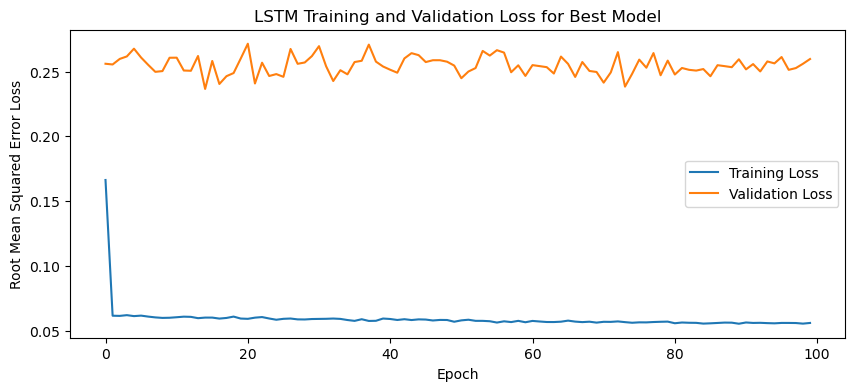

1/1 - 3s - loss: 0.0502 - 3s/epoch - 3s/step
Test Loss: 0.050219908356666565
1/1 [==============================] - 0s 74ms/step


IndexError: index 10 is out of bounds for axis 0 with size 10

In [3]:
n_batch = 1
nb_epoch = 100

def rmse (y_true, y_pred):
    return K.sqrt(K.mean(K.square(y_pred - y_true)))

def mape (y_true, y_pred):
    return 100*K.mean(K.sqrt(K.square(y_true - y_pred))/y_true)
    
def pearson (y_true, y_pred):
    return (K.square(K.mean((y_true - K.mean(y_true))*(y_pred - K.mean(y_pred)))))/(K.mean(K.square(y_true - K.mean(y_true)))*K.mean(K.square(y_pred - K.mean(y_pred))))
 
# fit an LSTM network to training data
#Adapted from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def create_model(trial, X, y, n_lag, n_seq, n_batch, nb_epoch):

    cv_accuracies = []
    
    #Parameters:
    #trial (array-like): Optuna parameters.
    #train (array-like): Target values.
    #n_lag (int): Number of lag observations.
    #n_seq (int): Number of sequence observations
    #nb_epoch (int): Maximum number of epochs
    
    # Hyperparameters to be tuned by Optuna (taken from Javier Leon's dissertation 'Fruit Prices')
    lr = trial.suggest_float('lr', 1e-3, 1, log=True)
    optimizer_name = trial.suggest_categorical('optimizer', ['Adam', 'RMSprop', 'SGD'])
    if optimizer_name == 'Adam':
        optimizer = Adam(learning_rate=lr)
    elif optimizer_name == 'RMSprop':
        optimizer = RMSprop(learning_rate=lr)
    else:
        optimizer = SGD(learning_rate=lr)
    
    #Optuna will try either Rectified Linear Unit (ReLU) = max(0, x), tanh, or sigmoid functions
    activation_function = trial.suggest_categorical('activation_function', ['relu', 'tanh', 'sigmoid'])
    
    lstm_units = trial.suggest_categorical('lstm_units', [256, 512, 1024])
    dropout_rate = trial.suggest_float('dropout_rate', 0.1, 0.5)

    # design network
    model = Sequential()
    model.add(LSTM(lstm_units, return_sequences=True, batch_input_shape=(n_batch, X.shape[1], X.shape[2]), stateful=True))
    model.add(Dropout(dropout_rate))
    model.add(LSTM(lstm_units))
    model.add(Dropout(dropout_rate))
    model.add(Dense(256, input_dim=y.shape[1], activation=activation_function))
    model.add(Dense(128, activation=activation_function))
    model.add(Dense(n_seq))
    model.compile(loss=rmse, optimizer=optimizer)
        
    return model

# make forecast with the LSTM best model
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def forecast_lstm(model, X, n_seq, n_test):
    # reshape input pattern to [samples, timesteps, features]
    X = X.reshape(1, 1, X.shape[1])
    # make forecast
    forecast = model.predict(X)
    # convert to array
    return forecast
     
# evaluate the persistence model
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def make_forecasts(model, X_test, y_test, n_lag, n_seq, n_test):
    forecasts = list()
    for i in range(len(X_test)):
        X, y = X_test[i, :], y_test[i, :]
        # make forecast
        forecast = forecast_lstm(model, X, n_seq, n_test)
        # store the forecast
        forecasts.append(forecast)
    return forecasts
     
# invert differenced forecast
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def inverse_difference(last_ob, forecast):
    # invert first forecast
    inverted = list()
    inverted.append(forecast[0] + last_ob)
    # propagate difference forecast using inverted first value
    for i in range(1, len(forecast)):
        inverted.append(forecast[i] + inverted[i-1])
    return inverted
     
# inverse data transform on forecasts
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def inverse_transform(series, forecasts, scaler, n_test, n_seq):
    inverted = list()
    for i in range(len(forecasts)):
        # create array from forecast
        forecast = forecasts[i]
        forecast = forecast.reshape(1, n_seq)
        # invert scaling
        inv_scale = scaler.inverse_transform(forecast)
        inv_scale = inv_scale[0, :]
        # invert differencing
        index = len(series) - n_test + i - 1
        last_ob = series.values[index]
        inv_diff = inverse_difference(last_ob, inv_scale)
        # store
        inverted.append(inv_diff)
    return inverted
     
# evaluate the RMSE for each forecast time step
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def evaluate_forecasts(test, forecasts, n_lag, n_seq):
    rmse_list = []
    mae_list = []
    mape_list = []
    r2_list = []
    for i in range(n_seq):
        actual = [row[i] for row in test]
        predicted = [forecast[i] for forecast in forecasts]
        rmse = sqrt(mean_squared_error(actual, predicted))
        mae = mean_absolute_error(actual, predicted)
        mse = mean_squared_error(actual, predicted)
        mape = mean_absolute_percentage_error(actual, predicted)
        r2 = r2_score(actual, predicted) 
        rmse_list.append(rmse)
        mae_list.append(mae)
        mape_list.append(mape)
        r2_list.append(r2)
        print("Month at t+"+str(i+1)+":")
        print('t+%d RMSE: %f' % ((i+1), rmse))
        print('t+%d MAE: %f' % ((i+1), mae))
        print('t+%d MAPE: %f' % ((i+1), mape))
        print('t+%d R2_SCORE: %f' % ((i+1), r2))

    return rmse_list, mae_list, mape_list, r2_list
     
# plot the forecasts in the context of the original dataset
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def plot_forecasts(series, forecasts, n_test):
    # plot the entire dataset in blue
    plt.plot(series.values)
    # plot the forecasts in red
    for i in range(len(forecasts)):
        off_s = len(series) - n_test + i - 1
        off_e = off_s + len(forecasts[i]) + 1
        xaxis = [x for x in range(off_s, off_e)]
        yaxis = [series.values[off_s]] + forecasts[i]
        plt.plot(xaxis, yaxis, color='red')
    # show the plot
    plt.show()
    
def objective(trial):
    
    cv_accuracies = []
        
    for i in range(5):
        train1 = train[i]
        test1 = test[i]
        validation1 = validation[i]

        X, y = train1[:, 0:-n_seq], train1[:, -n_seq:]
        X_test, y_test = test1[:, 0:-n_seq], test1[:, -n_seq:]
        X_val, y_val = validation1[:, 0:-n_seq], validation1[:, -n_seq:]
        X = X.reshape(X.shape[0], 1, X.shape[1])
        X_test = X_test.reshape(X_test.shape[0], 1, X_test.shape[1])
        X_val = X_val.reshape(X_val.shape[0], 1, X_val.shape[1])
    
        model = create_model(trial, X, y, n_lag, n_seq, n_batch, nb_epoch)

        history = model.fit(X, y, validation_data=(X_val, y_val), epochs=nb_epoch, verbose=0)

        cv_accuracy = model.evaluate(X_test, y_test, verbose=0)
    
        loss = history.history['val_loss'][-1]
    
        # Plotting the training and validation loss
        #plt.figure(figsize=(10, 4))
        #plt.plot(history.history['loss'], label='Training Loss')
        #plt.plot(history.history['val_loss'], label='Validation Loss')
        #title1 = "LSTM Training and Validation Loss for Fold " + str(i+1)
        #plt.title(title1)
        #plt.xlabel('Epoch')
        #plt.ylabel('Root Mean Squared Error Loss')
        #plt.legend()
        #plt.show()
            
        cv_accuracies.append(cv_accuracy)
    
    print("Cross Validation Accuracies:")
    print(cv_accuracies)
    print("Mean Cross Validation Accuracy:")
    print(np.mean(cv_accuracies))
    print("Standard Deviation of Cross Validation Accuracy:")
    print(np.std(cv_accuracies))
        
    return np.mean(cv_accuracies)

n_batch = 1
nb_epoch = 100

# optimize and fit model
study = optuna.create_study(direction='minimize')
study.optimize(objective, n_trials=100)
print('Number of finished trials:', len(study.trials))

print('Best trial:', study.best_trial.params)
best_params = study.best_params
print("Best hyperparameters: ", best_params)

for i in range(5):
    print("Fold "+str(i+1)+":")
    train1 = train[i]
    test1 = test[i]
    validation1 = validation[i]

    X, y = train1[:, 0:-n_seq], train1[:, -n_seq:]
    X_test, y_test = test1[:, 0:-n_seq], test1[:, -n_seq:]
    X_val, y_val = validation1[:, 0:-n_seq], validation1[:, -n_seq]

    dataset_df = pd.DataFrame(val_y[i])
    dataset_df = dataset_df.iloc[0:10, :]
    dataset = dataset_df.values

    series = pd.Series(dataset[:, 0]) # Using first column (temperatures)
    
    X = X.reshape(X.shape[0], 1, X.shape[1])
    X_test = X_test.reshape(X_test.shape[0], 1, X_test.shape[1])
    X_val = X_val.reshape(X_val.shape[0], 1, X_val.shape[1])

    best_model = create_model(optuna.trial.FixedTrial(best_params), X, y, n_lag, n_seq, n_batch, nb_epoch)
    history=best_model.fit(X, y, epochs=nb_epoch, batch_size=n_batch, validation_data=(X_val, y_val))

    # Plotting the training and validation loss
    plt.figure(figsize=(10, 4))
    plt.plot(history.history['loss'], label='Training Loss')
    plt.plot(history.history['val_loss'], label='Validation Loss')
    title1 = "LSTM Training and Validation Loss for Best Model"
    plt.title(title1)
    plt.xlabel('Epoch')
    plt.ylabel('Root Mean Squared Error Loss')
    plt.legend()
    plt.show()

    # Evaluate the model
    loss = best_model.evaluate(X_test, y_test, verbose=2)
    print(f'Test Loss: {loss}')

    # make forecasts
    forecasts = make_forecasts(best_model, X_test, y_test, n_lag, n_seq, n_test)
    
    # inverse transform forecasts and test
    forecasts = inverse_transform(series, forecasts, scaler[i], n_test+2, n_seq)
    actual = [row[-n_seq:] for row in test1]
    actual = inverse_transform(series, actual, scaler[i], n_test+2, n_seq)

    rmse_list = [] # list stores root mean squared errors for each future time prediction
    mae_list = [] # list stores root mean squared errors for each future time prediction
    mape_list = [] # list stores root mean squared errors for each future time prediction
    r2_list = [] # list stores root mean squared errors for each future time prediction
    
    # evaluate forecasts
    rmse_list, mae_list, mape_list, r2_list = evaluate_forecasts(actual, forecasts, n_lag, n_seq)

    for j in range(len(X_test)):
        print("Weather Station "+str(j+1)+":")
        dataset_df = pd.DataFrame(y_test[j].flatten())
        dataset = dataset_df.values
        dataset = dataset[:, 0]
        dataset = np.array(dataset).reshape(-1, 1)
        dataset = dataset.flatten()
        dataset = pd.DataFrame(dataset)
        series = scaler[i].inverse_transform(dataset)
        series = pd.Series(series.flatten())

    # plot forecasts
    plot_forecasts(series, forecasts, 1)
    
    best_model.summary()

    # Print out table of actual and predicted values for each weather station
    for j in range(11):
        print("Weather Station "+str(j+1)+":")
        print("Actual S.H.\tPredicted S.H.\tDifference")
        print("-----------\t--------------\t----------")
        for k in range(n_seq):
            diff = forecasts[j][k] - actual[j][k]
            print(f"{actual[j][k]:.2f}\t\t{forecasts[j][k]:.2f}\t\t{diff:.2f}")

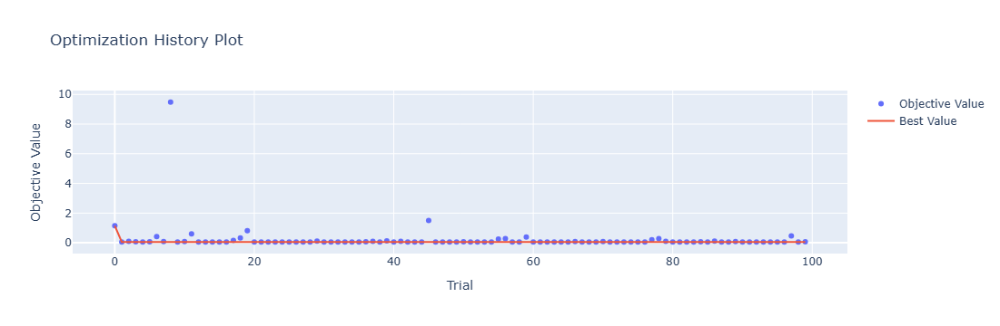

In [4]:
optuna.visualization.plot_optimization_history(study)

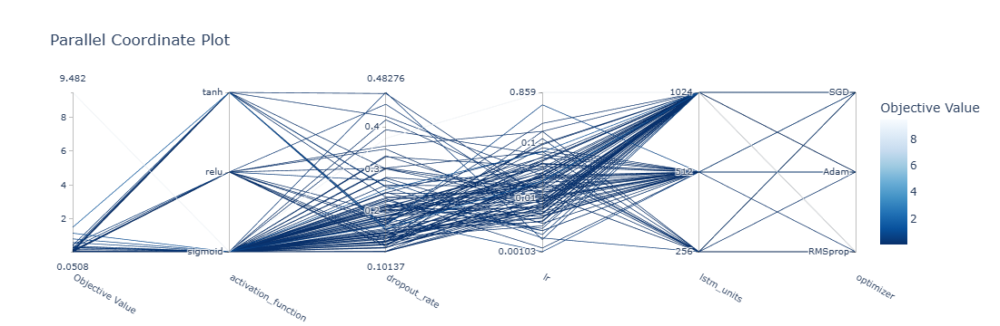

In [5]:
optuna.visualization.plot_parallel_coordinate(study)

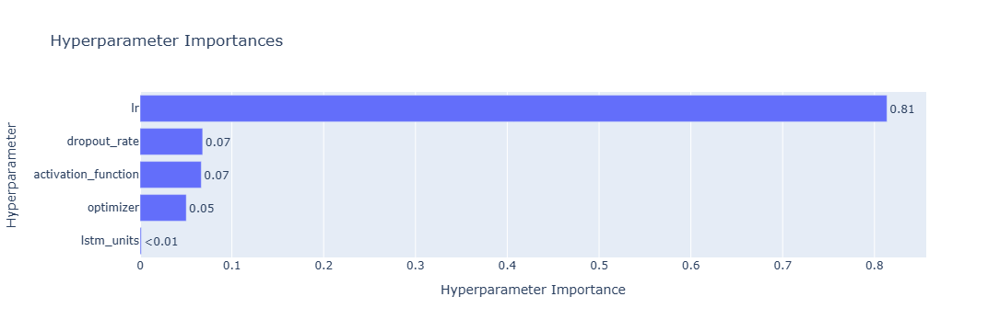

In [6]:
optuna.visualization.plot_param_importances(study)

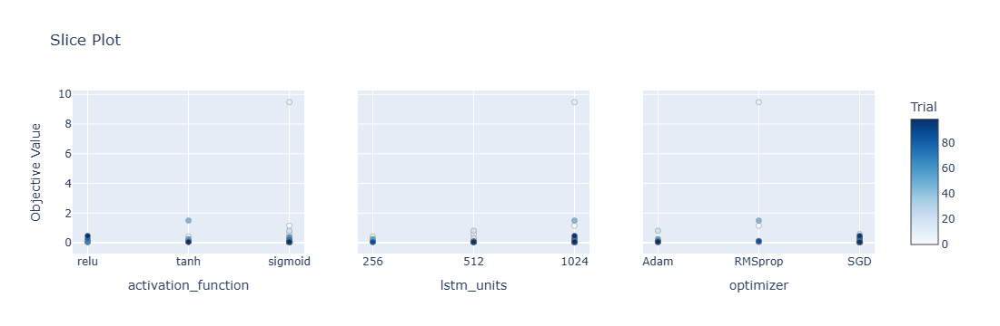

In [7]:
optuna.visualization.plot_slice(study, params=['optimizer', 'activation_function', 'lstm_units'])

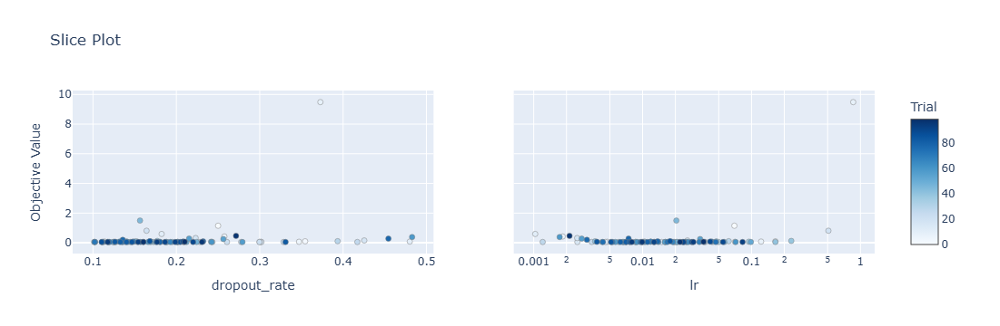

In [8]:
optuna.visualization.plot_slice(study, params=['lr', 'dropout_rate'])

[[12.21  8.17 15.68 ... 23.86 20.59 15.82]
 [14.52 12.85 16.77 ... 26.49 23.17 21.15]
 [ 8.91  6.23 11.39 ... 22.62 16.72 14.05]
 ...
 [ 7.87  5.76 10.62 ... 21.07 15.24 12.04]
 [ 6.49  2.73  9.77 ... 21.93 16.5  11.44]
 [ 5.29  1.27  5.84 ... 22.11 15.37  9.87]]
Epoch 1/100
84/84 [==============================] - 9s 55ms/step - loss: 0.1525 - accuracy: 0.3929 - mae: 0.1209 - rmse: 0.1525 - mape: inf - pearson: 0.6574 - val_loss: 0.0629 - val_accuracy: 0.4000 - val_mae: 0.0495 - val_rmse: 0.0629 - val_mape: 11.0710 - val_pearson: 0.8146
Epoch 2/100
84/84 [==============================] - 3s 39ms/step - loss: 0.0611 - accuracy: 0.5238 - mae: 0.0481 - rmse: 0.0611 - mape: inf - pearson: 0.8300 - val_loss: 0.0647 - val_accuracy: 0.4000 - val_mae: 0.0517 - val_rmse: 0.0647 - val_mape: 11.4364 - val_pearson: 0.8072
Epoch 3/100
84/84 [==============================] - 3s 40ms/step - loss: 0.0612 - accuracy: 0.5238 - mae: 0.0484 - rmse: 0.0612 - mape: inf - pearson: 0.8339 - val_loss: 0.074

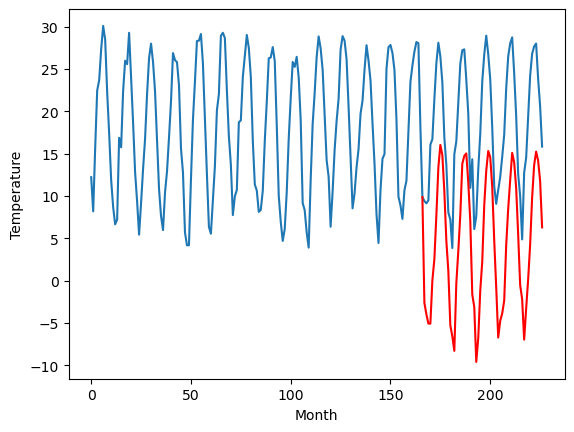

Weather Station 2:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
3.39		4.28		0.89
2.49		2.92		0.43
2.11		1.82		-0.29
2.86		1.81		-1.05
8.69		6.92		-1.77
9.18		9.41		0.23
11.95		14.61		2.66
15.70		20.25		4.55
16.18		22.92		6.74
16.81		21.74		4.93
13.83		17.41		3.58
11.20		11.62		0.42
7.78		8.03		0.25
0.57		1.60		1.03
1.23		0.30		-0.93
1.14		-1.42		-2.56
6.20		6.55		0.35
7.60		10.39		2.79
11.62		14.66		3.04
15.10		20.66		5.56
16.32		21.59		5.27
16.66		21.90		5.24
14.53		18.43		3.90
11.90		13.93		2.03
6.39		5.22		-1.17
6.15		3.75		-2.40
-0.53		-2.73		-2.20
2.24		0.09		-2.15
6.10		5.68		-0.42
9.07		9.11		0.04
13.38		15.78		2.40
17.07		19.82		2.75
17.21		22.16		4.95
16.66		21.42		4.76
15.64		17.91		2.27
10.04		11.56		1.52
7.35		6.02		-1.33
3.50		0.11		-3.39
4.29		2.08		-2.21
5.39		2.94		-2.45
6.98		4.45		-2.53
9.13		10.97		1.84
12.31		15.28		2.97
15.39		18.67		3.28
17.22		21.89		4.67
18.81		20.76		1.95
15.43		17.73		2.30
10.32		12.24		1.92
5.08		6.28		1.20
2.38

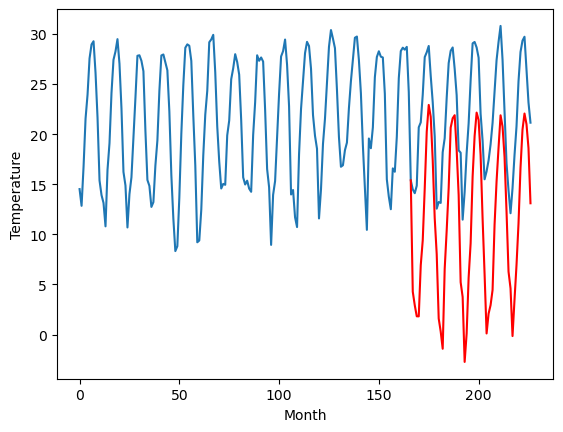

Weather Station 3:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
4.93		6.58		1.65
4.82		5.22		0.40
4.20		4.12		-0.08
4.82		4.12		-0.70
11.07		9.22		-1.85
10.83		11.71		0.88
14.52		16.90		2.38
18.24		22.54		4.30
20.61		25.22		4.61
19.85		24.03		4.18
16.46		19.70		3.24
12.74		13.91		1.17
7.81		10.32		2.51
0.81		3.90		3.09
1.63		2.60		0.97
2.49		0.89		-1.60
8.47		8.87		0.40
10.11		12.69		2.58
14.09		16.97		2.88
18.23		22.97		4.74
19.99		23.89		3.90
20.27		24.20		3.93
16.70		20.74		4.04
12.82		16.23		3.41
4.46		7.52		3.06
6.64		6.05		-0.59
0.63		-0.44		-1.07
4.58		2.39		-2.19
8.08		7.97		-0.11
10.82		11.40		0.58
16.58		18.07		1.49
20.36		22.11		1.75
21.28		24.45		3.17
20.05		23.71		3.66
16.93		20.21		3.28
9.79		13.85		4.06
7.31		8.31		1.00
2.79		2.40		-0.39
4.74		4.38		-0.36
7.52		5.23		-2.29
7.50		6.74		-0.76
10.57		13.26		2.69
13.98		17.58		3.60
17.30		20.96		3.66
20.40		24.18		3.78
20.01		23.06		3.05
16.56		20.02		3.46
10.58		14.54		3.96
5.49		8.57		3.08
2.

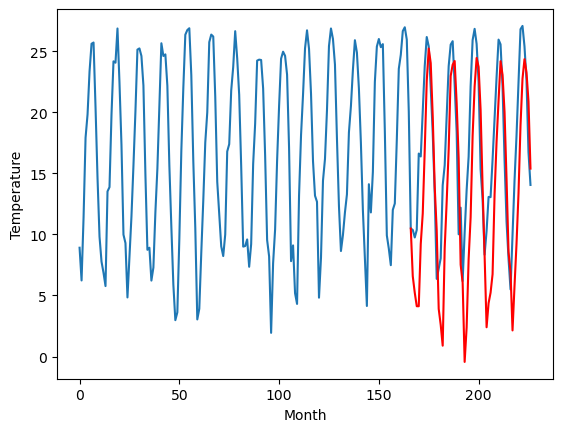

Weather Station 4:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
1.13		0.97		-0.16
1.11		-0.38		-1.49
1.15		-1.49		-2.64
1.15		-1.49		-2.64
8.07		3.61		-4.46
8.15		6.10		-2.05
11.04		11.29		0.25
13.95		16.93		2.98
14.92		19.61		4.69
15.26		18.43		3.17
12.93		14.09		1.16
8.87		8.30		-0.57
6.03		4.71		-1.32
-1.43		-1.71		-0.28
-1.34		-3.01		-1.67
-2.91		-4.72		-1.81
5.00		3.25		-1.75
6.79		7.08		0.29
10.76		11.36		0.60
14.04		17.36		3.32
14.67		18.29		3.62
14.72		18.60		3.88
12.21		15.14		2.93
9.90		10.64		0.74
1.81		1.93		0.12
4.58		0.46		-4.12
-2.77		-6.03		-3.26
-0.33		-3.20		-2.87
3.46		2.38		-1.08
8.25		5.82		-2.43
12.77		12.49		-0.28
15.20		16.52		1.32
15.18		18.87		3.69
13.99		18.13		4.14
12.75		14.62		1.87
7.13		8.26		1.13
3.02		2.71		-0.31
0.84		-3.18		-4.02
2.28		-1.20		-3.48
2.69		-0.35		-3.04
6.21		1.16		-5.05
7.63		7.68		0.05
12.06		12.00		-0.06
15.81		15.39		-0.42
16.93		18.61		1.68
18.46		17.49		-0.97
15.02		14.45		-0.57
8.77		8.96		0.19
2.91	

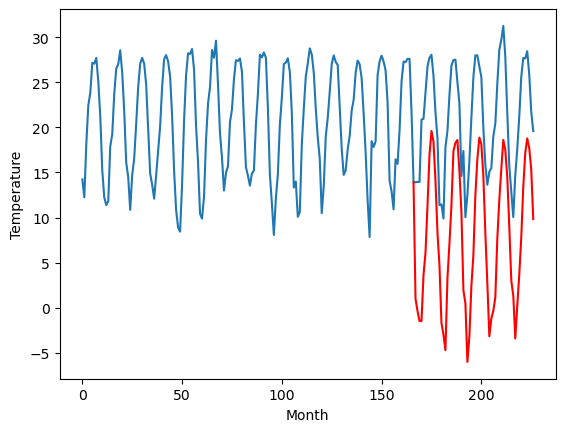

Weather Station 5:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
7.34		6.29		-1.05
5.29		4.93		-0.36
6.03		3.83		-2.20
5.36		3.82		-1.54
13.11		8.92		-4.19
13.36		11.42		-1.94
18.34		16.61		-1.73
22.54		22.25		-0.29
24.15		24.93		0.78
24.64		23.74		-0.90
18.93		19.42		0.49
14.05		13.63		-0.42
11.53		10.04		-1.49
5.06		3.62		-1.44
4.18		2.33		-1.85
1.09		0.62		-0.47
10.99		8.58		-2.41
12.92		12.42		-0.50
16.78		16.70		-0.08
21.98		22.71		0.73
22.41		23.63		1.22
23.17		23.93		0.76
21.16		20.48		-0.68
16.81		15.98		-0.83
9.24		7.27		-1.97
11.57		5.81		-5.76
3.12		-0.69		-3.81
2.89		2.14		-0.75
9.38		7.73		-1.65
15.42		11.16		-4.26
20.13		17.84		-2.29
24.47		21.87		-2.60
26.83		24.21		-2.62
24.47		23.47		-1.00
21.52		19.97		-1.55
15.60		13.61		-1.99
8.67		8.06		-0.61
5.94		2.16		-3.78
6.91		4.14		-2.77
7.04		4.99		-2.05
11.76		6.51		-5.25
13.26		13.03		-0.23
18.79		17.35		-1.44
23.34		20.74		-2.60
26.33		23.96		-2.37
28.07		22.84		-5.23
23.59		19.82		-3.77
15.

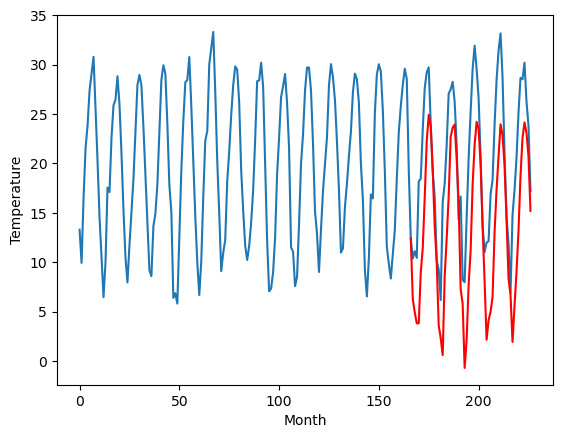

Weather Station 6:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
4.63		5.37		0.74
4.06		4.01		-0.05
3.53		2.90		-0.63
3.22		2.90		-0.32
6.81		8.00		1.19
8.78		10.49		1.71
12.47		15.68		3.21
16.82		21.32		4.50
20.56		24.00		3.44
19.71		22.82		3.11
16.68		18.50		1.82
12.59		12.71		0.12
8.47		9.11		0.64
1.72		2.69		0.97
-0.06		1.40		1.46
0.59		-0.31		-0.90
5.49		7.66		2.17
8.86		11.49		2.63
12.37		15.77		3.40
16.94		21.78		4.84
18.93		22.69		3.76
19.41		23.00		3.59
16.40		19.54		3.14
12.80		15.03		2.23
4.63		6.32		1.69
5.68		4.85		-0.83
-0.70		-1.64		-0.94
2.91		1.19		-1.72
6.83		6.78		-0.05
9.70		10.21		0.51
14.33		16.88		2.55
17.90		20.91		3.01
20.04		23.25		3.21
19.19		22.52		3.33
16.54		19.02		2.48
9.98		12.67		2.69
8.29		7.12		-1.17
1.77		1.22		-0.55
3.46		3.20		-0.26
4.95		4.06		-0.89
5.86		5.57		-0.29
10.54		12.10		1.56
12.06		16.42		4.36
15.88		19.81		3.93
19.71		23.03		3.32
19.23		21.91		2.68
15.71		18.88		3.17
11.36		13.39		2.03
5.92		7.43		1.51
3.7

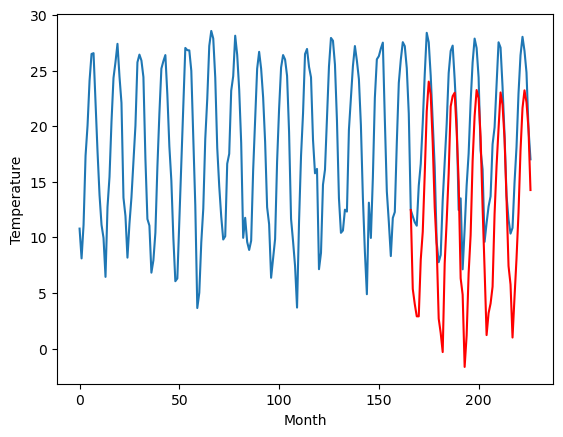

Weather Station 7:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
0.68		2.86		2.18
0.32		1.50		1.18
-0.15		0.39		0.54
0.96		0.39		-0.57
6.38		5.49		-0.89
7.62		7.99		0.37
9.96		13.17		3.21
15.21		18.81		3.60
18.28		21.48		3.20
17.25		20.30		3.05
13.36		15.98		2.62
9.36		10.18		0.82
5.18		6.59		1.41
-1.75		0.17		1.92
-2.33		-1.12		1.21
-1.69		-2.84		-1.15
5.29		5.14		-0.15
6.32		8.96		2.64
10.03		13.24		3.21
14.36		19.25		4.89
15.98		20.16		4.18
15.92		20.47		4.55
11.87		17.01		5.14
8.64		12.50		3.86
-0.01		3.78		3.79
1.93		2.31		0.38
-4.72		-4.18		0.54
-0.74		-1.36		-0.62
3.60		4.23		0.63
6.52		7.66		1.14
11.59		14.33		2.74
15.50		18.36		2.86
16.60		20.69		4.09
15.31		19.96		4.65
12.25		16.46		4.21
5.31		10.11		4.80
3.08		4.57		1.49
-3.43		-1.34		2.09
-0.24		0.64		0.88
2.76		1.50		-1.26
3.24		3.01		-0.23
6.80		9.53		2.73
9.49		13.85		4.36
12.84		17.24		4.40
16.55		20.46		3.91
15.86		19.34		3.48
12.35		16.31		3.96
7.14		10.83		3.69
1.27		4.86		3.59
-1.02		3.

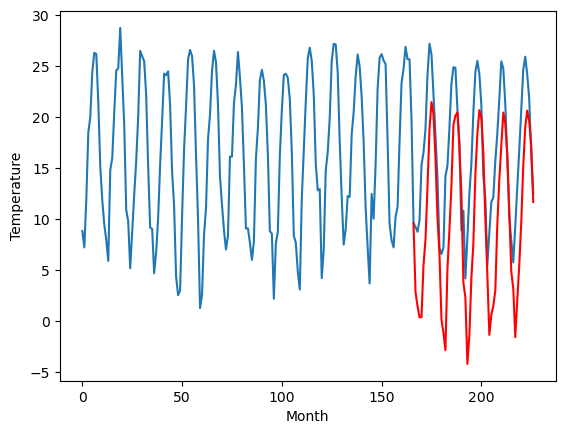

Weather Station 8:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-1.37		0.92		2.29
-1.74		-0.44		1.30
-1.86		-1.54		0.32
-0.82		-1.54		-0.72
4.76		3.56		-1.20
5.66		6.05		0.39
8.78		11.24		2.46
14.30		16.88		2.58
17.56		19.56		2.00
16.19		18.38		2.19
11.32		14.05		2.73
7.48		8.25		0.77
3.25		4.66		1.41
-3.68		-1.76		1.92
-4.62		-3.05		1.57
-4.00		-4.76		-0.76
2.52		3.21		0.69
6.15		7.04		0.89
9.17		11.31		2.14
13.96		17.32		3.36
16.08		18.23		2.15
16.03		18.55		2.52
11.52		15.08		3.56
7.67		10.57		2.90
-1.83		1.85		3.68
0.23		0.38		0.15
-6.95		-6.11		0.84
-2.71		-3.29		-0.58
2.13		2.30		0.17
5.45		5.72		0.27
10.43		12.39		1.96
14.43		16.42		1.99
16.30		18.76		2.46
14.62		18.03		3.41
10.92		14.53		3.61
3.73		8.18		4.45
1.53		2.64		1.11
-5.64		-3.27		2.37
-2.47		-1.29		1.18
0.50		-0.43		-0.93
1.18		1.08		-0.10
5.80		7.61		1.81
8.09		11.93		3.84
11.84		15.31		3.47
15.98		18.54		2.56
14.84		17.42		2.58
11.08		14.38		3.30
5.69		8.90		3.21
-0.76		2.94		3.70
-2.3

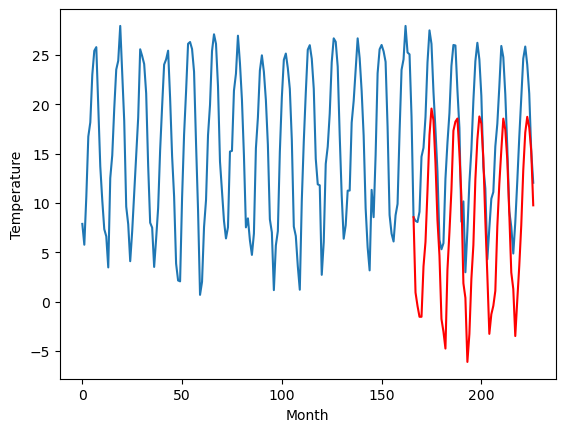

Weather Station 9:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-0.95		-0.06		0.89
-1.11		-1.41		-0.30
-2.30		-2.51		-0.21
-1.80		-2.51		-0.71
4.77		2.59		-2.18
7.05		5.09		-1.96
11.93		10.28		-1.65
17.86		15.92		-1.94
20.60		18.59		-2.01
17.59		17.41		-0.18
14.03		13.08		-0.95
6.77		7.29		0.52
3.91		3.70		-0.21
-2.80		-2.71		0.09
-3.59		-4.00		-0.41
-7.86		-5.72		2.14
4.61		2.26		-2.35
7.21		6.10		-1.11
11.90		10.37		-1.53
18.09		16.38		-1.71
18.66		17.31		-1.35
18.60		17.62		-0.98
14.86		14.15		-0.71
10.90		9.64		-1.26
0.86		0.93		0.07
2.66		-0.55		-3.21
-5.85		-7.04		-1.19
-3.81		-4.21		-0.40
3.41		1.39		-2.02
7.36		4.82		-2.54
14.20		11.49		-2.71
18.72		15.52		-3.20
21.05		17.85		-3.20
18.17		17.12		-1.05
14.53		13.62		-0.91
7.97		7.27		-0.70
2.00		1.73		-0.27
-3.29		-4.18		-0.89
-0.73		-2.19		-1.46
0.88		-1.33		-2.21
2.70		0.19		-2.51
8.48		6.72		-1.76
14.07		11.04		-3.03
17.94		14.43		-3.51
19.43		17.65		-1.78
18.17		16.53		-1.64
15.00		13.50		-1.50

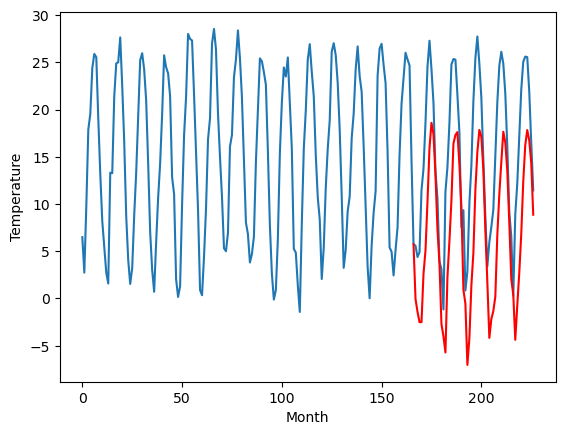

Weather Station 10:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-4.56		-1.44		3.12
-4.38		-2.78		1.60
-5.66		-3.89		1.77
-6.53		-3.88		2.65
0.66		1.22		0.56
2.32		3.71		1.39
7.41		8.91		1.50
14.39		14.56		0.17
17.02		17.22		0.20
14.64		16.03		1.39
10.97		11.70		0.73
4.58		5.91		1.33
0.90		2.33		1.43
-6.61		-4.09		2.52
-8.20		-5.38		2.82
-10.37		-7.11		3.26
0.38		0.88		0.50
3.44		4.72		1.28
7.91		9.00		1.09
14.39		15.01		0.62
15.40		15.93		0.53
16.00		16.25		0.25
12.14		12.78		0.64
7.67		8.27		0.60
-2.99		-0.45		2.54
-1.76		-1.92		-0.16
-10.73		-8.42		2.31
-7.15		-5.59		1.56
-0.17		-0.00		0.17
2.56		3.43		0.87
10.73		10.10		-0.63
14.63		14.13		-0.50
16.66		16.46		-0.20
14.75		15.73		0.98
11.02		12.23		1.21
3.98		5.88		1.90
-1.04		0.35		1.39
-6.75		-5.57		1.18
-4.86		-3.58		1.28
-2.82		-2.72		0.10
-2.48		-1.20		1.28
3.80		5.33		1.53
8.76		9.65		0.89
12.60		13.04		0.44
15.43		16.26		0.83
14.63		15.14		0.51
12.02		12.11		0.09
5.44		6.62		1.18
-1.06		0.66		1.

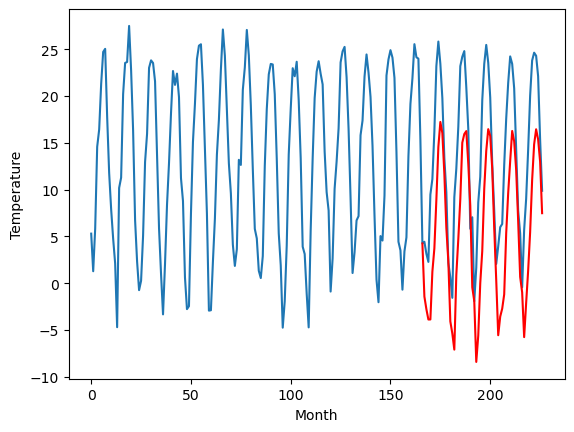

Weather Station 11:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-5.06		-2.63		2.43
-5.73		-3.98		1.75
-6.76		-5.09		1.67
-8.22		-5.08		3.14
-2.08		0.03		2.11
0.57		2.53		1.96
7.00		7.72		0.72
14.96		13.38		-1.58
18.12		16.05		-2.07
15.43		14.85		-0.58
10.60		10.52		-0.08
3.85		4.73		0.88
0.37		1.15		0.78
-6.66		-5.26		1.40
-8.27		-6.56		1.71
-12.58		-8.28		4.30
-0.85		-0.29		0.56
3.12		3.56		0.44
8.27		7.84		-0.43
15.58		13.85		-1.73
16.17		14.78		-1.39
16.88		15.09		-1.79
12.83		11.62		-1.21
8.48		7.12		-1.36
-2.38		-1.61		0.77
-3.28		-3.09		0.19
-12.23		-9.59		2.64
-8.99		-6.76		2.23
-2.08		-1.17		0.91
1.53		2.26		0.73
10.85		8.94		-1.91
15.61		12.97		-2.64
16.72		15.30		-1.42
15.60		14.58		-1.02
11.76		11.08		-0.68
4.52		4.73		0.21
-0.51		-0.81		-0.30
-6.69		-6.73		-0.04
-5.56		-4.74		0.82
-5.15		-3.89		1.26
-3.29		-2.36		0.93
3.56		4.17		0.61
8.58		8.49		-0.09
14.09		11.88		-2.21
16.55		15.11		-1.44
14.74		13.99		-0.75
12.36		10.95		-1.41
6.40		5.46	

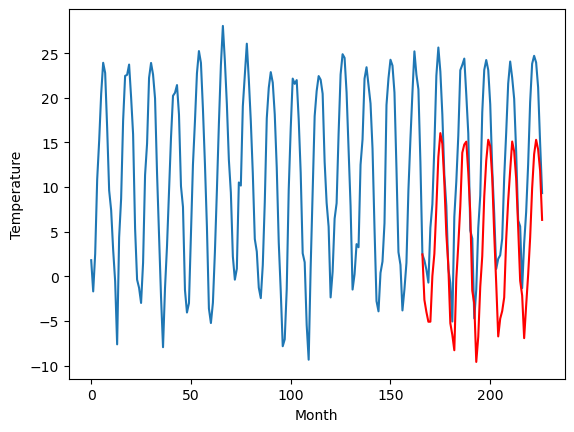

Predictions for (t+0):
    Weather_Station  Actual  Predicted
0                 0   -2.98  -2.641308
1                 1    3.39   4.275542
2                 2    4.93   6.578383
3                 3    1.13   0.972621
4                 4    7.34   6.291347
5                 5    4.63   5.367430
6                 6    0.68   2.855493
7                 7   -1.37   0.915513
8                 8   -0.95  -0.060398
9                 9   -4.56  -1.436927
10               10   -5.06  -2.634587


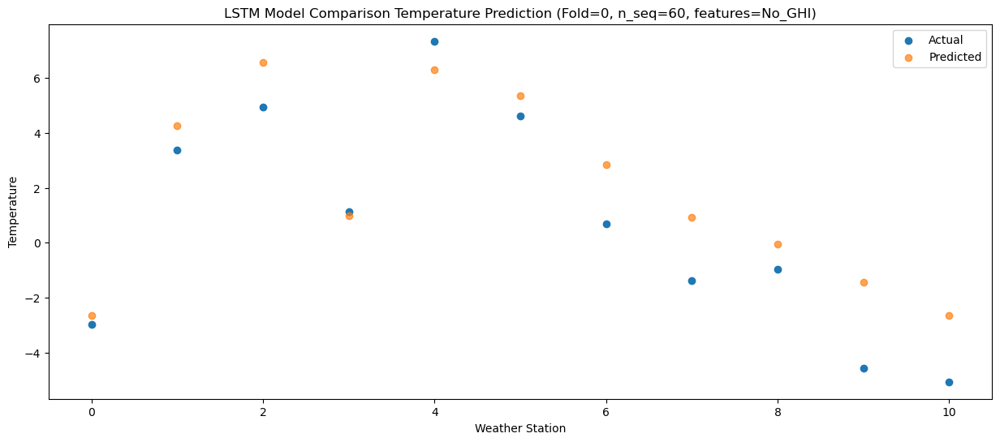

Predictions for (t+1):
    Weather_Station  Actual  Predicted
0                 0   -3.45  -3.986622
1                 1    2.49   2.924193
2                 2    4.82   5.223911
3                 3    1.11  -0.380732
4                 4    5.29   4.929212
5                 5    4.06   4.005172
6                 6    0.32   1.496728
7                 7   -1.74  -0.440317
8                 8   -1.11  -1.411483
9                 9   -4.38  -2.783851
10               10   -5.73  -3.982761


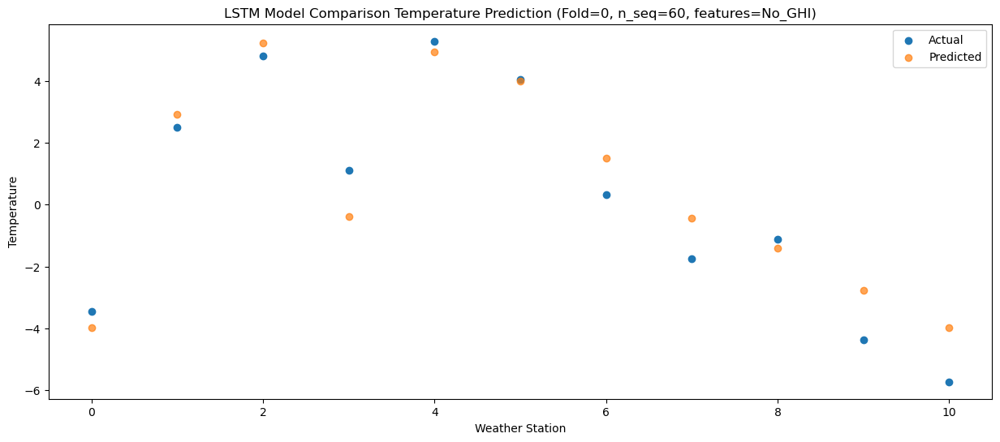

Predictions for (t+2):
    Weather_Station  Actual  Predicted
0                 0   -3.72  -5.090065
1                 1    2.11   1.819326
2                 2    4.20   4.119919
3                 3    1.15  -1.486945
4                 4    6.03   3.829019
5                 5    3.53   2.903011
6                 6   -0.15   0.392614
7                 7   -1.86  -1.541913
8                 8   -2.30  -2.513040
9                 9   -5.66  -3.888315
10               10   -6.76  -5.087132


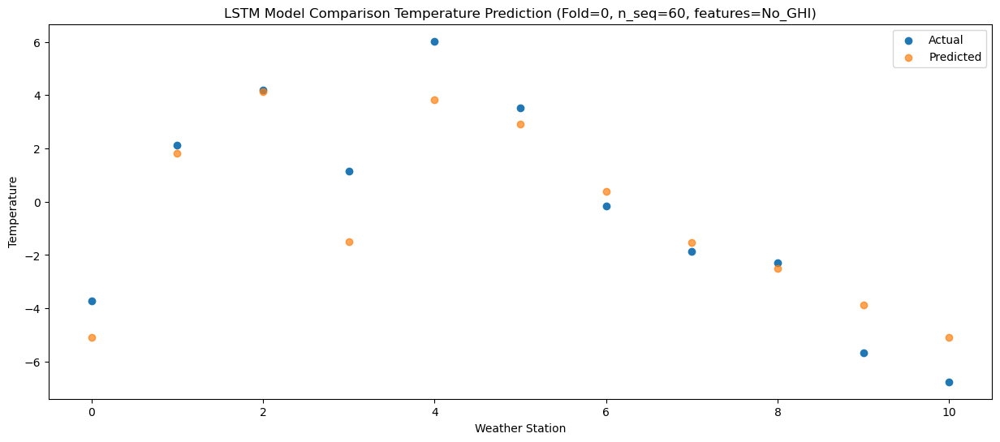

Predictions for (t+3):
    Weather_Station  Actual  Predicted
0                 0   -3.37  -5.089653
1                 1    2.86   1.814887
2                 2    4.82   4.119368
3                 3    1.15  -1.493100
4                 4    5.36   3.824657
5                 5    3.22   2.902407
6                 6    0.96   0.391717
7                 7   -0.82  -1.541976
8                 8   -1.80  -2.510065
9                 9   -6.53  -3.884448
10               10   -8.22  -5.081036


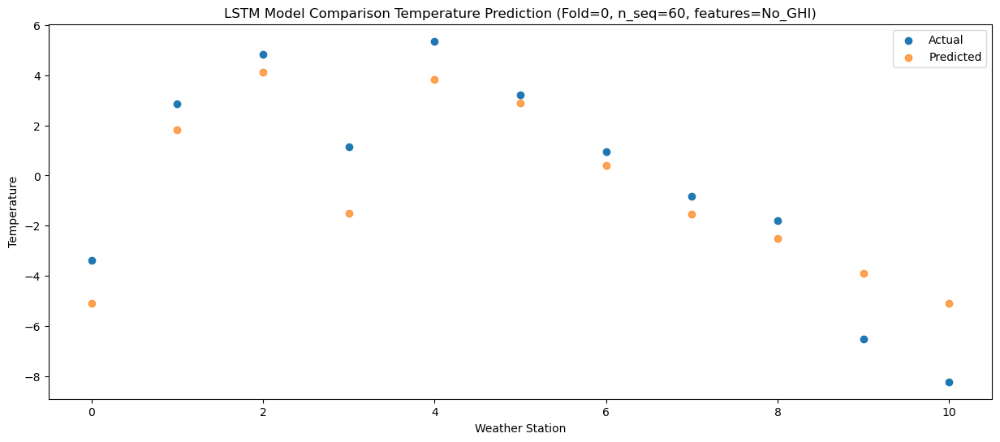

Predictions for (t+4):
    Weather_Station  Actual  Predicted
0                 0    3.21   0.013019
1                 1    8.69   6.915047
2                 2   11.07   9.220260
3                 3    8.07   3.607137
4                 4   13.11   8.924494
5                 5    6.81   8.000238
6                 6    6.38   5.488202
7                 7    4.76   3.556285
8                 8    4.77   2.592418
9                 9    0.66   1.221450
10               10   -2.08   0.033713


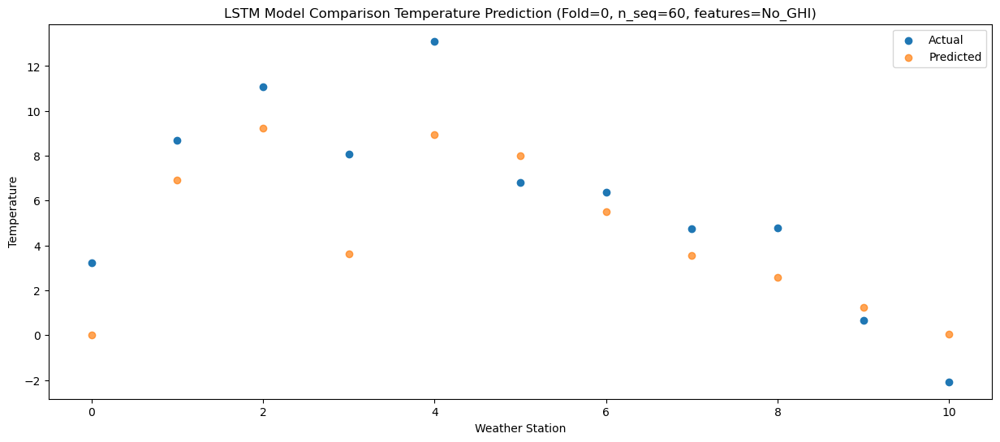

Predictions for (t+5):
    Weather_Station  Actual  Predicted
0                 0    3.86   2.505384
1                 1    9.18   9.411888
2                 2   10.83  11.714385
3                 3    8.15   6.098890
4                 4   13.36  11.422182
5                 5    8.78  10.494977
6                 6    7.62   7.985259
7                 7    5.66   6.050354
8                 8    7.05   5.085266
9                 9    2.32   3.713785
10               10    0.57   2.530996


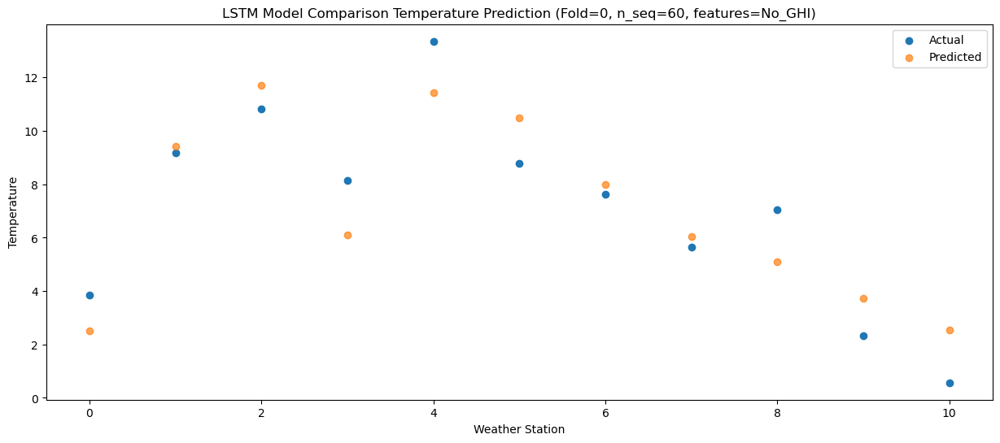

Predictions for (t+6):
    Weather_Station  Actual  Predicted
0                 0    8.59   7.702461
1                 1   11.95  14.606163
2                 2   14.52  16.904853
3                 3   11.04  11.289502
4                 4   18.34  16.611406
5                 5   12.47  15.683434
6                 6    9.96  13.170982
7                 7    8.78  11.237421
8                 8   11.93  10.275432
9                 9    7.41   8.906494
10               10    7.00   7.724938


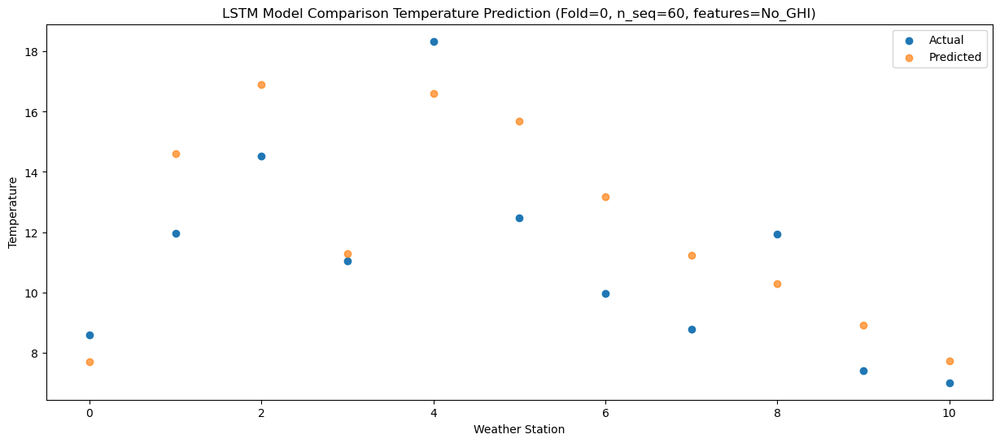

Predictions for (t+7):
    Weather_Station  Actual  Predicted
0                 0   12.81  13.345194
1                 1   15.70  20.250325
2                 2   18.24  22.544584
3                 3   13.95  16.932405
4                 4   22.54  22.251334
5                 5   16.82  21.324994
6                 6   15.21  18.809211
7                 7   14.30  16.877914
8                 8   17.86  15.923648
9                 9   14.39  14.557920
10               10   14.96  13.377742


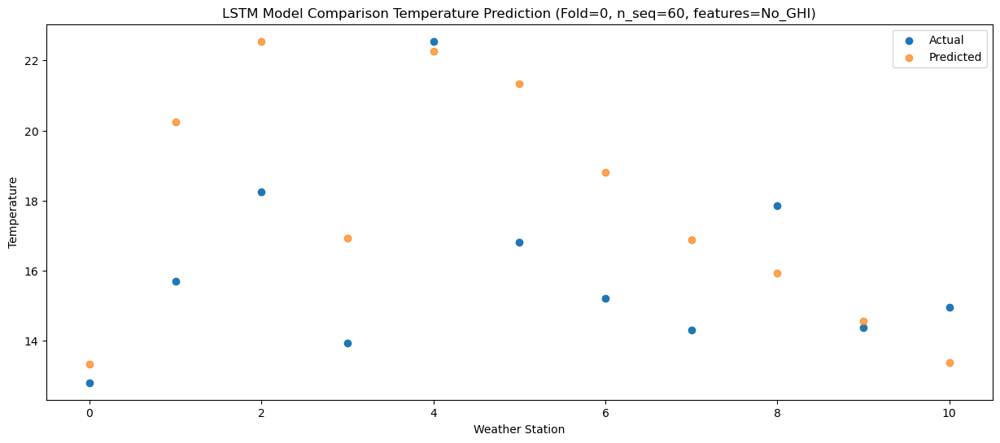

Predictions for (t+8):
    Weather_Station  Actual  Predicted
0                 0   15.26  16.018455
1                 1   16.18  22.923329
2                 2   20.61  25.218434
3                 3   14.92  19.608588
4                 4   24.15  24.925914
5                 5   20.56  24.002413
6                 6   18.28  21.484495
7                 7   17.56  19.556716
8                 8   20.60  18.594992
9                 9   17.02  17.224702
10               10   18.12  16.045983


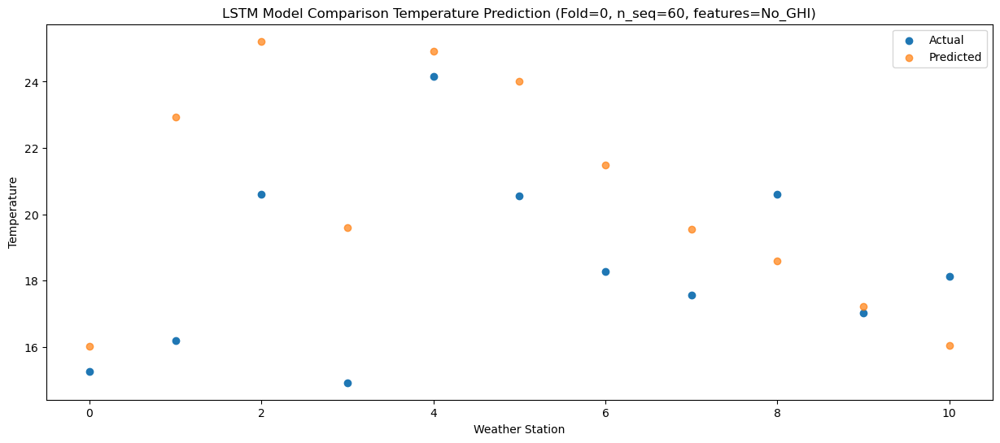

Predictions for (t+9):
    Weather_Station  Actual  Predicted
0                 0   13.63  14.826376
1                 1   16.81  21.736440
2                 2   19.85  24.029650
3                 3   15.26  18.425616
4                 4   24.64  23.742953
5                 5   19.71  22.819932
6                 6   17.25  20.302945
7                 7   16.19  18.376043
8                 8   17.59  17.410606
9                 9   14.64  16.033864
10               10   15.43  14.850029


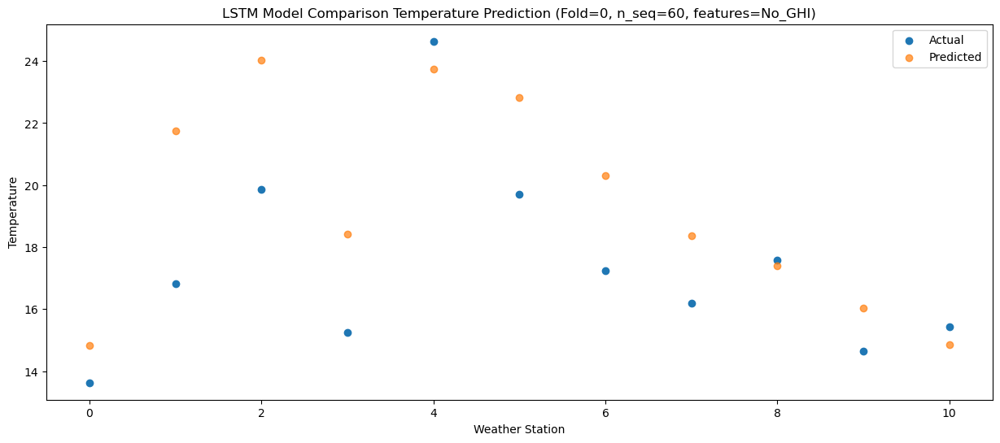

Predictions for (t+10):
    Weather_Station  Actual  Predicted
0                 0   10.57  10.504492
1                 1   13.83  17.409752
2                 2   16.46  19.703673
3                 3   12.93  14.094069
4                 4   18.93  19.417279
5                 5   16.68  18.498277
6                 6   13.36  15.975579
7                 7   11.32  14.045891
8                 8   14.03  13.083998
9                 9   10.97  11.704803
10               10   10.60  10.520833


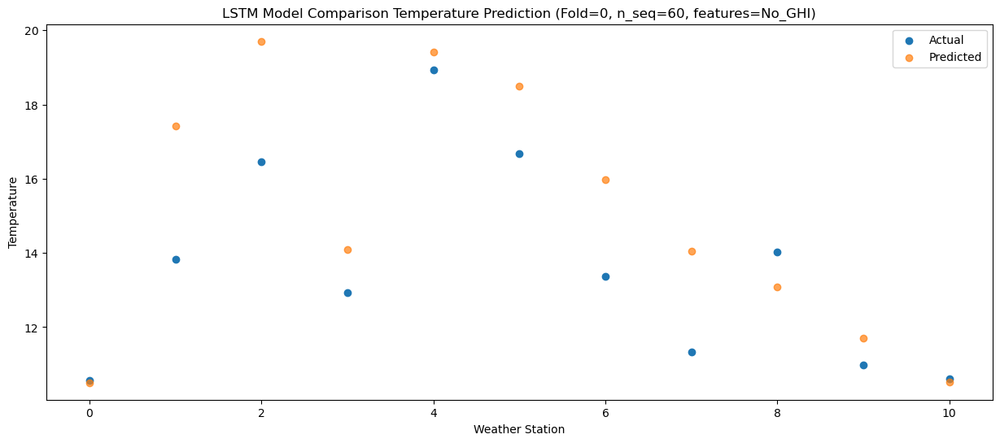

Predictions for (t+11):
    Weather_Station  Actual  Predicted
0                 0    4.07   4.708351
1                 1   11.20  11.616900
2                 2   12.74  13.910559
3                 3    8.87   8.300536
4                 4   14.05  13.625771
5                 5   12.59  12.706471
6                 6    9.36  10.184616
7                 7    7.48   8.254479
8                 8    6.77   7.287412
9                 9    4.58   5.909597
10               10    3.85   4.732317


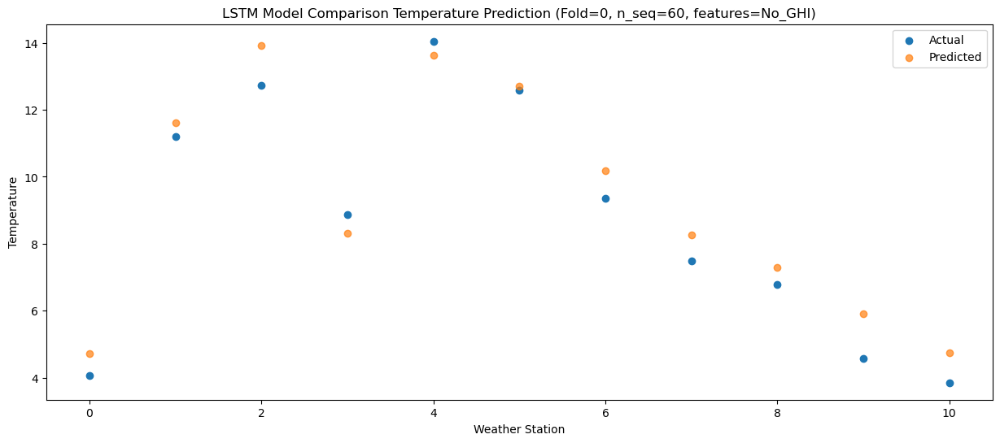

Predictions for (t+12):
    Weather_Station  Actual  Predicted
0                 0    0.83   1.125281
1                 1    7.78   8.028570
2                 2    7.81  10.321475
3                 3    6.03   4.713344
4                 4   11.53  10.036993
5                 5    8.47   9.108919
6                 6    5.18   6.586462
7                 7    3.25   4.655799
8                 8    3.91   3.700241
9                 9    0.90   2.325465
10               10    0.37   1.153762


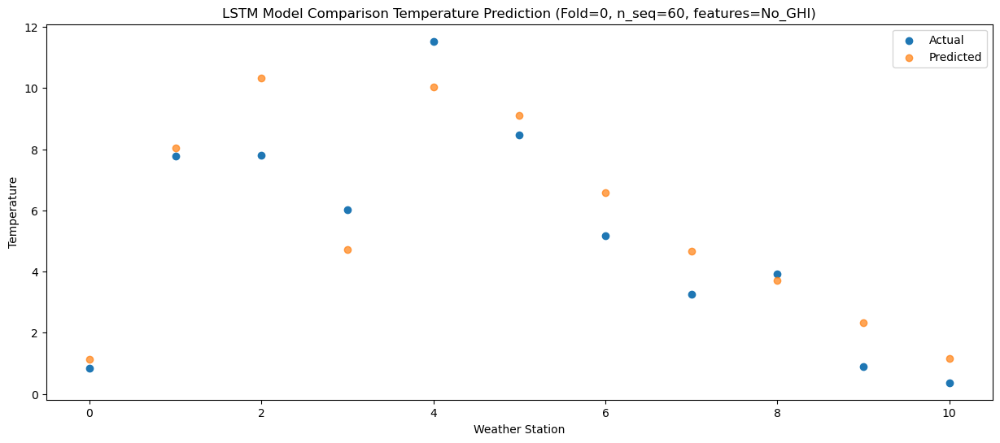

Predictions for (t+13):
    Weather_Station  Actual  Predicted
0                 0   -4.79  -5.298049
1                 1    0.57   1.599585
2                 2    0.81   3.901512
3                 3   -1.43  -1.706707
4                 4    5.06   3.621300
5                 5    1.72   2.693437
6                 6   -1.75   0.170374
7                 7   -3.68  -1.759998
8                 8   -2.80  -2.714879
9                 9   -6.61  -4.089295
10               10   -6.66  -5.258071


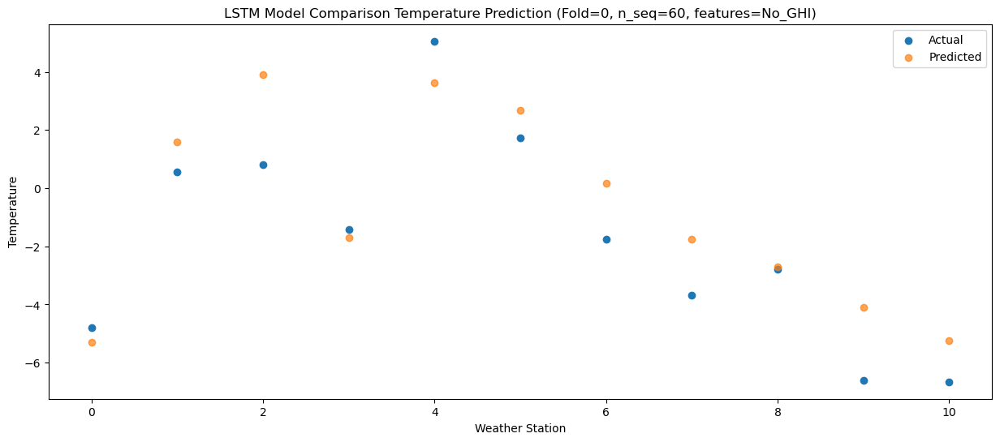

Predictions for (t+14):
    Weather_Station  Actual  Predicted
0                 0   -5.65  -6.598129
1                 1    1.23   0.298200
2                 2    1.63   2.603155
3                 3   -1.34  -3.005847
4                 4    4.18   2.329234
5                 5   -0.06   1.403012
6                 6   -2.33  -1.121480
7                 7   -4.62  -3.047909
8                 8   -3.59  -4.003183
9                 9   -8.20  -5.383561
10               10   -8.27  -6.558355


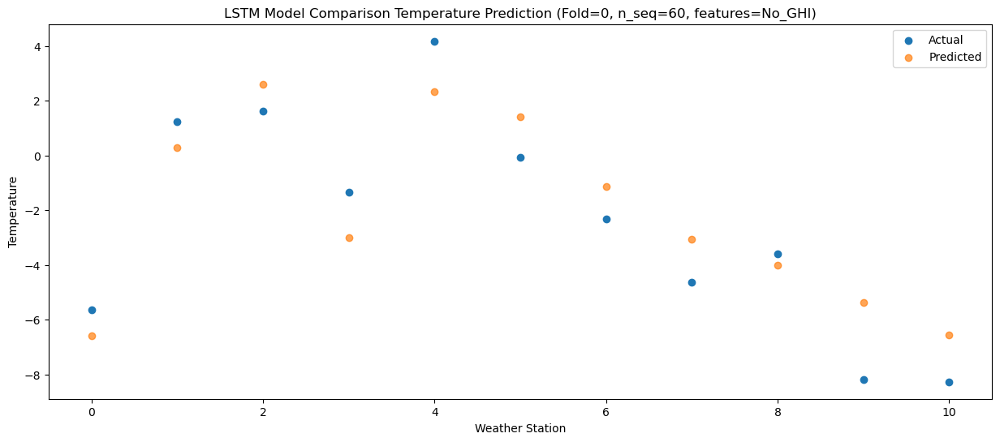

Predictions for (t+15):
    Weather_Station  Actual  Predicted
0                 0   -9.00  -8.309359
1                 1    1.14  -1.419310
2                 2    2.49   0.890201
3                 3   -2.91  -4.719804
4                 4    1.09   0.615100
5                 5    0.59  -0.308423
6                 6   -1.69  -2.835348
7                 7   -4.00  -4.761048
8                 8   -7.86  -5.721343
9                 9  -10.37  -7.107084
10               10  -12.58  -8.280363


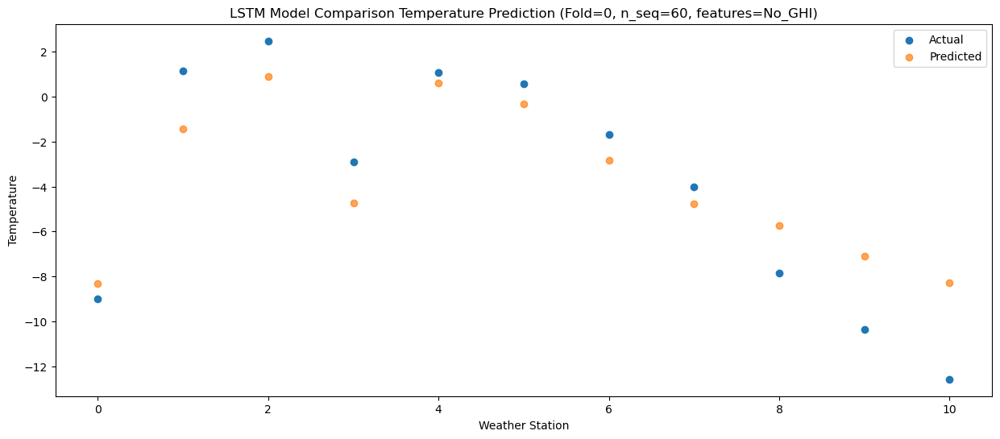

Predictions for (t+16):
    Weather_Station  Actual  Predicted
0                 0    2.07  -0.326860
1                 1    6.20   6.553554
2                 2    8.47   8.865499
3                 3    5.00   3.252242
4                 4   10.99   8.584694
5                 5    5.49   7.660760
6                 6    5.29   5.135587
7                 7    2.52   3.210989
8                 8    4.61   2.260093
9                 9    0.38   0.877180
10               10   -0.85  -0.292887


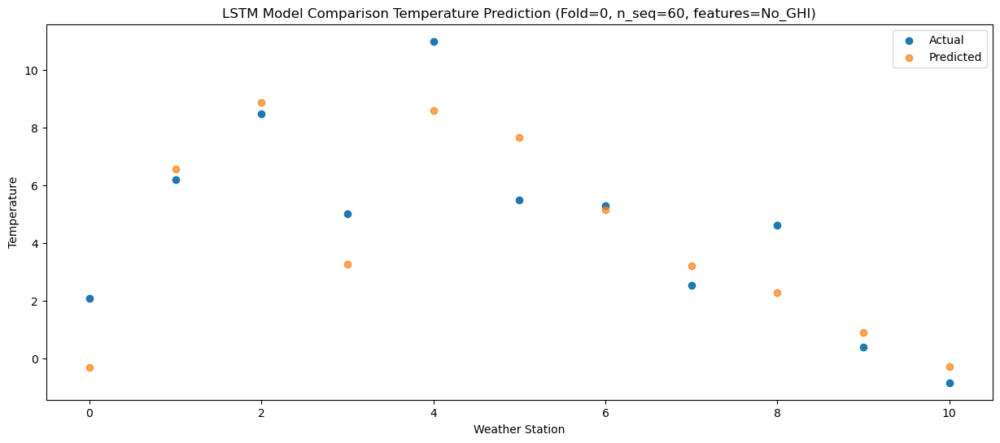

Predictions for (t+17):
    Weather_Station  Actual  Predicted
0                 0    3.60   3.509826
1                 1    7.60  10.388165
2                 2   10.11  12.694954
3                 3    6.79   7.084752
4                 4   12.92  12.418450
5                 5    8.86  11.488931
6                 6    6.32   8.963402
7                 7    6.15   7.038301
8                 8    7.21   6.096031
9                 9    3.44   4.724375
10               10    3.12   3.559889


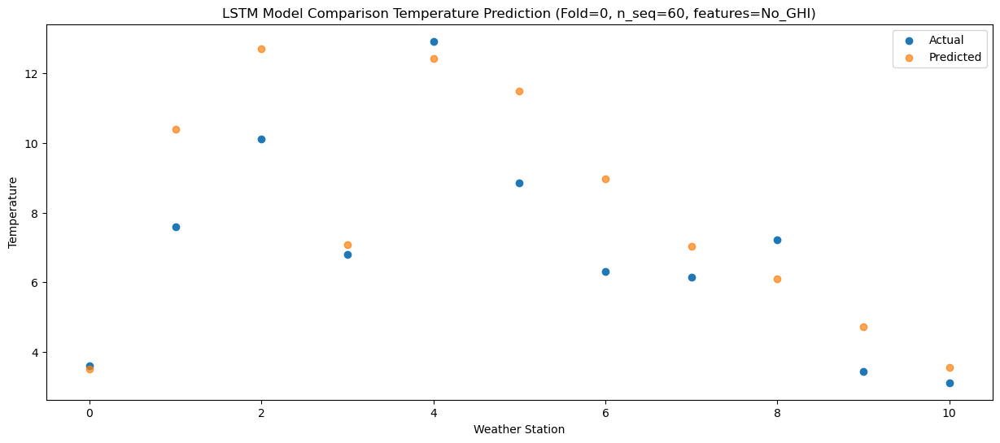

Predictions for (t+18):
    Weather_Station  Actual  Predicted
0                 0    8.10   7.778346
1                 1   11.62  14.655058
2                 2   14.09  16.966923
3                 3   10.76  11.356715
4                 4   16.78  16.696893
5                 5   12.37  15.768565
6                 6   10.03  13.240197
7                 7    9.17  11.314312
8                 8   11.90  10.370398
9                 9    7.91   8.998866
10               10    8.27   7.835347


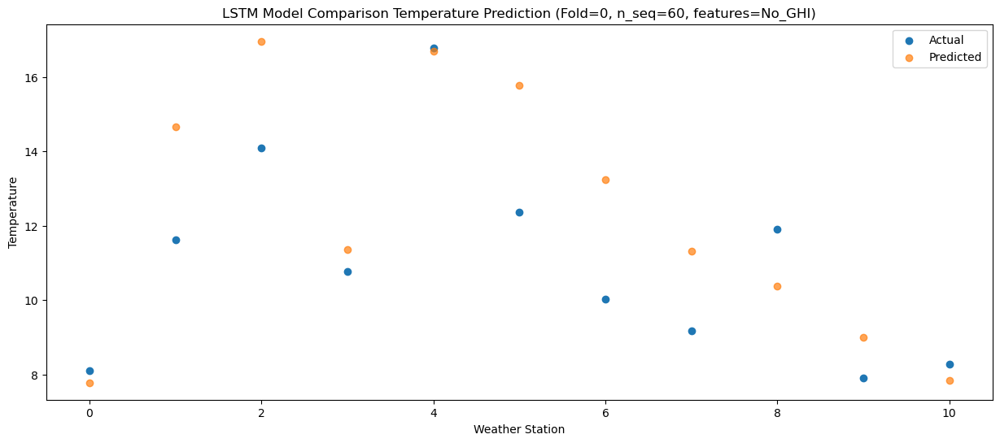

Predictions for (t+19):
    Weather_Station  Actual  Predicted
0                 0   12.77  13.791708
1                 1   15.10  20.660796
2                 2   18.23  22.972476
3                 3   14.04  17.363350
4                 4   21.98  22.708739
5                 5   16.94  21.778886
6                 6   14.36  19.245307
7                 7   13.96  17.320117
8                 8   18.09  16.381658
9                 9   14.39  15.012138
10               10   15.58  13.852361


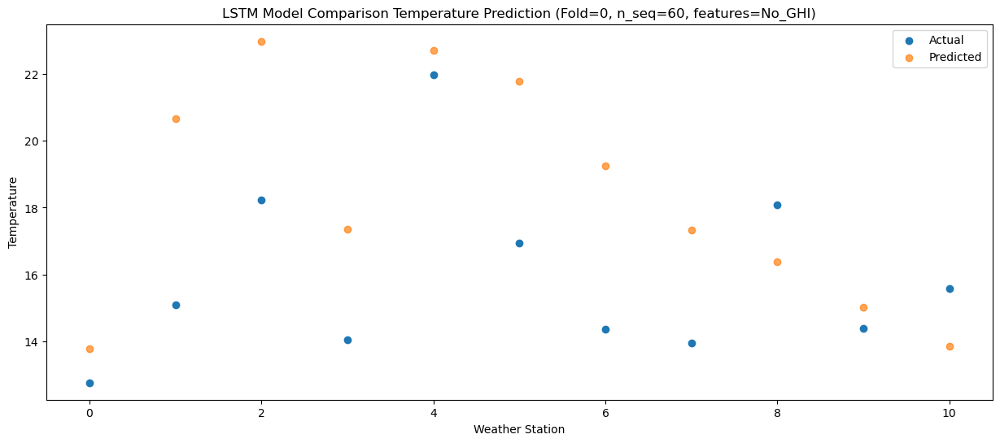

Predictions for (t+20):
    Weather_Station  Actual  Predicted
0                 0   14.36  14.721419
1                 1   16.32  21.590397
2                 2   19.99  23.894515
3                 3   14.67  18.288373
4                 4   22.41  23.630322
5                 5   18.93  22.694506
6                 6   15.98  20.161194
7                 7   16.08  18.232741
8                 8   18.66  17.305429
9                 9   15.40  15.934581
10               10   16.17  14.776462


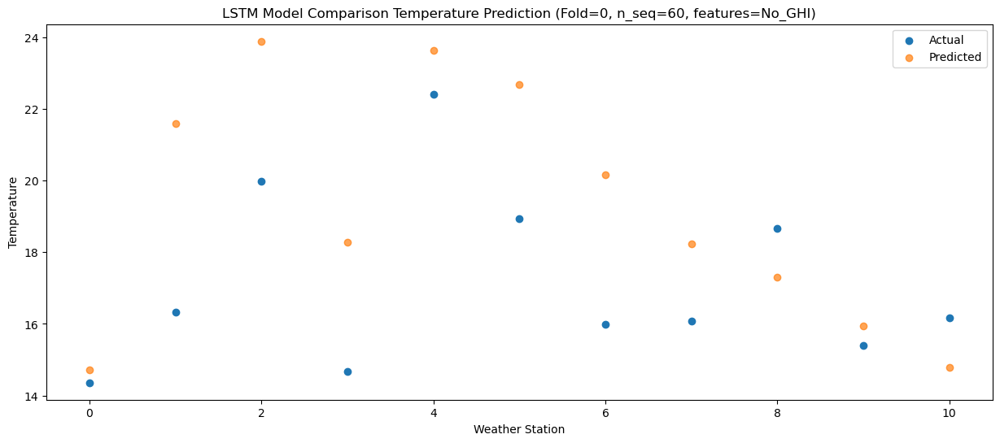

Predictions for (t+21):
    Weather_Station  Actual  Predicted
0                 0   14.47  15.022611
1                 1   16.66  21.896180
2                 2   20.27  24.198917
3                 3   14.72  18.596238
4                 4   23.17  23.934196
5                 5   19.41  23.001588
6                 6   15.92  20.471131
7                 7   16.03  18.546004
8                 8   18.60  17.615154
9                 9   16.00  16.250260
10               10   16.88  15.094297


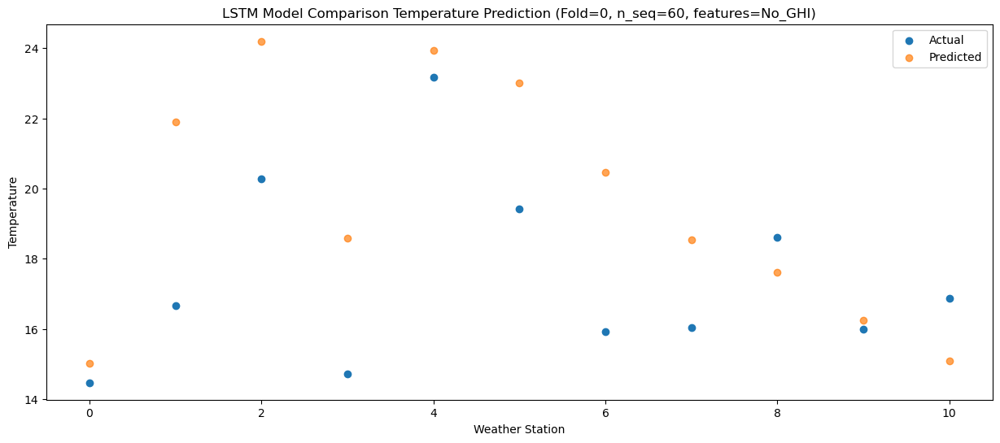

Predictions for (t+22):
    Weather_Station  Actual  Predicted
0                 0   10.89  11.558662
1                 1   14.53  18.433673
2                 2   16.70  20.741285
3                 3   12.21  15.141756
4                 4   21.16  20.476722
5                 5   16.40  19.538138
6                 6   11.87  17.006038
7                 7   11.52  15.079384
8                 8   14.86  14.150913
9                 9   12.14  12.778846
10               10   12.83  11.621316


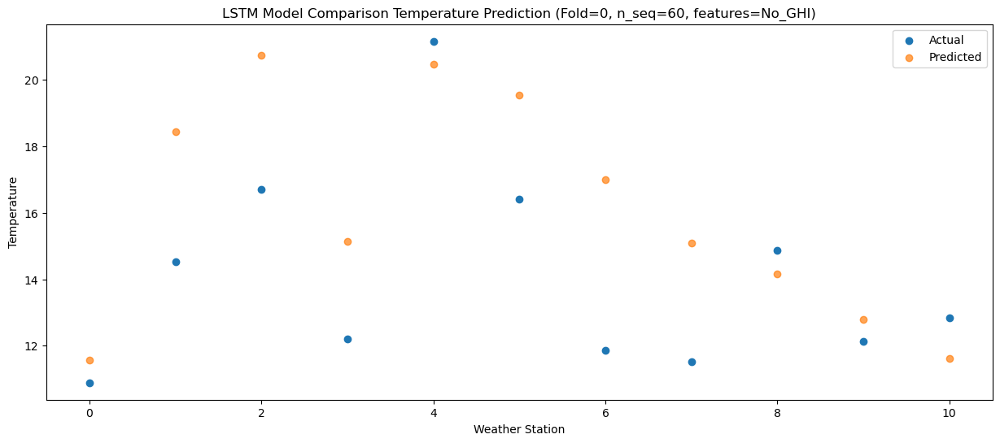

Predictions for (t+23):
    Weather_Station  Actual  Predicted
0                 0    6.87   7.049150
1                 1   11.90  13.927407
2                 2   12.82  16.230536
3                 3    9.90  10.640687
4                 4   16.81  15.976673
5                 5   12.80  15.034396
6                 6    8.64  12.497930
7                 7    7.67  10.568504
8                 8   10.90   9.643715
9                 9    7.67   8.271616
10               10    8.48   7.119476


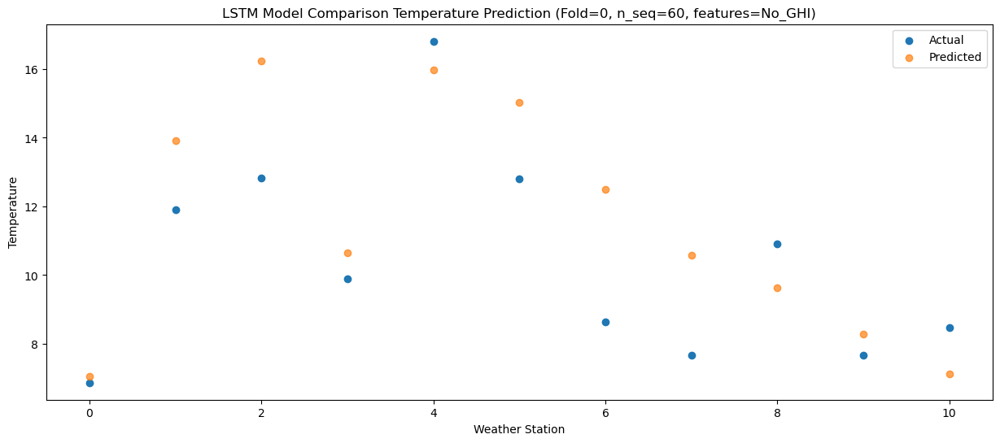

Predictions for (t+24):
    Weather_Station  Actual  Predicted
0                 0   -1.89  -1.654943
1                 1    6.39   5.222939
2                 2    4.46   7.521414
3                 3    1.81   1.929953
4                 4    9.24   7.273816
5                 5    4.63   6.324094
6                 6   -0.01   3.784988
7                 7   -1.83   1.851486
8                 8    0.86   0.929132
9                 9   -2.99  -0.447825
10               10   -2.38  -1.605769


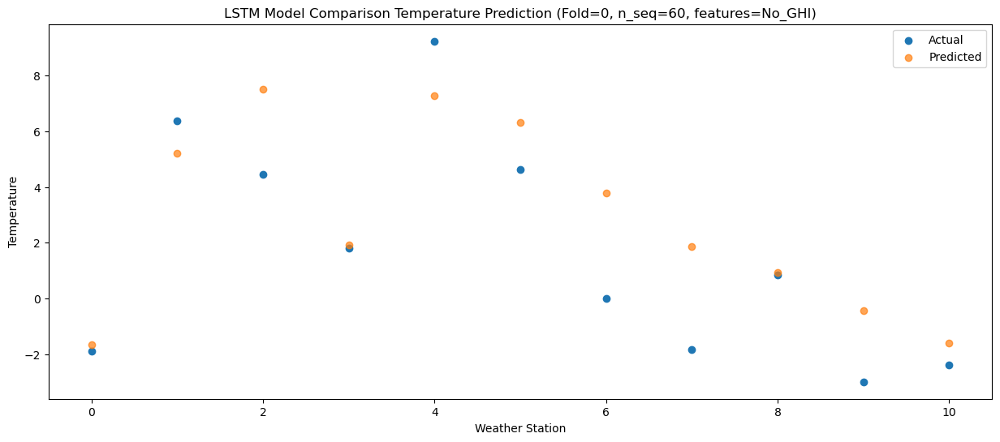

Predictions for (t+25):
    Weather_Station  Actual  Predicted
0                 0    1.49  -3.125646
1                 1    6.15   3.752406
2                 2    6.64   6.050654
3                 3    4.58   0.462302
4                 4   11.57   5.807099
5                 5    5.68   4.849741
6                 6    1.93   2.308165
7                 7    0.23   0.375217
8                 8    2.66  -0.545669
9                 9   -1.76  -1.924910
10               10   -3.28  -3.086885


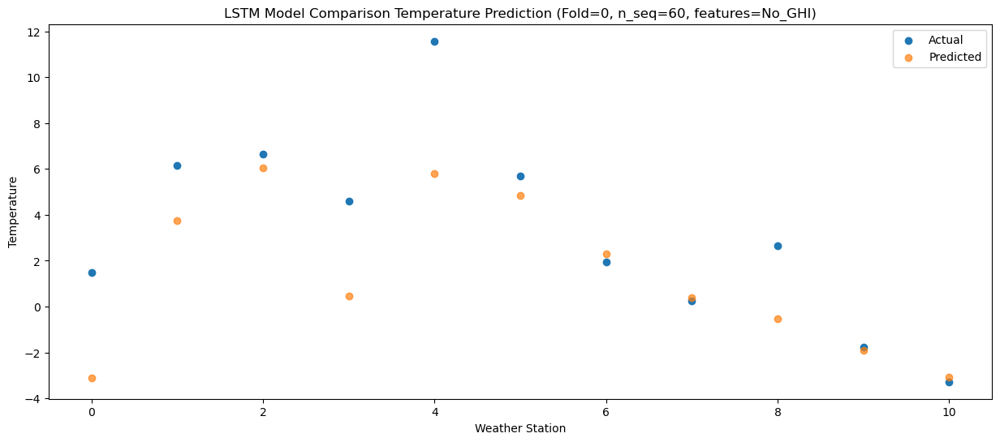

Predictions for (t+26):
    Weather_Station  Actual  Predicted
0                 0   -6.76  -9.614598
1                 1   -0.53  -2.733729
2                 2    0.63  -0.439689
3                 3   -2.77  -6.025037
4                 4    3.12  -0.686923
5                 5   -0.70  -1.643992
6                 6   -4.72  -4.183007
7                 7   -6.95  -6.114783
8                 8   -5.85  -7.038136
9                 9  -10.73  -8.421621
10               10  -12.23  -9.588411


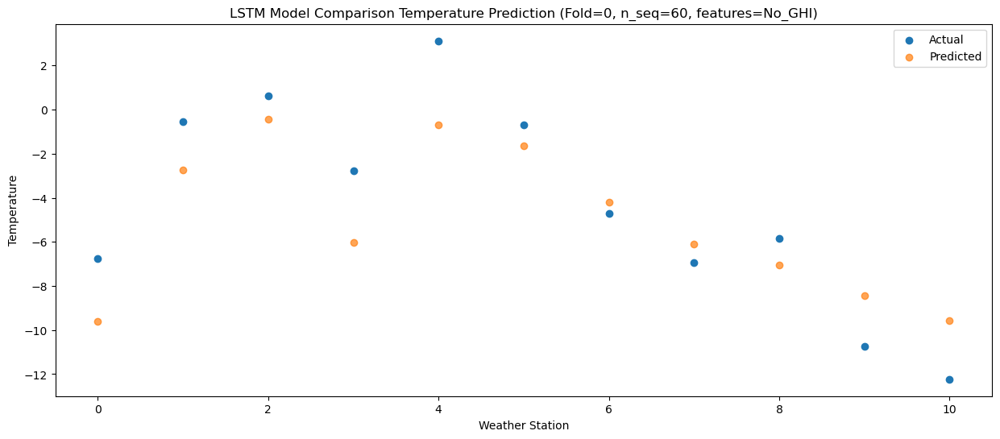

Predictions for (t+27):
    Weather_Station  Actual  Predicted
0                 0   -5.24  -6.786732
1                 1    2.24   0.090439
2                 2    4.58   2.387358
3                 3   -0.33  -3.202419
4                 4    2.89   2.137974
5                 5    2.91   1.185803
6                 6   -0.74  -1.358418
7                 7   -2.71  -3.290820
8                 8   -3.81  -4.207080
9                 9   -7.15  -5.593854
10               10   -8.99  -6.761756


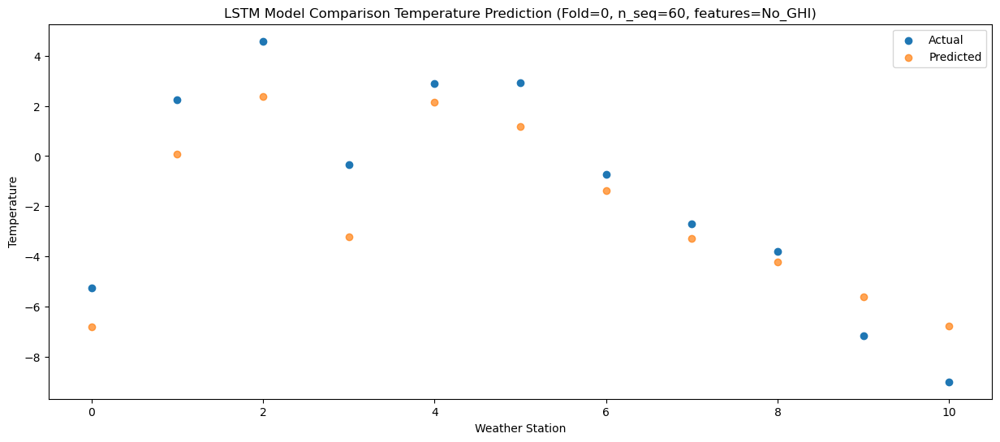

Predictions for (t+28):
    Weather_Station  Actual  Predicted
0                 0    0.34  -1.195402
1                 1    6.10   5.677039
2                 2    8.08   7.972896
3                 3    3.46   2.384565
4                 4    9.38   7.727664
5                 5    6.83   6.775047
6                 6    3.60   4.230330
7                 7    2.13   2.296811
8                 8    3.41   1.385090
9                 9   -0.17  -0.001809
10               10   -2.08  -1.165617


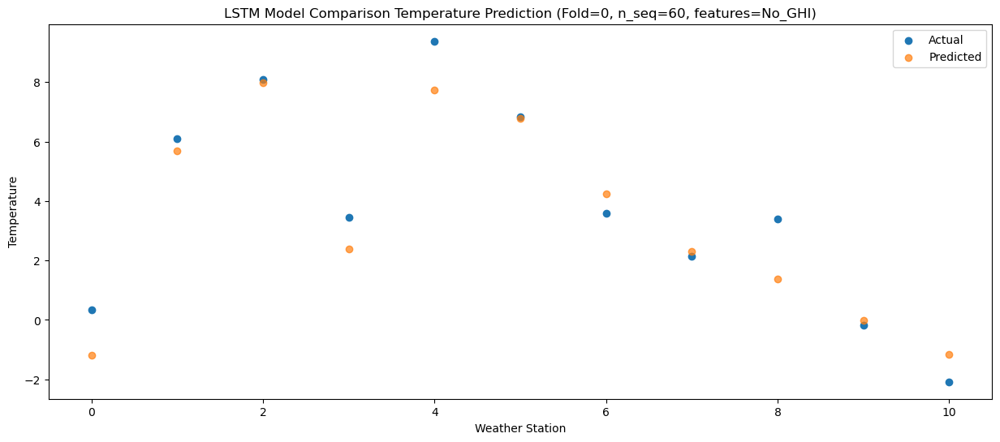

Predictions for (t+29):
    Weather_Station  Actual  Predicted
0                 0    4.47   2.240953
1                 1    9.07   9.110231
2                 2   10.82  11.401722
3                 3    8.25   5.819305
4                 4   15.42  11.163128
5                 5    9.70  10.205231
6                 6    6.52   7.657353
7                 7    5.45   5.722727
8                 8    7.36   4.816810
9                 9    2.56   3.425488
10               10    1.53   2.263778


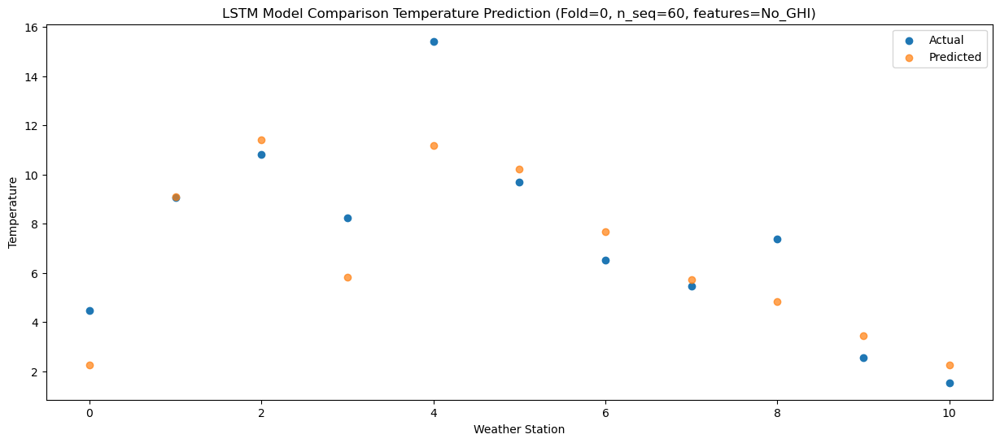

Predictions for (t+30):
    Weather_Station  Actual  Predicted
0                 0   10.66   8.918142
1                 1   13.38  15.781512
2                 2   16.58  18.072715
3                 3   12.77  12.492857
4                 4   20.13  17.836152
5                 5   14.33  16.875453
6                 6   11.59  14.328171
7                 7   10.43  12.392443
8                 8   14.20  11.486086
9                 9   10.73  10.099597
10               10   10.85   8.943862


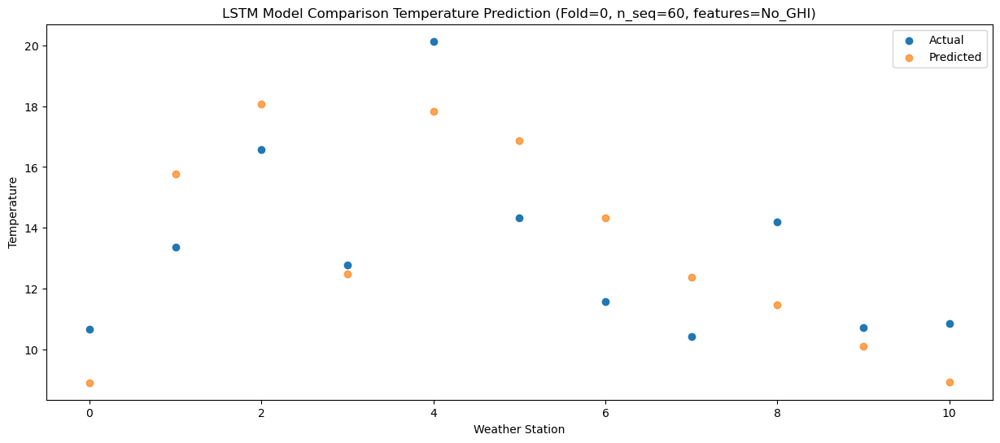

Predictions for (t+31):
    Weather_Station  Actual  Predicted
0                 0   13.87  12.963768
1                 1   17.07  19.817701
2                 2   20.36  22.106347
3                 3   15.20  16.524075
4                 4   24.47  21.868220
5                 5   17.90  20.909208
6                 6   15.50  18.356829
7                 7   14.43  16.419812
8                 8   18.72  15.515696
9                 9   14.63  14.125494
10               10   15.61  12.972340


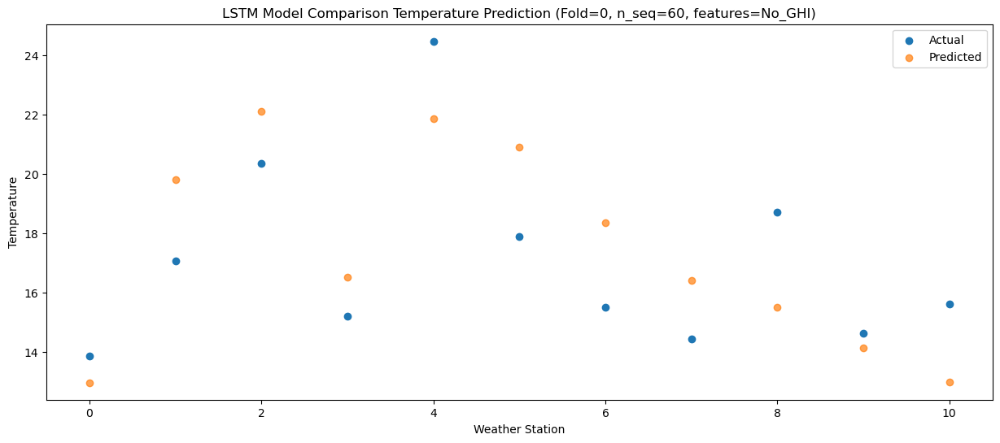

Predictions for (t+32):
    Weather_Station  Actual  Predicted
0                 0   16.09  15.305113
1                 1   17.21  22.158988
2                 2   21.28  24.446688
3                 3   15.18  18.868694
4                 4   26.83  24.209110
5                 5   20.04  23.246167
6                 6   16.60  20.694439
7                 7   16.30  18.757045
8                 8   21.05  17.849409
9                 9   16.66  16.458077
10               10   16.72  15.304714


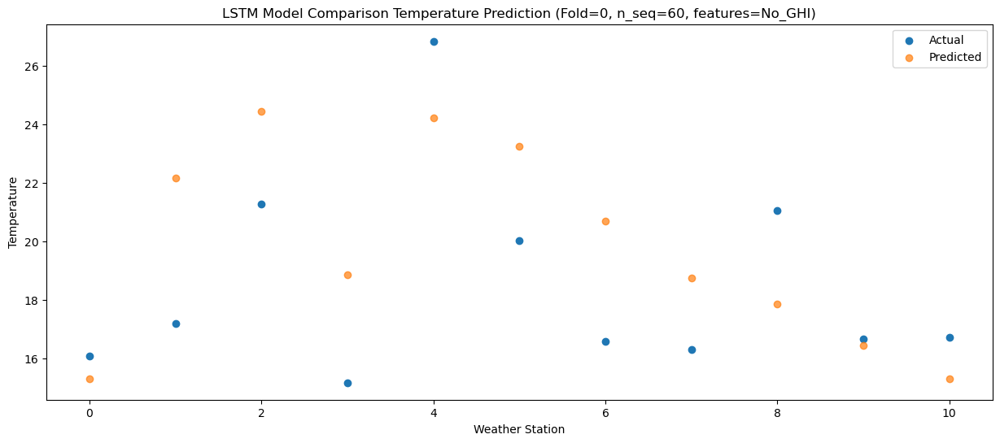

Predictions for (t+33):
    Weather_Station  Actual  Predicted
0                 0   13.91  14.574285
1                 1   16.66  21.422849
2                 2   20.05  23.713912
3                 3   13.99  18.132967
4                 4   24.47  23.474683
5                 5   19.19  22.520874
6                 6   15.31  19.963562
7                 7   14.62  18.030588
8                 8   18.17  17.120514
9                 9   14.75  15.730205
10               10   15.60  14.577286


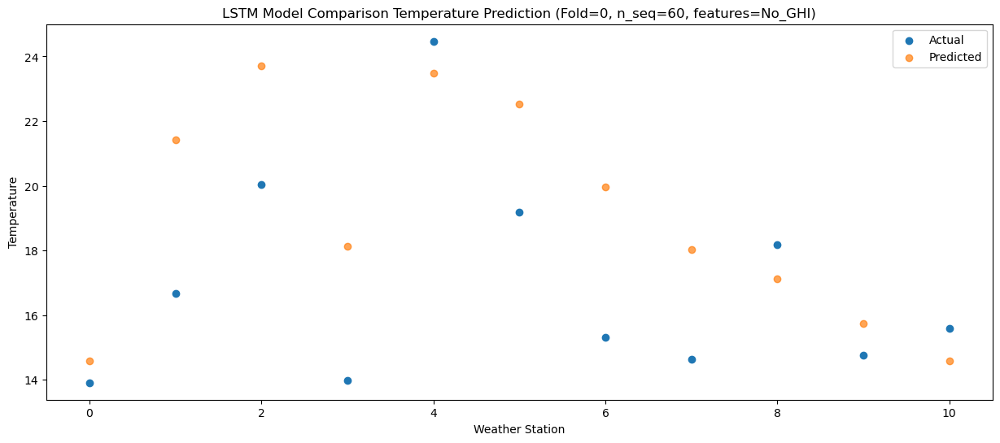

Predictions for (t+34):
    Weather_Station  Actual  Predicted
0                 0   10.94  11.070866
1                 1   15.64  17.912237
2                 2   16.93  20.205228
3                 3   12.75  14.618475
4                 4   21.52  19.965624
5                 5   16.54  19.015810
6                 6   12.25  16.459124
7                 7   10.92  14.527332
8                 8   14.53  13.623036
9                 9   11.02  12.232812
10               10   11.76  11.077558


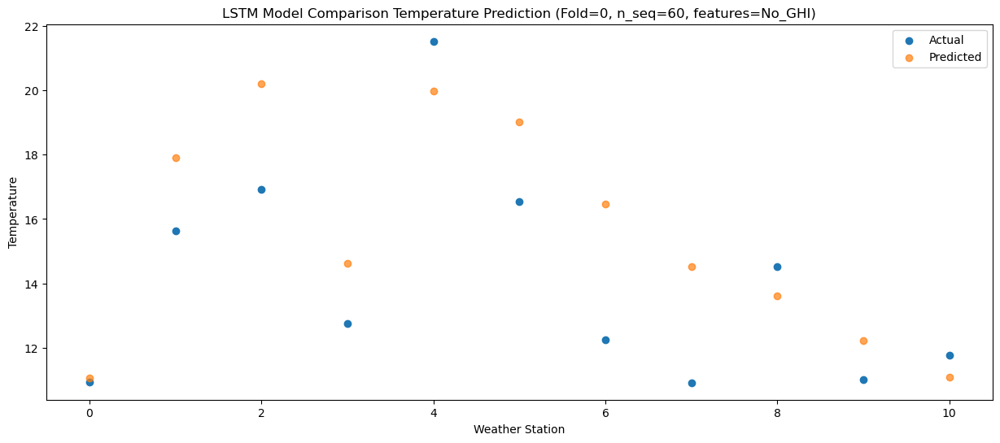

Predictions for (t+35):
    Weather_Station  Actual  Predicted
0                 0    5.26   4.723272
1                 1   10.04  11.559106
2                 2    9.79  13.852925
3                 3    7.13   8.260033
4                 4   15.60  13.606673
5                 5    9.98  12.668571
6                 6    5.31  10.114049
7                 7    3.73   8.184037
8                 8    7.97   7.274034
9                 9    3.98   5.884555
10               10    4.52   4.727297


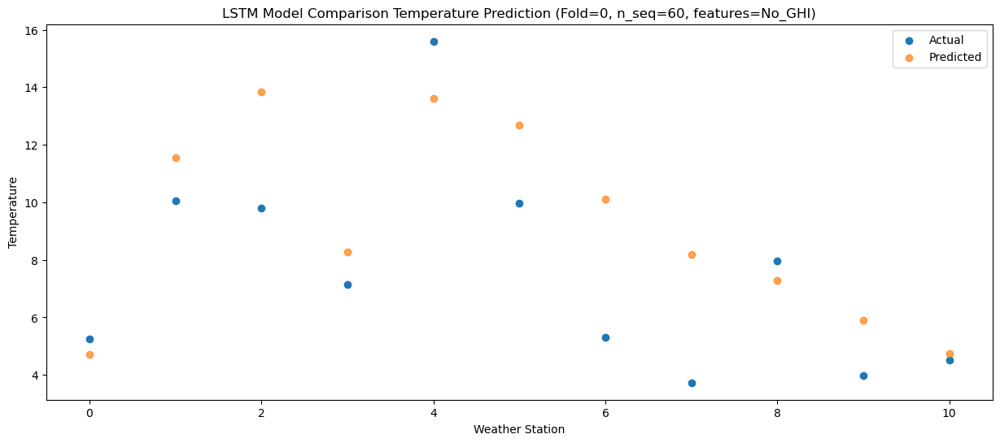

Predictions for (t+36):
    Weather_Station  Actual  Predicted
0                 0   -1.69  -0.819618
1                 1    7.35   6.015051
2                 2    7.31   8.307230
3                 3    3.02   2.712766
4                 4    8.67   8.059519
5                 5    8.29   7.121419
6                 6    3.08   4.566311
7                 7    1.53   2.636510
8                 8    2.00   1.730738
9                 9   -1.04   0.346374
10               10   -0.51  -0.809625


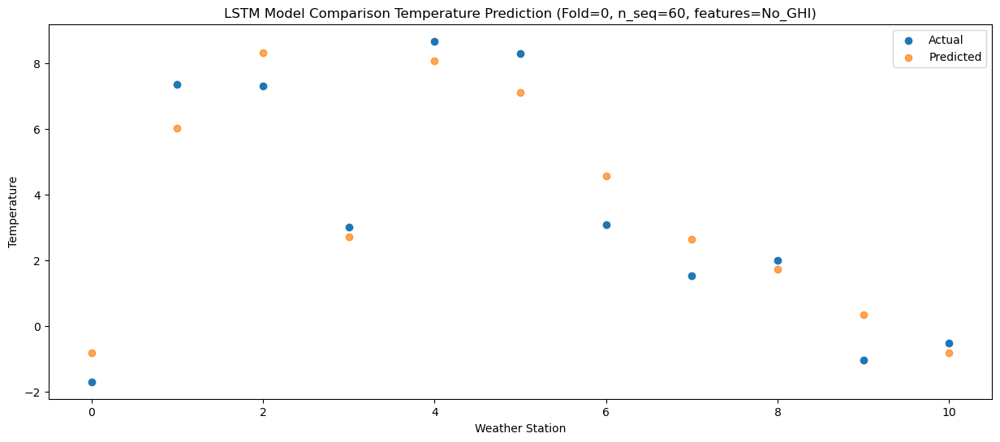

Predictions for (t+37):
    Weather_Station  Actual  Predicted
0                 0   -3.78  -6.732990
1                 1    3.50   0.107432
2                 2    2.79   2.398438
3                 3    0.84  -3.180952
4                 4    5.94   2.162735
5                 5    1.77   1.217837
6                 6   -3.43  -1.339574
7                 7   -5.64  -3.272124
8                 8   -3.29  -4.178031
9                 9   -6.75  -5.568174
10               10   -6.69  -6.730829


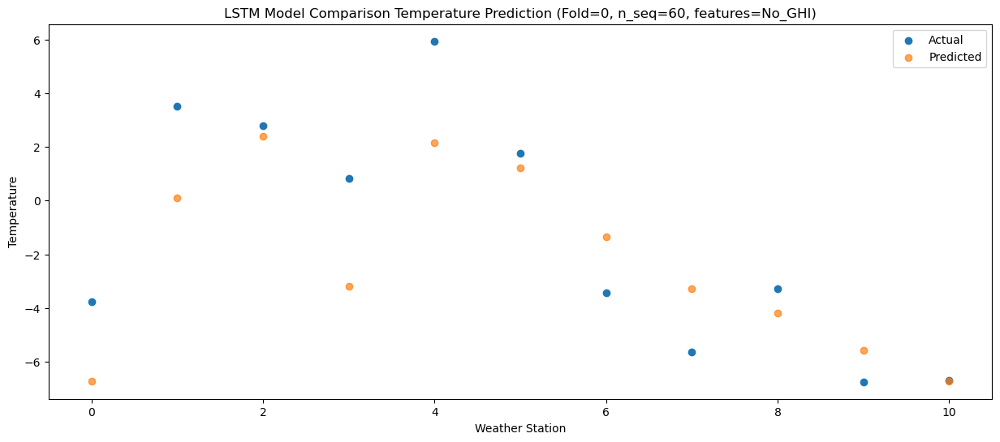

Predictions for (t+38):
    Weather_Station  Actual  Predicted
0                 0   -2.14  -4.754658
1                 1    4.29   2.083898
2                 2    4.74   4.376048
3                 3    2.28  -1.202286
4                 4    6.91   4.139463
5                 5    3.46   3.196739
6                 6   -0.24   0.640868
7                 7   -2.47  -1.289275
8                 8   -0.73  -2.194541
9                 9   -4.86  -3.579235
10               10   -5.56  -4.737792


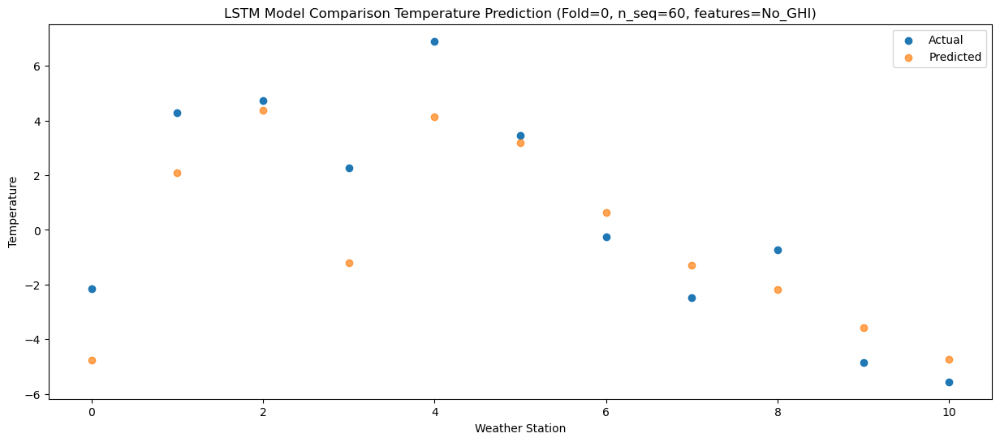

Predictions for (t+39):
    Weather_Station  Actual  Predicted
0                 0   -0.61  -3.898253
1                 1    5.39   2.935865
2                 2    7.52   5.229818
3                 3    2.69  -0.349040
4                 4    7.04   4.993194
5                 5    4.95   4.056243
6                 6    2.76   1.498500
7                 7    0.50  -0.428881
8                 8    0.88  -1.330932
9                 9   -2.82  -2.723700
10               10   -5.15  -3.886804


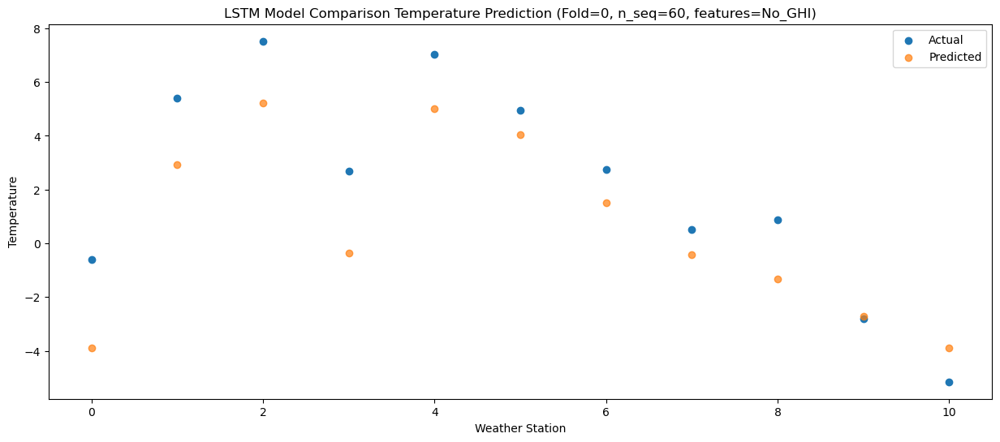

Predictions for (t+40):
    Weather_Station  Actual  Predicted
0                 0    1.76  -2.375346
1                 1    6.98   4.449871
2                 2    7.50   6.743357
3                 3    6.21   1.157920
4                 4   11.76   6.505266
5                 5    5.86   5.569355
6                 6    3.24   3.009158
7                 7    1.18   1.082618
8                 8    2.70   0.189412
9                 9   -2.48  -1.200572
10               10   -3.29  -2.362033


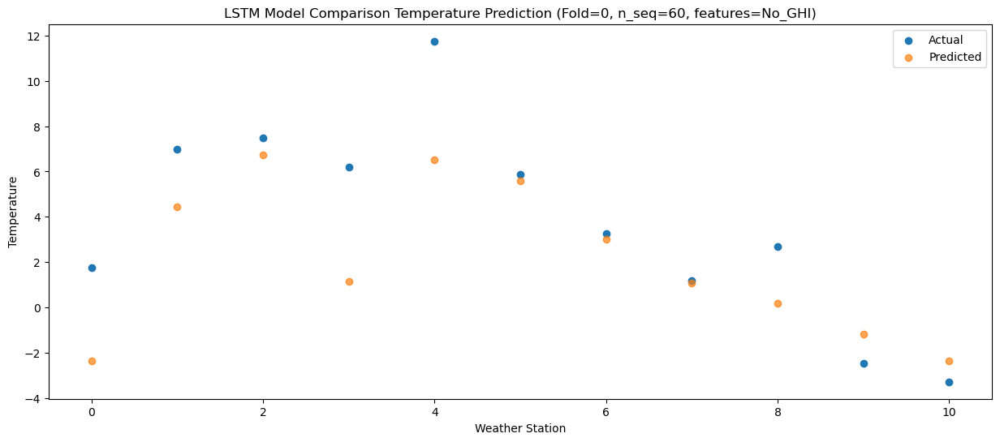

Predictions for (t+41):
    Weather_Station  Actual  Predicted
0                 0    4.38   4.152400
1                 1    9.13  10.968288
2                 2   10.57  13.262050
3                 3    7.63   7.678963
4                 4   13.26  13.027072
5                 5   10.54  12.098839
6                 6    6.80   9.533060
7                 7    5.80   7.609614
8                 8    8.48   6.721810
9                 9    3.80   5.332360
10               10    3.56   4.173110


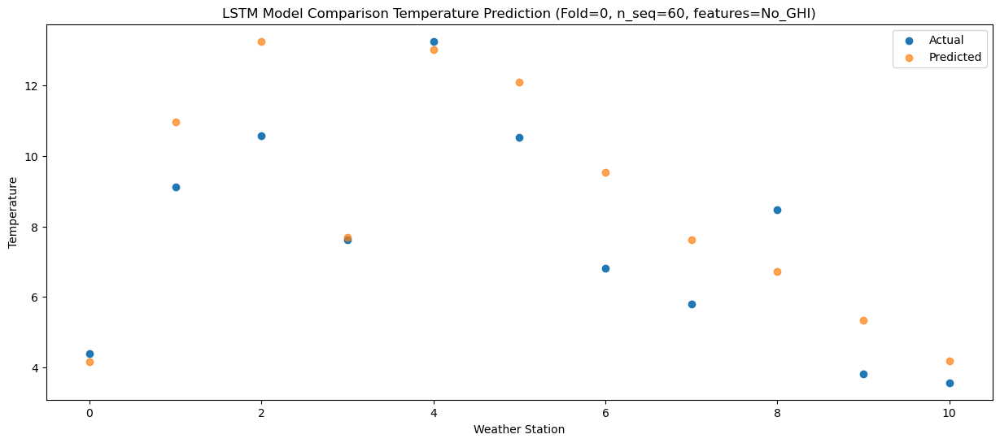

Predictions for (t+42):
    Weather_Station  Actual  Predicted
0                 0    9.85   8.470523
1                 1   12.31  15.284014
2                 2   13.98  17.580242
3                 3   12.06  11.997971
4                 4   18.79  17.346383
5                 5   12.06  16.416126
6                 6    9.49  13.850752
7                 7    8.09  11.925983
8                 8   14.07  11.037051
9                 9    8.76   9.646524
10               10    8.58   8.491569


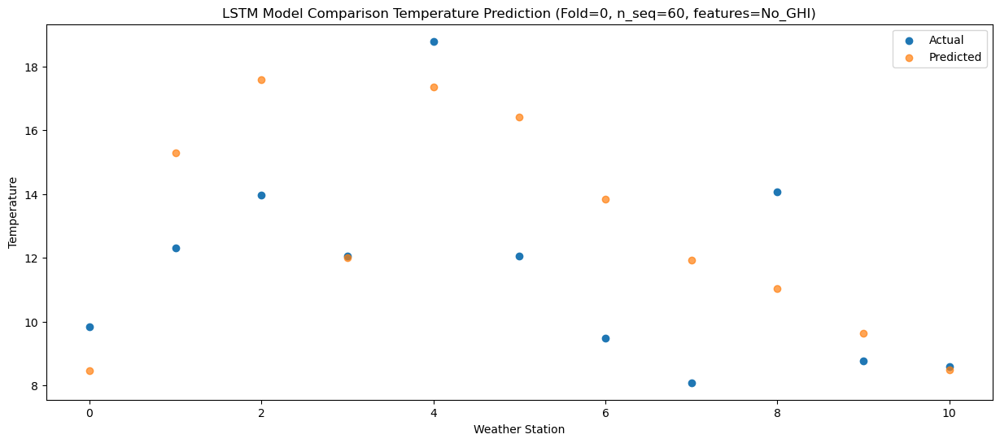

Predictions for (t+43):
    Weather_Station  Actual  Predicted
0                 0   13.63  11.865864
1                 1   15.39  18.669972
2                 2   17.30  20.964924
3                 3   15.81  15.385668
4                 4   23.34  20.738540
5                 5   15.88  19.806507
6                 6   12.84  17.238727
7                 7   11.84  15.312096
8                 8   17.94  14.430773
9                 9   12.60  13.040901
10               10   14.09  11.883714


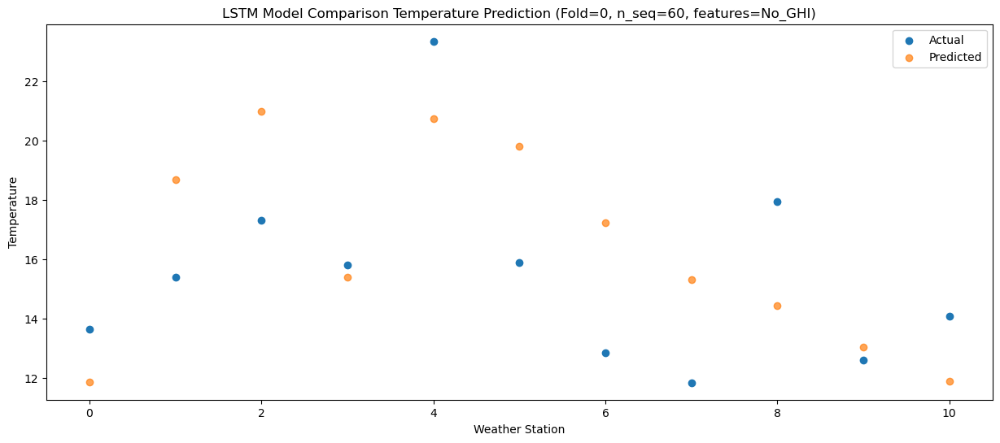

Predictions for (t+44):
    Weather_Station  Actual  Predicted
0                 0   15.17  15.079974
1                 1   17.22  21.886582
2                 2   20.40  24.179697
3                 3   16.93  18.607393
4                 4   26.33  23.960335
5                 5   19.71  23.029590
6                 6   16.55  20.460641
7                 7   15.98  18.536458
8                 8   19.43  17.652499
9                 9   15.43  16.262420
10               10   16.55  15.106632


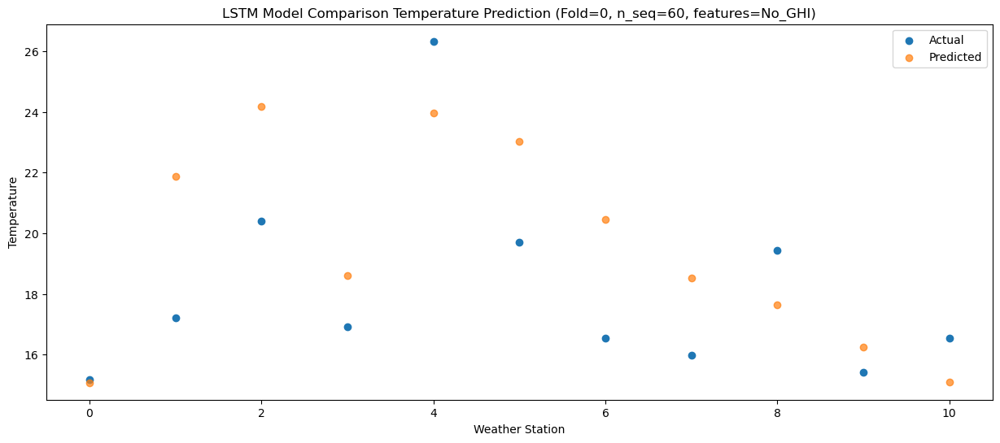

Predictions for (t+45):
    Weather_Station  Actual  Predicted
0                 0   15.89  13.956478
1                 1   18.81  20.759846
2                 2   20.01  23.057731
3                 3   18.46  17.486792
4                 4   28.07  22.843528
5                 5   19.23  21.908858
6                 6   15.86  19.339656
7                 7   14.84  17.416581
8                 8   18.17  16.534239
9                 9   14.63  15.141947
10               10   14.74  13.985067


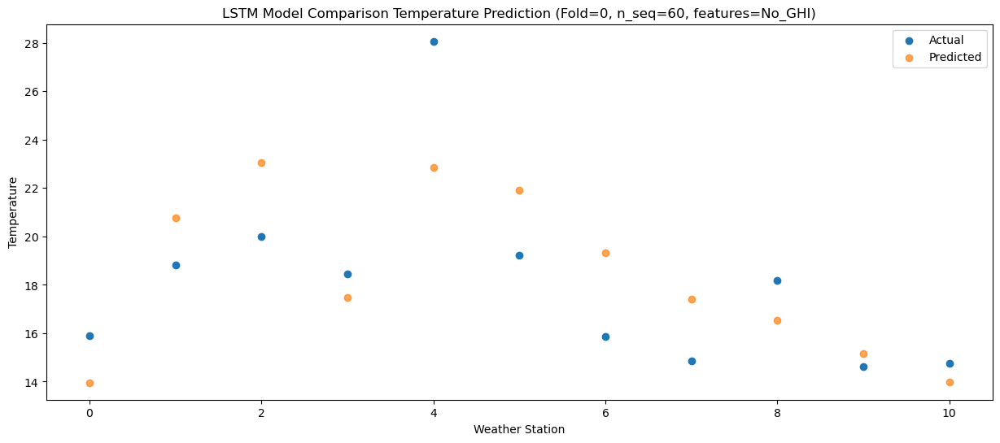

Predictions for (t+46):
    Weather_Station  Actual  Predicted
0                 0   11.66  10.921051
1                 1   15.43  17.727417
2                 2   16.56  20.023907
3                 3   15.02  14.453080
4                 4   23.59  19.818954
5                 5   15.71  18.875475
6                 6   12.35  16.307071
7                 7   11.08  14.383319
8                 8   15.00  13.503190
9                 9   12.02  12.108904
10               10   12.36  10.950317


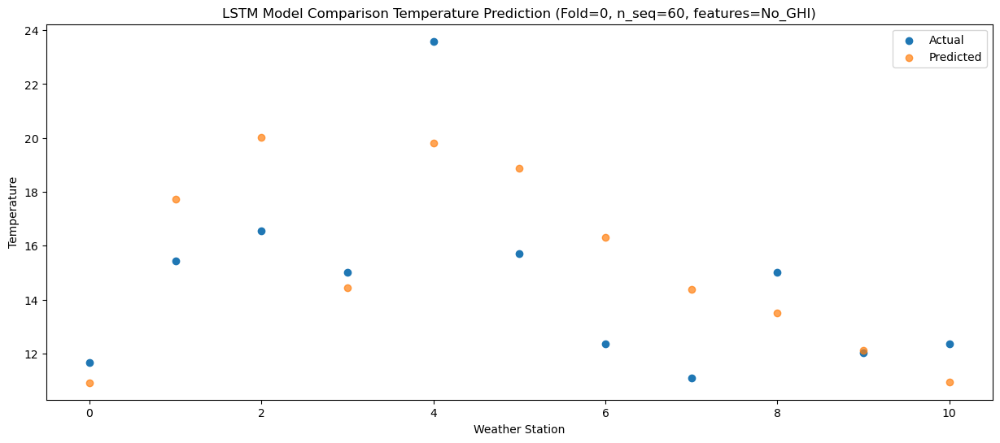

Predictions for (t+47):
    Weather_Station  Actual  Predicted
0                 0    6.60   5.430181
1                 1   10.32  12.241516
2                 2   10.58  14.536473
3                 3    8.77   8.964585
4                 4   15.93  14.329918
5                 5   11.36  13.391119
6                 6    7.14  10.826453
7                 7    5.69   8.902727
8                 8    9.40   8.019457
9                 9    5.44   6.624058
10               10    6.40   5.463175


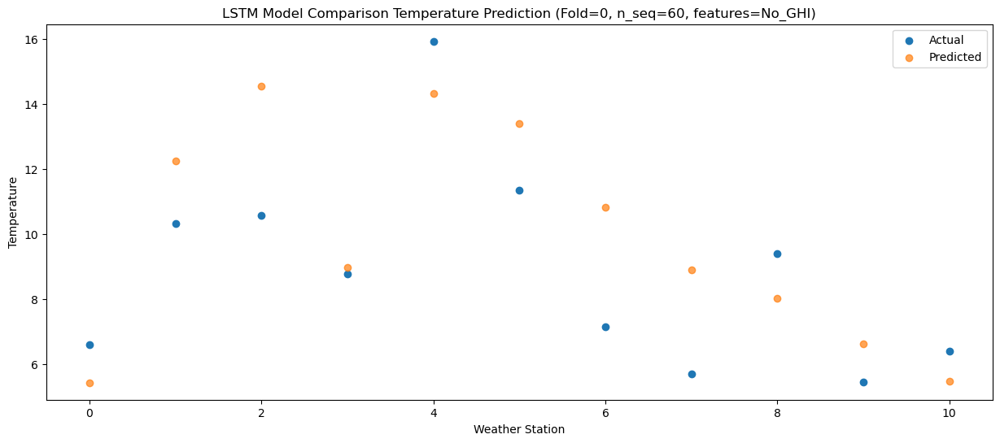

Predictions for (t+48):
    Weather_Station  Actual  Predicted
0                 0   -0.26  -0.539315
1                 1    5.08   6.275342
2                 2    5.49   8.568307
3                 3    2.91   3.003672
4                 4    9.57   8.367176
5                 5    5.92   7.428351
6                 6    1.27   4.862505
7                 7   -0.76   2.938793
8                 8    2.41   2.056871
9                 9   -1.06   0.664695
10               10   -1.24  -0.495371


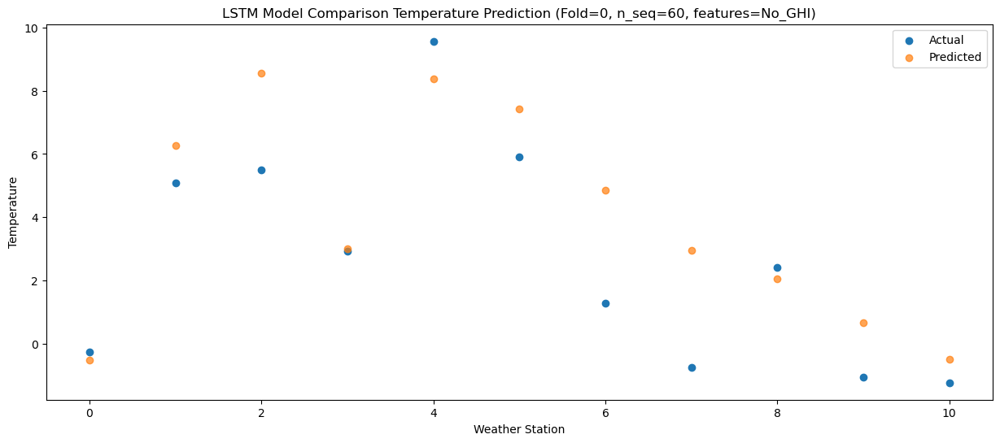

Predictions for (t+49):
    Weather_Station  Actual  Predicted
0                 0   -2.86  -2.205490
1                 1    2.38   4.614363
2                 2    2.46   6.905206
3                 3    0.12   1.337705
4                 4    6.78   6.697231
5                 5    3.78   5.766695
6                 6   -1.02   3.203551
7                 7   -2.35   1.282693
8                 8   -0.15   0.398176
9                 9   -3.49  -0.989348
10               10   -1.92  -2.139387


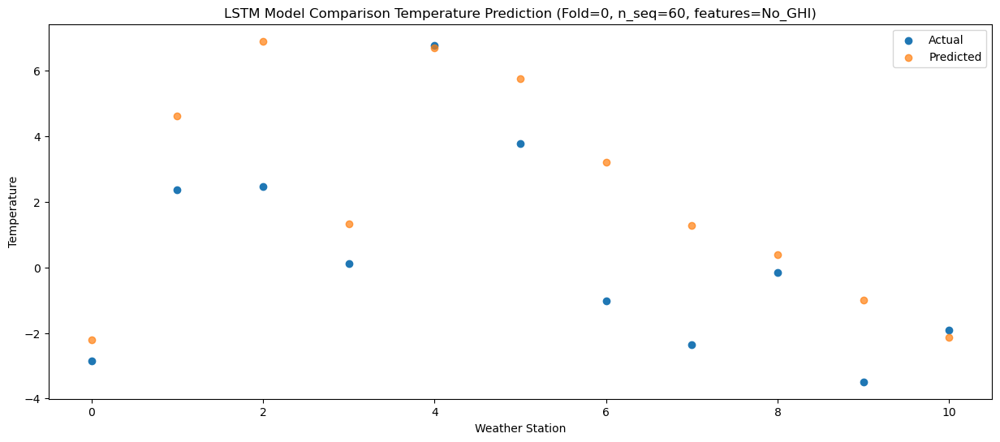

Predictions for (t+50):
    Weather_Station  Actual  Predicted
0                 0   -7.98  -6.977897
1                 1    0.11  -0.151807
2                 2   -0.05   2.138505
3                 3   -2.76  -3.426380
4                 4    1.80   1.935974
5                 5    2.51   0.997842
6                 6   -3.15  -1.566325
7                 7   -5.05  -3.492670
8                 8   -6.41  -4.382550
9                 9   -9.25  -5.772256
10               10   -8.84  -6.925348


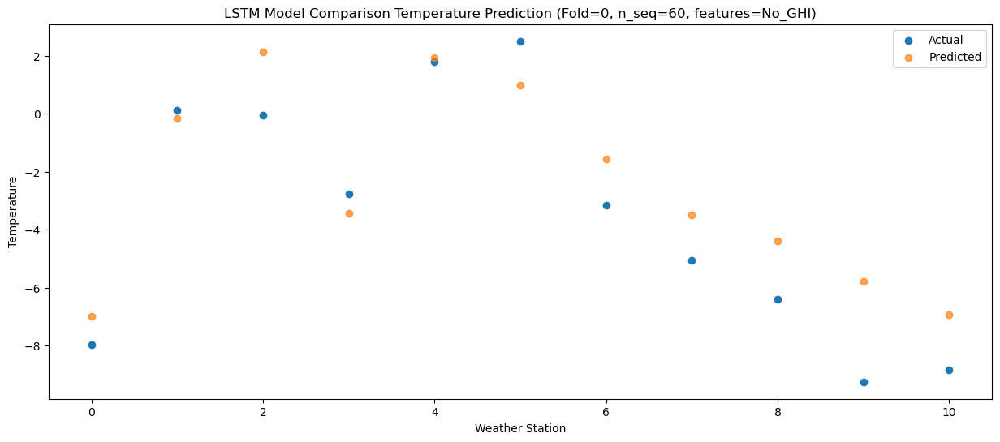

Predictions for (t+51):
    Weather_Station  Actual  Predicted
0                 0   -0.10  -3.333448
1                 1    2.61   3.495955
2                 2    4.46   5.781011
3                 3    1.89   0.219691
4                 4    9.67   5.583138
5                 5    3.03   4.640455
6                 6    0.41   2.074825
7                 7   -1.91   0.145848
8                 8    2.21  -0.740764
9                 9   -3.11  -2.129544
10               10   -3.83  -3.281173


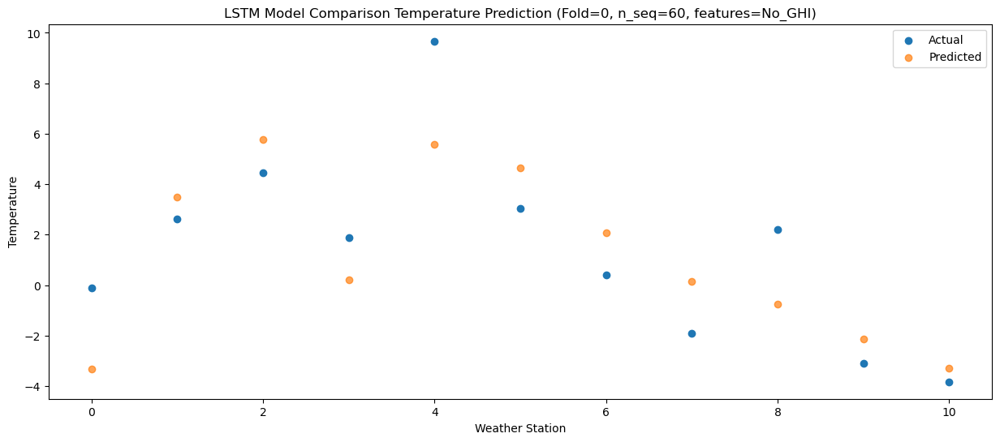

Predictions for (t+52):
    Weather_Station  Actual  Predicted
0                 0    1.65   0.112468
1                 1    5.91   6.945119
2                 2    8.84   9.229561
3                 3    4.83   3.661440
4                 4   12.22   9.030988
5                 5    7.08   8.097866
6                 6    4.25   5.531277
7                 7    2.24   3.604299
8                 8    5.49   2.711494
9                 9    0.21   1.320735
10               10   -0.33   0.172290


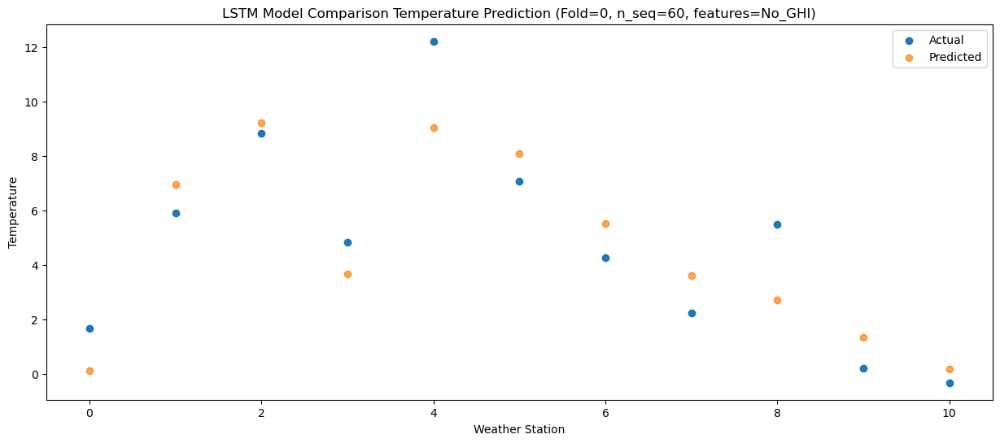

Predictions for (t+53):
    Weather_Station  Actual  Predicted
0                 0    6.42   4.242773
1                 1    8.79  11.078872
2                 2   12.53  13.360796
3                 3    8.40   7.799898
4                 4   15.49  13.176723
5                 5   10.30  12.235153
6                 6    7.84   9.666230
7                 7    6.72   7.733655
8                 8   10.37   6.842741
9                 9    5.43   5.452500
10               10    5.01   4.305347


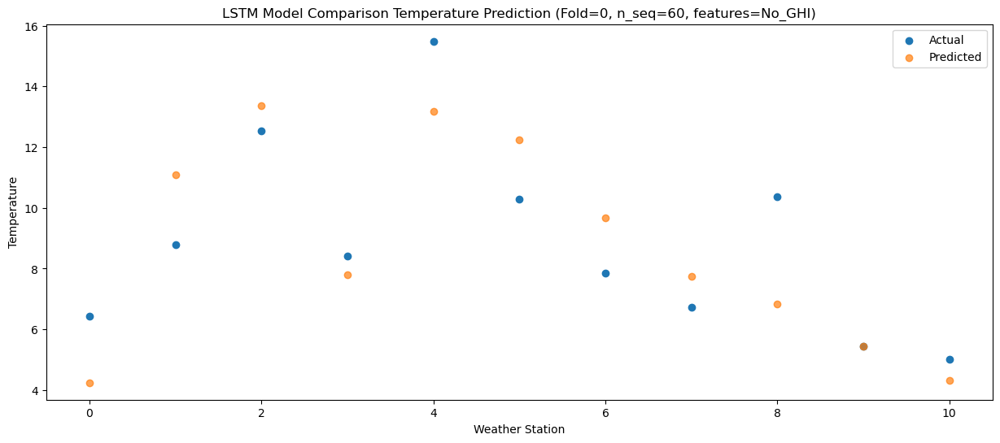

Predictions for (t+54):
    Weather_Station  Actual  Predicted
0                 0   11.33   9.797756
1                 1   13.28  16.636963
2                 2   17.01  18.922305
3                 3   12.79  13.361803
4                 4   20.07  18.732373
5                 5   15.11  17.795477
6                 6   11.84  15.225184
7                 7   10.68  13.292444
8                 8   15.44  12.396374
9                 9   11.23  11.005275
10               10   11.98   9.857710


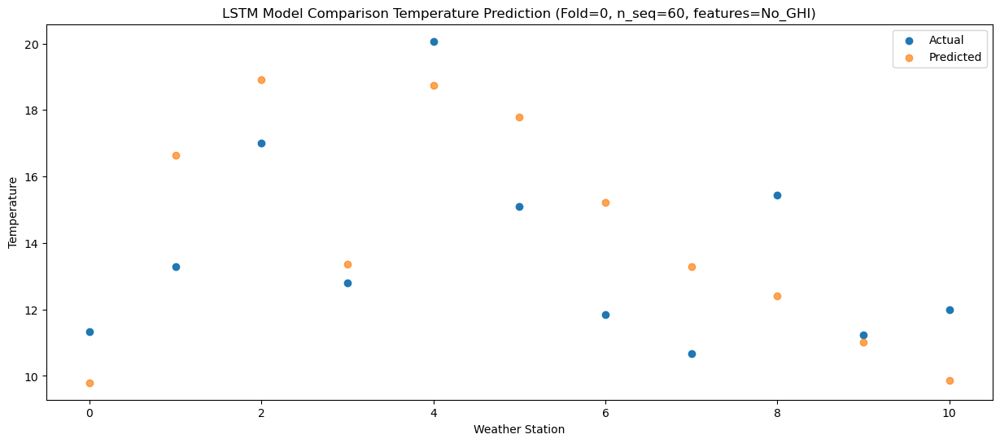

Predictions for (t+55):
    Weather_Station  Actual  Predicted
0                 0   13.94  13.626561
1                 1   16.21  20.459705
2                 2   21.25  22.746549
3                 3   14.91  17.182326
4                 4   23.57  22.560929
5                 5   18.54  21.620702
6                 6   15.75  19.053372
7                 7   14.70  17.121336
8                 8   18.37  16.227850
9                 9   14.99  14.834042
10               10   16.30  13.689404


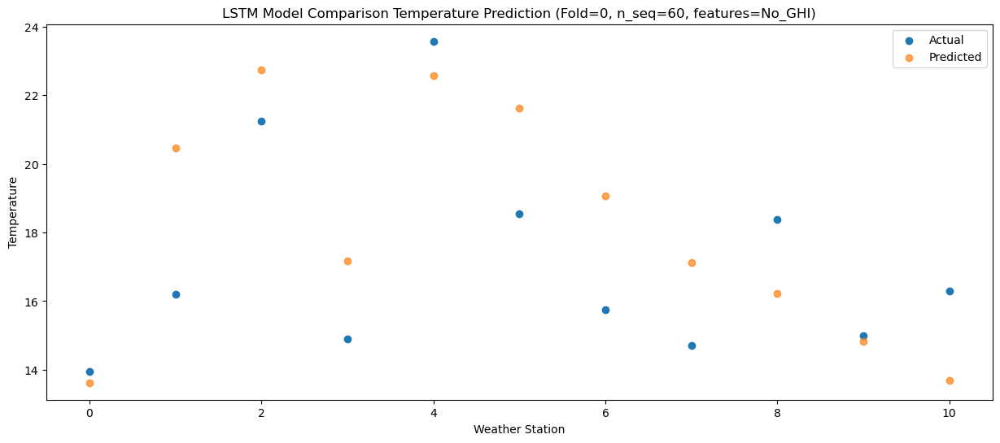

Predictions for (t+56):
    Weather_Station  Actual  Predicted
0                 0   14.82  15.235802
1                 1   17.34  22.063007
2                 2   21.52  24.347560
3                 3   14.85  18.777086
4                 4   23.43  24.155868
5                 5   20.20  23.217465
6                 6   17.01  20.649990
7                 7   15.92  18.718794
8                 8   18.92  17.828291
9                 9   15.83  16.441267
10               10   17.19  15.300134


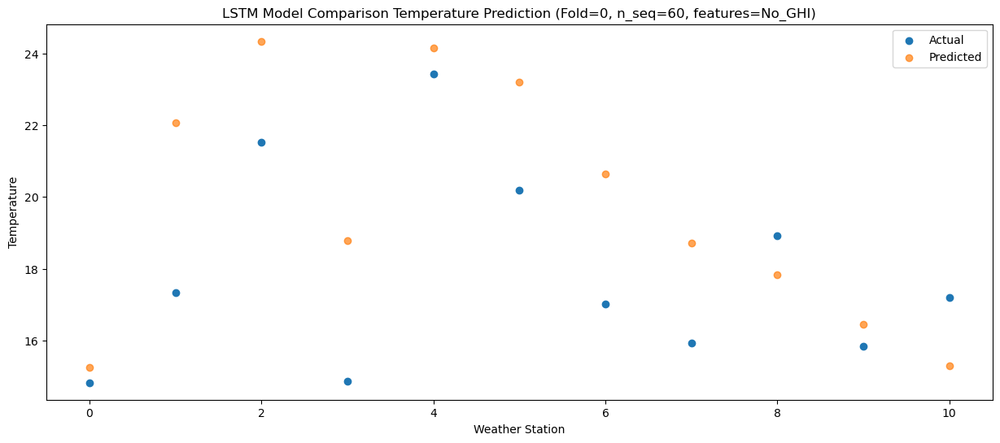

Predictions for (t+57):
    Weather_Station  Actual  Predicted
0                 0   15.16  14.168597
1                 1   17.73  20.997343
2                 2   19.84  23.275463
3                 3   15.66  17.709414
4                 4   25.11  23.090285
5                 5   18.93  22.146333
6                 6   15.26  19.577548
7                 7   14.08  17.642319
8                 8   18.86  16.751598
9                 9   15.50  15.363260
10               10   16.44  14.221204


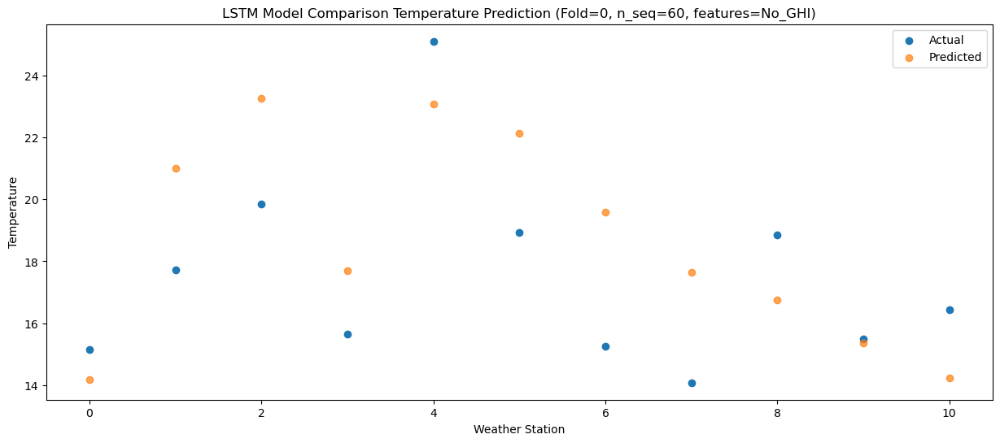

Predictions for (t+58):
    Weather_Station  Actual  Predicted
0                 0   11.02  11.784747
1                 1   14.49  18.616736
2                 2   17.07  20.897171
3                 3   13.07  15.334078
4                 4   21.19  20.711228
5                 5   16.99  19.761472
6                 6   12.83  17.193784
7                 7   11.15  15.254877
8                 8   15.24  14.369056
9                 9   13.31  12.981524
10               10   13.66  11.834765


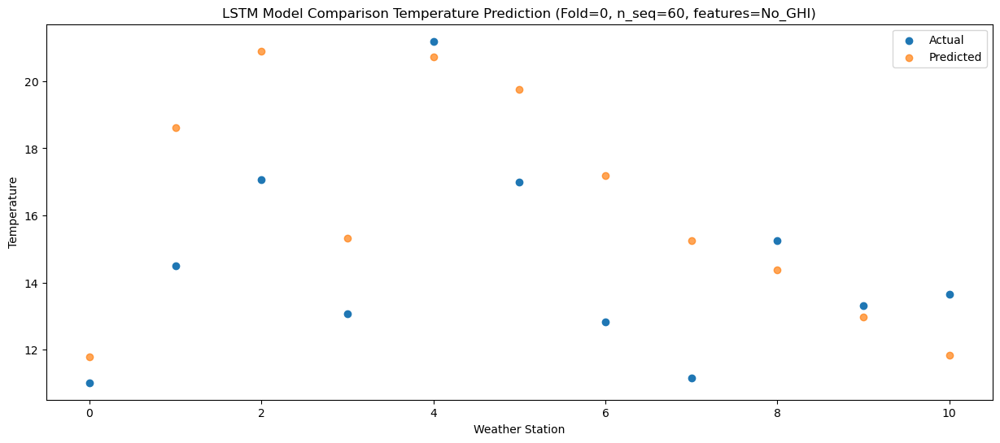

Predictions for (t+59):
    Weather_Station  Actual  Predicted
0                 0    7.75   6.278425
1                 1   11.17  13.105784
2                 2   11.17  15.388945
3                 3    8.93   9.825221
4                 4   18.74  15.207599
5                 5   11.96  14.256938
6                 6    7.56  11.691235
7                 7    5.32   9.751919
8                 8    9.81   8.866216
9                 9    6.57   7.474724
10               10    7.43   6.326138


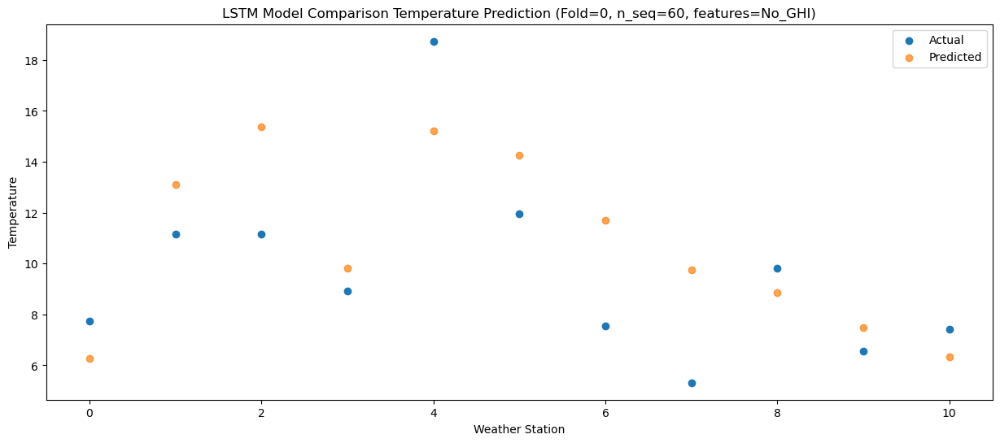

f, t:
[[-2.980e+00  3.390e+00  4.930e+00  1.130e+00  7.340e+00  4.630e+00
   6.800e-01 -1.370e+00 -9.500e-01 -4.560e+00 -5.060e+00]
 [-3.450e+00  2.490e+00  4.820e+00  1.110e+00  5.290e+00  4.060e+00
   3.200e-01 -1.740e+00 -1.110e+00 -4.380e+00 -5.730e+00]
 [-3.720e+00  2.110e+00  4.200e+00  1.150e+00  6.030e+00  3.530e+00
  -1.500e-01 -1.860e+00 -2.300e+00 -5.660e+00 -6.760e+00]
 [-3.370e+00  2.860e+00  4.820e+00  1.150e+00  5.360e+00  3.220e+00
   9.600e-01 -8.200e-01 -1.800e+00 -6.530e+00 -8.220e+00]
 [ 3.210e+00  8.690e+00  1.107e+01  8.070e+00  1.311e+01  6.810e+00
   6.380e+00  4.760e+00  4.770e+00  6.600e-01 -2.080e+00]
 [ 3.860e+00  9.180e+00  1.083e+01  8.150e+00  1.336e+01  8.780e+00
   7.620e+00  5.660e+00  7.050e+00  2.320e+00  5.700e-01]
 [ 8.590e+00  1.195e+01  1.452e+01  1.104e+01  1.834e+01  1.247e+01
   9.960e+00  8.780e+00  1.193e+01  7.410e+00  7.000e+00]
 [ 1.281e+01  1.570e+01  1.824e+01  1.395e+01  2.254e+01  1.682e+01
   1.521e+01  1.430e+01  1.786e+01  1.439e+0

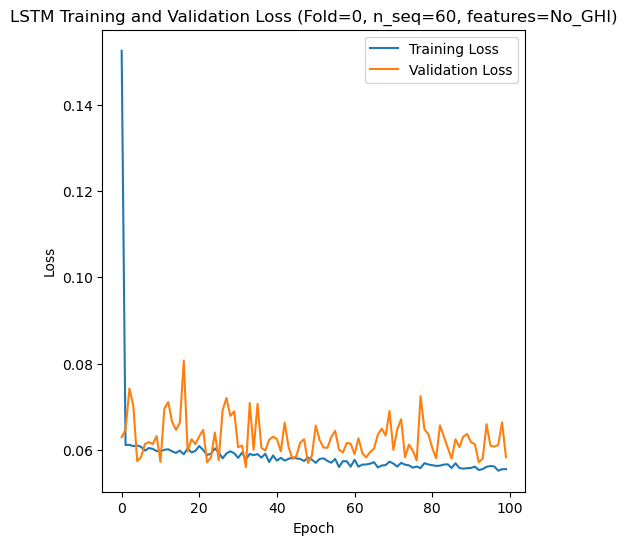

[[12.2  10.03 13.86 ... 24.46 19.58 17.03]
 [ 8.35  6.22 11.74 ... 22.47 18.02 13.98]
 [10.82  7.37 13.36 ... 24.57 19.57 16.15]
 ...
 [ 7.69  4.56 11.66 ... 25.3  19.83 13.28]
 [ 8.93  6.7  14.14 ... 25.37 21.51 12.55]
 [ 7.96  5.46 11.14 ... 25.13 20.28 10.63]]
Epoch 1/100
84/84 [==============================] - 35s 172ms/step - loss: 0.1689 - accuracy: 0.3452 - mae: 0.1404 - rmse: 0.1689 - mape: inf - pearson: 0.6296 - val_loss: 0.0566 - val_accuracy: 0.6000 - val_mae: 0.0455 - val_rmse: 0.0566 - val_mape: 10.0289 - val_pearson: 0.8620
Epoch 2/100
84/84 [==============================] - 6s 75ms/step - loss: 0.0600 - accuracy: 0.5119 - mae: 0.0473 - rmse: 0.0600 - mape: inf - pearson: 0.8367 - val_loss: 0.0557 - val_accuracy: 0.6000 - val_mae: 0.0439 - val_rmse: 0.0557 - val_mape: 9.6194 - val_pearson: 0.8625
Epoch 3/100
84/84 [==============================] - 8s 92ms/step - loss: 0.0600 - accuracy: 0.5000 - mae: 0.0474 - rmse: 0.0600 - mape: inf - pearson: 0.8362 - val_loss: 0.05

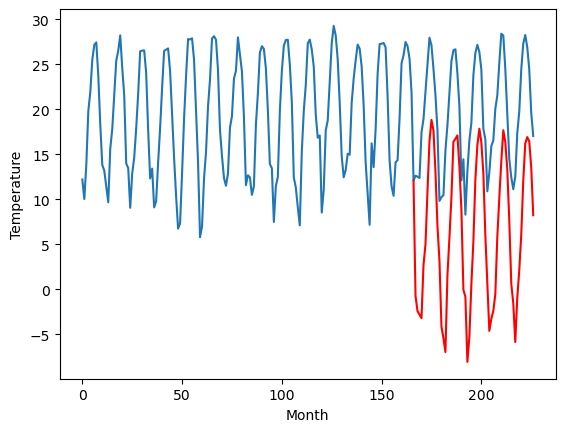

Weather Station 2:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
3.52		3.51		-0.01
2.61		1.82		-0.79
1.50		1.42		-0.08
1.59		1.02		-0.57
7.59		6.93		-0.66
8.81		9.25		0.44
12.16		15.13		2.97
16.51		20.70		4.19
19.88		23.05		3.17
18.47		21.89		3.42
14.93		17.25		2.32
11.21		11.27		0.06
7.11		7.41		0.30
0.22		0.10		-0.12
0.02		-1.22		-1.24
0.68		-2.74		-3.42
7.45		5.80		-1.65
9.59		9.96		0.37
13.32		14.46		1.14
17.46		20.63		3.17
18.84		20.95		2.11
19.11		21.33		2.22
15.37		17.87		2.50
11.59		13.09		1.50
3.93		4.20		0.27
5.56		3.40		-2.16
-1.17		-3.83		-2.66
3.06		-1.03		-4.09
6.63		4.84		-1.79
9.63		9.55		-0.08
15.51		16.45		0.94
19.48		20.27		0.79
19.98		22.10		2.12
18.52		20.59		2.07
15.43		17.14		1.71
9.09		10.28		1.19
6.09		4.88		-1.21
0.28		-0.35		-0.63
2.47		0.97		-1.50
5.84		1.87		-3.97
6.61		3.73		-2.88
9.88		10.11		0.23
13.16		14.45		1.29
16.35		18.48		2.13
19.95		21.93		1.98
19.41		20.62		1.21
15.90		17.56		1.66
10.89		11.86		0.97
5.27		4.89		-0.3

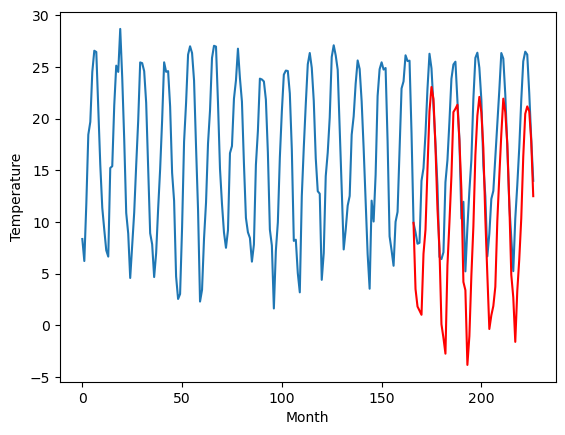

Weather Station 3:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-1.48		-0.33		1.15
-1.05		-2.03		-0.98
-1.58		-2.42		-0.84
-1.30		-2.83		-1.53
5.80		3.08		-2.72
4.83		5.40		0.57
8.98		11.28		2.30
13.21		16.85		3.64
14.68		19.20		4.52
14.67		18.03		3.36
11.87		13.40		1.53
7.52		7.42		-0.10
2.72		3.55		0.83
-4.34		-3.75		0.59
-3.92		-5.07		-1.15
-3.43		-6.59		-3.16
3.63		1.95		-1.68
5.03		6.11		1.08
9.15		10.61		1.46
13.03		16.77		3.74
13.80		17.10		3.30
14.46		17.48		3.02
11.44		14.02		2.58
7.66		9.25		1.59
-0.08		0.35		0.43
2.52		-0.45		-2.97
-4.37		-7.67		-3.30
-1.02		-4.87		-3.85
2.98		1.00		-1.98
6.57		5.71		-0.86
11.93		12.62		0.69
14.90		16.44		1.54
15.61		18.26		2.65
14.00		16.76		2.76
11.61		13.31		1.70
4.92		6.46		1.54
1.60		1.06		-0.54
-1.56		-4.18		-2.62
-0.56		-2.85		-2.29
2.03		-1.96		-3.99
3.46		-0.10		-3.56
6.15		6.29		0.14
9.39		10.62		1.23
13.14		14.66		1.52
15.51		18.10		2.59
15.95		16.80		0.85
12.99		13.74		0.75
6.95		8.04		1.09
0.39		1.

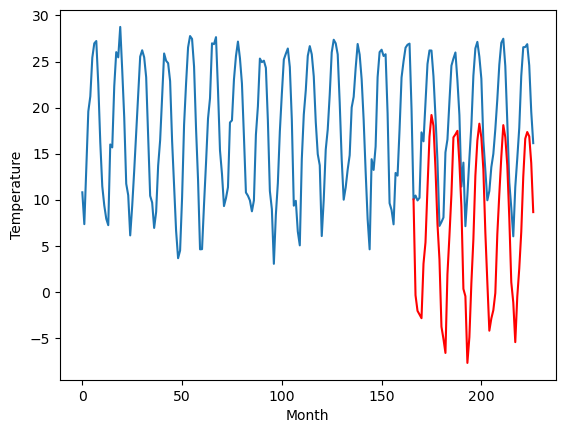

Weather Station 4:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
4.05		2.14		-1.91
2.63		0.44		-2.19
3.38		0.06		-3.32
2.85		-0.33		-3.18
10.49		5.57		-4.92
10.37		7.90		-2.47
14.12		13.77		-0.35
16.90		19.34		2.44
18.55		21.69		3.14
18.79		20.52		1.73
15.38		15.88		0.50
10.84		9.90		-0.94
7.94		6.04		-1.90
1.76		-1.26		-3.02
1.66		-2.58		-4.24
0.07		-4.10		-4.17
7.44		4.43		-3.01
9.78		8.59		-1.19
13.67		13.09		-0.58
17.56		19.26		1.70
17.44		19.59		2.15
18.41		19.97		1.56
15.40		16.51		1.11
12.71		11.74		-0.97
5.55		2.85		-2.70
8.92		2.06		-6.86
0.87		-5.17		-6.04
0.40		-2.37		-2.77
6.24		3.50		-2.74
12.24		8.22		-4.02
16.67		15.12		-1.55
19.67		18.94		-0.73
20.61		20.76		0.15
18.97		19.25		0.28
16.20		15.81		-0.39
10.64		8.95		-1.69
5.59		3.54		-2.05
3.50		-1.70		-5.20
4.21		-0.37		-4.58
5.21		0.53		-4.68
9.04		2.40		-6.64
9.88		8.78		-1.10
14.47		13.12		-1.35
18.62		17.16		-1.46
20.34		20.60		0.26
22.31		19.30		-3.01
19.23		16.23		-3.00
11.97		10.53		-

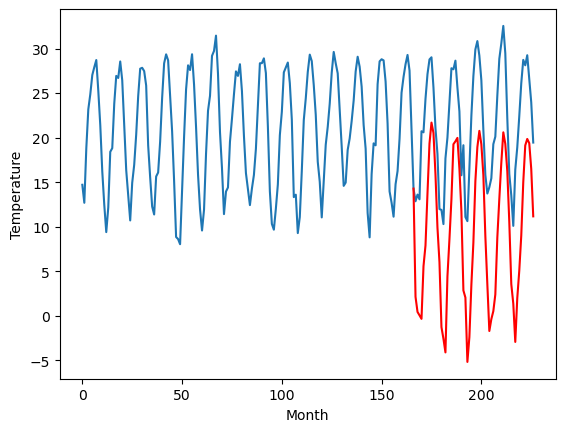

Weather Station 5:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
8.11		6.02		-2.09
6.22		4.33		-1.89
7.03		3.95		-3.08
6.65		3.56		-3.09
14.69		9.47		-5.22
14.43		11.80		-2.63
18.23		17.67		-0.56
21.26		23.24		1.98
23.30		25.59		2.29
23.54		24.42		0.88
19.96		19.78		-0.18
15.02		13.80		-1.22
11.92		9.94		-1.98
5.56		2.64		-2.92
5.55		1.32		-4.23
3.85		-0.20		-4.05
11.46		8.34		-3.12
13.76		12.49		-1.27
17.88		17.00		-0.88
21.35		23.16		1.81
21.44		23.49		2.05
22.41		23.88		1.47
18.83		20.42		1.59
15.79		15.65		-0.14
8.24		6.76		-1.48
12.12		5.96		-6.16
3.64		-1.26		-4.90
3.33		1.53		-1.80
9.11		7.41		-1.70
15.38		12.13		-3.25
20.00		19.03		-0.97
23.37		22.85		-0.52
24.46		24.67		0.21
22.45		23.15		0.70
19.27		19.72		0.45
13.88		12.86		-1.02
8.88		7.45		-1.43
6.86		2.20		-4.66
7.34		3.54		-3.80
8.52		4.44		-4.08
12.34		6.31		-6.03
13.30		12.69		-0.61
17.94		17.03		-0.91
22.83		21.08		-1.75
24.78		24.51		-0.27
26.21		23.21		-3.00
22.36		20.15		-2.21
14.96		1

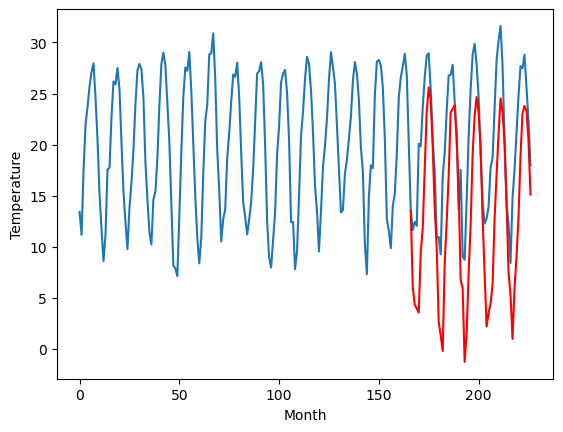

Weather Station 6:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
7.80		4.74		-3.06
5.77		3.04		-2.73
5.11		2.66		-2.45
4.59		2.27		-2.32
11.94		8.17		-3.77
14.73		10.50		-4.23
19.92		16.38		-3.54
22.64		21.94		-0.70
25.34		24.30		-1.04
25.19		23.13		-2.06
17.66		18.49		0.83
14.82		12.50		-2.32
11.10		8.64		-2.46
4.35		1.35		-3.00
2.84		0.05		-2.79
3.22		-1.48		-4.70
10.56		7.05		-3.51
12.83		11.21		-1.62
18.42		15.72		-2.70
22.69		21.89		-0.80
22.03		22.21		0.18
21.44		22.60		1.16
21.08		19.14		-1.94
16.76		14.36		-2.40
10.29		5.48		-4.81
10.55		4.68		-5.87
3.23		-2.54		-5.77
3.12		0.25		-2.87
10.07		6.13		-3.94
16.98		10.84		-6.14
22.38		17.75		-4.63
24.44		21.56		-2.88
25.36		23.39		-1.97
22.51		21.88		-0.63
19.46		18.45		-1.01
13.38		11.59		-1.79
6.42		6.17		-0.25
5.30		0.93		-4.37
5.76		2.26		-3.50
5.90		3.16		-2.74
10.96		5.03		-5.93
14.12		11.41		-2.71
18.73		15.74		-2.99
25.42		19.79		-5.63
26.52		23.23		-3.29
25.71		21.94		-3.77
23.43		18.88		-4.55

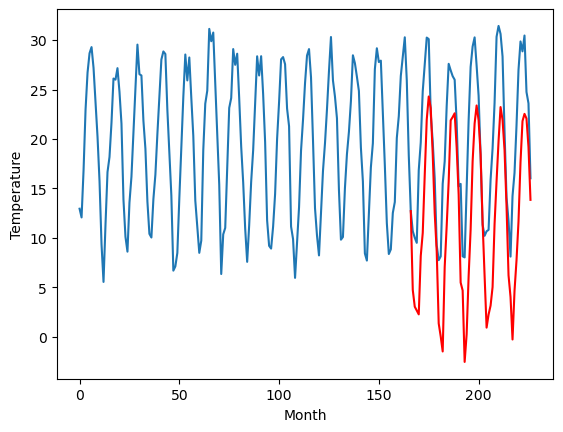

Weather Station 7:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
3.88		4.27		0.39
3.15		2.58		-0.57
2.34		2.19		-0.15
2.41		1.80		-0.61
8.08		7.70		-0.38
9.71		10.03		0.32
12.49		15.90		3.41
17.16		21.47		4.31
20.34		23.82		3.48
18.71		22.65		3.94
15.29		18.01		2.72
11.80		12.03		0.23
7.65		8.16		0.51
0.44		0.86		0.42
0.24		-0.45		-0.69
1.02		-1.97		-2.99
7.30		6.56		-0.74
9.87		10.72		0.85
13.64		15.22		1.58
17.65		21.39		3.74
19.01		21.72		2.71
19.27		22.11		2.84
15.94		18.64		2.70
11.99		13.87		1.88
4.39		4.98		0.59
5.91		4.18		-1.73
-0.48		-3.04		-2.56
3.33		-0.24		-3.57
7.17		5.63		-1.54
9.93		10.35		0.42
15.85		17.25		1.40
19.43		21.07		1.64
20.17		22.89		2.72
18.67		21.38		2.71
15.78		17.94		2.16
9.44		11.08		1.64
6.55		5.68		-0.87
0.54		0.43		-0.11
2.67		1.76		-0.91
6.26		2.67		-3.59
6.93		4.54		-2.39
10.19		10.92		0.73
13.19		15.26		2.07
16.47		19.30		2.83
19.92		22.74		2.82
19.50		21.44		1.94
16.33		18.38		2.05
11.32		12.69		1.37
5.63		5.72		0.09

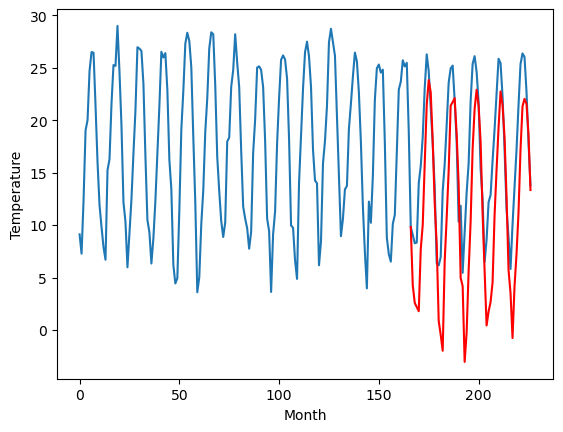

Weather Station 8:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
0.92		0.44		-0.48
0.30		-1.25		-1.55
-0.55		-1.63		-1.08
0.13		-2.03		-2.16
7.05		3.88		-3.17
8.19		6.21		-1.98
12.69		12.09		-0.60
18.25		17.65		-0.60
20.79		20.01		-0.78
18.77		18.83		0.06
15.47		14.20		-1.27
8.70		8.22		-0.48
5.03		4.35		-0.68
-1.57		-2.94		-1.37
-1.88		-4.26		-2.38
-4.88		-5.79		-0.91
6.44		2.76		-3.68
8.15		6.91		-1.24
12.81		11.42		-1.39
18.89		17.60		-1.29
19.88		17.92		-1.96
21.10		18.32		-2.78
17.39		14.86		-2.53
12.19		10.09		-2.10
2.89		1.20		-1.69
5.30		0.40		-4.90
-3.53		-6.82		-3.29
-1.48		-4.03		-2.55
4.47		1.85		-2.62
9.66		6.56		-3.10
15.13		13.47		-1.66
19.19		17.28		-1.91
23.32		19.11		-4.21
20.45		17.60		-2.85
16.61		14.16		-2.45
9.94		7.30		-2.64
3.34		1.89		-1.45
-0.40		-3.35		-2.95
0.79		-2.03		-2.82
2.29		-1.13		-3.42
5.12		0.74		-4.38
9.52		7.12		-2.40
14.87		11.46		-3.41
18.68		15.50		-3.18
20.98		18.93		-2.05
21.48		17.64		-3.84
17.86		14.58		-3.28


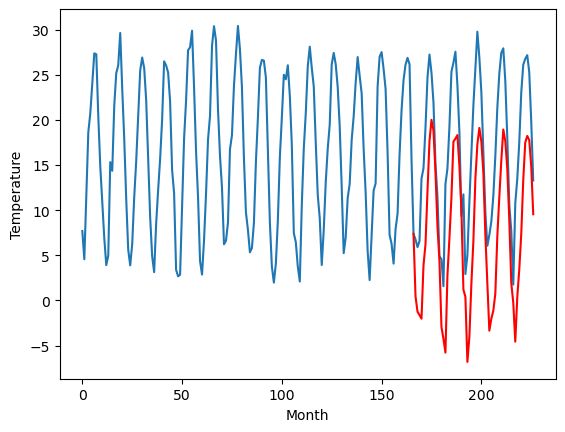

Weather Station 9:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
0.44		-0.99		-1.43
-1.41		-2.68		-1.27
-1.23		-3.06		-1.83
-1.74		-3.45		-1.71
6.09		2.46		-3.63
7.47		4.80		-2.67
13.58		10.67		-2.91
18.69		16.24		-2.45
21.23		18.59		-2.64
20.30		17.42		-2.88
13.65		12.78		-0.87
7.47		6.79		-0.68
4.59		2.93		-1.66
-2.09		-4.36		-2.27
-2.44		-5.67		-3.23
-7.22		-7.21		0.01
5.34		1.34		-4.00
7.14		5.49		-1.65
11.95		10.00		-1.95
17.98		16.18		-1.80
19.49		16.50		-2.99
19.88		16.89		-2.99
17.37		13.44		-3.93
11.12		8.66		-2.46
3.37		-0.22		-3.59
2.56		-1.02		-3.58
-5.06		-8.24		-3.18
-4.08		-5.45		-1.37
3.17		0.42		-2.75
10.28		5.14		-5.14
15.64		12.04		-3.60
19.93		15.86		-4.07
24.08		17.69		-6.39
21.41		16.18		-5.23
17.58		12.74		-4.84
9.35		5.88		-3.47
1.50		0.46		-1.04
-2.13		-4.78		-2.65
-1.27		-3.46		-2.19
-0.90		-2.57		-1.67
3.53		-0.69		-4.22
7.86		5.69		-2.17
13.55		10.02		-3.53
18.48		14.07		-4.41
21.36		17.50		-3.86
23.17		16.20		-6.97
18.53		13.15

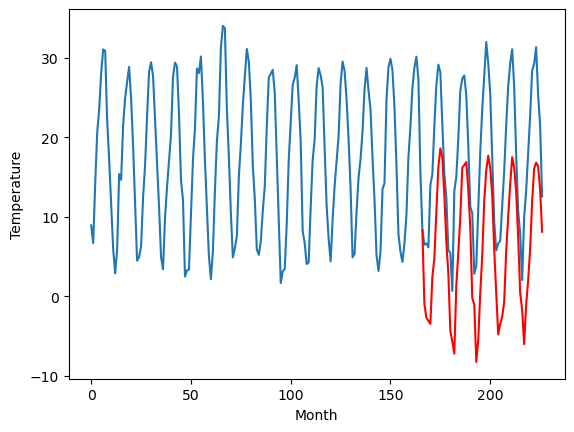

Weather Station 10:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
4.68		0.25		-4.43
3.32		-1.44		-4.76
2.87		-1.83		-4.70
1.63		-2.22		-3.85
9.59		3.70		-5.89
11.90		6.04		-5.86
18.43		11.92		-6.51
24.81		17.49		-7.32
26.39		19.84		-6.55
25.16		18.66		-6.50
18.41		14.02		-4.39
11.81		8.03		-3.78
8.63		4.17		-4.46
1.36		-3.12		-4.48
1.47		-4.42		-5.89
-2.90		-5.96		-3.06
7.81		2.59		-5.22
11.57		6.75		-4.82
16.12		11.25		-4.87
23.23		17.43		-5.80
23.90		17.75		-6.15
23.75		18.14		-5.61
21.80		14.69		-7.11
14.36		9.91		-4.45
8.11		1.04		-7.07
6.50		0.24		-6.26
-0.42		-6.98		-6.56
-0.36		-4.20		-3.84
6.57		1.68		-4.89
13.05		6.40		-6.65
18.50		13.30		-5.20
23.07		17.12		-5.95
26.67		18.95		-7.72
23.84		17.44		-6.40
21.43		14.01		-7.42
12.89		7.14		-5.75
3.90		1.73		-2.17
1.55		-3.52		-5.07
1.83		-2.20		-4.03
2.98		-1.30		-4.28
6.71		0.57		-6.14
12.06		6.96		-5.10
17.17		11.30		-5.87
20.40		15.34		-5.06
25.02		18.78		-6.24
25.42		17.49		-7.93
21.90		14.43		-7.

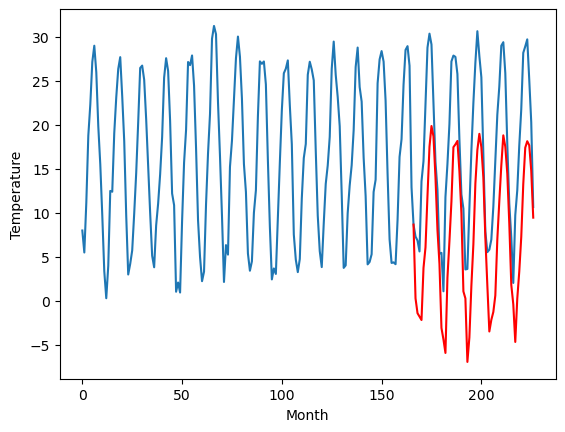

Weather Station 11:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-1.56		-0.72		0.84
-4.37		-2.41		1.96
-4.03		-2.80		1.23
-3.29		-3.20		0.09
1.03		2.71		1.68
2.66		5.04		2.38
8.12		10.92		2.80
15.44		16.49		1.05
19.31		18.84		-0.47
17.12		17.67		0.55
12.59		13.02		0.43
7.05		7.04		-0.01
2.85		3.18		0.33
-4.16		-4.11		0.05
-6.00		-5.42		0.58
-6.96		-6.95		0.01
0.26		1.60		1.34
4.91		5.77		0.86
9.45		10.27		0.82
15.54		16.45		0.91
17.77		16.77		-1.00
17.55		17.16		-0.39
13.85		13.71		-0.14
9.43		8.94		-0.49
0.11		0.05		-0.06
-0.66		-0.75		-0.09
-7.68		-7.98		-0.30
-3.78		-5.19		-1.41
0.78		0.68		-0.10
4.13		5.40		1.27
11.11		12.30		1.19
15.50		16.11		0.61
19.44		17.94		-1.50
18.90		16.43		-2.47
13.99		12.99		-1.00
5.89		6.12		0.23
2.38		0.71		-1.67
-4.77		-4.53		0.24
-1.81		-3.21		-1.40
-2.13		-2.31		-0.18
-1.01		-0.44		0.57
6.21		5.95		-0.26
8.77		10.29		1.52
13.14		14.33		1.19
18.28		17.77		-0.51
16.54		16.47		-0.07
13.35		13.41		0.06
8.00		7.72		-0.28
0.

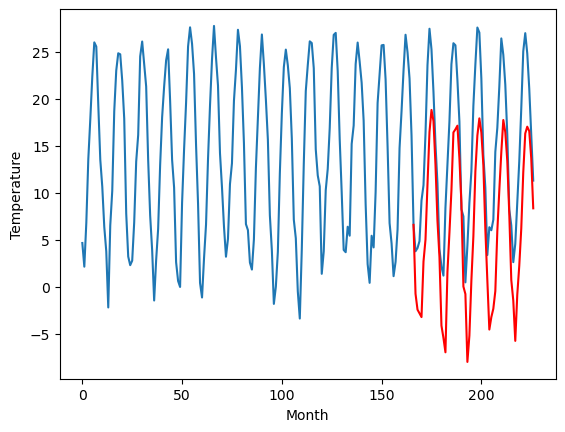

Predictions for (t+0):
    Weather_Station  Actual  Predicted
0                 0   -1.84  -0.727610
1                 1    3.52   3.513519
2                 2   -1.48  -0.334404
3                 3    4.05   2.136862
4                 4    8.11   6.024369
5                 5    7.80   4.739573
6                 6    3.88   4.267163
7                 7    0.92   0.436851
8                 8    0.44  -0.993126
9                 9    4.68   0.251033
10               10   -1.56  -0.723758


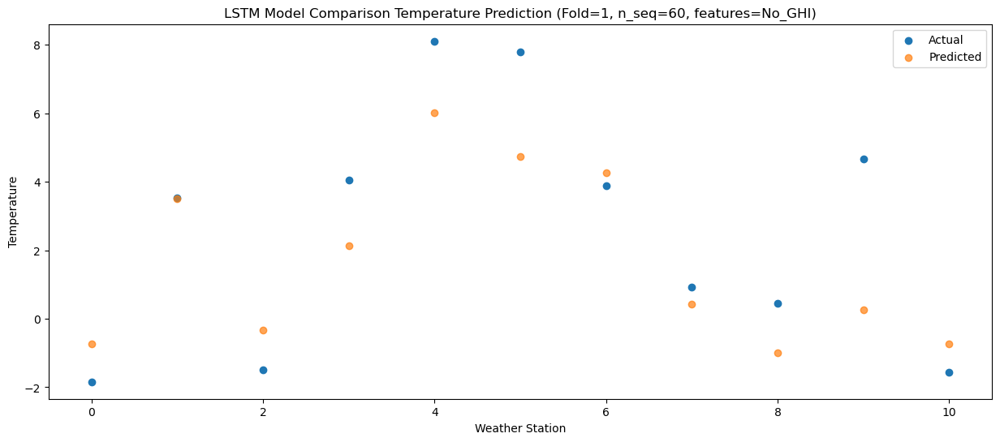

Predictions for (t+1):
    Weather_Station  Actual  Predicted
0                 0   -1.31  -2.422084
1                 1    2.61   1.818915
2                 2   -1.05  -2.027656
3                 3    2.63   0.443869
4                 4    6.22   4.331314
5                 5    5.77   3.043624
6                 6    3.15   2.575499
7                 7    0.30  -1.250551
8                 8   -1.41  -2.682298
9                 9    3.32  -1.442764
10               10   -4.37  -2.414100


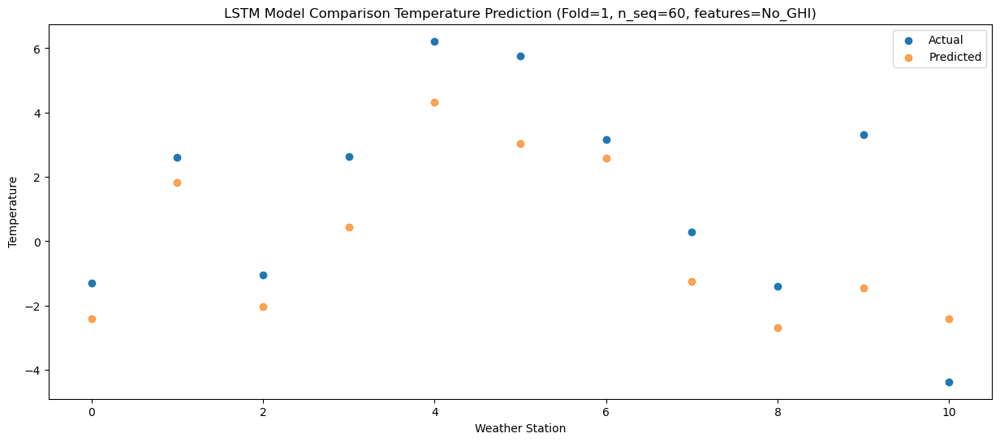

Predictions for (t+2):
    Weather_Station  Actual  Predicted
0                 0   -1.42  -2.815576
1                 1    1.50   1.424576
2                 2   -1.58  -2.421373
3                 3    3.38   0.059723
4                 4    7.03   3.954567
5                 5    5.11   2.660093
6                 6    2.34   2.191392
7                 7   -0.55  -1.631263
8                 8   -1.23  -3.061180
9                 9    2.87  -1.826849
10               10   -4.03  -2.804717


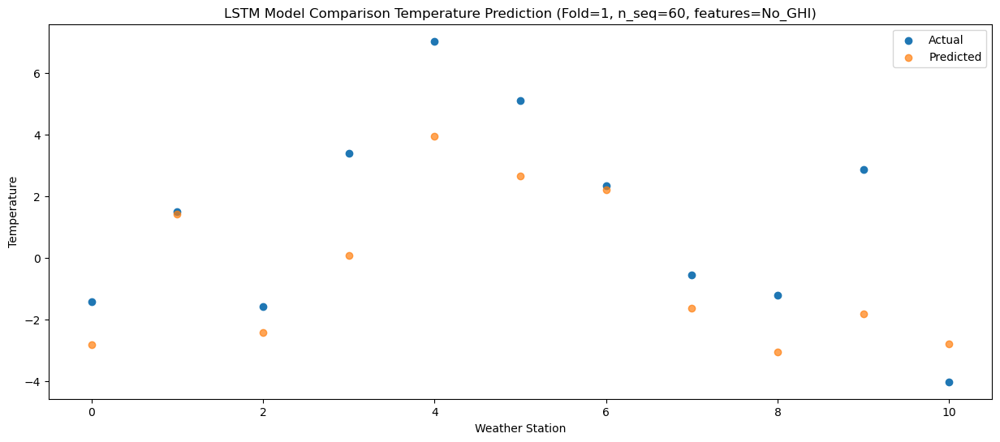

Predictions for (t+3):
    Weather_Station  Actual  Predicted
0                 0   -1.56  -3.213755
1                 1    1.59   1.020162
2                 2   -1.30  -2.825039
3                 3    2.85  -0.334671
4                 4    6.65   3.564480
5                 5    4.59   2.268319
6                 6    2.41   1.795593
7                 7    0.13  -2.027069
8                 8   -1.74  -3.452510
9                 9    1.63  -2.215536
10               10   -3.29  -3.204785


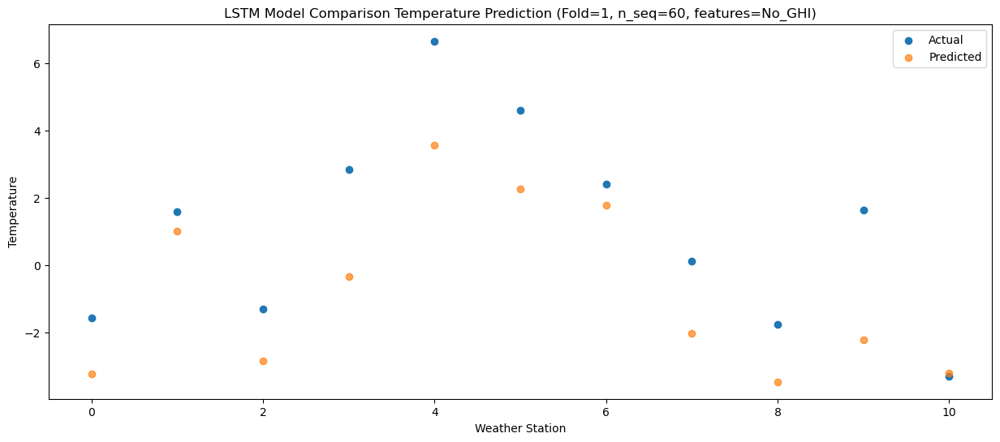

Predictions for (t+4):
    Weather_Station  Actual  Predicted
0                 0    3.50   2.683252
1                 1    7.59   6.926266
2                 2    5.80   3.082133
3                 3   10.49   5.570633
4                 4   14.69   9.470324
5                 5   11.94   8.173603
6                 6    8.08   7.703308
7                 7    7.05   3.882875
8                 8    6.09   2.461866
9                 9    9.59   3.700894
10               10    1.03   2.707795


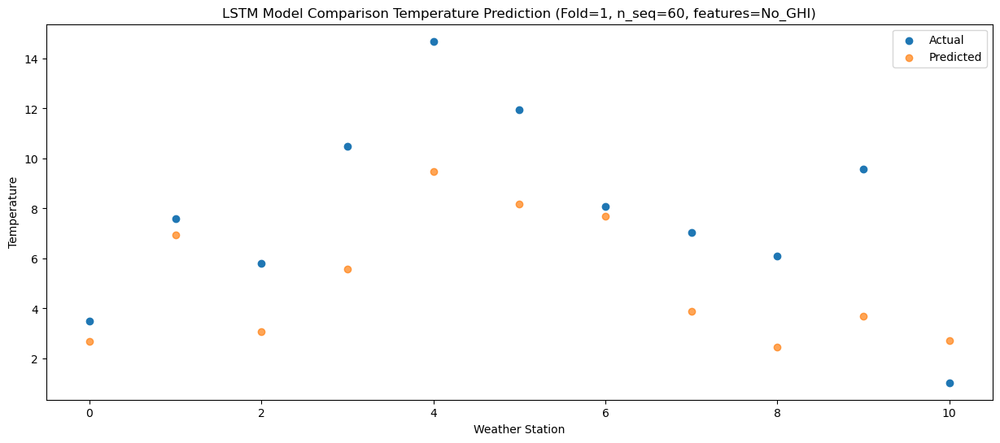

Predictions for (t+5):
    Weather_Station  Actual  Predicted
0                 0    4.99   5.006965
1                 1    8.81   9.246904
2                 2    4.83   5.401812
3                 3   10.37   7.899920
4                 4   14.43  11.802047
5                 5   14.73  10.503949
6                 6    9.71  10.027476
7                 7    8.19   6.210196
8                 8    7.47   4.796137
9                 9   11.90   6.038148
10               10    2.66   5.036205


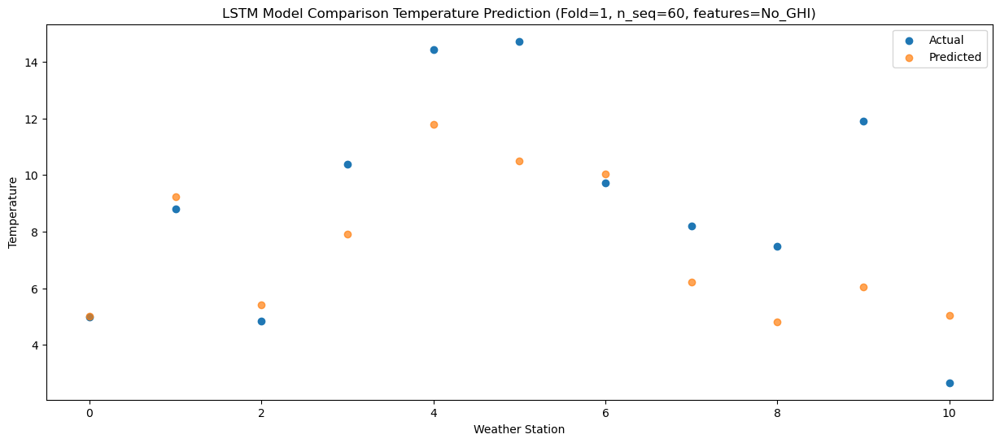

Predictions for (t+6):
    Weather_Station  Actual  Predicted
0                 0    8.07  10.890655
1                 1   12.16  15.130928
2                 2    8.98  11.282514
3                 3   14.12  13.771582
4                 4   18.23  17.672058
5                 5   19.92  16.377682
6                 6   12.49  15.903733
7                 7   12.69  12.086310
8                 8   13.58  10.671001
9                 9   18.43  11.918574
10               10    8.12  10.915421


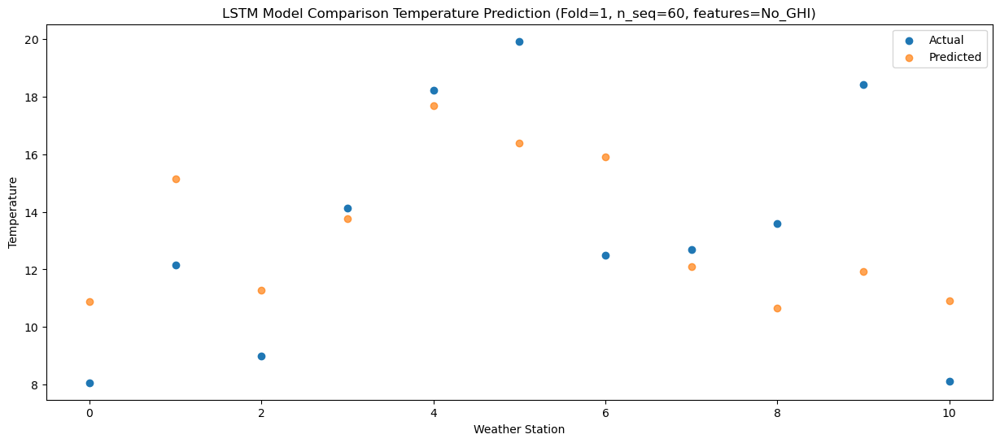

Predictions for (t+7):
    Weather_Station  Actual  Predicted
0                 0   11.07  16.464414
1                 1   16.51  20.700348
2                 2   13.21  16.848081
3                 3   16.90  19.335116
4                 4   21.26  23.236827
5                 5   22.64  21.940368
6                 6   17.16  21.466664
7                 7   18.25  17.653427
8                 8   18.69  16.239180
9                 9   24.81  17.485756
10               10   15.44  16.489093


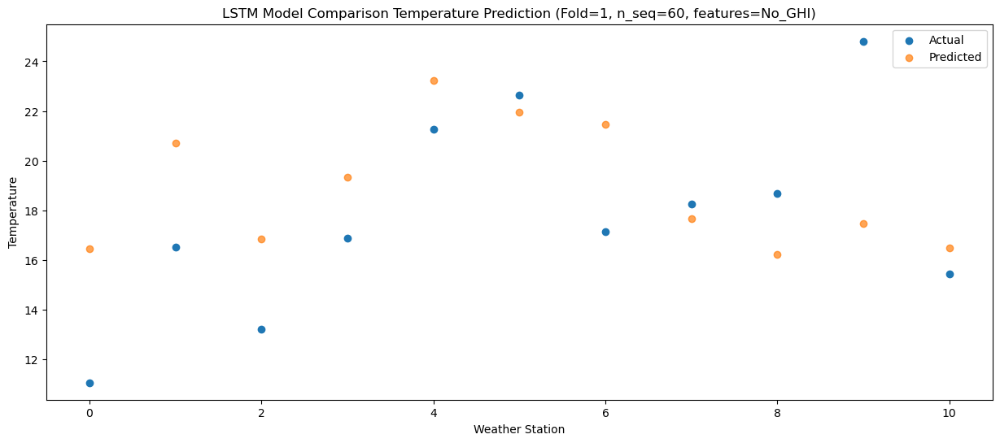

Predictions for (t+8):
    Weather_Station  Actual  Predicted
0                 0   14.02  18.820425
1                 1   19.88  23.053659
2                 2   14.68  19.200061
3                 3   18.55  21.690187
4                 4   23.30  25.591288
5                 5   25.34  24.295223
6                 6   20.34  23.816829
7                 7   20.79  20.006867
8                 8   21.23  18.592929
9                 9   26.39  19.838719
10               10   19.31  18.840522


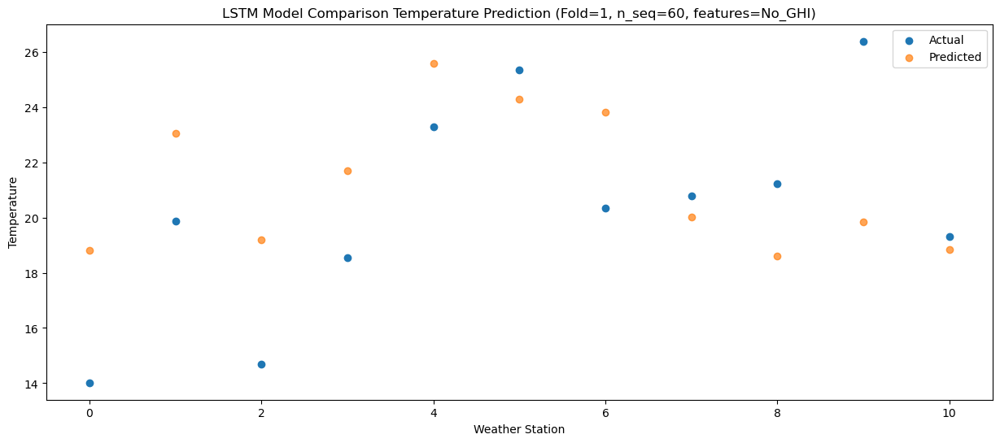

Predictions for (t+9):
    Weather_Station  Actual  Predicted
0                 0   13.18  17.655235
1                 1   18.47  21.886137
2                 2   14.67  18.031859
3                 3   18.79  20.523048
4                 4   23.54  24.423408
5                 5   25.19  23.126160
6                 6   18.71  22.648650
7                 7   18.77  18.834717
8                 8   20.30  17.418844
9                 9   25.16  18.663204
10               10   17.12  17.667217


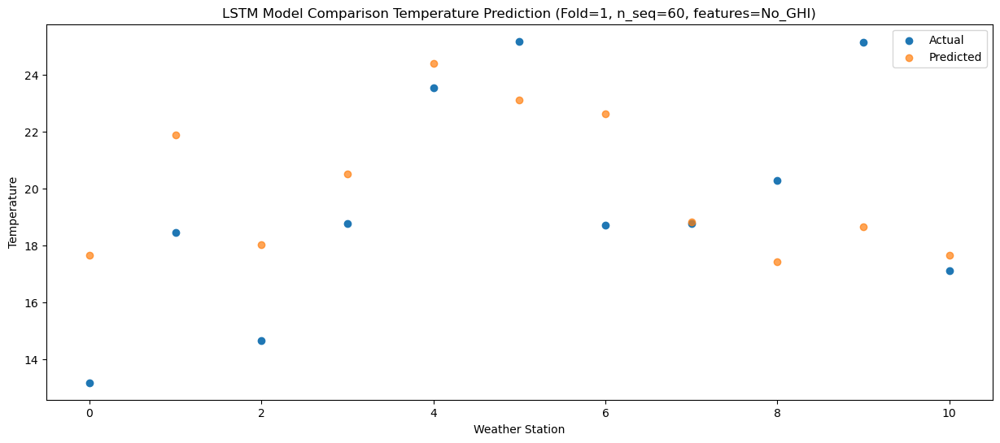

Predictions for (t+10):
    Weather_Station  Actual  Predicted
0                 0   10.56  13.017183
1                 1   14.93  17.249146
2                 2   11.87  13.397124
3                 3   15.38  15.884382
4                 4   19.96  19.780030
5                 5   17.66  18.485130
6                 6   15.29  18.010053
7                 7   15.47  14.195410
8                 8   13.65  12.775397
9                 9   18.41  14.018105
10               10   12.59  13.022679


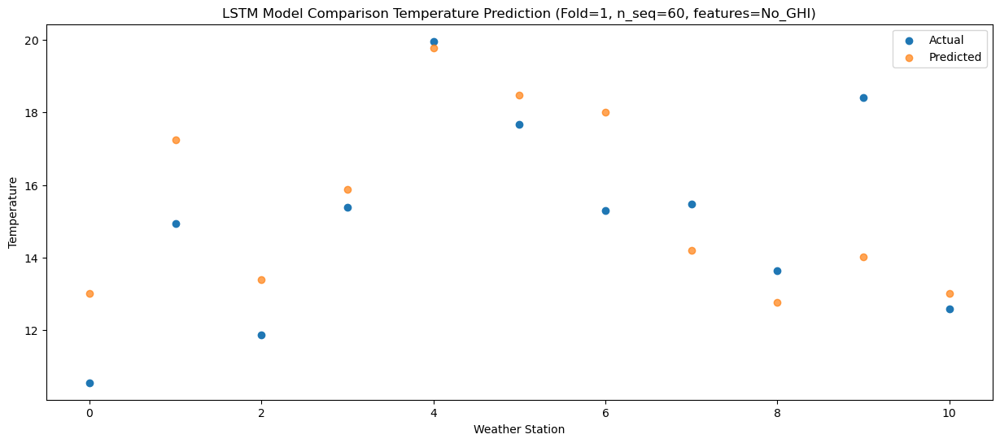

Predictions for (t+11):
    Weather_Station  Actual  Predicted
0                 0    7.63   7.035845
1                 1   11.21  11.270641
2                 2    7.52   7.419636
3                 3   10.84   9.901466
4                 4   15.02  13.796449
5                 5   14.82  12.502932
6                 6   11.80  12.030333
7                 7    8.70   8.215006
8                 8    7.47   6.788735
9                 9   11.81   8.028650
10               10    7.05   7.042188


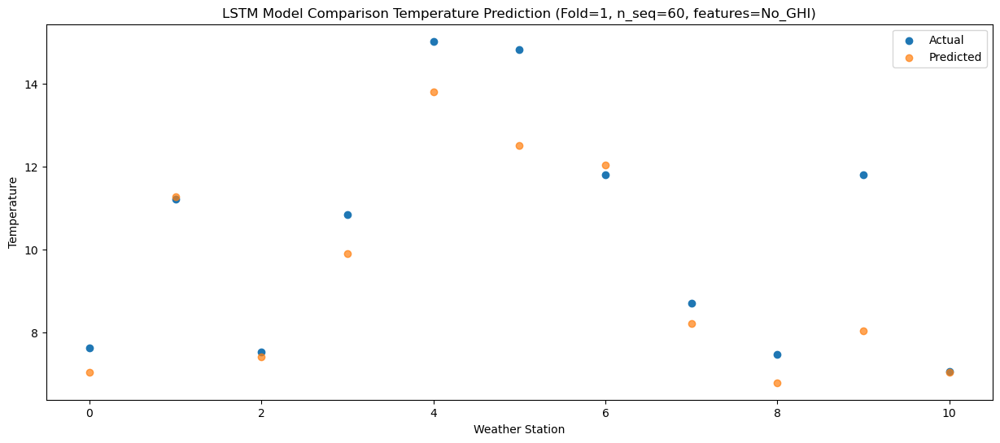

Predictions for (t+12):
    Weather_Station  Actual  Predicted
0                 0    3.73   3.172405
1                 1    7.11   7.405638
2                 2    2.72   3.554048
3                 3    7.94   6.038625
4                 4   11.92   9.935596
5                 5   11.10   8.642933
6                 6    7.65   8.163706
7                 7    5.03   4.350494
8                 8    4.59   2.927818
9                 9    8.63   4.168983
10               10    2.85   3.182948


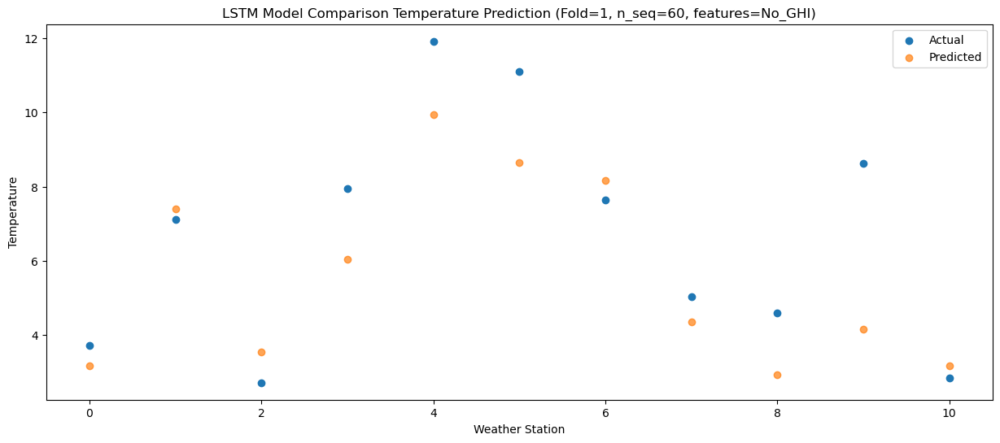

Predictions for (t+13):
    Weather_Station  Actual  Predicted
0                 0   -4.11  -4.131026
1                 1    0.22   0.103323
2                 2   -4.34  -3.749642
3                 3    1.76  -1.263059
4                 4    5.56   2.635623
5                 5    4.35   1.353664
6                 6    0.44   0.864105
7                 7   -1.57  -2.942993
8                 8   -2.09  -4.361556
9                 9    1.36  -3.117967
10               10   -4.16  -4.112770


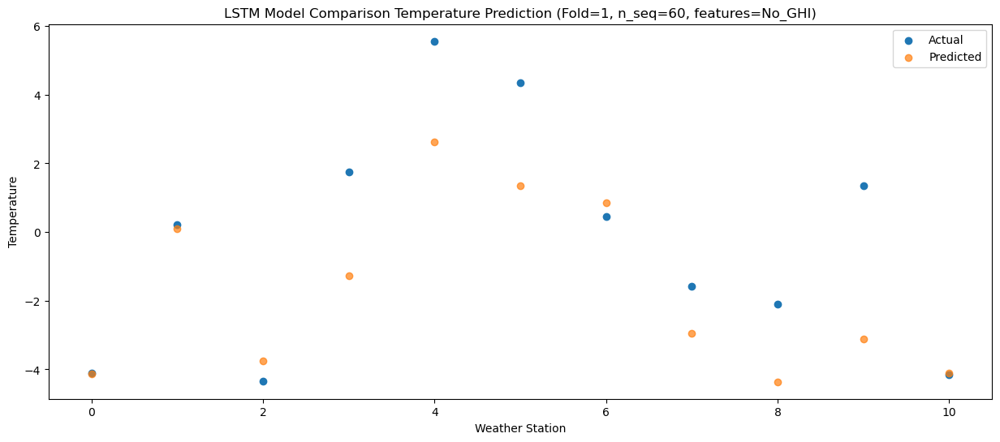

Predictions for (t+14):
    Weather_Station  Actual  Predicted
0                 0   -3.69  -5.446908
1                 1    0.02  -1.215545
2                 2   -3.92  -5.067206
3                 3    1.66  -2.575808
4                 4    5.55   1.324317
5                 5    2.84   0.045874
6                 6    0.24  -0.447783
7                 7   -1.88  -4.255279
8                 8   -2.44  -5.673114
9                 9    1.47  -4.424197
10               10   -6.00  -5.421037


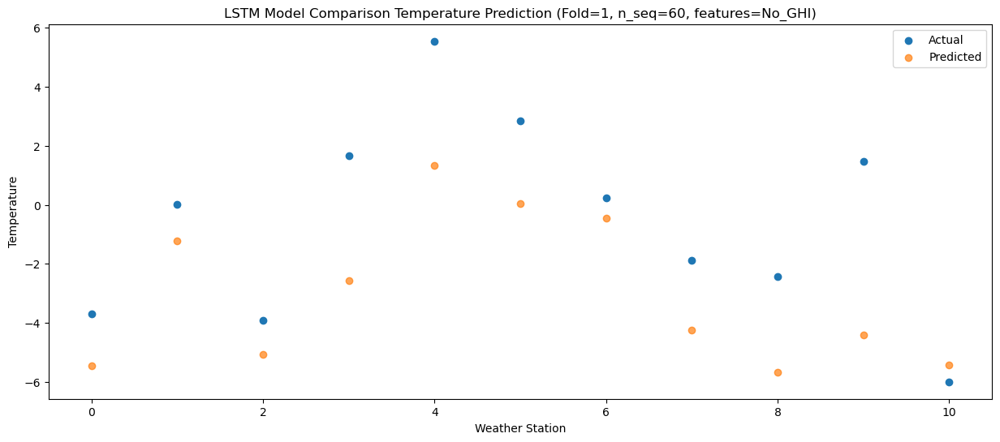

Predictions for (t+15):
    Weather_Station  Actual  Predicted
0                 0   -3.47  -6.971465
1                 1    0.68  -2.741263
2                 2   -3.43  -6.591419
3                 3    0.07  -4.100859
4                 4    3.85  -0.198657
5                 5    3.22  -1.480403
6                 6    1.02  -1.973181
7                 7   -4.88  -5.785778
8                 8   -7.22  -7.207509
9                 9   -2.90  -5.960301
10               10   -6.96  -6.951343


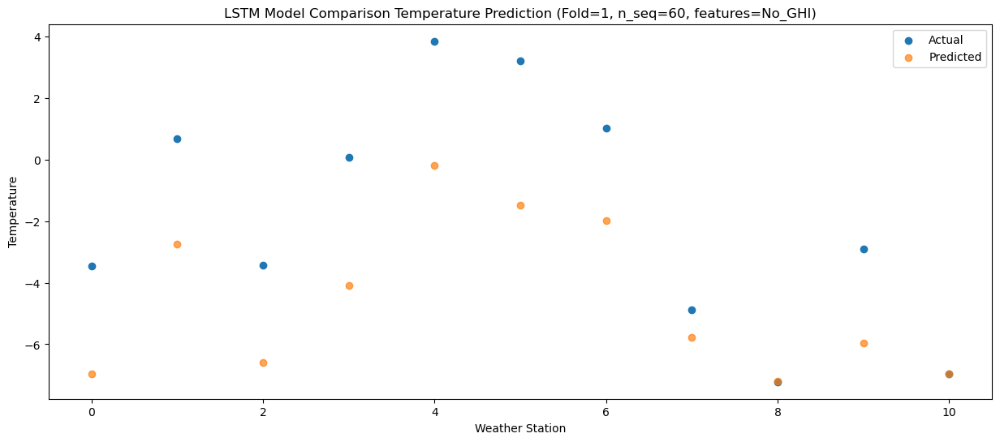

Predictions for (t+16):
    Weather_Station  Actual  Predicted
0                 0    1.51   1.569829
1                 1    7.45   5.799104
2                 2    3.63   1.948175
3                 3    7.44   4.432421
4                 4   11.46   8.335488
5                 5   10.56   7.054564
6                 6    7.30   6.560013
7                 7    6.44   2.760446
8                 8    5.34   1.342066
9                 9    7.81   2.587096
10               10    0.26   1.596456


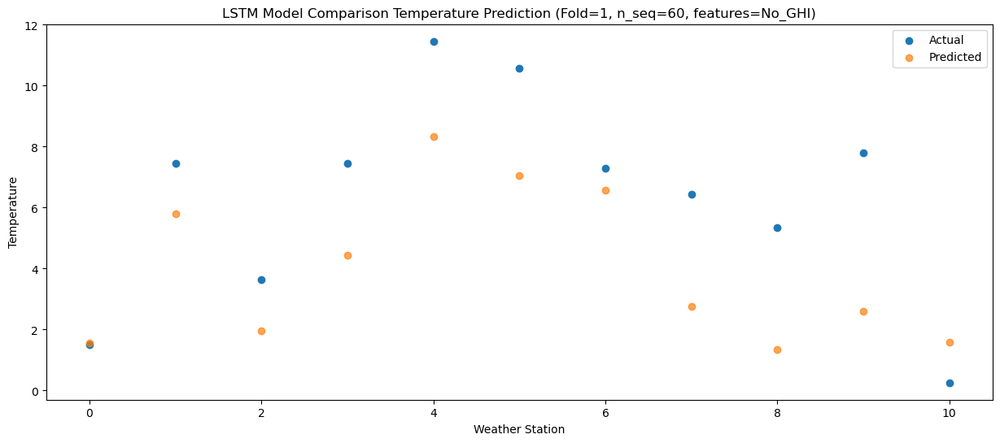

Predictions for (t+17):
    Weather_Station  Actual  Predicted
0                 0    4.32   5.731518
1                 1    9.59   9.960273
2                 2    5.03   6.108370
3                 3    9.78   8.586844
4                 4   13.76  12.485798
5                 5   12.83  11.208674
6                 6    9.87  10.719256
7                 7    8.15   6.913574
8                 8    7.14   5.492905
9                 9   11.57   6.745852
10               10    4.91   5.765638


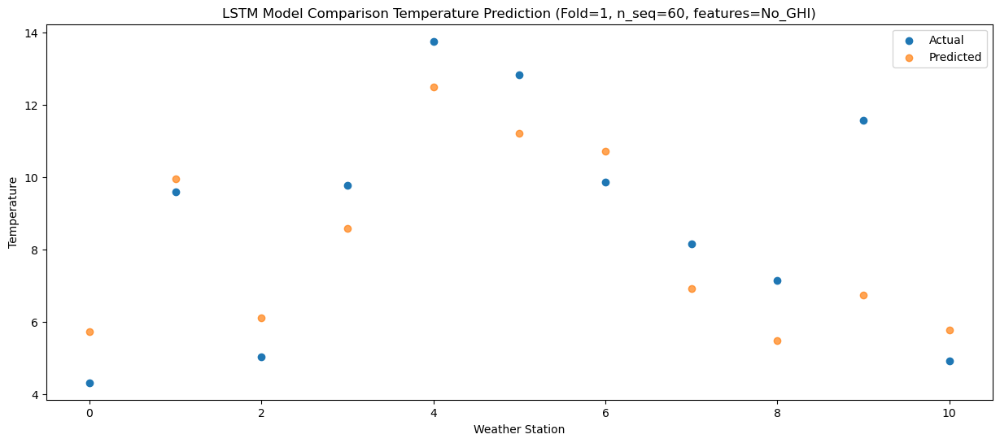

Predictions for (t+18):
    Weather_Station  Actual  Predicted
0                 0    7.93  10.232870
1                 1   13.32  14.460521
2                 2    9.15  10.608578
3                 3   13.67  13.093593
4                 4   17.88  16.995122
5                 5   18.42  15.716977
6                 6   13.64  15.220915
7                 7   12.81  11.418464
8                 8   11.95   9.999341
9                 9   16.12  11.251781
10               10    9.45  10.272287


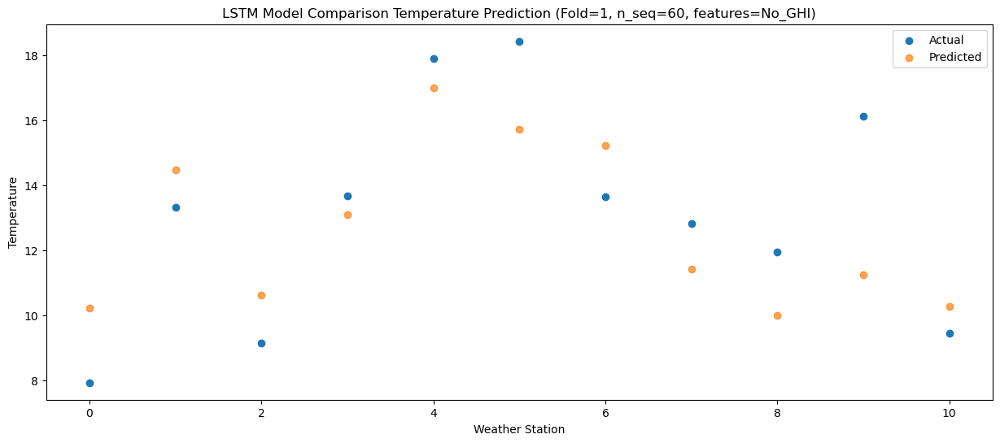

Predictions for (t+19):
    Weather_Station  Actual  Predicted
0                 0   11.42  16.396457
1                 1   17.46  20.626957
2                 2   13.03  16.774705
3                 3   17.56  19.262070
4                 4   21.35  23.164869
5                 5   22.69  21.887274
6                 6   17.65  21.389987
7                 7   18.89  17.596230
8                 8   17.98  16.178179
9                 9   23.23  17.433494
10               10   15.54  16.449752


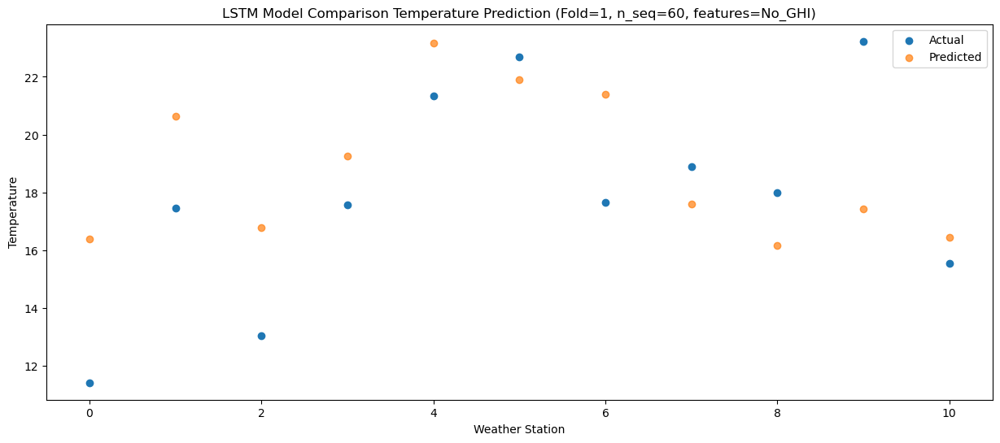

Predictions for (t+20):
    Weather_Station  Actual  Predicted
0                 0   12.62  16.716864
1                 1   18.84  20.948380
2                 2   13.80  17.098355
3                 3   17.44  19.586058
4                 4   21.44  23.488118
5                 5   22.03  22.213828
6                 6   19.01  21.716410
7                 7   19.88  17.922162
8                 8   19.49  16.499751
9                 9   23.90  17.752925
10               10   17.77  16.772989


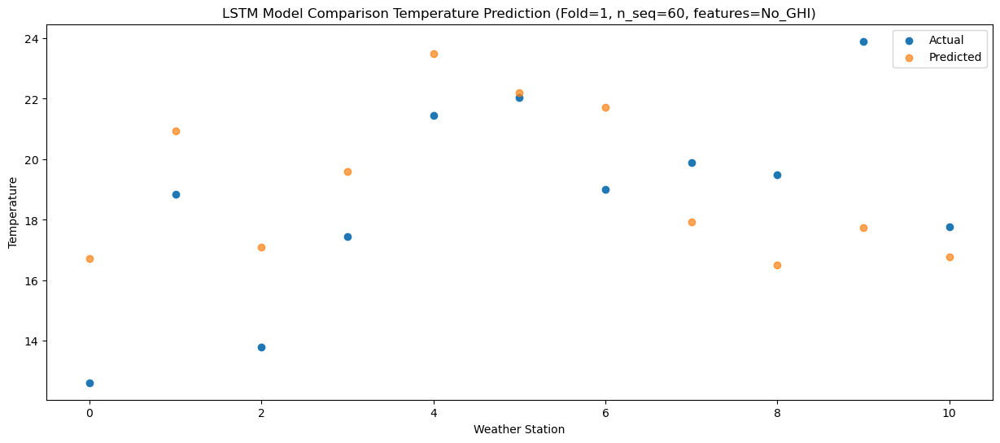

Predictions for (t+21):
    Weather_Station  Actual  Predicted
0                 0   12.73  17.098043
1                 1   19.11  21.334636
2                 2   14.46  17.484075
3                 3   18.41  19.973869
4                 4   22.41  23.875151
5                 5   21.44  22.597938
6                 6   19.27  22.105324
7                 7   21.10  18.315650
8                 8   19.88  16.890856
9                 9   23.75  18.142682
10               10   17.55  17.163828


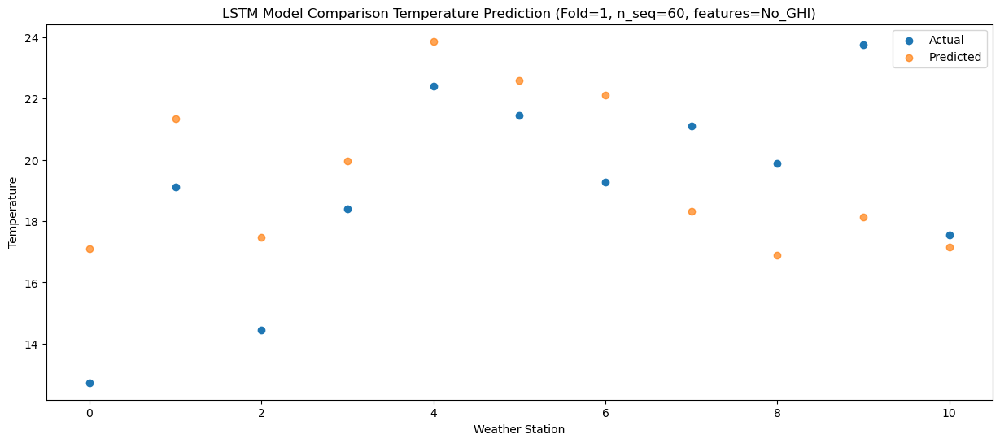

Predictions for (t+22):
    Weather_Station  Actual  Predicted
0                 0   10.08  13.632752
1                 1   15.37  17.867520
2                 2   11.44  14.017608
3                 3   15.40  16.512450
4                 4   18.83  20.416265
5                 5   21.08  19.140531
6                 6   15.94  18.640694
7                 7   17.39  14.855498
8                 8   17.37  13.435378
9                 9   21.80  14.692614
10               10   13.85  13.706536


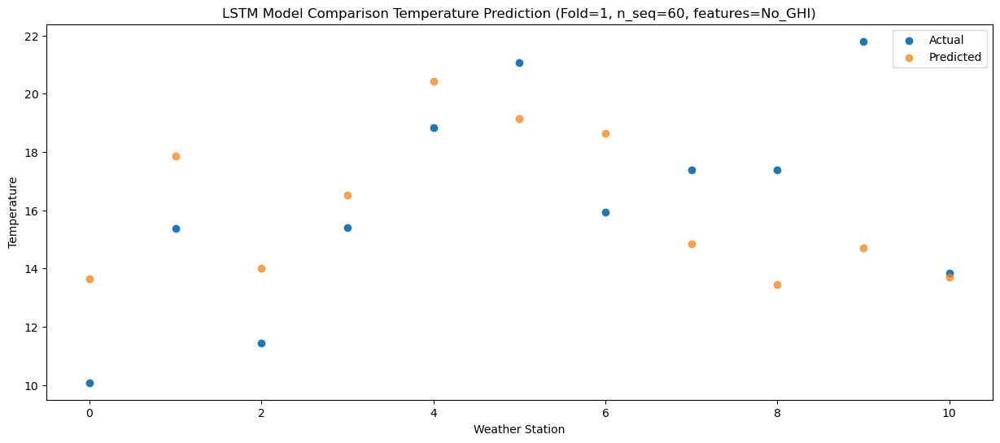

Predictions for (t+23):
    Weather_Station  Actual  Predicted
0                 0    6.38   8.854403
1                 1   11.59  13.092471
2                 2    7.66   9.246126
3                 3   12.71  11.738736
4                 4   15.79  15.646070
5                 5   16.76  14.363562
6                 6   11.99  13.866903
7                 7   12.19  10.085233
8                 8   11.12   8.663410
9                 9   14.36   9.912613
10               10    9.43   8.937349


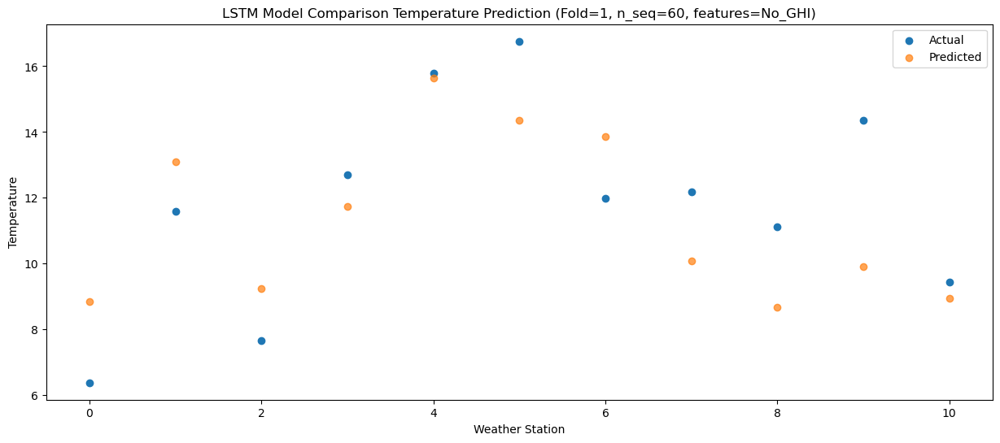

Predictions for (t+24):
    Weather_Station  Actual  Predicted
0                 0   -1.83  -0.040868
1                 1    3.93   4.195746
2                 2   -0.08   0.351047
3                 3    5.55   2.852555
4                 4    8.24   6.759637
5                 5   10.29   5.483504
6                 6    4.39   4.979695
7                 7    2.89   1.197635
8                 8    3.37  -0.218580
9                 9    8.11   1.039246
10               10    0.11   0.048646


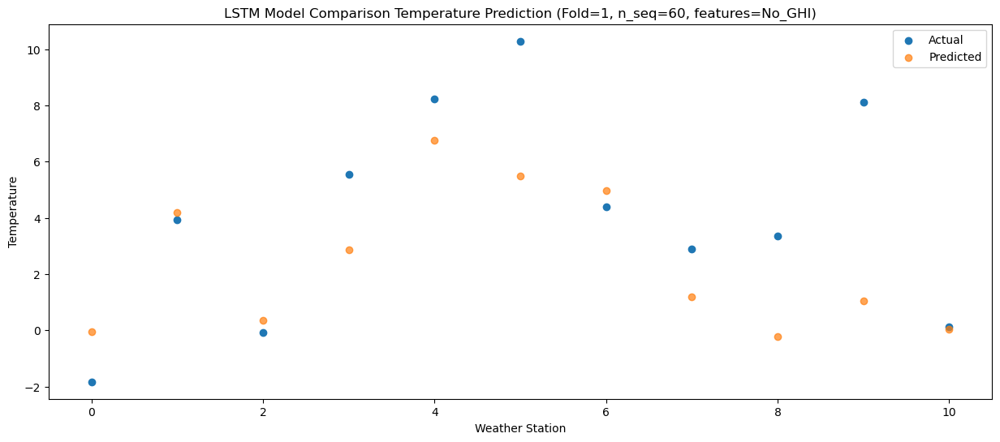

Predictions for (t+25):
    Weather_Station  Actual  Predicted
0                 0    0.52  -0.838896
1                 1    5.56   3.397100
2                 2    2.52  -0.445983
3                 3    8.92   2.056340
4                 4   12.12   5.962812
5                 5   10.55   4.684949
6                 6    5.91   4.184093
7                 7    5.30   0.402362
8                 8    2.56  -1.015451
9                 9    6.50   0.240526
10               10   -0.66  -0.751693


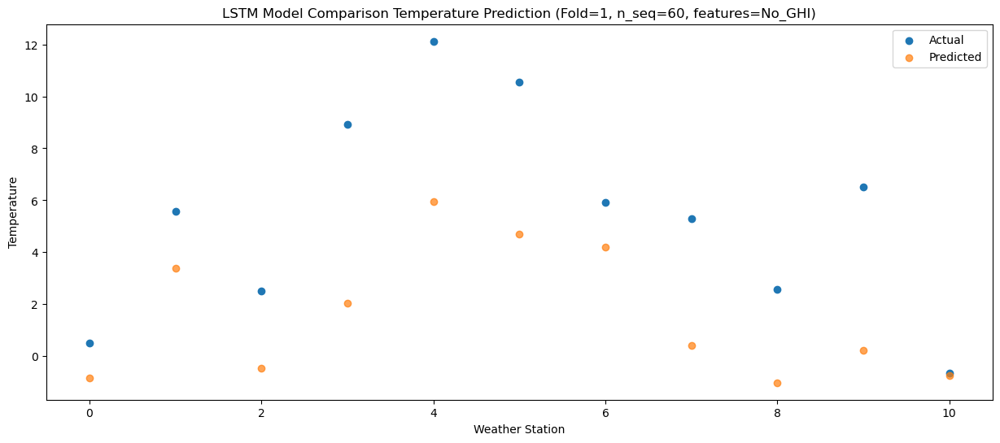

Predictions for (t+26):
    Weather_Station  Actual  Predicted
0                 0   -5.64  -8.066068
1                 1   -1.17  -3.829319
2                 2   -4.37  -7.673203
3                 3    0.87  -5.169248
4                 4    3.64  -1.262750
5                 5    3.23  -2.537700
6                 6   -0.48  -3.037031
7                 7   -3.53  -6.817744
8                 8   -5.06  -8.241183
9                 9   -0.42  -6.980421
10               10   -7.68  -7.975367


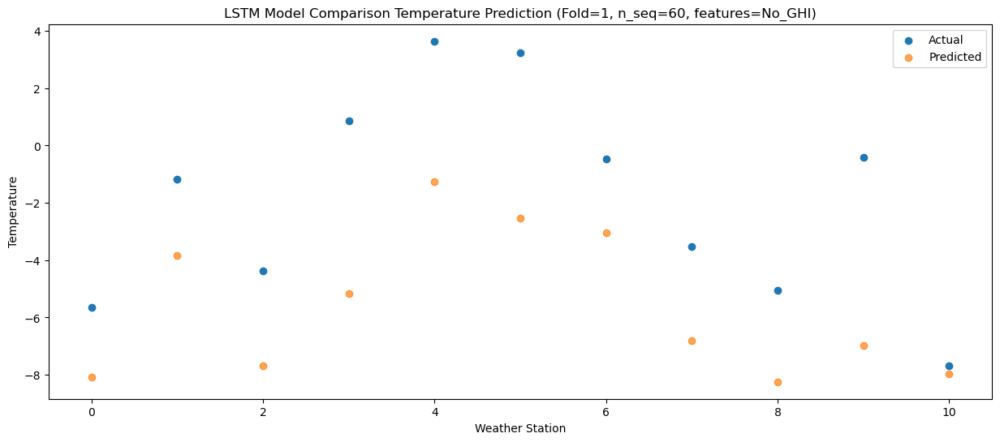

Predictions for (t+27):
    Weather_Station  Actual  Predicted
0                 0   -0.80  -5.276357
1                 1    3.06  -1.033195
2                 2   -1.02  -4.873946
3                 3    0.40  -2.374403
4                 4    3.33   1.529848
5                 5    3.12   0.245574
6                 6    3.33  -0.243378
7                 7   -1.48  -4.027475
8                 8   -4.08  -5.452562
9                 9   -0.36  -4.195406
10               10   -3.78  -5.185102


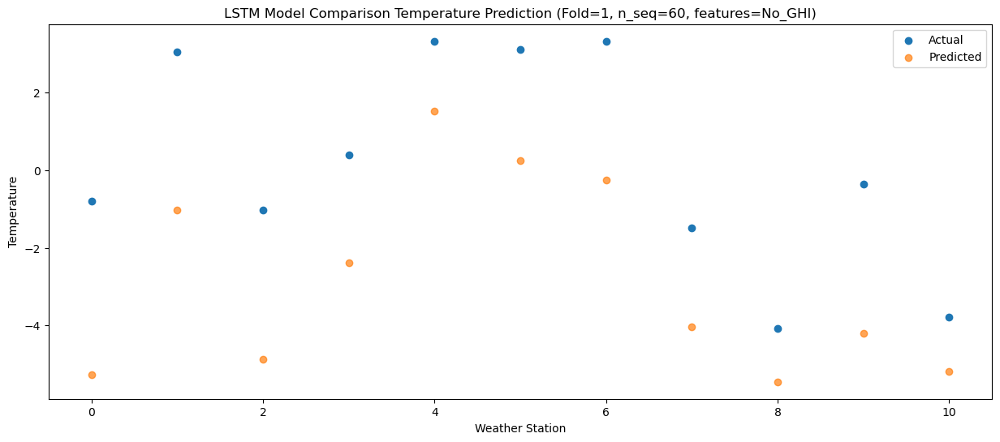

Predictions for (t+28):
    Weather_Station  Actual  Predicted
0                 0    2.59   0.591504
1                 1    6.63   4.835630
2                 2    2.98   0.997599
3                 3    6.24   3.500917
4                 4    9.11   7.409207
5                 5   10.07   6.126007
6                 6    7.17   5.633063
7                 7    4.47   1.850991
8                 8    3.17   0.424957
9                 9    6.57   1.681489
10               10    0.78   0.684522


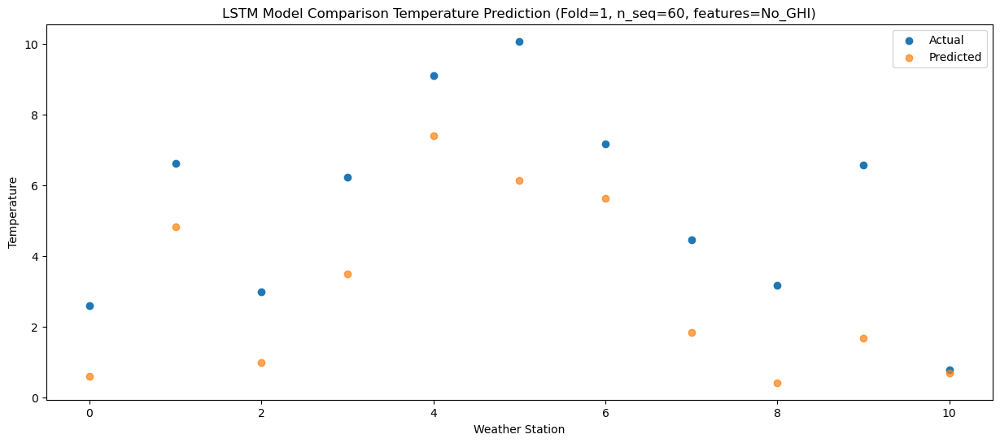

Predictions for (t+29):
    Weather_Station  Actual  Predicted
0                 0    4.58   5.304664
1                 1    9.63   9.552314
2                 2    6.57   5.714185
3                 3   12.24   8.215899
4                 4   15.38  12.125120
5                 5   16.98  10.840527
6                 6    9.93  10.348724
7                 7    9.66   6.564369
8                 8   10.28   5.136104
9                 9   13.05   6.398710
10               10    4.13   5.399273


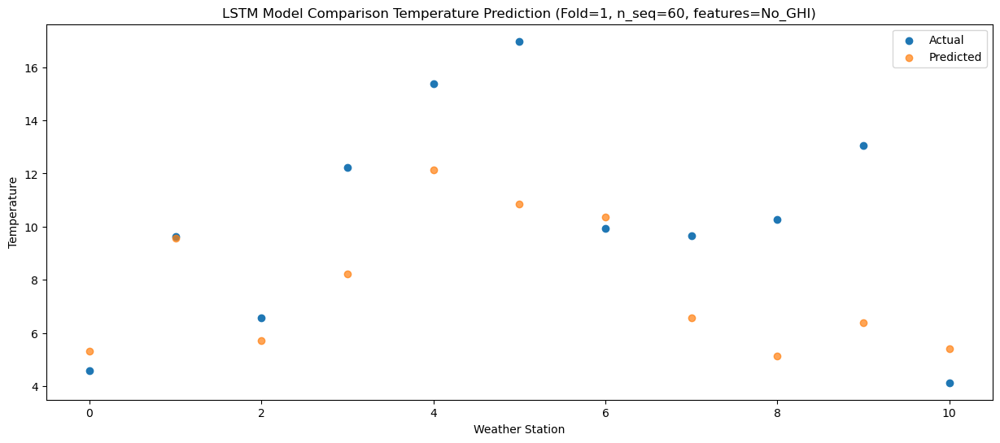

Predictions for (t+30):
    Weather_Station  Actual  Predicted
0                 0    9.83  12.201700
1                 1   15.51  16.453082
2                 2   11.93  12.617202
3                 3   16.67  15.123066
4                 4   20.00  19.033244
5                 5   22.38  17.746989
6                 6   15.85  17.253478
7                 7   15.13  13.470395
8                 8   15.64  12.040185
9                 9   18.50  13.300288
10               10   11.11  12.296155


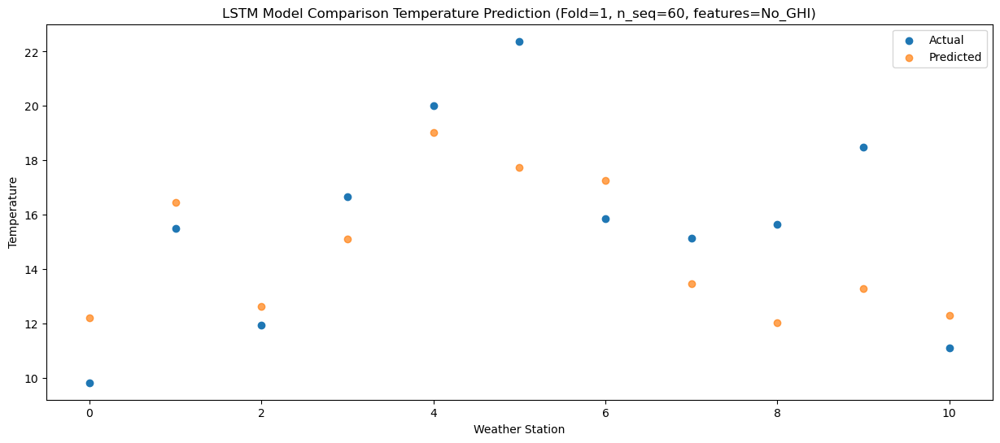

Predictions for (t+31):
    Weather_Station  Actual  Predicted
0                 0   12.33  16.015703
1                 1   19.48  20.269872
2                 2   14.90  16.435360
3                 3   19.67  18.939157
4                 4   23.37  22.846692
5                 5   24.44  21.561151
6                 6   19.43  21.066255
7                 7   19.19  17.282373
8                 8   19.93  15.856317
9                 9   23.07  17.120426
10               10   15.50  16.110634


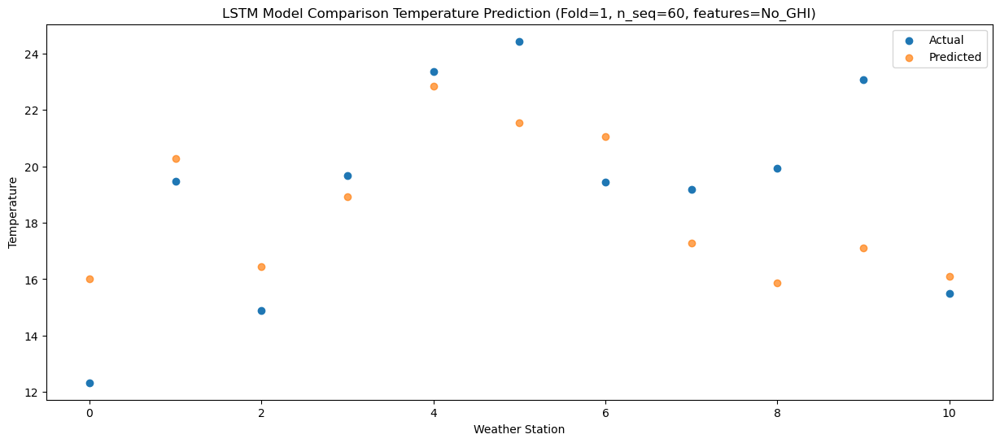

Predictions for (t+32):
    Weather_Station  Actual  Predicted
0                 0   13.23  17.841221
1                 1   19.98  22.096546
2                 2   15.61  18.261441
3                 3   20.61  20.762084
4                 4   24.46  24.668556
5                 5   25.36  23.387314
6                 6   20.17  22.893195
7                 7   23.32  19.109714
8                 8   24.08  17.686161
9                 9   26.67  18.951094
10               10   19.44  17.941472


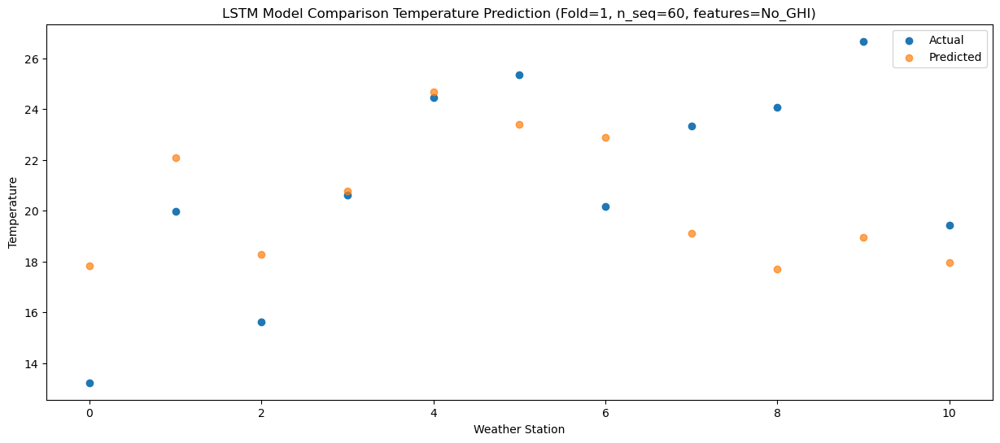

Predictions for (t+33):
    Weather_Station  Actual  Predicted
0                 0   12.43  16.330500
1                 1   18.52  20.588636
2                 2   14.00  16.756914
3                 3   18.97  19.247381
4                 4   22.45  23.153409
5                 5   22.51  21.879989
6                 6   18.67  21.379862
7                 7   20.45  17.601426
8                 8   21.41  16.177646
9                 9   23.84  17.443197
10               10   18.90  16.427257


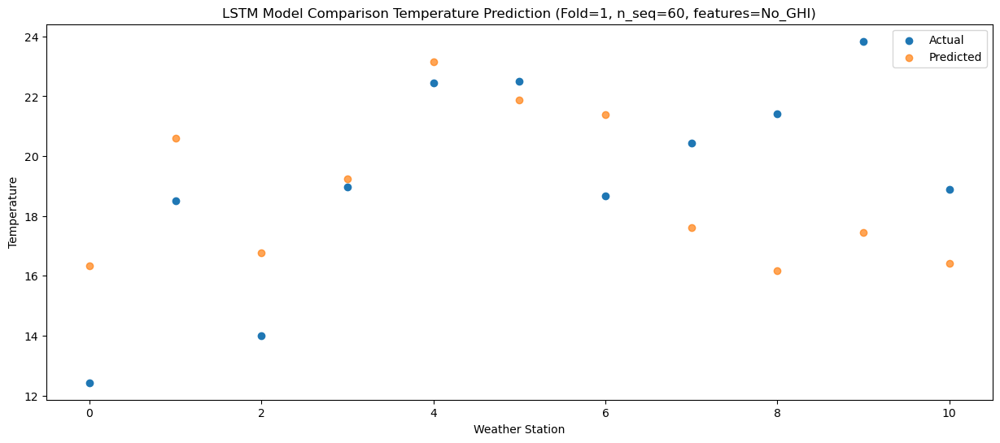

Predictions for (t+34):
    Weather_Station  Actual  Predicted
0                 0   10.47  12.886178
1                 1   15.43  17.144351
2                 2   11.61  13.313659
3                 3   16.20  15.809393
4                 4   19.27  19.716674
5                 5   19.46  18.447034
6                 6   15.78  17.940969
7                 7   16.61  14.163847
8                 8   17.58  12.743868
9                 9   21.43  14.008582
10               10   13.99  12.987405


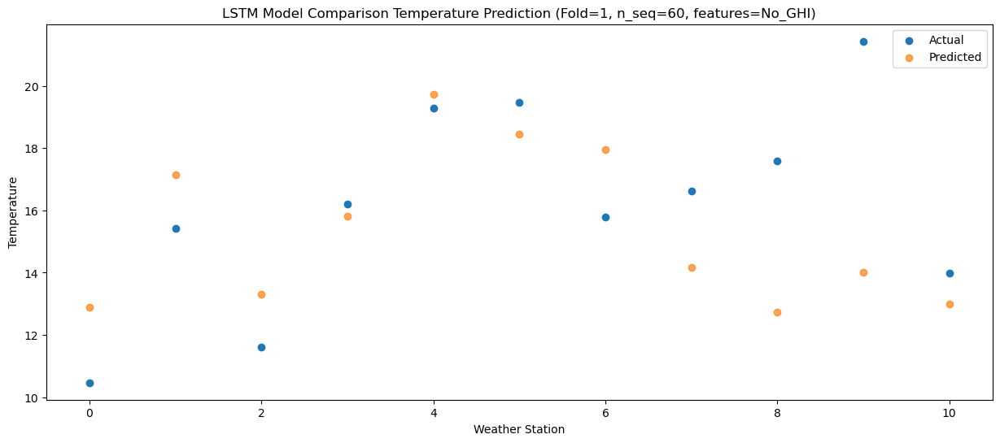

Predictions for (t+35):
    Weather_Station  Actual  Predicted
0                 0    3.92   6.022966
1                 1    9.09  10.284577
2                 2    4.92   6.456825
3                 3   10.64   8.947336
4                 4   13.88  12.855144
5                 5   13.38  11.587443
6                 6    9.44  11.083959
7                 7    9.94   7.301226
8                 8    9.35   5.877971
9                 9   12.89   7.144539
10               10    5.89   6.121135


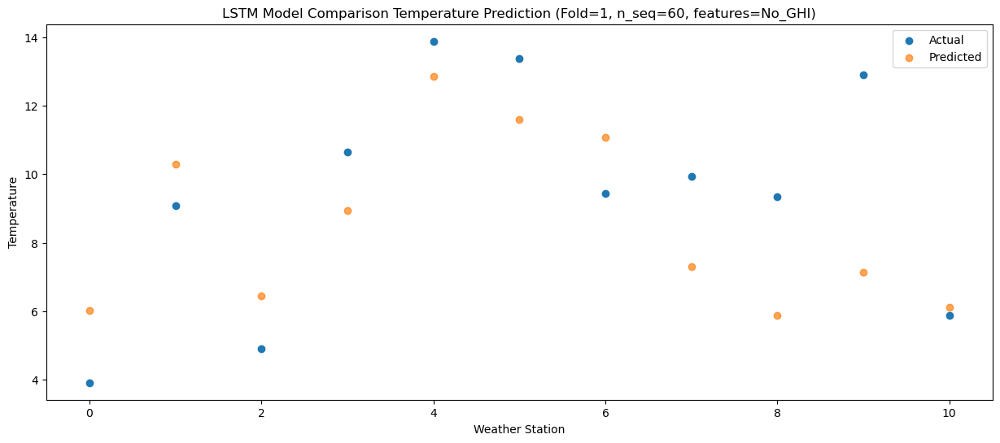

Predictions for (t+36):
    Weather_Station  Actual  Predicted
0                 0    2.72   0.622917
1                 1    6.09   4.883660
2                 2    1.60   1.055775
3                 3    5.59   3.541353
4                 4    8.88   7.445811
5                 5    6.42   6.174219
6                 6    6.55   5.676445
7                 7    3.34   1.892179
8                 8    1.50   0.461714
9                 9    3.90   1.725634
10               10    2.38   0.711219


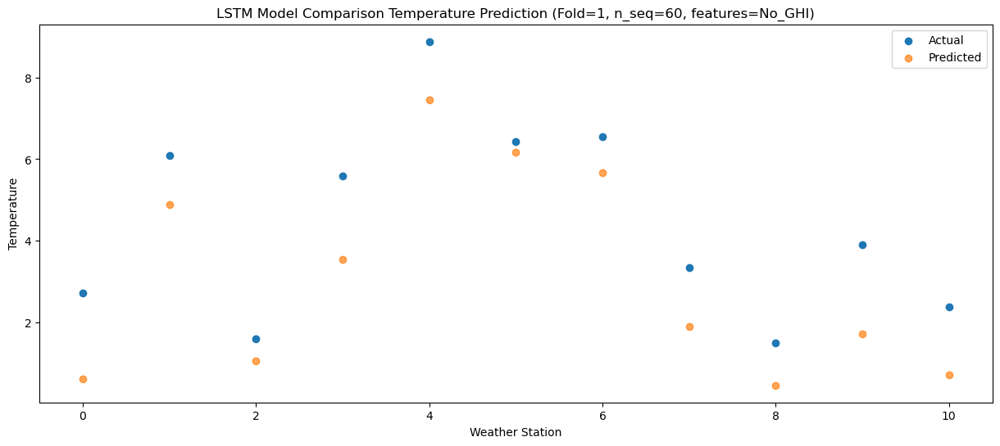

Predictions for (t+37):
    Weather_Station  Actual  Predicted
0                 0   -3.04  -4.616538
1                 1    0.28  -0.354683
2                 2   -1.56  -4.178467
3                 3    3.50  -1.698000
4                 4    6.86   2.204762
5                 5    5.30   0.929464
6                 6    0.54   0.432665
7                 7   -0.40  -3.352827
8                 8   -2.13  -4.783248
9                 9    1.55  -3.519181
10               10   -4.77  -4.529444


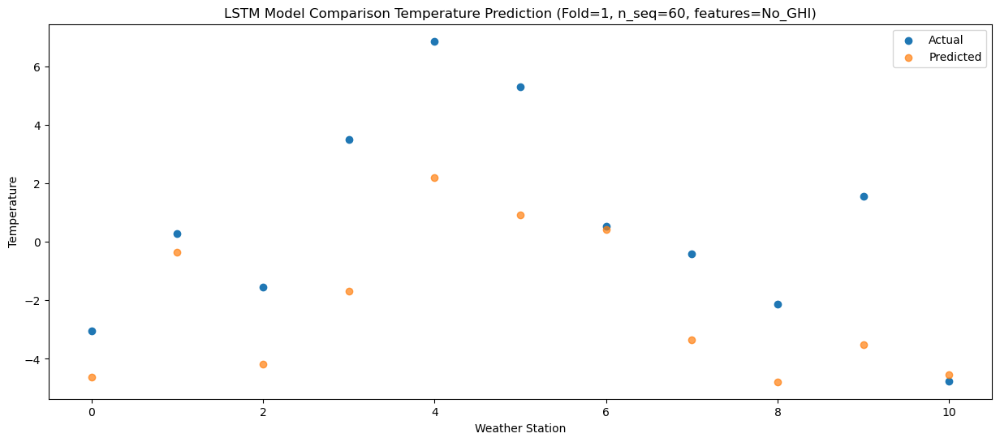

Predictions for (t+38):
    Weather_Station  Actual  Predicted
0                 0   -0.93  -3.290606
1                 1    2.47   0.969405
2                 2   -0.56  -2.854510
3                 3    4.21  -0.370743
4                 4    7.34   3.535498
5                 5    5.76   2.259655
6                 6    2.67   1.763913
7                 7    0.79  -2.028232
8                 8   -1.27  -3.459524
9                 9    1.83  -2.195408
10               10   -1.81  -3.208821


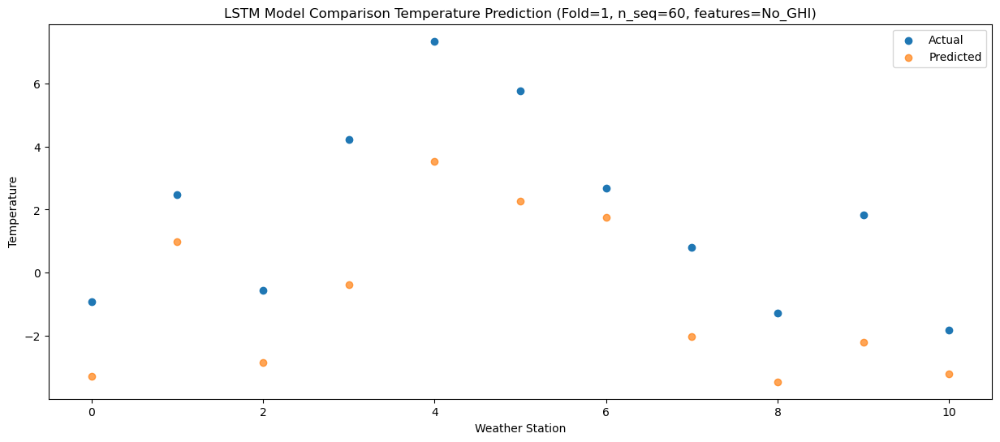

Predictions for (t+39):
    Weather_Station  Actual  Predicted
0                 0    1.98  -2.392966
1                 1    5.84   1.865662
2                 2    2.03  -1.960527
3                 3    5.21   0.529693
4                 4    8.52   4.438308
5                 5    5.90   3.155564
6                 6    6.26   2.666146
7                 7    2.29  -1.131596
8                 8   -0.90  -2.566950
9                 9    2.98  -1.301335
10               10   -2.13  -2.310748


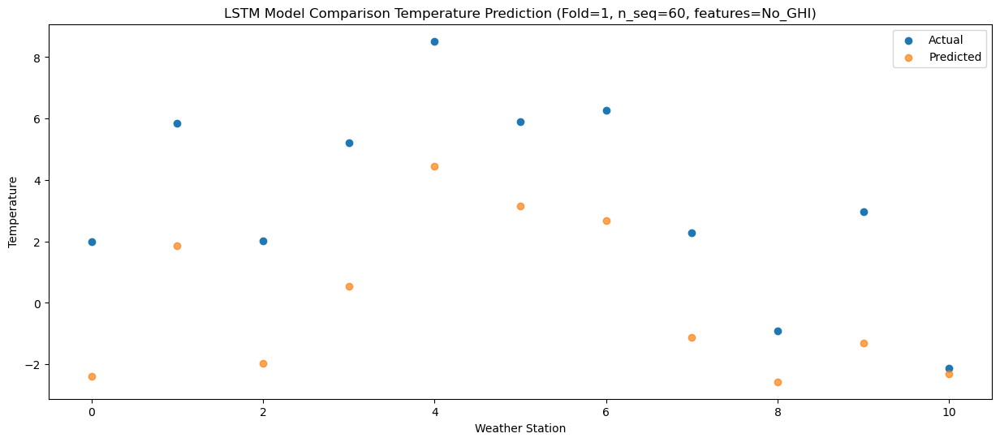

Predictions for (t+40):
    Weather_Station  Actual  Predicted
0                 0    2.62  -0.528550
1                 1    6.61   3.728073
2                 2    3.46  -0.095841
3                 3    9.04   2.398053
4                 4   12.34   6.310605
5                 5   10.96   5.029290
6                 6    6.93   4.536021
7                 7    5.12   0.738385
8                 8    3.53  -0.693968
9                 9    6.71   0.574981
10               10   -1.01  -0.436737


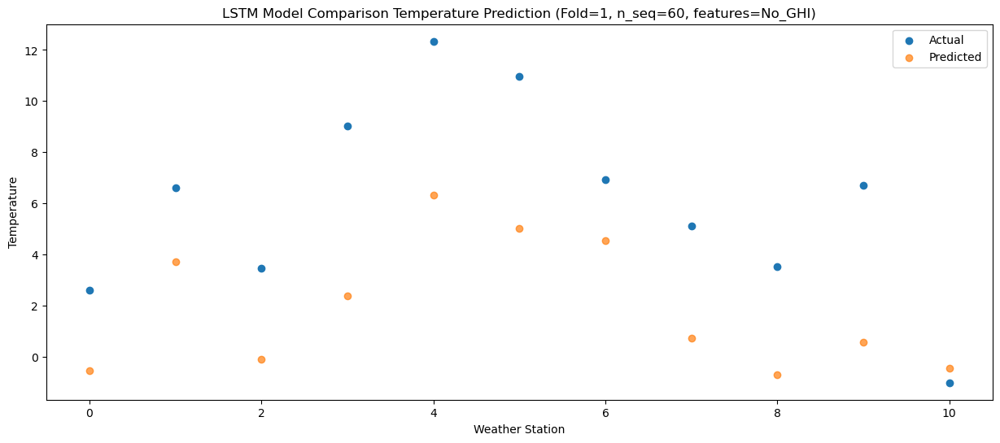

Predictions for (t+41):
    Weather_Station  Actual  Predicted
0                 0    6.12   5.846749
1                 1    9.88  10.106701
2                 2    6.15   6.285322
3                 3    9.88   8.779485
4                 4   13.30  12.692352
5                 5   14.12  11.406978
6                 6   10.19  10.918507
7                 7    9.52   7.120701
8                 8    7.86   5.686701
9                 9   12.06   6.956079
10               10    6.21   5.948252


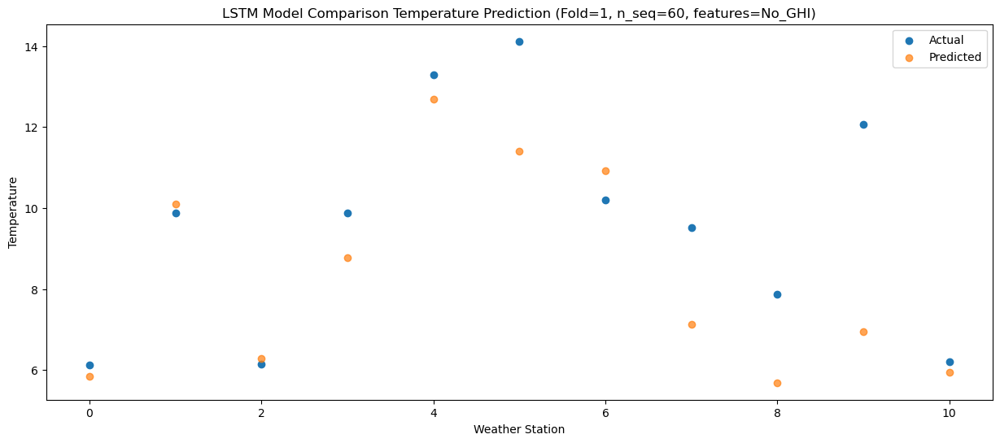

Predictions for (t+42):
    Weather_Station  Actual  Predicted
0                 0    7.62  10.187324
1                 1   13.16  14.445251
2                 2    9.39  10.623366
3                 3   14.47  13.116208
4                 4   17.94  17.031082
5                 5   18.73  15.743382
6                 6   13.19  15.257803
7                 7   14.87  11.457574
8                 8   13.55  10.022887
9                 9   17.17  11.295766
10               10    8.77  10.292925


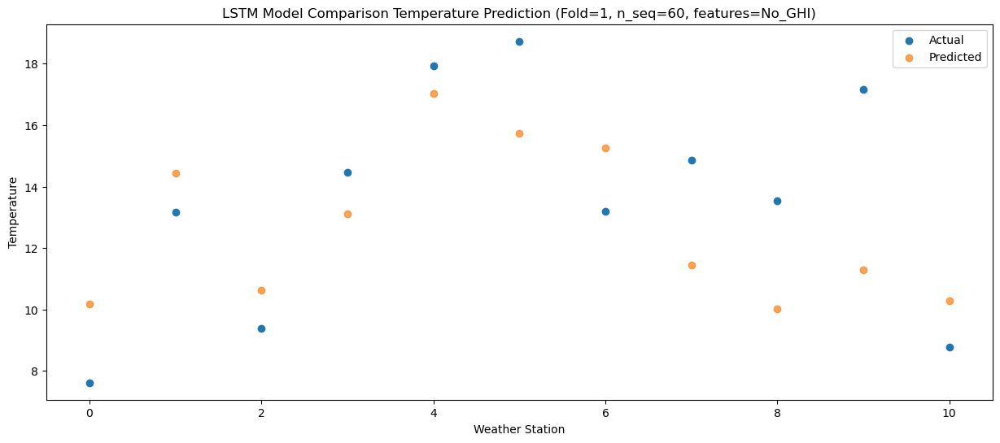

Predictions for (t+43):
    Weather_Station  Actual  Predicted
0                 0   11.24  14.228505
1                 1   16.35  18.484616
2                 2   13.14  14.664435
3                 3   18.62  17.161954
4                 4   22.83  21.077199
5                 5   25.42  19.791029
6                 6   16.47  19.298463
7                 7   18.68  15.499773
8                 8   18.48  14.066046
9                 9   20.40  15.342588
10               10   13.14  14.329433


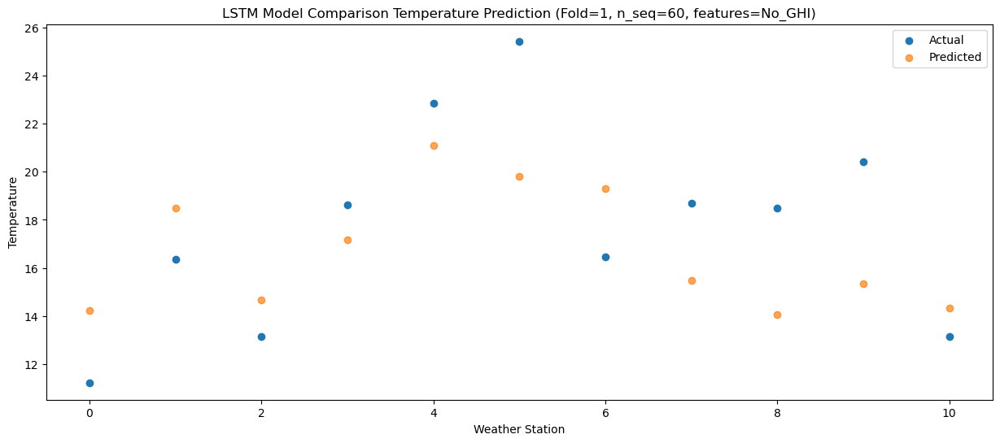

Predictions for (t+44):
    Weather_Station  Actual  Predicted
0                 0   14.47  17.669153
1                 1   19.95  21.925375
2                 2   15.51  18.103541
3                 3   20.34  20.597068
4                 4   24.78  24.510384
5                 5   26.52  23.227425
6                 6   19.92  22.736207
7                 7   20.98  18.934654
8                 8   21.36  17.496972
9                 9   25.02  18.778522
10               10   18.28  17.768259


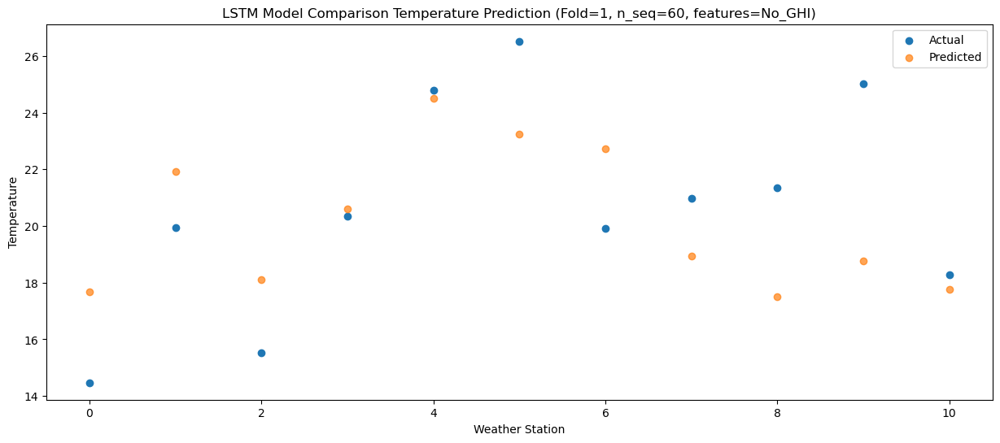

Predictions for (t+45):
    Weather_Station  Actual  Predicted
0                 0   14.26  16.364597
1                 1   19.41  20.620987
2                 2   15.95  16.801995
3                 3   22.31  19.298634
4                 4   26.21  23.213675
5                 5   25.71  21.935093
6                 6   19.50  21.439982
7                 7   21.48  17.641062
8                 8   23.17  16.204978
9                 9   25.42  17.487842
10               10   16.54  16.470813


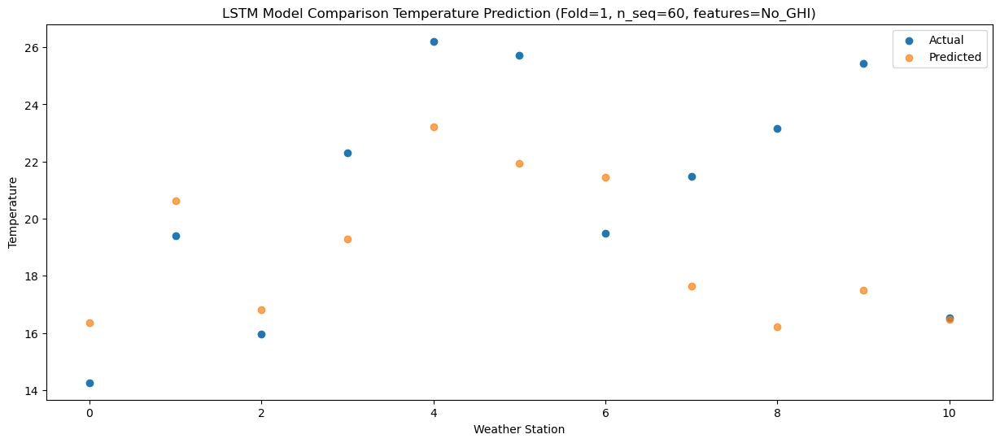

Predictions for (t+46):
    Weather_Station  Actual  Predicted
0                 0   10.57  13.301272
1                 1   15.90  17.558058
2                 2   12.99  13.740644
3                 3   19.23  16.234534
4                 4   22.36  20.151365
5                 5   23.43  18.876880
6                 6   16.33  18.379603
7                 7   17.86  14.579624
8                 8   18.53  13.145984
9                 9   21.90  14.428432
10               10   13.35  13.406596


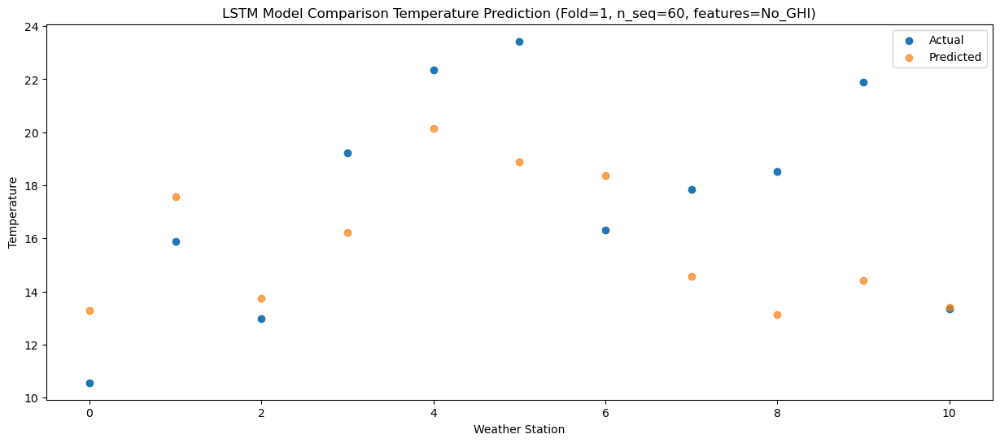

Predictions for (t+47):
    Weather_Station  Actual  Predicted
0                 0    5.69   7.604148
1                 1   10.89  11.863872
2                 2    6.95   8.044145
3                 3   11.97  10.534543
4                 4   14.96  14.453554
5                 5   15.83  13.184599
6                 6   11.32  12.690022
7                 7   11.55   8.886291
8                 8    9.95   7.454934
9                 9   13.80   8.745977
10               10    8.00   7.720441


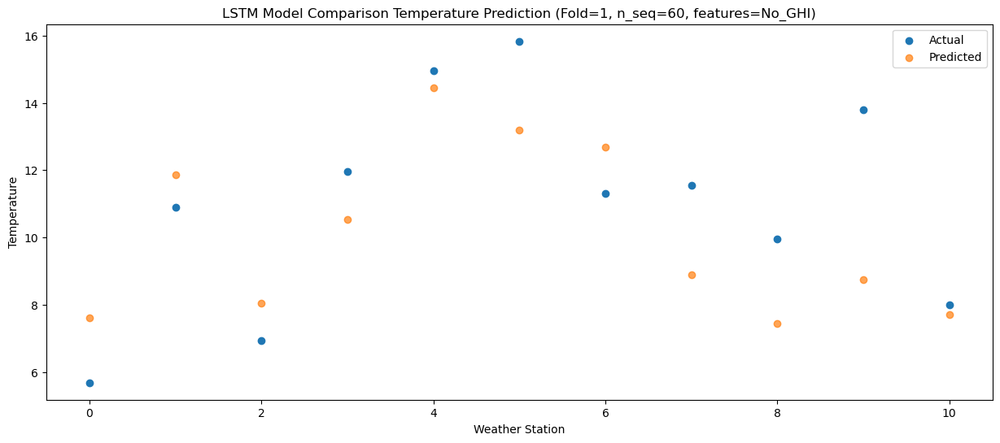

Predictions for (t+48):
    Weather_Station  Actual  Predicted
0                 0    0.54   0.620872
1                 1    5.27   4.887542
2                 2    0.39   1.068977
3                 3    5.69   3.566457
4                 4    8.76   7.487417
5                 5    9.17   6.217489
6                 6    5.63   5.722097
7                 7    4.15   1.916623
8                 8    2.83   0.487403
9                 9    7.05   1.781275
10               10    0.06   0.747025


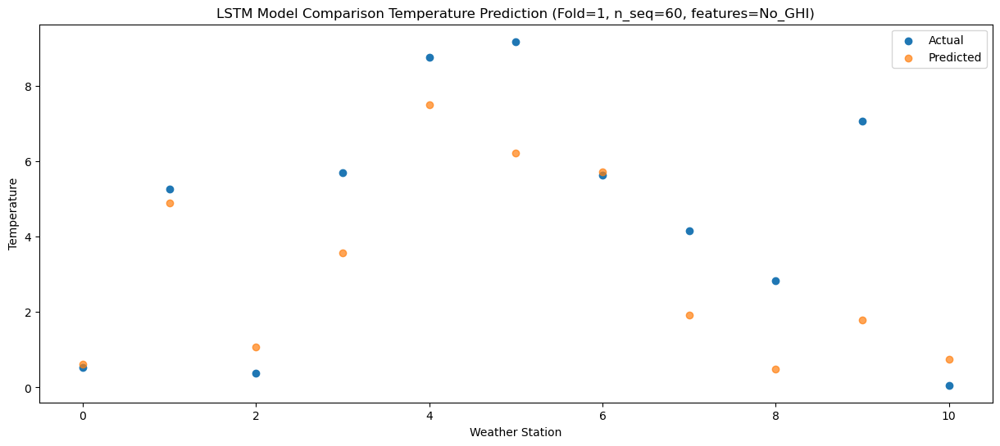

Predictions for (t+49):
    Weather_Station  Actual  Predicted
0                 0   -1.49  -1.566288
1                 1    2.13   2.696567
2                 2   -2.39  -1.120750
3                 3    3.29   1.375506
4                 4    6.86   5.294150
5                 5    6.81   4.023591
6                 6    2.89   3.530968
7                 7    1.23  -0.277026
8                 8   -0.02  -1.711158
9                 9    3.22  -0.421836
10               10   -1.63  -1.441168


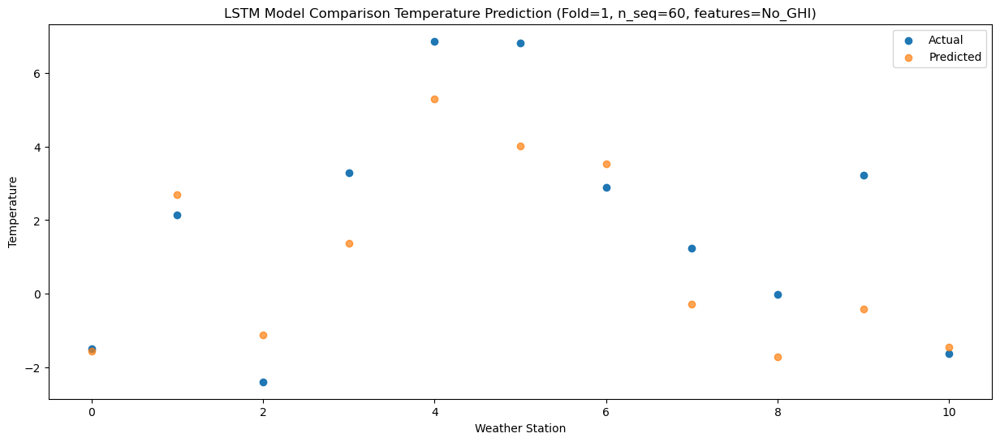

Predictions for (t+50):
    Weather_Station  Actual  Predicted
0                 0   -2.81  -5.857498
1                 1   -1.15  -1.599216
2                 2   -5.47  -5.419123
3                 3   -0.13  -2.925130
4                 4    3.01   0.992744
5                 5    3.20  -0.270443
6                 6   -0.11  -0.762513
7                 7   -4.70  -4.573906
8                 8   -5.85  -6.005482
9                 9   -1.95  -4.709468
10               10   -5.53  -5.735926


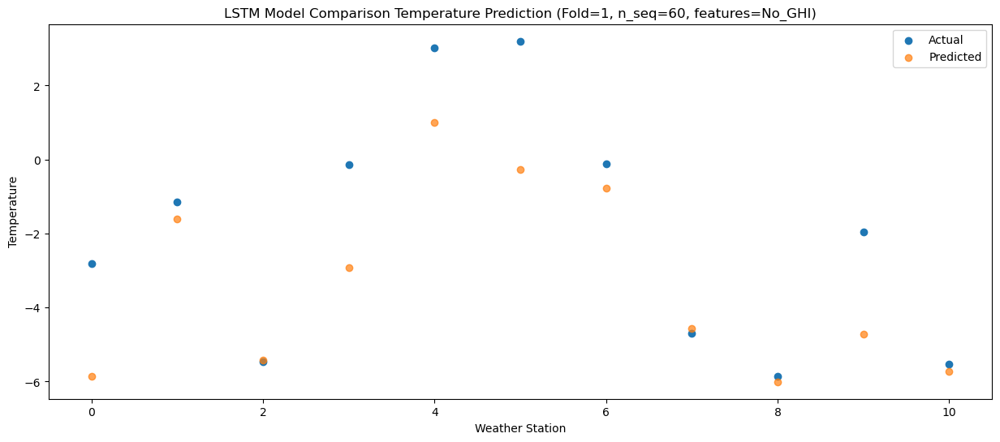

Predictions for (t+51):
    Weather_Station  Actual  Predicted
0                 0   -1.43  -0.945502
1                 1    3.93   3.317898
2                 2   -0.13  -0.500411
3                 3    6.18   1.992296
4                 4    9.38   5.915566
5                 5    9.32   4.655247
6                 6    4.10   4.160925
7                 7    4.30   0.349961
8                 8    2.10  -1.079993
9                 9    5.76   0.218290
10               10   -3.58  -0.817472


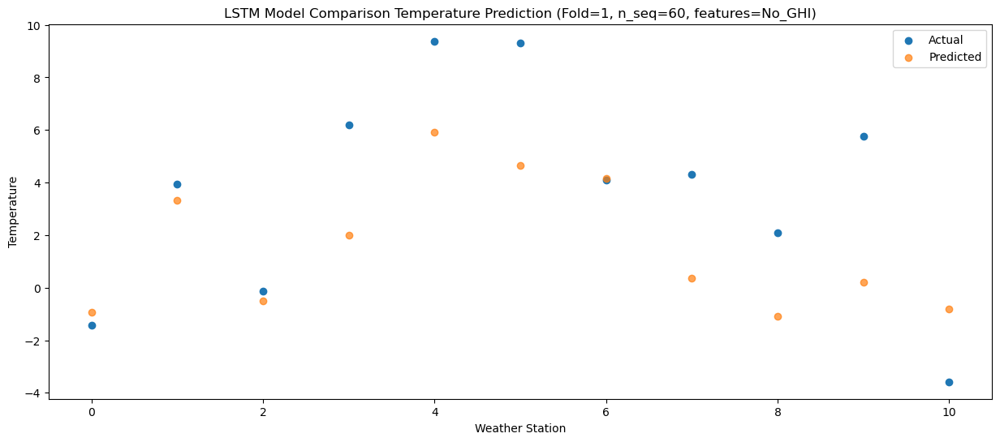

Predictions for (t+52):
    Weather_Station  Actual  Predicted
0                 0    3.42   2.132579
1                 1    7.15   6.395119
2                 2    2.97   2.576627
3                 3    8.69   5.064937
4                 4   12.12   8.989032
5                 5   11.67   7.737611
6                 6    7.76   7.236890
7                 7    7.02   3.425086
8                 8    5.34   1.997277
9                 9    8.59   3.298079
10               10    0.82   2.257691


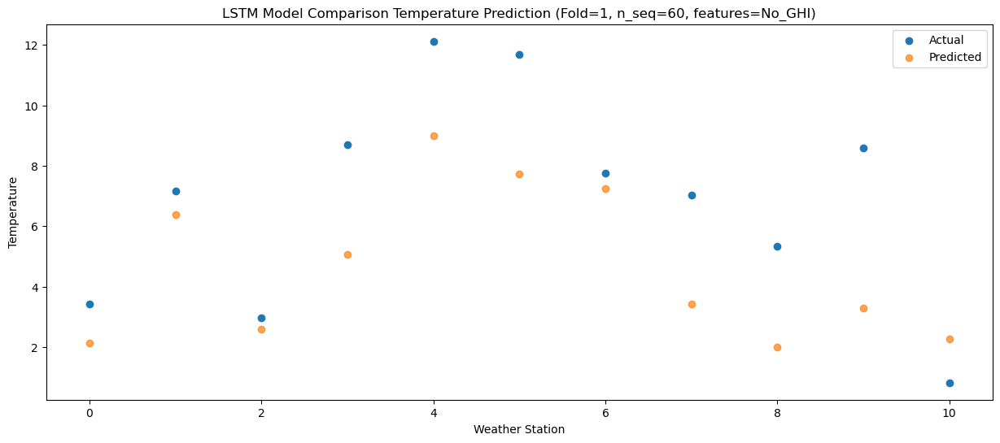

Predictions for (t+53):
    Weather_Station  Actual  Predicted
0                 0    5.82   6.080904
1                 1   10.82  10.346210
2                 2    6.31   6.527136
3                 3   12.17   9.011552
4                 4   15.68  12.932140
5                 5   16.47  11.678372
6                 6   11.23  11.182593
7                 7   11.06   7.370608
8                 8   10.02   5.940149
9                 9   13.66   7.242424
10               10    5.21   6.207740


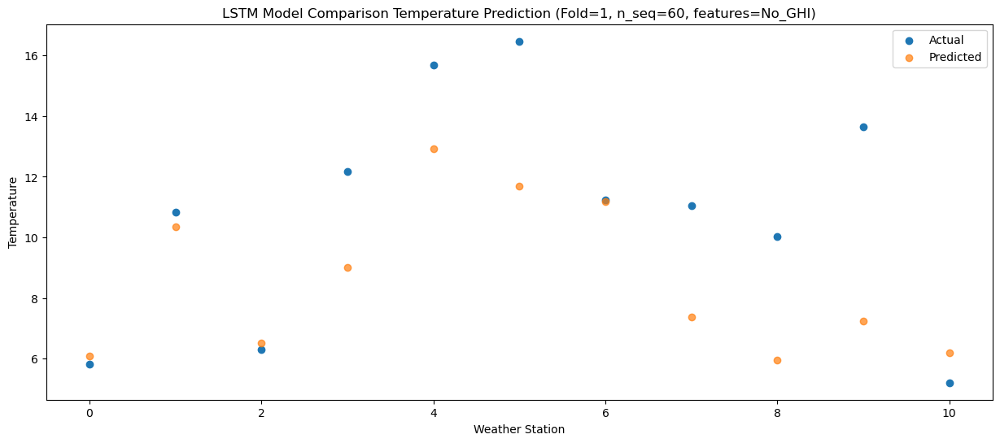

Predictions for (t+54):
    Weather_Station  Actual  Predicted
0                 0   10.49  12.050341
1                 1   15.39  16.315647
2                 2   11.92  12.494951
3                 3   15.87  14.983237
4                 4   19.38  18.907076
5                 5   22.09  17.652215
6                 6   15.47  17.158463
7                 7   16.60  13.344839
8                 8   14.78  11.917350
9                 9   17.80  13.219352
10               10   10.80  12.182482


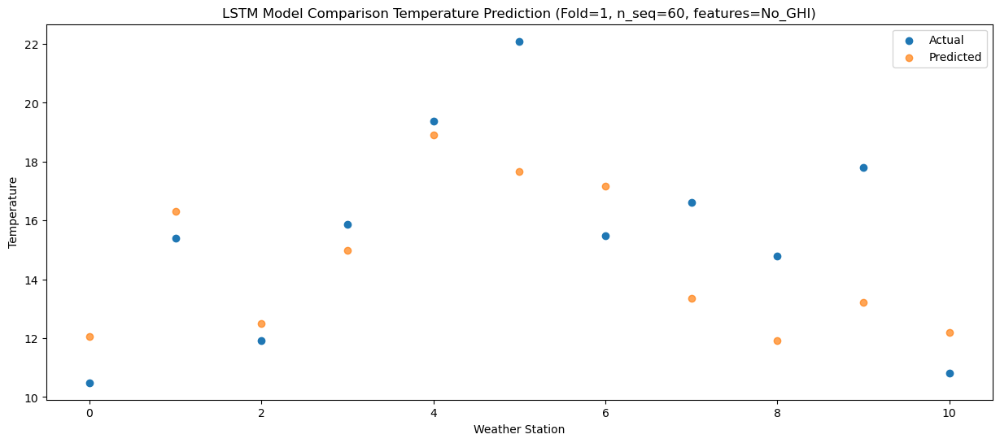

Predictions for (t+55):
    Weather_Station  Actual  Predicted
0                 0   13.36  16.193321
1                 1   19.15  20.456327
2                 2   15.03  16.635856
3                 3   18.50  19.130389
4                 4   22.27  23.060132
5                 5   24.95  21.806572
6                 6   19.40  21.309324
7                 7   19.67  17.496513
8                 8   20.48  16.071799
9                 9   24.21  17.376307
10               10   16.91  16.333461


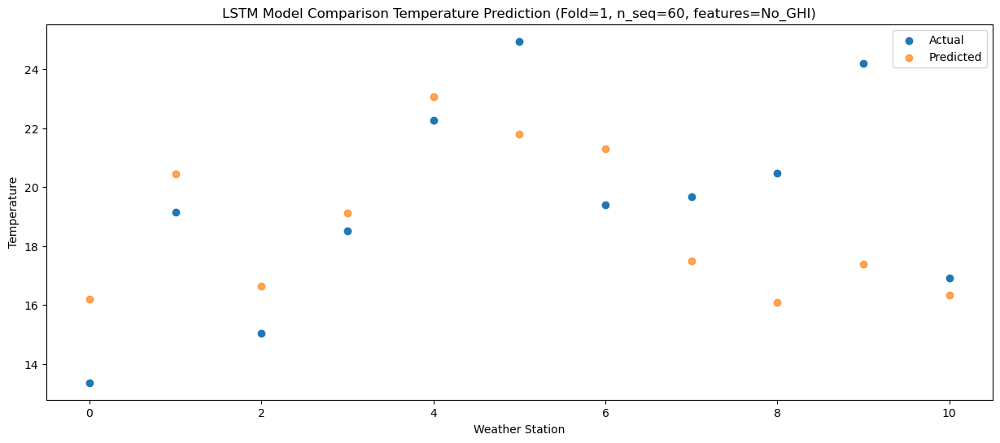

Predictions for (t+56):
    Weather_Station  Actual  Predicted
0                 0   14.32  16.909683
1                 1   20.08  21.174682
2                 2   15.05  17.356379
3                 3   17.89  19.855311
4                 4   22.08  23.787088
5                 5   23.95  22.538493
6                 6   20.43  22.032056
7                 7   20.31  18.223340
8                 8   21.33  16.805880
9                 9   24.94  18.112572
10               10   18.84  17.057123


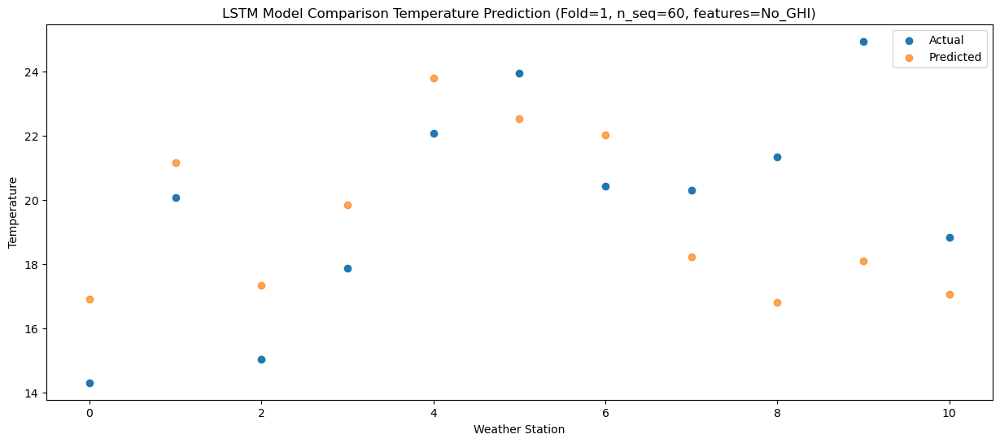

Predictions for (t+57):
    Weather_Station  Actual  Predicted
0                 0   12.97  16.438436
1                 1   19.80  20.701997
2                 2   15.36  16.882633
3                 3   19.02  19.382209
4                 4   23.40  23.318763
5                 5   25.55  22.069185
6                 6   20.10  21.558693
7                 7   20.72  17.756974
8                 8   23.44  16.341725
9                 9   25.74  17.650423
10               10   16.69  16.589374


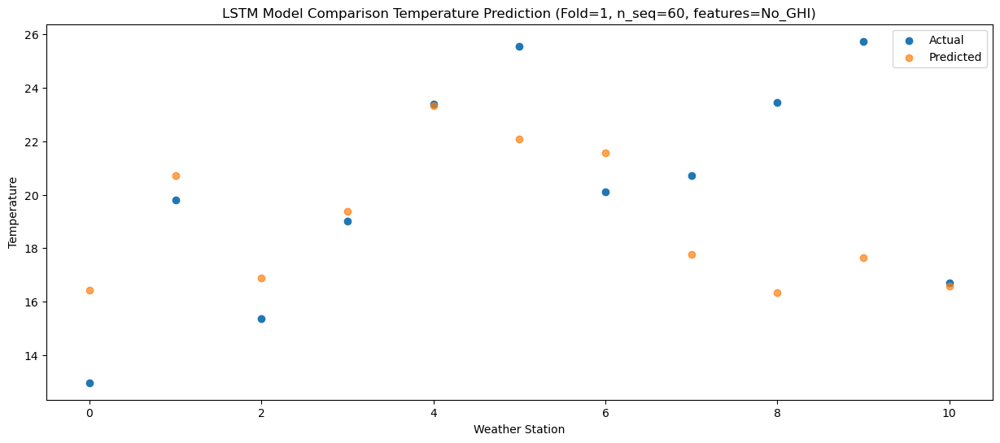

Predictions for (t+58):
    Weather_Station  Actual  Predicted
0                 0   10.53  13.557253
1                 1   16.08  17.818035
2                 2   13.05  13.999341
3                 3   16.42  16.499382
4                 4   20.11  20.434373
5                 5   19.84  19.184463
6                 6   16.80  18.676470
7                 7   18.85  14.874385
8                 8   17.47  13.451261
9                 9   21.18  14.757384
10               10   12.96  13.702413


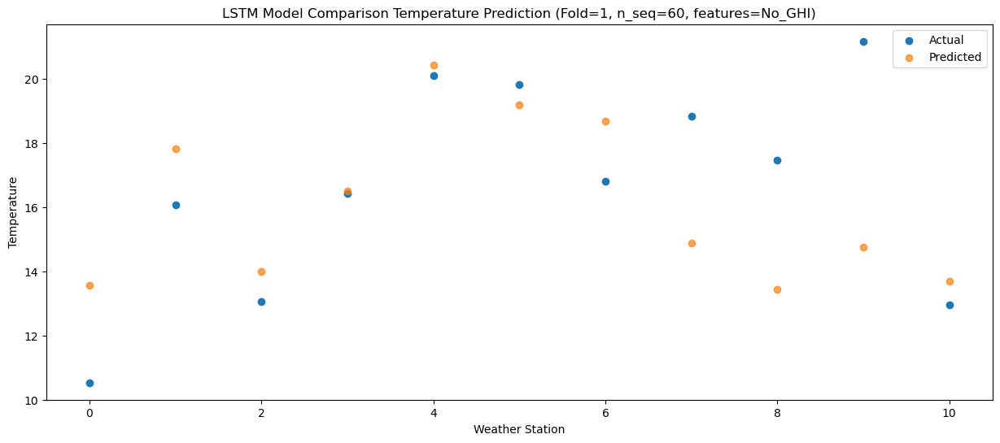

Predictions for (t+59):
    Weather_Station  Actual  Predicted
0                 0    5.65   8.230210
1                 1   11.63  12.491051
2                 2    8.05   8.675226
3                 3   13.73  11.166842
4                 4   16.96  15.102458
5                 5   18.69  13.846926
6                 6   12.00  13.343457
7                 7   13.38   9.543029
8                 8   13.61   8.117321
9                 9   16.33   9.421882
10               10    8.09   8.369563


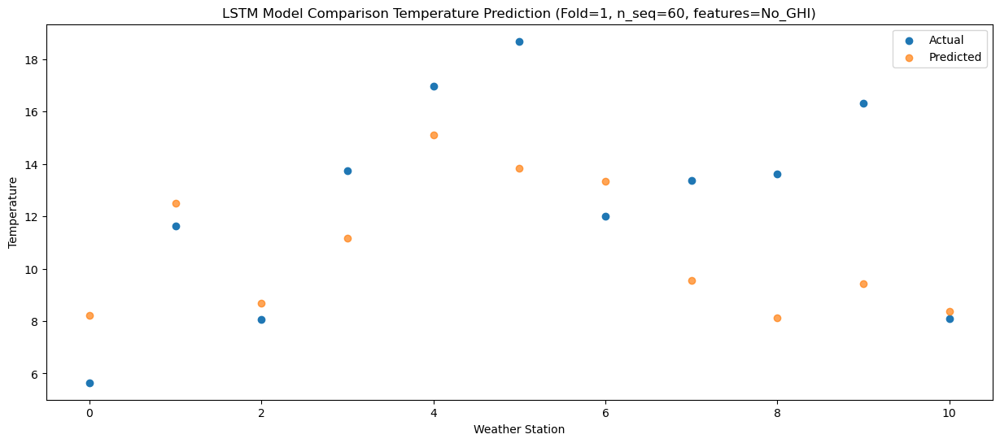

f, t:
[[-1.840e+00  3.520e+00 -1.480e+00  4.050e+00  8.110e+00  7.800e+00
   3.880e+00  9.200e-01  4.400e-01  4.680e+00 -1.560e+00]
 [-1.310e+00  2.610e+00 -1.050e+00  2.630e+00  6.220e+00  5.770e+00
   3.150e+00  3.000e-01 -1.410e+00  3.320e+00 -4.370e+00]
 [-1.420e+00  1.500e+00 -1.580e+00  3.380e+00  7.030e+00  5.110e+00
   2.340e+00 -5.500e-01 -1.230e+00  2.870e+00 -4.030e+00]
 [-1.560e+00  1.590e+00 -1.300e+00  2.850e+00  6.650e+00  4.590e+00
   2.410e+00  1.300e-01 -1.740e+00  1.630e+00 -3.290e+00]
 [ 3.500e+00  7.590e+00  5.800e+00  1.049e+01  1.469e+01  1.194e+01
   8.080e+00  7.050e+00  6.090e+00  9.590e+00  1.030e+00]
 [ 4.990e+00  8.810e+00  4.830e+00  1.037e+01  1.443e+01  1.473e+01
   9.710e+00  8.190e+00  7.470e+00  1.190e+01  2.660e+00]
 [ 8.070e+00  1.216e+01  8.980e+00  1.412e+01  1.823e+01  1.992e+01
   1.249e+01  1.269e+01  1.358e+01  1.843e+01  8.120e+00]
 [ 1.107e+01  1.651e+01  1.321e+01  1.690e+01  2.126e+01  2.264e+01
   1.716e+01  1.825e+01  1.869e+01  2.481e+0

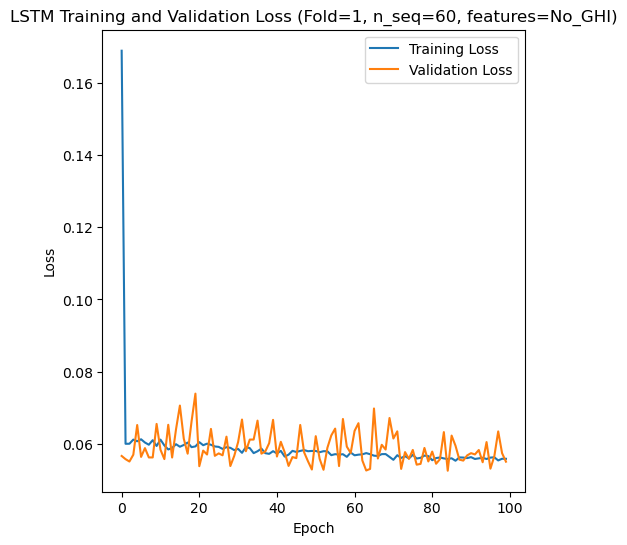

[[ 8.61  4.71 12.22 ... 22.49 18.22 13.52]
 [ 6.28  3.18  8.73 ... 22.36 17.39  7.52]
 [17.82 16.52 20.35 ... 28.79 25.32 22.93]
 ...
 [ 6.77  9.55 12.16 ... 24.55 20.29 10.24]
 [12.04 12.81 10.78 ... 23.32 20.33 13.93]
 [ 8.57  6.56 11.36 ... 21.36 16.14 12.65]]
Epoch 1/100
84/84 [==============================] - 32s 138ms/step - loss: 0.1400 - accuracy: 0.3929 - mae: 0.1138 - rmse: 0.1400 - mape: inf - pearson: 0.6656 - val_loss: 0.0455 - val_accuracy: 0.6000 - val_mae: 0.0353 - val_rmse: 0.0455 - val_mape: 7.8948 - val_pearson: 0.9187
Epoch 2/100
84/84 [==============================] - 6s 69ms/step - loss: 0.0621 - accuracy: 0.5119 - mae: 0.0488 - rmse: 0.0621 - mape: inf - pearson: 0.8317 - val_loss: 0.0461 - val_accuracy: 0.6000 - val_mae: 0.0366 - val_rmse: 0.0461 - val_mape: 8.4981 - val_pearson: 0.9072
Epoch 3/100
84/84 [==============================] - 6s 72ms/step - loss: 0.0617 - accuracy: 0.5119 - mae: 0.0485 - rmse: 0.0617 - mape: inf - pearson: 0.8338 - val_loss: 0.047

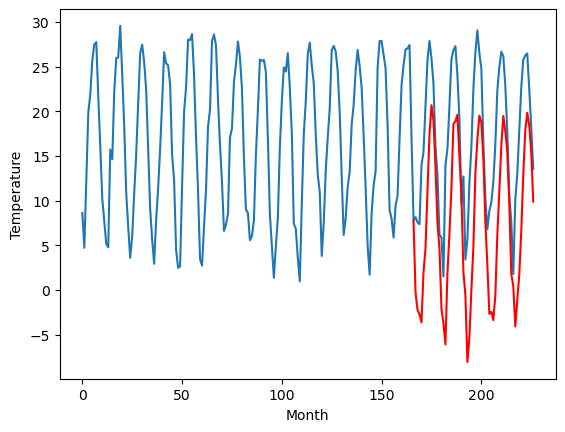

Weather Station 2:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
3.41		-0.21		-3.62
1.13		-2.19		-3.32
0.89		-2.68		-3.57
0.16		-3.58		-3.74
8.17		1.98		-6.19
10.40		4.66		-5.74
17.20		11.16		-6.04
24.40		17.44		-6.96
24.43		20.71		-3.72
23.10		19.08		-4.02
16.97		13.82		-3.15
9.98		7.46		-2.52
6.86		4.70		-2.16
0.23		-2.03		-2.26
0.15		-3.70		-3.85
-3.89		-6.06		-2.17
6.30		1.93		-4.37
10.06		6.32		-3.74
15.24		11.45		-3.79
22.49		18.62		-3.87
23.18		18.92		-4.26
23.94		19.64		-4.30
21.70		14.93		-6.77
13.44		10.81		-2.63
6.73		2.03		-4.70
4.34		-0.56		-4.90
-0.35		-8.03		-7.68
-0.36		-5.33		-4.97
6.62		-0.01		-6.63
13.30		4.83		-8.47
19.10		13.04		-6.06
22.90		16.88		-6.02
26.14		19.52		-6.62
23.83		18.77		-5.06
21.07		14.75		-6.32
12.69		7.67		-5.02
2.70		2.78		0.08
-0.01		-2.69		-2.68
-0.26		-2.47		-2.21
1.34		-3.39		-4.73
5.41		-0.66		-6.07
11.27		6.20		-5.07
16.76		11.00		-5.76
19.37		16.09		-3.28
23.47		19.46		-4.01
23.96		17.81		-6.15
21.09		15.45	

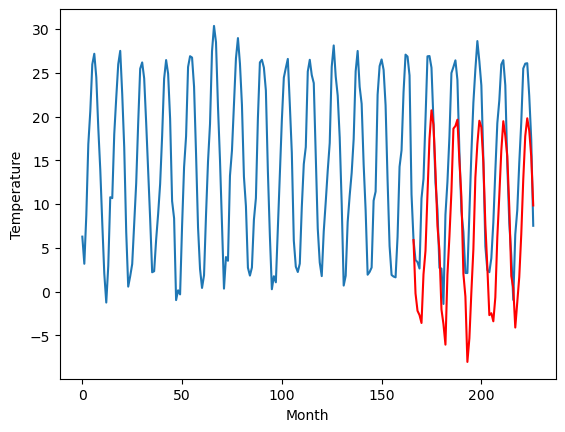

Weather Station 3:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-0.10		-2.54		-2.44
-1.22		-4.52		-3.30
-2.37		-5.02		-2.65
-1.33		-5.93		-4.60
2.29		-0.36		-2.65
3.68		2.31		-1.37
4.99		8.81		3.82
7.58		15.09		7.51
8.22		18.35		10.13
7.91		16.72		8.81
6.65		11.48		4.83
5.38		5.11		-0.27
1.96		2.35		0.39
-5.03		-4.39		0.64
-4.37		-6.06		-1.69
-1.64		-8.42		-6.78
0.17		-0.43		-0.60
1.98		3.97		1.99
5.56		9.09		3.53
6.78		16.26		9.48
7.57		16.56		8.99
7.62		17.27		9.65
6.34		12.57		6.23
5.20		8.47		3.27
-1.65		-0.32		1.33
-0.75		-2.90		-2.15
-5.01		-10.38		-5.37
-2.68		-7.68		-5.00
0.79		-2.37		-3.16
2.60		2.48		-0.12
5.36		10.69		5.33
7.17		14.52		7.35
7.35		17.17		9.82
6.78		16.43		9.65
5.37		12.42		7.05
2.74		5.35		2.61
0.98		0.45		-0.53
-3.12		-5.01		-1.89
-3.32		-4.78		-1.46
-0.26		-5.71		-5.45
0.76		-2.98		-3.74
3.30		3.87		0.57
4.28		8.68		4.40
6.69		13.78		7.09
8.60		17.16		8.56
8.78		15.51		6.73
6.83		13.15		6.32
3.25		7.35		4.10
-0.73		-0.50		0.23

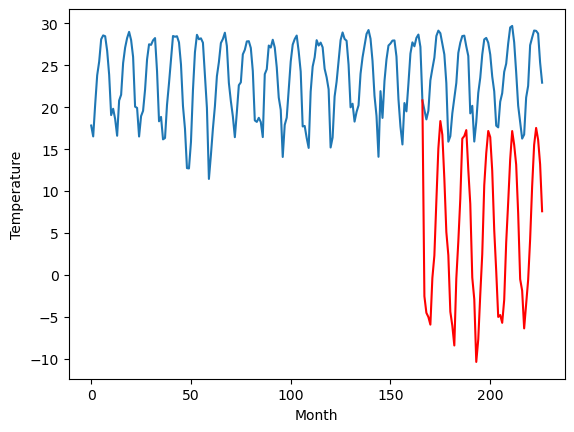

Weather Station 4:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
9.24		8.99		-0.25
6.18		7.01		0.83
6.45		6.51		0.06
6.60		5.61		-0.99
10.15		11.17		1.02
11.38		13.85		2.47
17.27		20.35		3.08
23.33		26.63		3.30
27.61		29.91		2.30
25.76		28.27		2.51
21.18		23.02		1.84
15.96		16.66		0.70
12.00		13.90		1.90
5.17		7.17		2.00
2.09		5.50		3.41
2.11		3.15		1.04
6.22		11.15		4.93
10.72		15.54		4.82
15.98		20.66		4.68
21.55		27.84		6.29
23.55		28.13		4.58
24.61		28.84		4.23
21.44		24.14		2.70
17.61		20.03		2.42
9.53		11.25		1.72
7.61		8.67		1.06
1.46		1.19		-0.27
3.78		3.90		0.12
7.64		9.20		1.56
12.08		14.05		1.97
17.42		22.26		4.84
21.66		26.10		4.44
26.28		28.75		2.47
26.20		28.01		1.81
21.16		24.00		2.84
15.72		16.93		1.21
11.92		12.03		0.11
5.75		6.57		0.82
7.04		6.80		-0.24
5.16		5.87		0.71
7.60		8.60		1.00
13.32		15.47		2.15
16.95		20.27		3.32
20.74		25.37		4.63
26.31		28.75		2.44
24.30		27.10		2.80
21.88		24.74		2.86
16.86		18.94		2.08
8.88		11.09		2.21
8.1

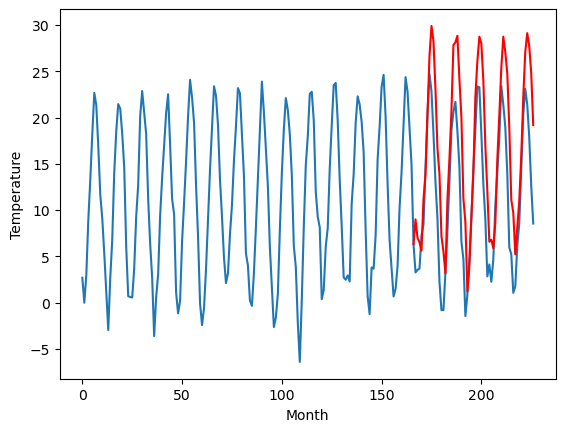

Weather Station 5:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-6.25		-6.14		0.11
-5.90		-8.13		-2.23
-5.56		-8.62		-3.06
-4.92		-9.52		-4.60
1.77		-3.96		-5.73
1.24		-1.28		-2.52
4.21		5.22		1.01
7.25		11.50		4.25
7.99		14.78		6.79
8.36		13.14		4.78
6.01		7.90		1.89
2.32		1.54		-0.78
-1.80		-1.23		0.57
-8.10		-7.96		0.14
-7.75		-9.63		-1.88
-8.49		-11.99		-3.50
-1.16		-3.99		-2.83
-0.29		0.40		0.69
4.18		5.53		1.35
7.66		12.70		5.04
8.25		12.99		4.74
8.42		13.70		5.28
5.88		8.99		3.11
3.14		4.89		1.75
-5.13		-3.89		1.24
-1.72		-6.47		-4.75
-9.45		-13.95		-4.50
-6.31		-11.25		-4.94
-2.55		-5.94		-3.39
1.25		-1.09		-2.34
6.41		7.12		0.71
9.00		10.96		1.96
8.83		13.61		4.78
8.01		12.87		4.86
6.04		8.85		2.81
-0.15		1.78		1.93
-3.22		-3.11		0.11
-5.73		-8.57		-2.84
-4.56		-8.35		-3.79
-2.43		-9.27		-6.84
-0.60		-6.54		-5.94
1.32		0.32		-1.00
5.35		5.12		-0.23
9.00		10.23		1.23
10.44		13.61		3.17
11.74		11.96		0.22
7.31		9.60		2.29
1.15		3.80		2.65
-3.96		-4

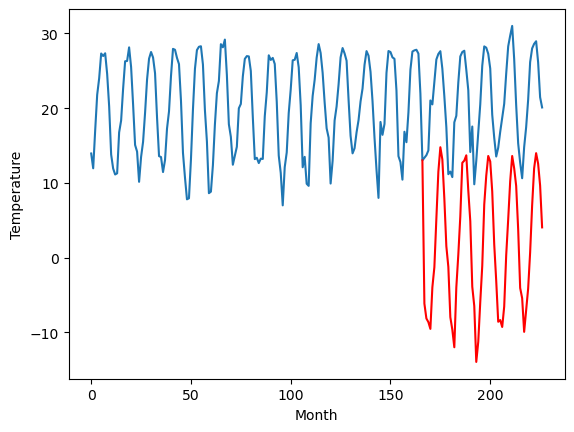

Weather Station 6:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
7.27		5.12		-2.15
5.84		3.14		-2.70
6.21		2.64		-3.57
5.45		1.73		-3.72
13.54		7.30		-6.24
13.51		9.97		-3.54
17.35		16.47		-0.88
20.96		22.74		1.78
22.66		26.01		3.35
22.96		24.38		1.42
18.56		19.14		0.58
14.09		12.78		-1.31
11.41		10.02		-1.39
5.30		3.29		-2.01
4.71		1.62		-3.09
2.36		-0.74		-3.10
10.74		7.26		-3.48
12.86		11.65		-1.21
16.90		16.78		-0.12
21.45		23.94		2.49
21.53		24.23		2.70
22.64		24.94		2.30
19.90		20.23		0.33
16.60		16.13		-0.47
8.96		7.34		-1.62
12.20		4.77		-7.43
3.77		-2.71		-6.48
3.39		-0.01		-3.40
9.51		5.30		-4.21
15.66		10.15		-5.51
20.26		18.36		-1.90
23.98		22.20		-1.78
25.34		24.86		-0.48
22.62		24.12		1.50
19.96		20.10		0.14
14.39		13.03		-1.36
8.51		8.13		-0.38
6.28		2.67		-3.61
7.04		2.89		-4.15
8.23		1.97		-6.26
12.03		4.70		-7.33
12.95		11.55		-1.40
18.03		16.35		-1.68
22.95		21.46		-1.49
25.11		24.83		-0.28
26.81		23.19		-3.62
22.33		20.83		-1.50
14.44		

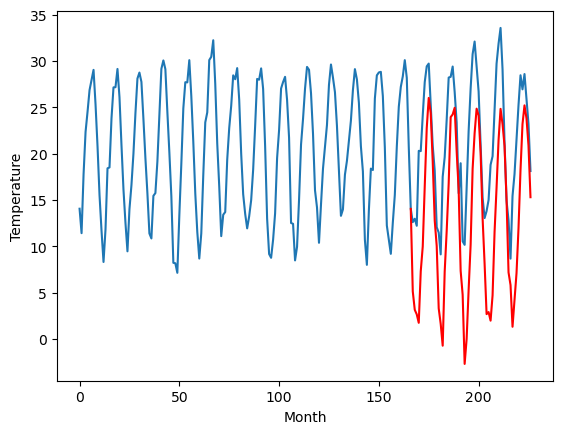

Weather Station 7:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
6.65		5.23		-1.42
4.84		3.25		-1.59
5.19		2.75		-2.44
4.63		1.85		-2.78
12.28		7.41		-4.87
12.59		10.08		-2.51
17.49		16.57		-0.92
22.23		22.85		0.62
23.41		26.12		2.71
23.64		24.48		0.84
17.70		19.25		1.55
12.22		12.89		0.67
9.73		10.13		0.40
3.27		3.40		0.13
2.57		1.72		-0.85
-0.54		-0.64		-0.10
9.83		7.36		-2.47
11.53		11.75		0.22
15.61		16.88		1.27
21.17		24.04		2.87
22.06		24.33		2.27
22.62		25.04		2.42
20.35		20.33		-0.02
15.84		16.23		0.39
7.87		7.44		-0.43
10.16		4.87		-5.29
1.68		-2.61		-4.29
1.51		0.09		-1.42
8.09		5.40		-2.69
14.36		10.24		-4.12
19.38		18.45		-0.93
24.09		22.29		-1.80
26.88		24.94		-1.94
24.07		24.21		0.14
20.24		20.19		-0.05
13.86		13.12		-0.74
7.19		8.22		1.03
4.57		2.76		-1.81
5.45		2.98		-2.47
5.64		2.05		-3.59
10.29		4.78		-5.51
12.11		11.63		-0.48
17.85		16.43		-1.42
22.00		21.54		-0.46
24.56		24.91		0.35
26.90		23.26		-3.64
22.12		20.90		-1.22
13.40		15.10		

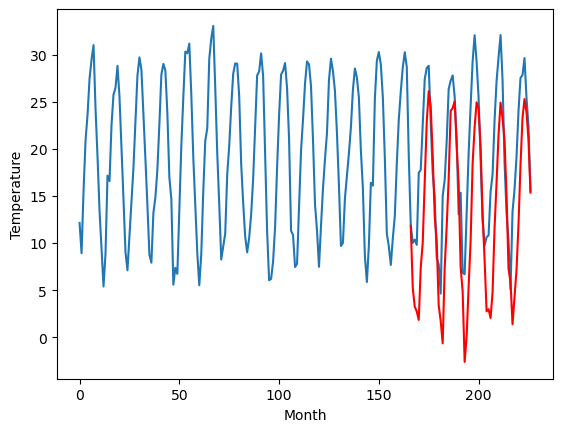

Weather Station 8:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
6.03		3.32		-2.71
1.50		1.33		-0.17
2.75		0.84		-1.91
3.56		-0.07		-3.63
8.06		5.49		-2.57
13.04		8.17		-4.87
19.33		14.67		-4.66
22.85		20.95		-1.90
24.95		24.22		-0.73
25.39		22.60		-2.79
19.14		17.35		-1.79
13.54		10.99		-2.55
7.98		8.22		0.24
0.33		1.50		1.17
0.87		-0.18		-1.05
3.79		-2.53		-6.32
6.89		5.45		-1.44
13.55		9.84		-3.71
18.56		14.97		-3.59
23.55		22.14		-1.41
22.35		22.42		0.07
21.83		23.13		1.30
19.65		18.42		-1.23
13.09		14.32		1.23
7.69		5.54		-2.15
4.34		2.96		-1.38
1.34		-4.52		-5.86
2.31		-1.82		-4.13
7.37		3.48		-3.89
14.56		8.33		-6.23
19.26		16.54		-2.72
23.12		20.38		-2.74
24.26		23.04		-1.22
21.24		22.30		1.06
19.51		18.29		-1.22
11.30		11.21		-0.09
4.41		6.31		1.90
2.24		0.85		-1.39
1.53		1.07		-0.46
2.74		0.14		-2.60
7.44		2.89		-4.55
13.08		9.73		-3.35
17.73		14.53		-3.20
22.39		19.63		-2.76
27.14		23.00		-4.14
24.14		21.36		-2.78
21.48		19.00		-2.48
14.74		13.2

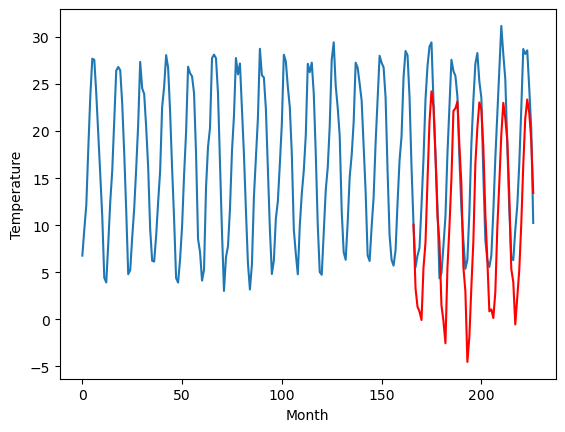

Weather Station 9:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
2.17		-2.04		-4.21
-1.37		-4.03		-2.66
-0.83		-4.53		-3.70
1.28		-5.43		-6.71
1.35		0.11		-1.24
4.56		2.79		-1.77
8.61		9.29		0.68
9.90		15.57		5.67
12.31		18.84		6.53
14.71		17.22		2.51
13.11		11.96		-1.15
9.87		5.59		-4.28
3.15		2.81		-0.34
1.10		-3.91		-5.01
1.04		-5.59		-6.63
0.12		-7.94		-8.06
-0.28		0.04		0.32
3.58		4.43		0.85
5.80		9.56		3.76
10.04		16.73		6.69
13.02		17.01		3.99
12.62		17.71		5.09
10.84		13.00		2.16
5.86		8.90		3.04
4.60		0.12		-4.48
-1.91		-2.45		-0.54
0.50		-9.93		-10.43
1.37		-7.24		-8.61
3.16		-1.94		-5.10
5.28		2.92		-2.36
6.24		11.12		4.88
11.16		14.96		3.80
11.97		17.62		5.65
14.01		16.88		2.87
13.60		12.87		-0.73
7.33		5.79		-1.54
1.10		0.89		-0.21
-1.60		-4.57		-2.97
-1.94		-4.35		-2.41
-2.26		-5.28		-3.02
-1.25		-2.54		-1.29
2.59		4.31		1.72
3.80		9.10		5.30
5.76		14.20		8.44
12.68		17.57		4.89
12.31		15.92		3.61
8.81		13.56		4.75
7.22		7.76		0.54
2.83		-0.1

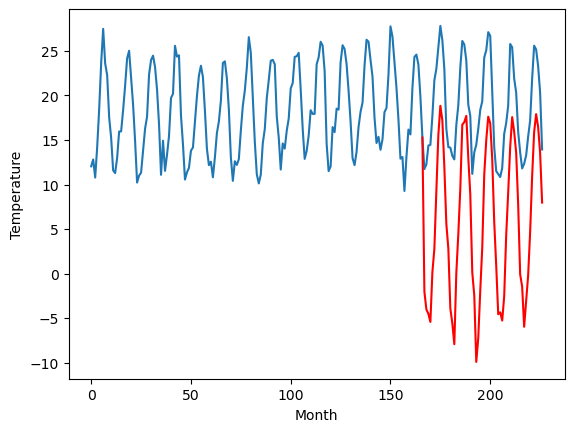

Weather Station 10:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
2.04		3.22		1.18
1.63		1.22		-0.41
1.34		0.73		-0.61
2.38		-0.18		-2.56
7.61		5.39		-2.22
8.91		8.06		-0.85
11.51		14.55		3.04
16.80		20.83		4.03
19.79		24.11		4.32
18.79		22.48		3.69
14.76		17.23		2.47
10.84		10.87		0.03
6.23		8.10		1.87
-0.77		1.37		2.14
-1.18		-0.30		0.88
-0.68		-2.66		-1.98
6.20		5.34		-0.86
8.99		9.73		0.74
13.01		14.85		1.84
17.30		22.02		4.72
18.87		22.30		3.43
18.96		23.01		4.05
14.85		18.30		3.45
11.57		14.21		2.64
2.66		5.43		2.77
4.58		2.85		-1.73
-1.90		-4.63		-2.73
2.12		-1.93		-4.05
6.23		3.37		-2.86
9.52		8.21		-1.31
14.37		16.41		2.04
18.13		20.25		2.12
19.57		22.90		3.33
18.19		22.17		3.98
14.88		18.16		3.28
7.57		11.08		3.51
5.45		6.18		0.73
-1.08		0.72		1.80
2.12		0.94		-1.18
5.14		0.01		-5.13
5.59		2.75		-2.84
9.11		9.60		0.49
11.89		14.39		2.50
15.55		19.50		3.95
19.14		22.87		3.73
18.59		21.22		2.63
14.63		18.87		4.24
9.34		13.07		3.73
3.44		5.21		1.77


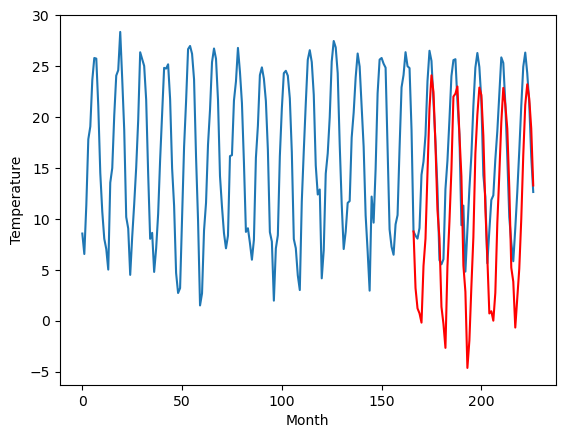

Weather Station 11:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-1.92		-0.25		1.67
-1.32		-2.25		-0.93
-1.76		-2.74		-0.98
-1.96		-3.64		-1.68
4.08		1.93		-2.15
4.51		4.61		0.10
8.55		11.10		2.55
13.92		17.38		3.46
17.21		20.66		3.45
15.95		19.02		3.07
12.00		13.78		1.78
7.34		7.42		0.08
2.29		4.65		2.36
-4.77		-2.08		2.69
-4.44		-3.75		0.69
-3.09		-6.11		-3.02
3.12		1.88		-1.24
5.09		6.28		1.19
10.00		11.40		1.40
15.41		18.57		3.16
16.72		18.85		2.13
16.80		19.57		2.77
12.31		14.86		2.55
8.55		10.77		2.22
-1.67		1.98		3.65
0.43		-0.59		-1.02
-6.44		-8.07		-1.63
-1.85		-5.37		-3.52
2.70		-0.07		-2.77
5.86		4.77		-1.09
12.10		12.97		0.87
15.75		16.81		1.06
17.10		19.47		2.37
15.85		18.74		2.89
11.70		14.72		3.02
4.42		7.64		3.22
1.97		2.75		0.78
-3.49		-2.71		0.78
-1.57		-2.50		-0.93
1.22		-3.42		-4.64
1.75		-0.69		-2.44
6.64		6.17		-0.47
9.99		10.96		0.97
12.90		16.07		3.17
16.45		19.45		3.00
15.74		17.80		2.06
12.96		15.45		2.49
6.91		9.65		2.74
0.70		1

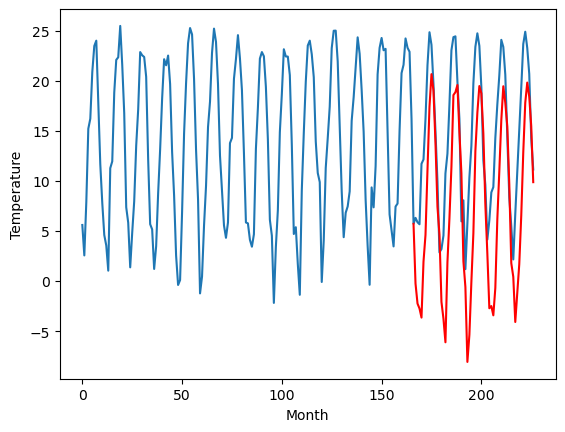

Predictions for (t+0):
    Weather_Station  Actual  Predicted
0                 0   -0.65  -0.258404
1                 1    3.41  -0.210005
2                 2   -0.10  -2.539657
3                 3    9.24   8.993538
4                 4   -6.25  -6.144923
5                 5    7.27   5.122590
6                 6    6.65   5.232718
7                 7    6.03   3.322117
8                 8    2.17  -2.038410
9                 9    2.04   3.220353
10               10   -1.92  -0.253426


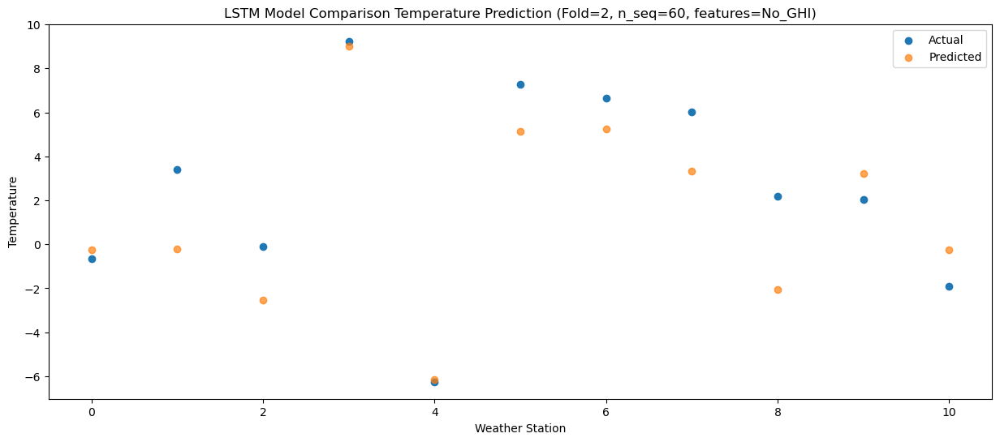

Predictions for (t+1):
    Weather_Station  Actual  Predicted
0                 0   -0.31  -2.240226
1                 1    1.13  -2.190076
2                 2   -1.22  -4.521739
3                 3    6.18   7.007240
4                 4   -5.90  -8.130639
5                 5    5.84   3.135531
6                 6    4.84   3.246238
7                 7    1.50   1.329509
8                 8   -1.37  -4.031306
9                 9    1.63   1.224127
10               10   -1.32  -2.245589


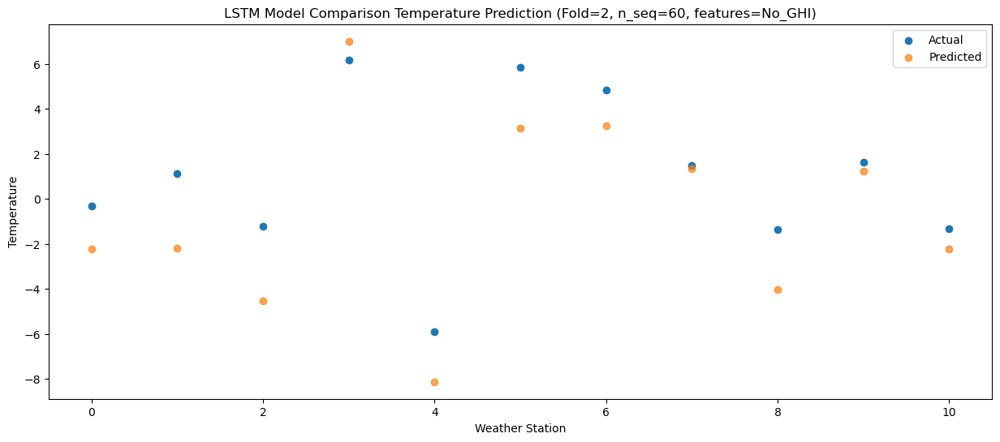

Predictions for (t+2):
    Weather_Station  Actual  Predicted
0                 0   -0.90  -2.729979
1                 1    0.89  -2.680526
2                 2   -2.37  -5.020457
3                 3    6.45   6.512320
4                 4   -5.56  -8.619099
5                 5    6.21   2.641767
6                 6    5.19   2.752511
7                 7    2.75   0.837189
8                 8   -0.83  -4.526706
9                 9    1.34   0.729278
10               10   -1.76  -2.739803


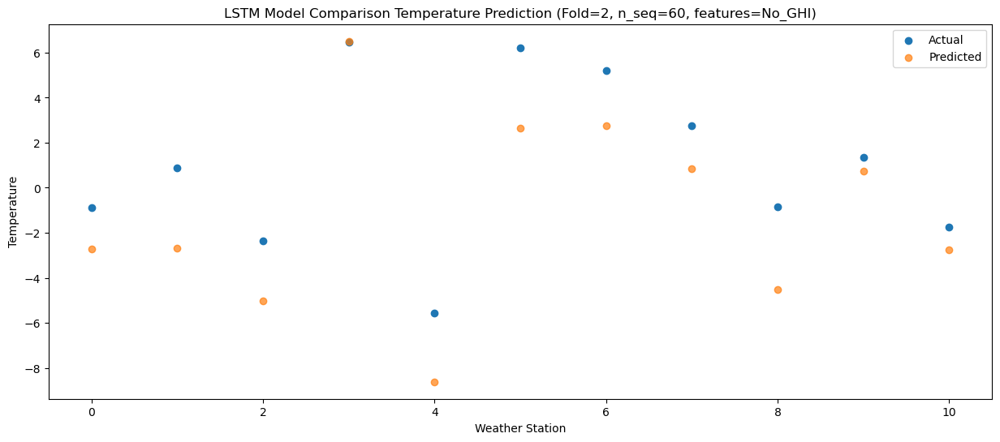

Predictions for (t+3):
    Weather_Station  Actual  Predicted
0                 0   -1.09  -3.630047
1                 1    0.16  -3.581333
2                 2   -1.33  -5.925678
3                 3    6.60   5.606217
4                 4   -4.92  -9.524912
5                 5    5.45   1.732846
6                 6    4.63   1.846125
7                 7    3.56  -0.067056
8                 8    1.28  -5.434321
9                 9    2.38  -0.178024
10               10   -1.96  -3.644184


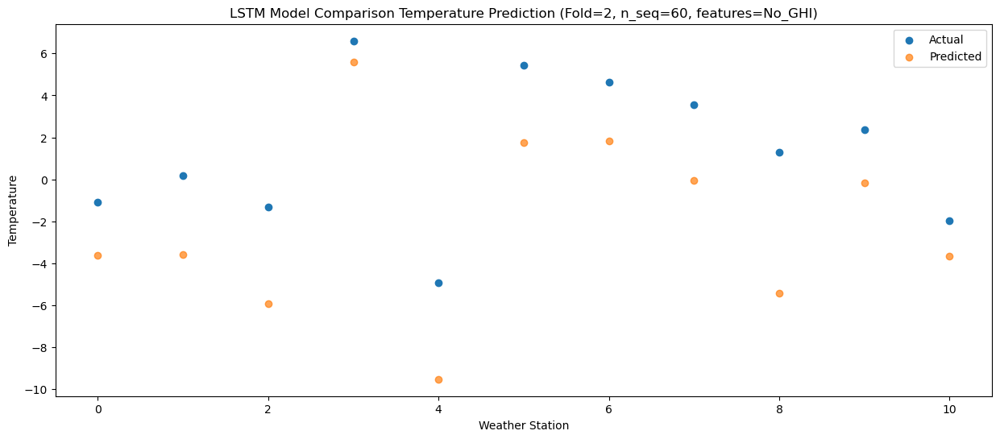

Predictions for (t+4):
    Weather_Station  Actual  Predicted
0                 0    5.50   1.944642
1                 1    8.17   1.980768
2                 2    2.29  -0.360511
3                 3   10.15  11.172692
4                 4    1.77  -3.956110
5                 5   13.54   7.295826
6                 6   12.28   7.407492
7                 7    8.06   5.489345
8                 8    1.35   0.111083
9                 9    7.61   5.385643
10               10    4.08   1.931461


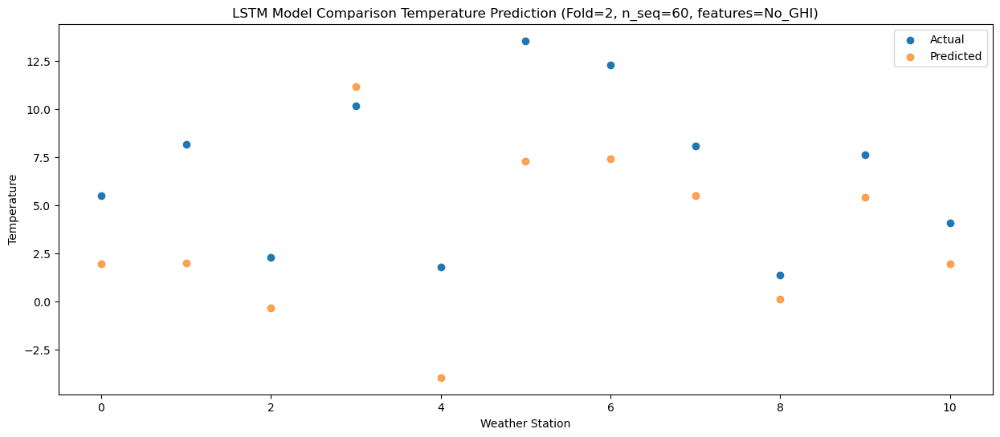

Predictions for (t+5):
    Weather_Station  Actual  Predicted
0                 0    6.98   4.622646
1                 1   10.40   4.661111
2                 2    3.68   2.313503
3                 3   11.38  13.846799
4                 4    1.24  -1.277324
5                 5   13.51   9.973777
6                 6   12.59  10.081838
7                 7   13.04   8.171854
8                 8    4.56   2.793435
9                 9    8.91   8.063527
10               10    4.51   4.608813


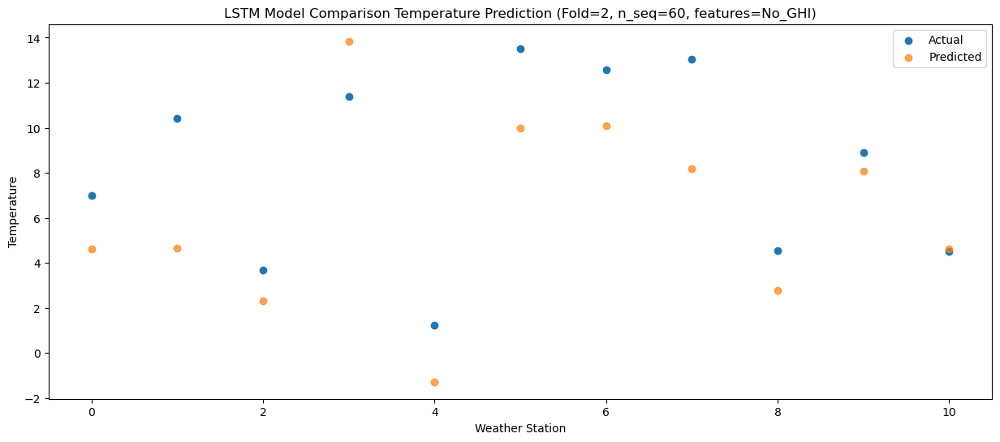

Predictions for (t+6):
    Weather_Station  Actual  Predicted
0                 0   12.27  11.120529
1                 1   17.20  11.161932
2                 2    4.99   8.810882
3                 3   17.27  20.348524
4                 4    4.21   5.222542
5                 5   17.35  16.465642
6                 6   17.49  16.573315
7                 7   19.33  14.669066
8                 8    8.61   9.289721
9                 9   11.51  14.554584
10               10    8.55  11.100725


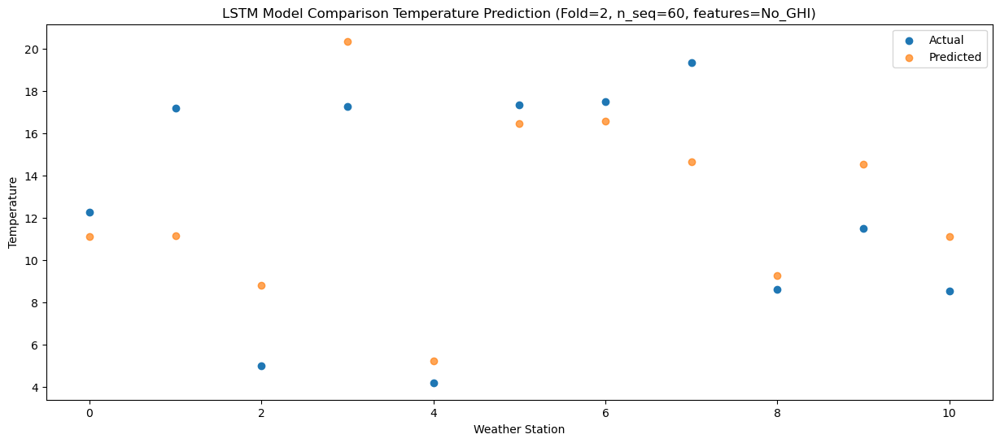

Predictions for (t+7):
    Weather_Station  Actual  Predicted
0                 0   17.27  17.399513
1                 1   24.40  17.437150
2                 2    7.58  15.085942
3                 3   23.33  26.630422
4                 4    7.25  11.501457
5                 5   20.96  22.741018
6                 6   22.23  22.850397
7                 7   22.85  20.947471
8                 8    9.90  15.566979
9                 9   16.80  20.834626
10               10   13.92  17.381901


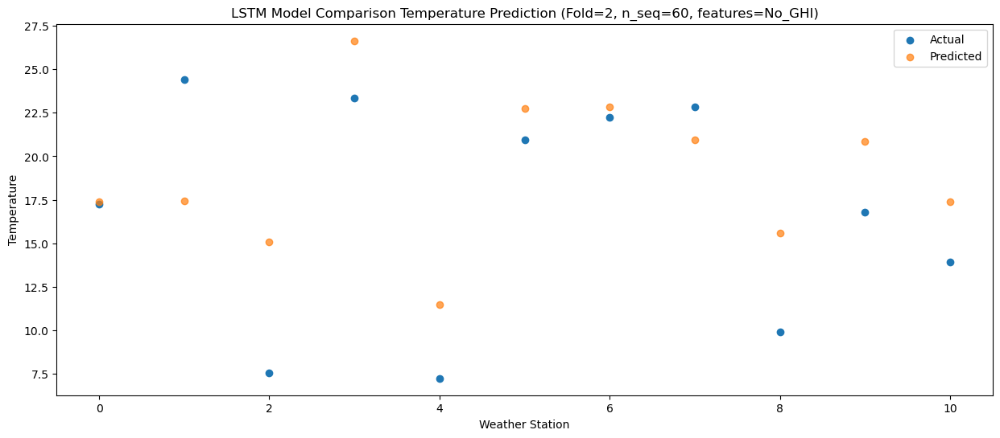

Predictions for (t+8):
    Weather_Station  Actual  Predicted
0                 0   19.43  20.672602
1                 1   24.43  20.707015
2                 2    8.22  18.353843
3                 3   27.61  29.905960
4                 4    7.99  14.777613
5                 5   22.66  26.012474
6                 6   23.41  26.119866
7                 7   24.95  24.218288
8                 8   12.31  18.836480
9                 9   19.79  24.109550
10               10   17.21  20.657567


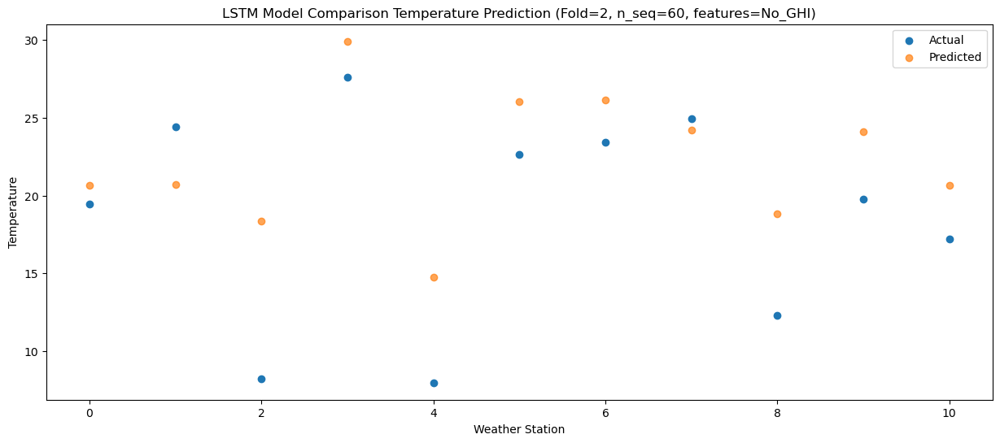

Predictions for (t+9):
    Weather_Station  Actual  Predicted
0                 0   17.45  19.028661
1                 1   23.10  19.075318
2                 2    7.91  16.717497
3                 3   25.76  28.268650
4                 4    8.36  13.140492
5                 5   22.96  24.375948
6                 6   23.64  24.483561
7                 7   25.39  22.597729
8                 8   14.71  17.216150
9                 9   18.79  22.477966
10               10   15.95  19.021041


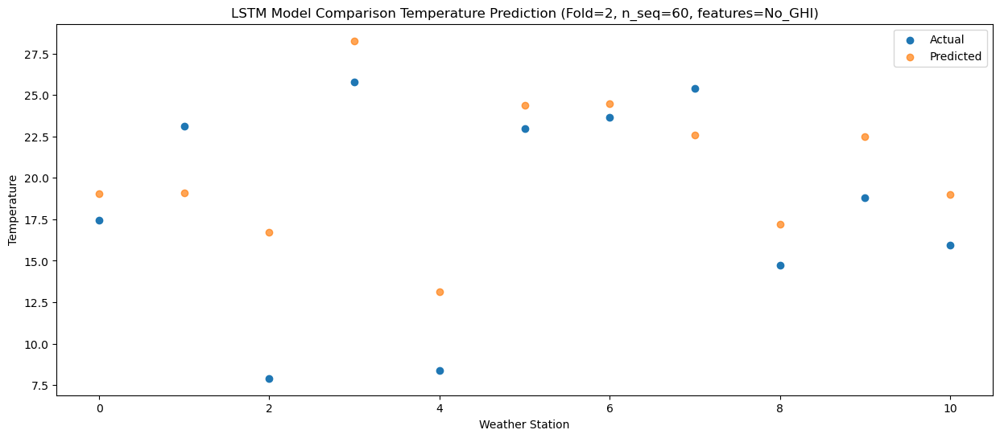

Predictions for (t+10):
    Weather_Station  Actual  Predicted
0                 0   14.61  13.784367
1                 1   16.97  13.823795
2                 2    6.65  11.475183
3                 3   21.18  23.023130
4                 4    6.01   7.897763
5                 5   18.56  19.138737
6                 6   17.70  19.245264
7                 7   19.14  17.347572
8                 8   13.11  11.962079
9                 9   14.76  17.234941
10               10   12.00  13.780882


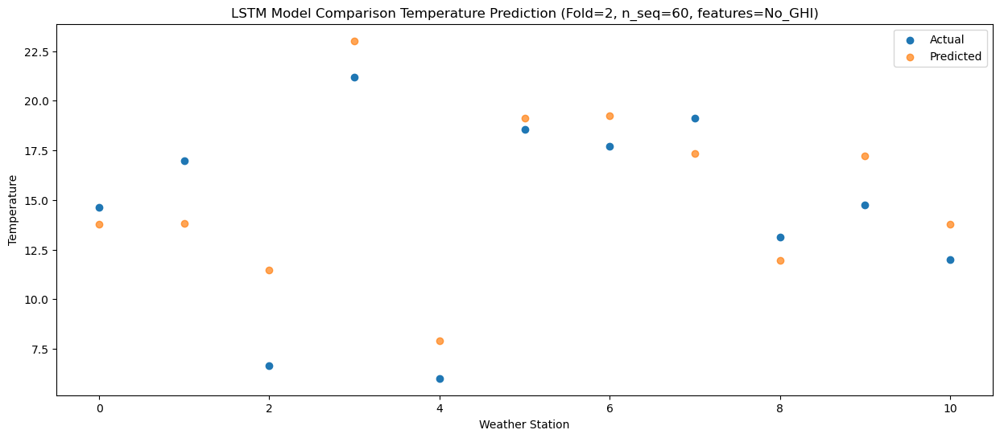

Predictions for (t+11):
    Weather_Station  Actual  Predicted
0                 0    7.60   7.426160
1                 1    9.98   7.464321
2                 2    5.38   5.112444
3                 3   15.96  16.659468
4                 4    2.32   1.535886
5                 5   14.09  12.784195
6                 6   12.22  12.891941
7                 7   13.54  10.986493
8                 8    9.87   5.585888
9                 9   10.84  10.870802
10               10    7.34   7.418507


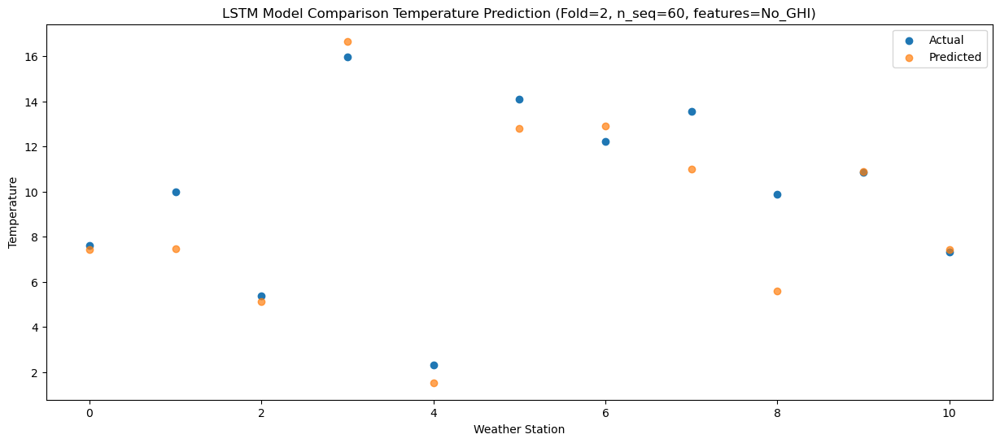

Predictions for (t+12):
    Weather_Station  Actual  Predicted
0                 0    4.47   4.670956
1                 1    6.86   4.702785
2                 2    1.96   2.348947
3                 3   12.00  13.900455
4                 4   -1.80  -1.227763
5                 5   11.41  10.021644
6                 6    9.73  10.128450
7                 7    7.98   8.221589
8                 8    3.15   2.810832
9                 9    6.23   8.100711
10               10    2.29   4.654563


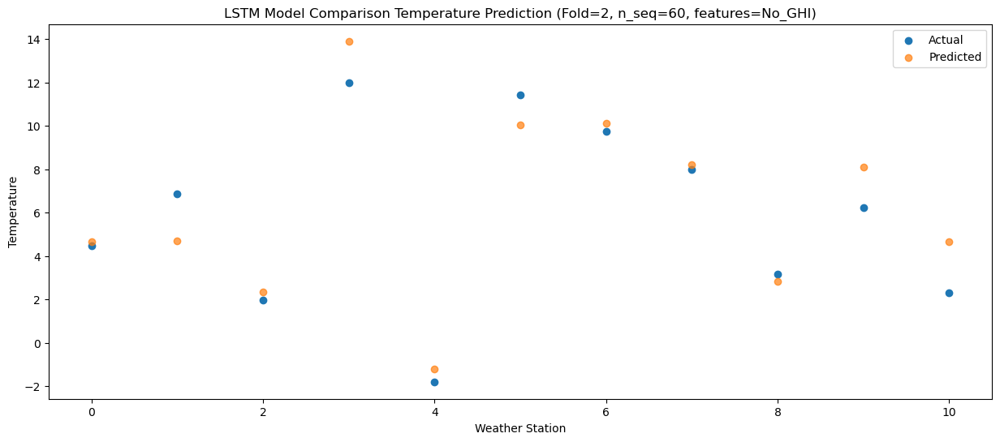

Predictions for (t+13):
    Weather_Station  Actual  Predicted
0                 0   -2.29  -2.073662
1                 1    0.23  -2.034982
2                 2   -5.03  -4.387475
3                 3    5.17   7.168392
4                 4   -8.10  -7.957945
5                 5    5.30   3.292758
6                 6    3.27   3.398202
7                 7    0.33   1.496566
8                 8    1.10  -3.910364
9                 9   -0.77   1.372552
10               10   -4.77  -2.078418


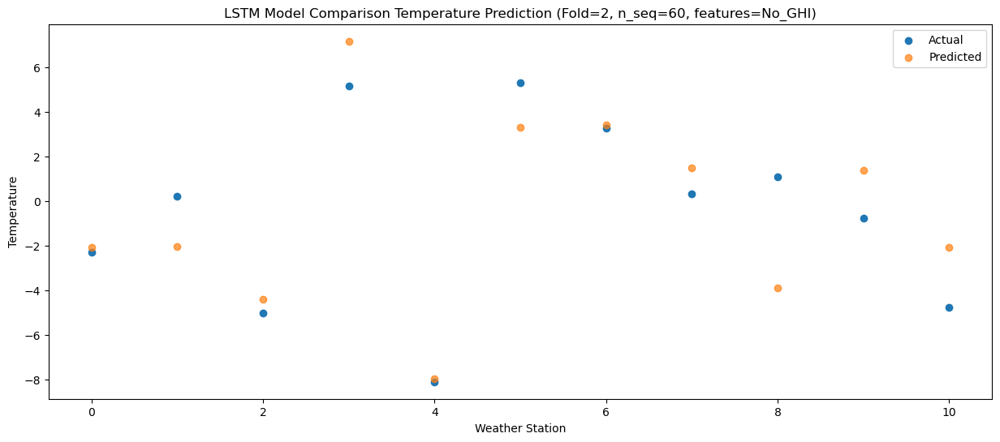

Predictions for (t+14):
    Weather_Station  Actual  Predicted
0                 0   -2.55  -3.746726
1                 1    0.15  -3.701261
2                 2   -4.37  -6.060677
3                 3    2.09   5.504510
4                 4   -7.75  -9.632990
5                 5    4.71   1.615090
6                 6    2.57   1.718067
7                 7    0.87  -0.178441
8                 8    1.04  -5.588702
9                 9   -1.18  -0.301802
10               10   -4.44  -3.753357


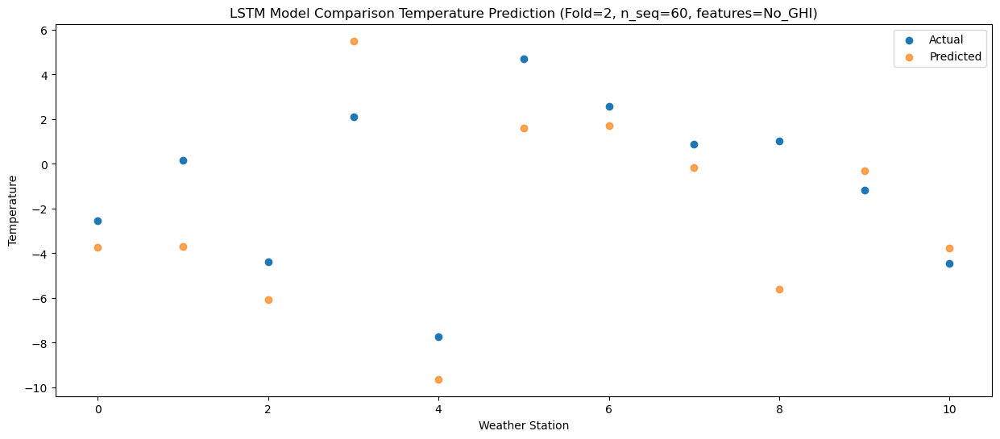

Predictions for (t+15):
    Weather_Station  Actual  Predicted
0                 0   -6.95  -6.105432
1                 1   -3.89  -6.059540
2                 2   -1.64  -8.416435
3                 3    2.11   3.148994
4                 4   -8.49 -11.986294
5                 5    2.36  -0.738940
6                 6   -0.54  -0.637624
7                 7    3.79  -2.534508
8                 8    0.12  -7.940804
9                 9   -0.68  -2.657326
10               10   -3.09  -6.109822


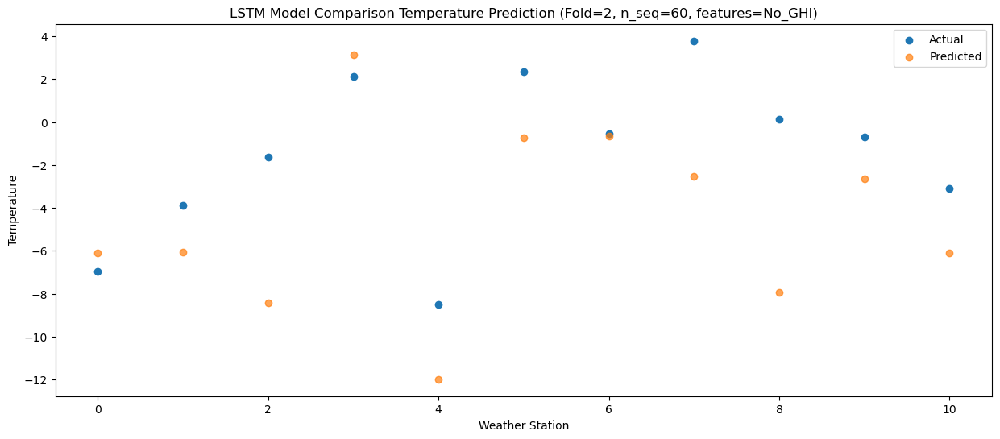

Predictions for (t+16):
    Weather_Station  Actual  Predicted
0                 0    5.47   1.894523
1                 1    6.30   1.934744
2                 2    0.17  -0.425892
3                 3    6.22  11.146061
4                 4   -1.16  -3.992066
5                 5   10.74   7.255296
6                 6    9.83   7.358893
7                 7    6.89   5.453035
8                 8   -0.28   0.043097
9                 9    6.20   5.335281
10               10    3.12   1.883755


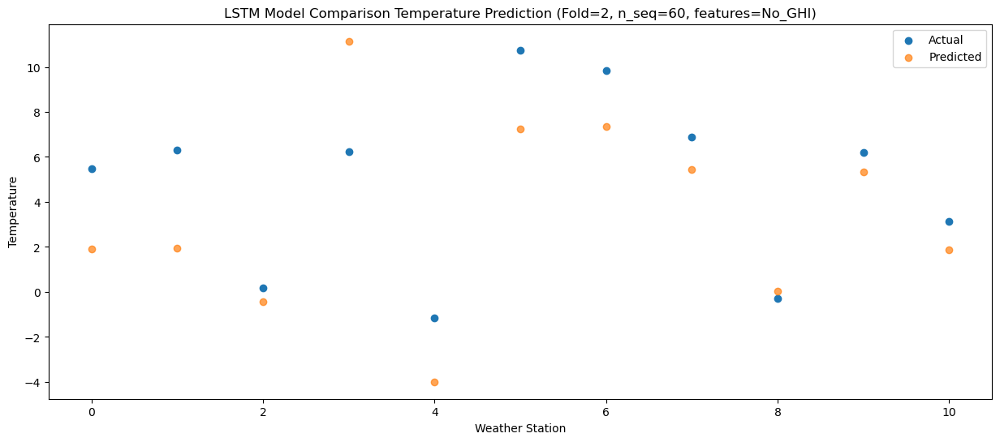

Predictions for (t+17):
    Weather_Station  Actual  Predicted
0                 0    7.34   6.282694
1                 1   10.06   6.321154
2                 2    1.98   3.969259
3                 3   10.72  15.544342
4                 4   -0.29   0.403026
5                 5   12.86  11.647864
6                 6   11.53  11.749192
7                 7   13.55   9.841173
8                 8    3.58   4.427717
9                 9    8.99   9.725325
10               10    5.09   6.275382


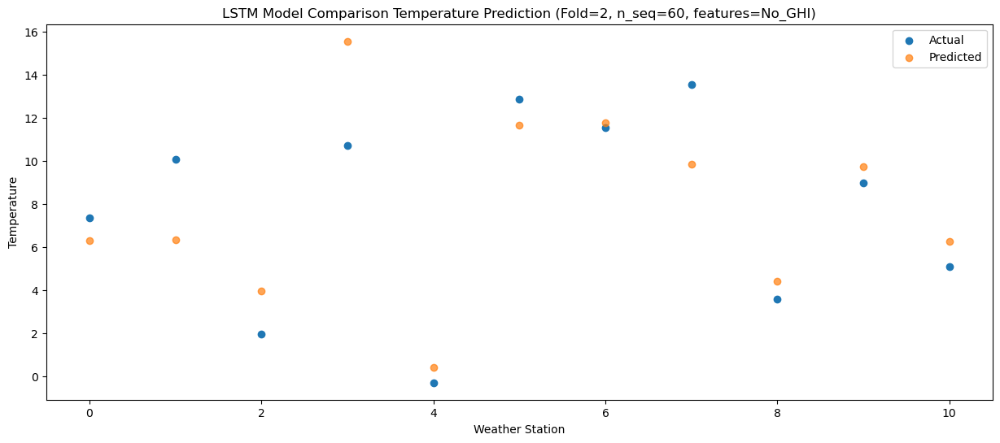

Predictions for (t+18):
    Weather_Station  Actual  Predicted
0                 0   12.12  11.399876
1                 1   15.24  11.445276
2                 2    5.56   9.094973
3                 3   15.98  20.664967
4                 4    4.18   5.526128
5                 5   16.90  16.777188
6                 6   15.61  16.876530
7                 7   18.56  14.970972
8                 8    5.80   9.561124
9                 9   13.01  14.853295
10               10   10.00  11.399594


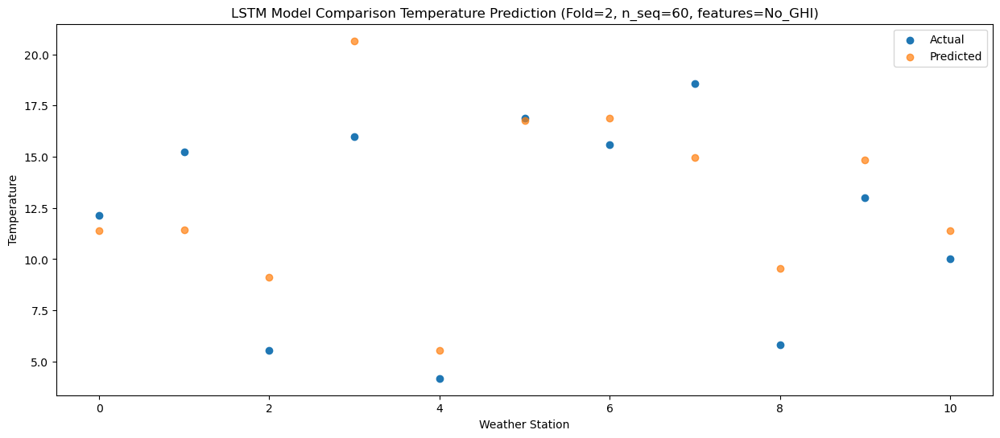

Predictions for (t+19):
    Weather_Station  Actual  Predicted
0                 0   17.37  18.583021
1                 1   22.49  18.621096
2                 2    6.78  16.263771
3                 3   21.55  27.840905
4                 4    7.66  12.696397
5                 5   21.45  23.943918
6                 6   21.17  24.041574
7                 7   23.55  22.139937
8                 8   10.04  16.727722
9                 9   17.30  22.018072
10               10   15.41  18.566230


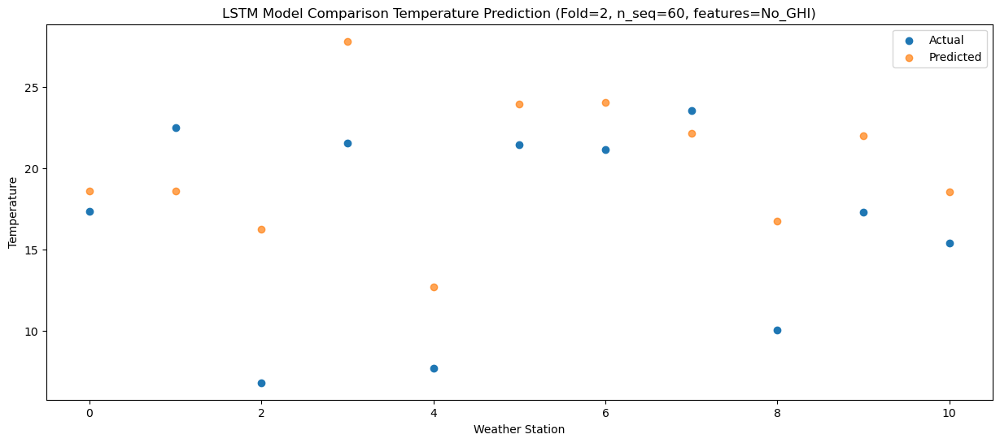

Predictions for (t+20):
    Weather_Station  Actual  Predicted
0                 0   18.38  18.885498
1                 1   23.18  18.919828
2                 2    7.57  16.558587
3                 3   23.55  28.130108
4                 4    8.25  12.987144
5                 5   21.53  24.228880
6                 6   22.06  24.325700
7                 7   22.35  22.421080
8                 8   13.02  17.006324
9                 9   18.87  22.303711
10               10   16.72  18.854979


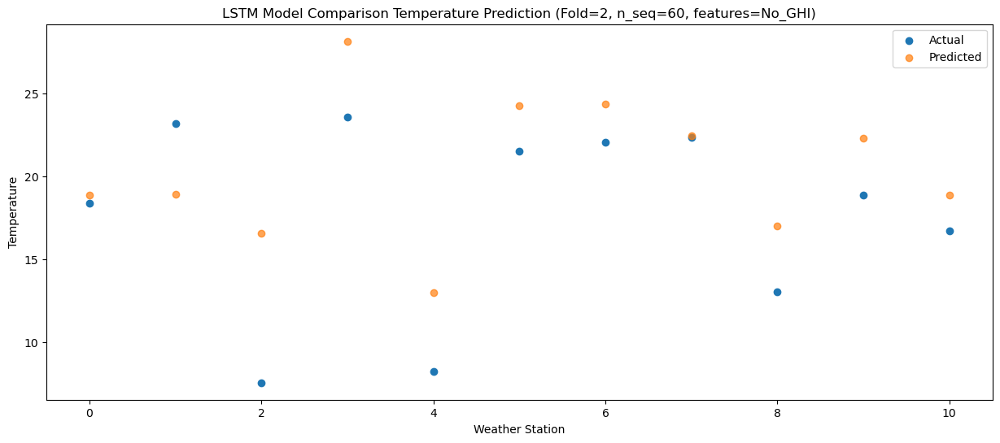

Predictions for (t+21):
    Weather_Station  Actual  Predicted
0                 0   18.83  19.611261
1                 1   23.94  19.641032
2                 2    7.62  17.274016
3                 3   24.61  28.842750
4                 4    8.42  13.698120
5                 5   22.64  24.943936
6                 6   22.62  25.043062
7                 7   21.83  23.129421
8                 8   12.62  17.710529
9                 9   18.96  23.011218
10               10   16.80  19.571204


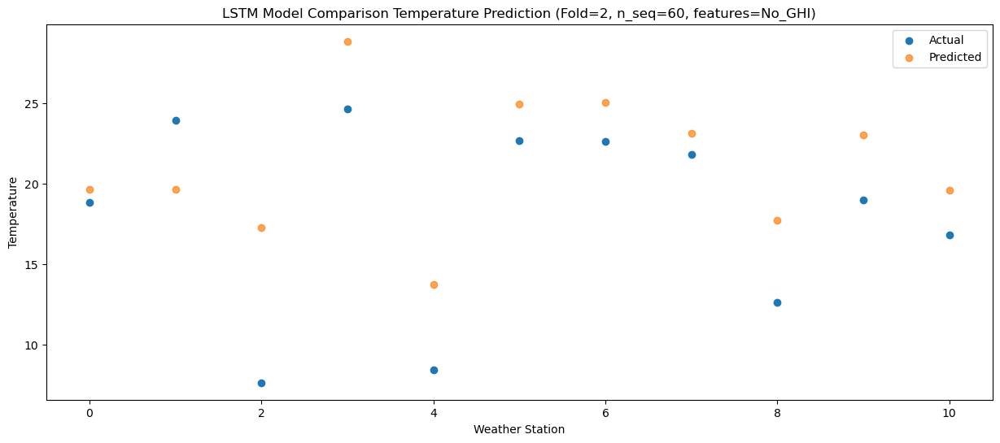

Predictions for (t+22):
    Weather_Station  Actual  Predicted
0                 0   15.53  14.889251
1                 1   21.70  14.927024
2                 2    6.34  12.570747
3                 3   21.44  24.138669
4                 4    5.88   8.994790
5                 5   19.90  20.233821
6                 6   20.35  20.330766
7                 7   19.65  18.424679
8                 8   10.84  13.004240
9                 9   14.85  18.304600
10               10   12.31  14.864892


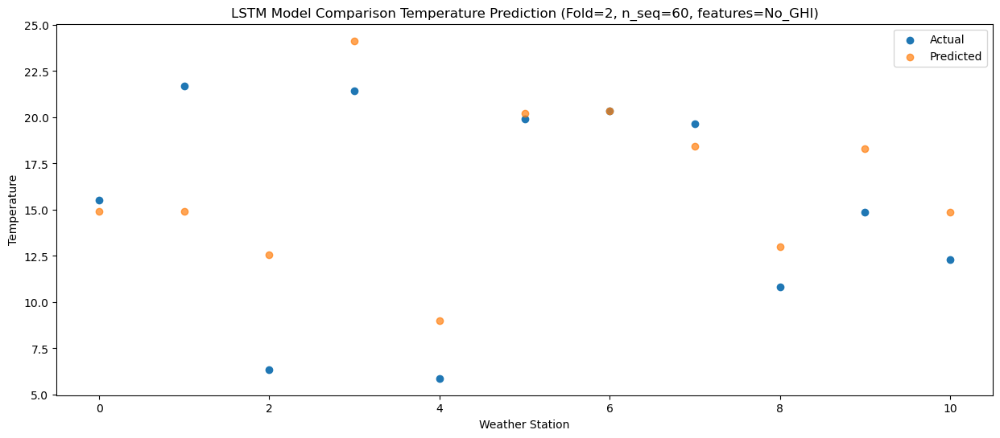

Predictions for (t+23):
    Weather_Station  Actual  Predicted
0                 0   10.78  10.776559
1                 1   13.44  10.809290
2                 2    5.20   8.465311
3                 3   17.61  20.028387
4                 4    3.14   4.892257
5                 5   16.60  16.132438
6                 6   15.84  16.227649
7                 7   13.09  14.320605
8                 8    5.86   8.901984
9                 9   11.57  14.207907
10               10    8.55  10.768991


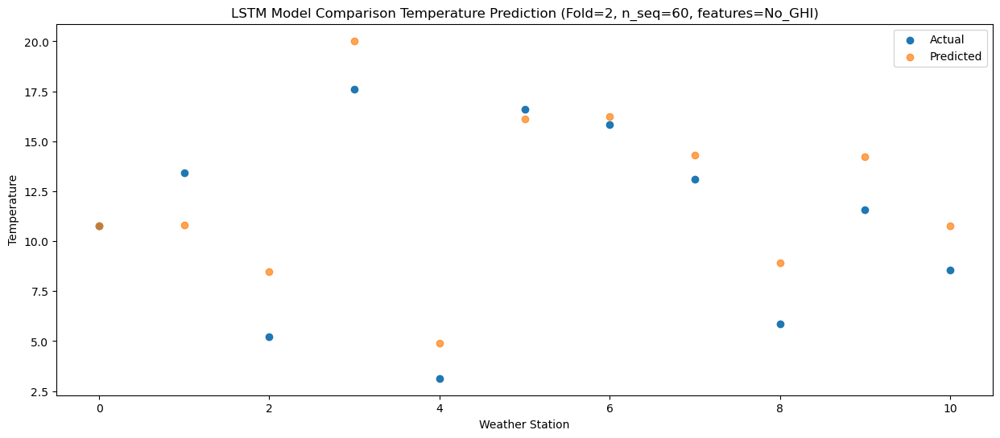

Predictions for (t+24):
    Weather_Station  Actual  Predicted
0                 0    1.16   1.993483
1                 1    6.73   2.026432
2                 2   -1.65  -0.319367
3                 3    9.53  11.248079
4                 4   -5.13  -3.891420
5                 5    8.96   7.344612
6                 6    7.87   7.442604
7                 7    7.69   5.539395
8                 8    4.60   0.124778
9                 9    2.66   5.426967
10               10   -1.67   1.984939


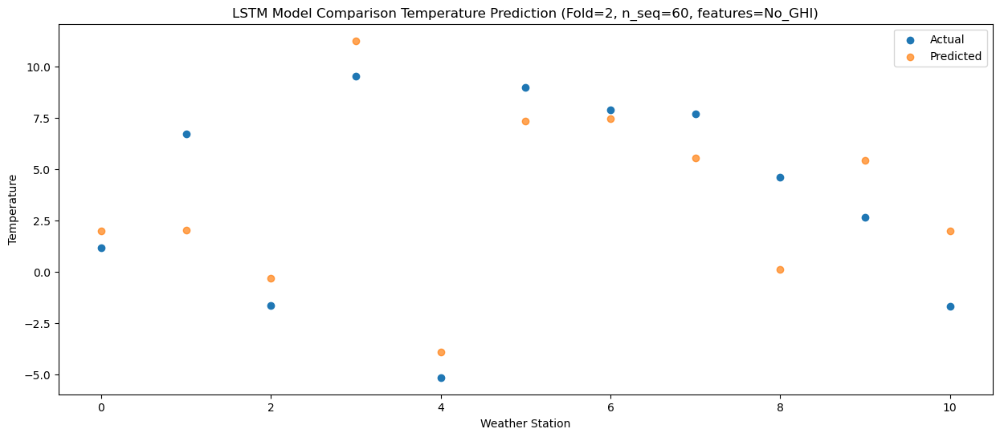

Predictions for (t+25):
    Weather_Station  Actual  Predicted
0                 0    4.25  -0.586409
1                 1    4.34  -0.557823
2                 2   -0.75  -2.900476
3                 3    7.61   8.669393
4                 4   -1.72  -6.469801
5                 5   12.20   4.767951
6                 6   10.16   4.865064
7                 7    4.34   2.958009
8                 8   -1.91  -2.453671
9                 9    4.58   2.849434
10               10    0.43  -0.593839


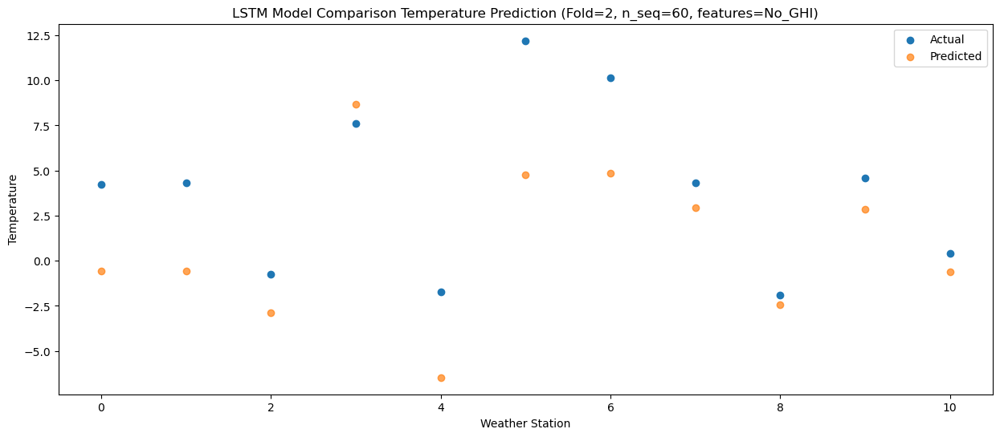

Predictions for (t+26):
    Weather_Station  Actual  Predicted
0                 0   -5.05  -8.064088
1                 1   -0.35  -8.032277
2                 2   -5.01 -10.376288
3                 3    1.46   1.193310
4                 4   -9.45 -13.947014
5                 5    3.77  -2.706751
6                 6    1.68  -2.612618
7                 7    1.34  -4.518387
8                 8    0.50  -9.925930
9                 9   -1.90  -4.626964
10               10   -6.44  -8.070405


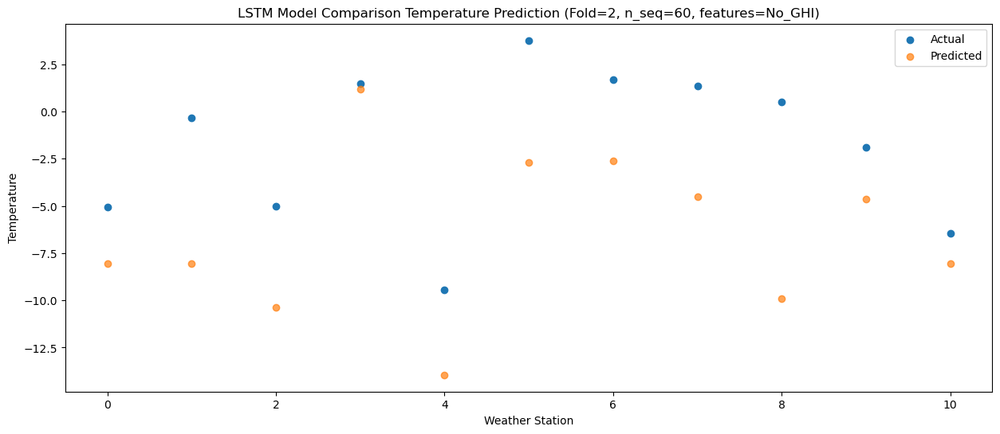

Predictions for (t+27):
    Weather_Station  Actual  Predicted
0                 0   -2.81  -5.351066
1                 1   -0.36  -5.327395
2                 2   -2.68  -7.677685
3                 3    3.78   3.899059
4                 4   -6.31 -11.247075
5                 5    3.39  -0.009182
6                 6    1.51   0.086754
7                 7    2.31  -1.823989
8                 8    1.37  -7.236727
9                 9    2.12  -1.932815
10               10   -1.85  -5.371778


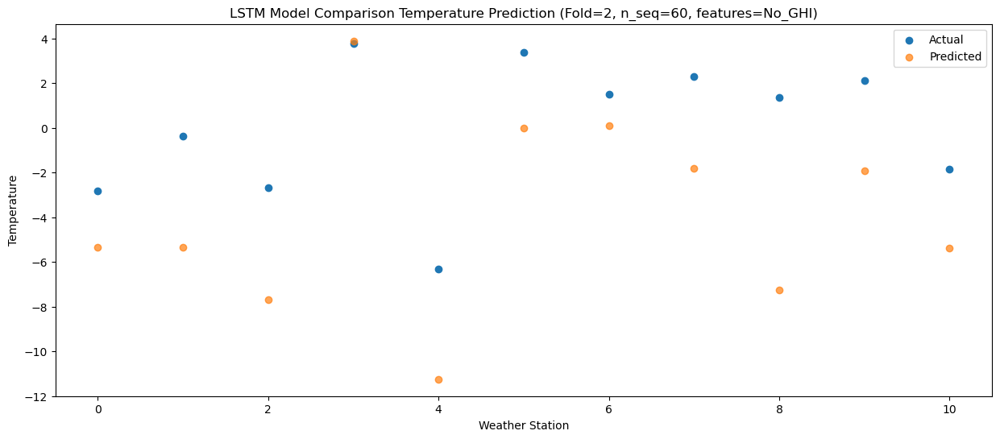

Predictions for (t+28):
    Weather_Station  Actual  Predicted
0                 0    3.48  -0.034922
1                 1    6.62  -0.014099
2                 2    0.79  -2.366539
3                 3    7.64   9.201948
4                 4   -2.55  -5.940295
5                 5    9.51   5.302419
6                 6    8.09   5.396474
7                 7    7.37   3.480829
8                 8    3.16  -1.935246
9                 9    6.23   3.366379
10               10    2.70  -0.068995


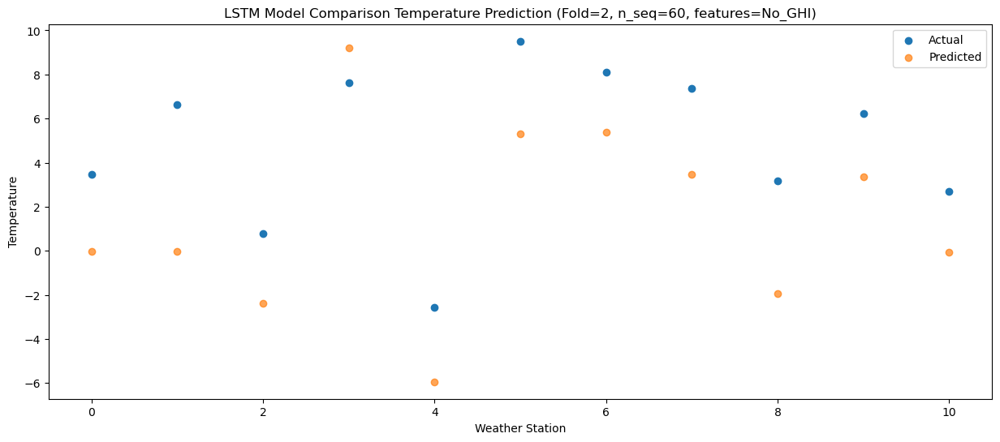

Predictions for (t+29):
    Weather_Station  Actual  Predicted
0                 0    7.51   4.803940
1                 1   13.30   4.825821
2                 2    2.60   2.484429
3                 3   12.08  14.048337
4                 4    1.25  -1.091165
5                 5   15.66  10.149004
6                 6   14.36  10.240547
7                 7   14.56   8.330125
8                 8    5.28   2.915028
9                 9    9.52   8.209306
10               10    5.86   4.773575


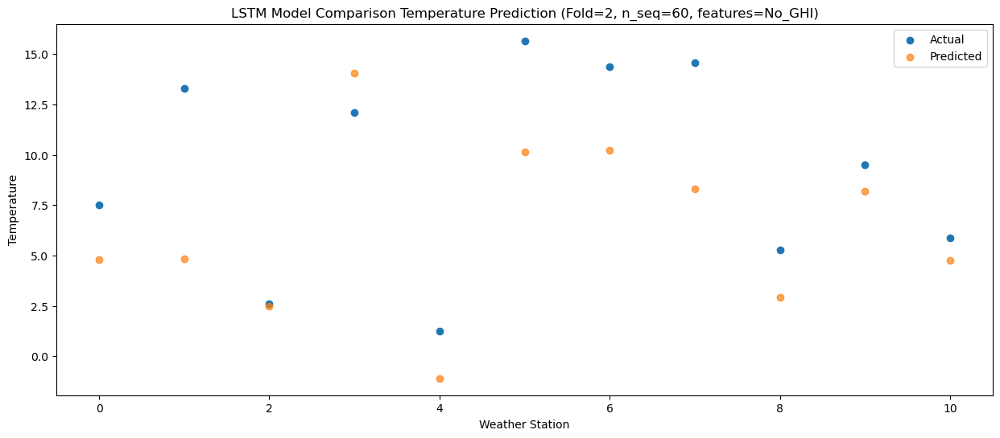

Predictions for (t+30):
    Weather_Station  Actual  Predicted
0                 0   14.06  13.021180
1                 1   19.10  13.041575
2                 2    5.36  10.691158
3                 3   17.42  22.259221
4                 4    6.41   7.120572
5                 5   20.26  18.359590
6                 6   19.38  18.447623
7                 7   19.26  16.535938
8                 8    6.24  11.118956
9                 9   14.37  16.408588
10               10   12.10  12.974664


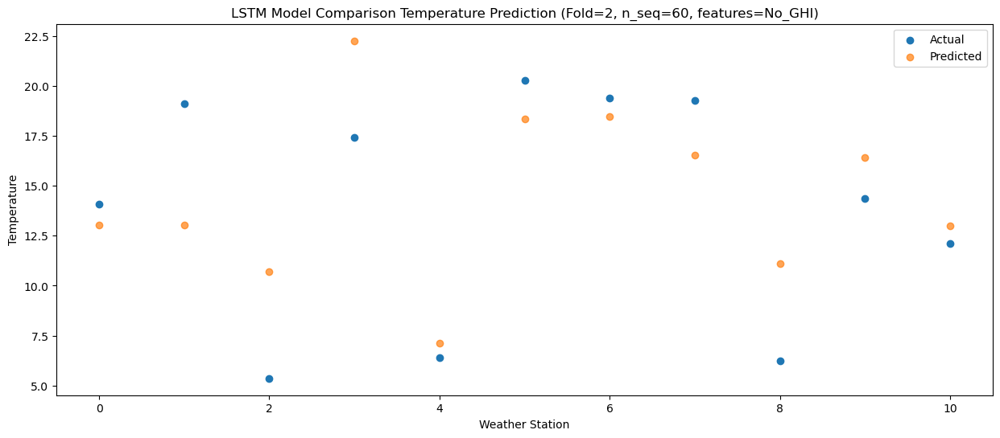

Predictions for (t+31):
    Weather_Station  Actual  Predicted
0                 0   18.11  16.856738
1                 1   22.90  16.877745
2                 2    7.17  14.523134
3                 3   21.66  26.095263
4                 4    9.00  10.959061
5                 5   23.98  22.203569
6                 6   24.09  22.293335
7                 7   23.12  20.382527
8                 8   11.16  14.961514
9                 9   18.13  20.250089
10               10   15.75  16.814599


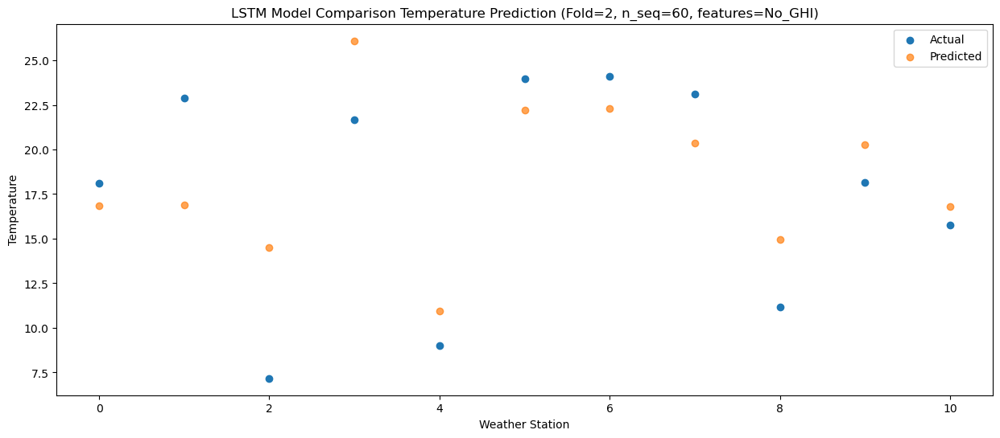

Predictions for (t+32):
    Weather_Station  Actual  Predicted
0                 0   20.61  19.501947
1                 1   26.14  19.521322
2                 2    7.35  17.170973
3                 3   26.28  28.745878
4                 4    8.83  13.608582
5                 5   25.34  24.855374
6                 6   26.88  24.944894
7                 7   24.26  23.041729
8                 8   11.97  17.616235
9                 9   19.57  22.904317
10               10   17.10  19.471309


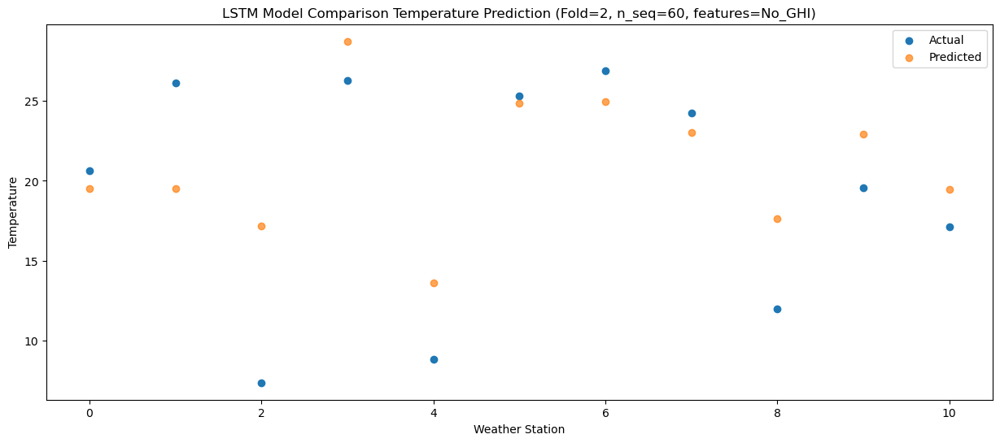

Predictions for (t+33):
    Weather_Station  Actual  Predicted
0                 0   18.06  18.755814
1                 1   23.83  18.773346
2                 2    6.78  16.433760
3                 3   26.20  28.011126
4                 4    8.01  12.868357
5                 5   22.62  24.117113
6                 6   24.07  24.209092
7                 7   21.24  22.303743
8                 8   14.01  16.884677
9                 9   18.19  22.173483
10               10   15.85  18.735886


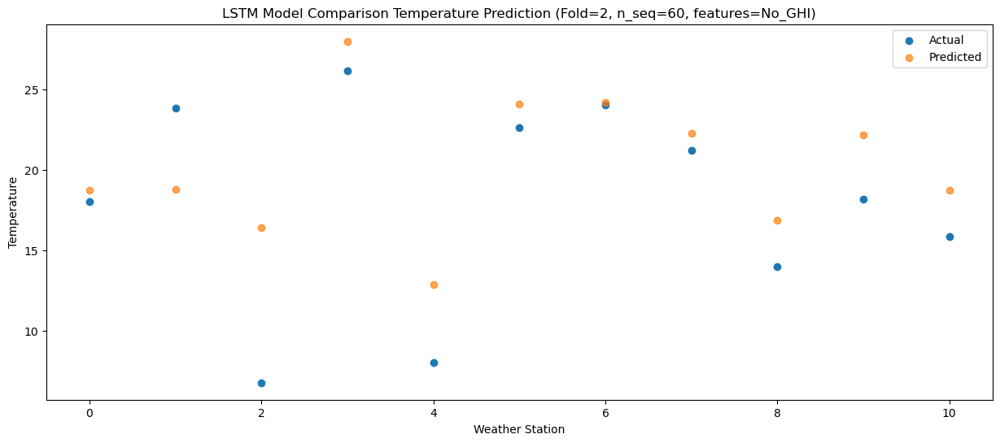

Predictions for (t+34):
    Weather_Station  Actual  Predicted
0                 0   16.31  14.737105
1                 1   21.07  14.754846
2                 2    5.37  12.420969
3                 3   21.16  23.997942
4                 4    6.04   8.854228
5                 5   19.96  20.102767
6                 6   20.24  20.190540
7                 7   19.51  18.290588
8                 8   13.60  12.871911
9                 9   14.88  18.157736
10               10   11.70  14.716849


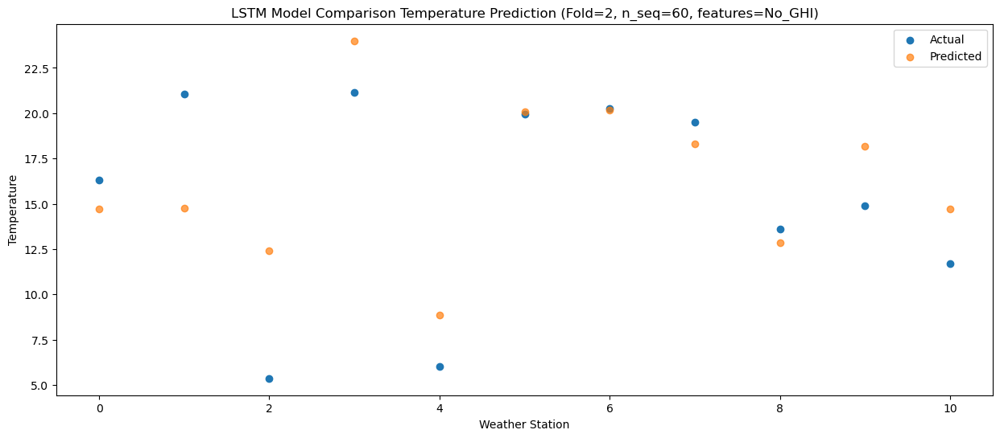

Predictions for (t+35):
    Weather_Station  Actual  Predicted
0                 0    7.97   7.657968
1                 1   12.69   7.669514
2                 2    2.74   5.347718
3                 3   15.72  16.925036
4                 4   -0.15   1.784353
5                 5   14.39  13.029109
6                 6   13.86  13.116422
7                 7   11.30  11.212896
8                 8    7.33   5.793543
9                 9    7.57  11.082154
10               10    4.42   7.641742


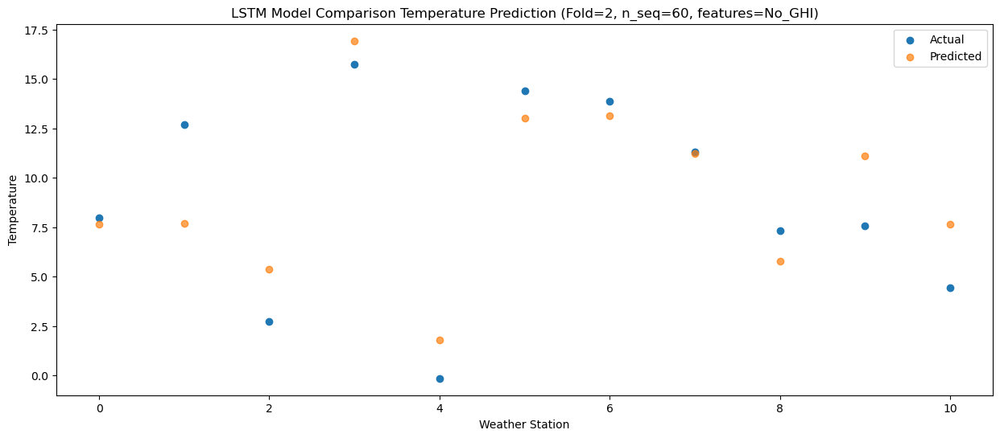

Predictions for (t+36):
    Weather_Station  Actual  Predicted
0                 0    1.84   2.780865
1                 1    2.70   2.778904
2                 2    0.98   0.451834
3                 3   11.92  12.031963
4                 4   -3.22  -3.110301
5                 5    8.51   8.130874
6                 6    7.19   8.217304
7                 7    4.41   6.308569
8                 8    1.10   0.886838
9                 9    5.45   6.181793
10               10    1.97   2.747972


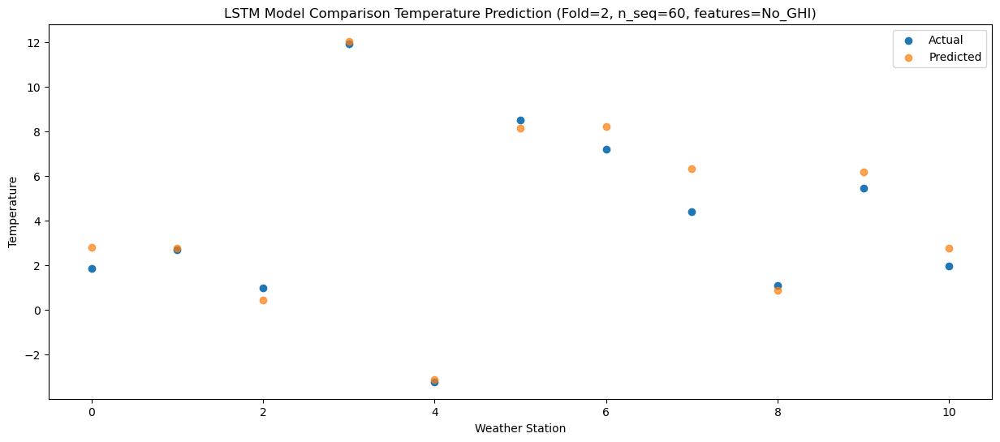

Predictions for (t+37):
    Weather_Station  Actual  Predicted
0                 0   -1.67  -2.680576
1                 1   -0.01  -2.686197
2                 2   -3.12  -5.009186
3                 3    5.75   6.570711
4                 4   -5.73  -8.571242
5                 5    6.28   2.669614
6                 6    4.57   2.757638
7                 7    2.24   0.852875
8                 8   -1.60  -4.567998
9                 9   -1.08   0.721594
10               10   -3.49  -2.713279


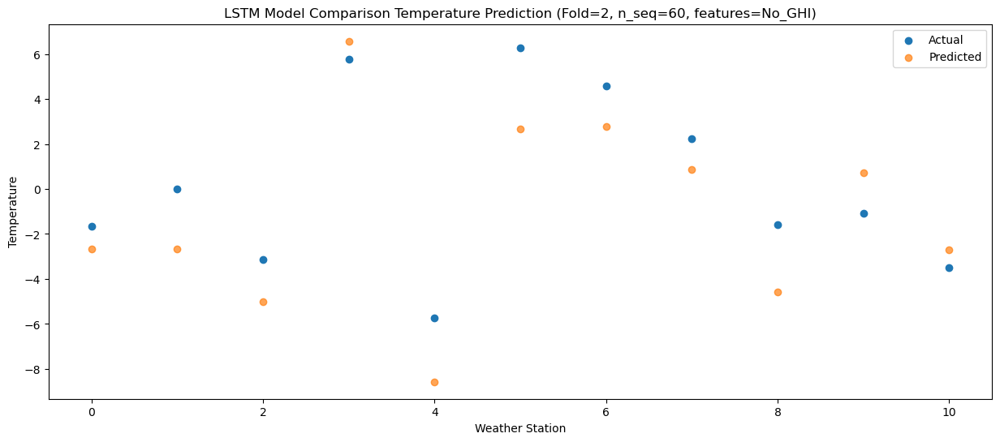

Predictions for (t+38):
    Weather_Station  Actual  Predicted
0                 0    0.35  -2.464371
1                 1   -0.26  -2.469293
2                 2   -3.32  -4.784794
3                 3    7.04   6.797622
4                 4   -4.56  -8.347609
5                 5    7.04   2.891671
6                 6    5.45   2.975266
7                 7    1.53   1.066910
8                 8   -1.94  -4.353213
9                 9    2.12   0.937840
10               10   -1.57  -2.496138


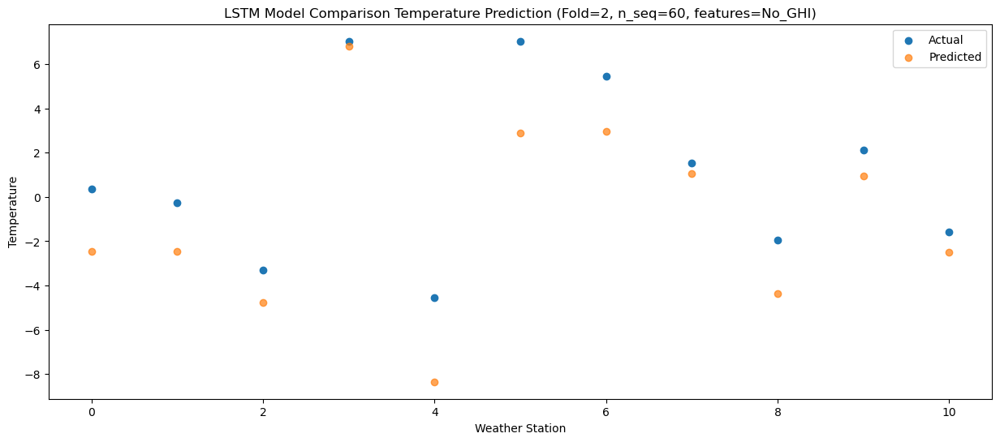

Predictions for (t+39):
    Weather_Station  Actual  Predicted
0                 0    1.37  -3.385007
1                 1    1.34  -3.390741
2                 2   -0.26  -5.710521
3                 3    5.16   5.873723
4                 4   -2.43  -9.272778
5                 5    8.23   1.966097
6                 6    5.64   2.050795
7                 7    2.74   0.144242
8                 8   -2.26  -5.277820
9                 9    5.14   0.013502
10               10    1.22  -3.419020


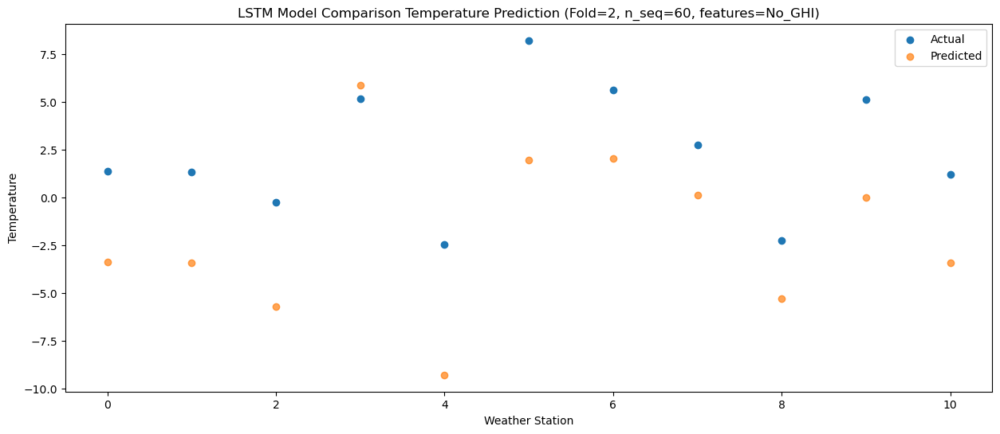

Predictions for (t+40):
    Weather_Station  Actual  Predicted
0                 0    3.64  -0.659420
1                 1    5.41  -0.659829
2                 2    0.76  -2.980074
3                 3    7.60   8.603988
4                 4   -0.60  -6.541995
5                 5   12.03   4.696894
6                 6   10.29   4.783437
7                 7    7.44   2.885177
8                 8   -1.25  -2.536367
9                 9    5.59   2.748266
10               10    1.75  -0.689327


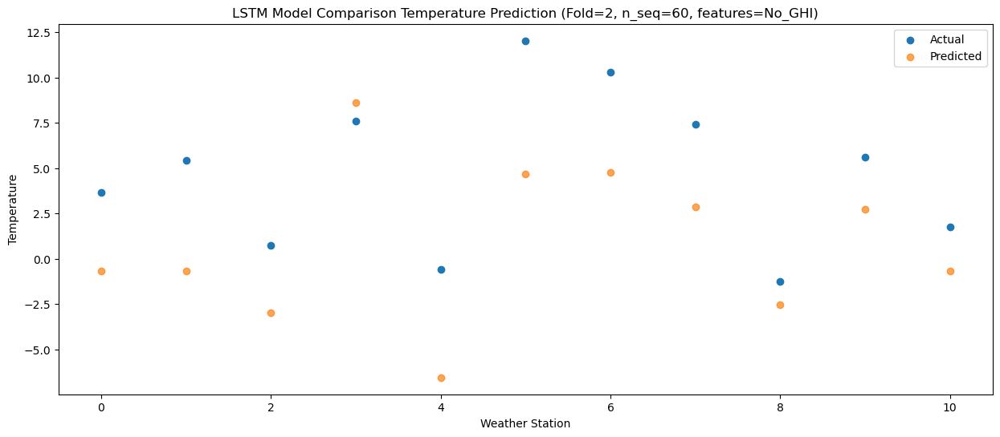

Predictions for (t+41):
    Weather_Station  Actual  Predicted
0                 0    7.79   6.195479
1                 1   11.27   6.197628
2                 2    3.30   3.874525
3                 3   13.32  15.466820
4                 4    1.32   0.315374
5                 5   12.95  11.550572
6                 6   12.11  11.634824
7                 7   13.08   9.733326
8                 8    2.59   4.312078
9                 9    9.11   9.600926
10               10    6.64   6.168001


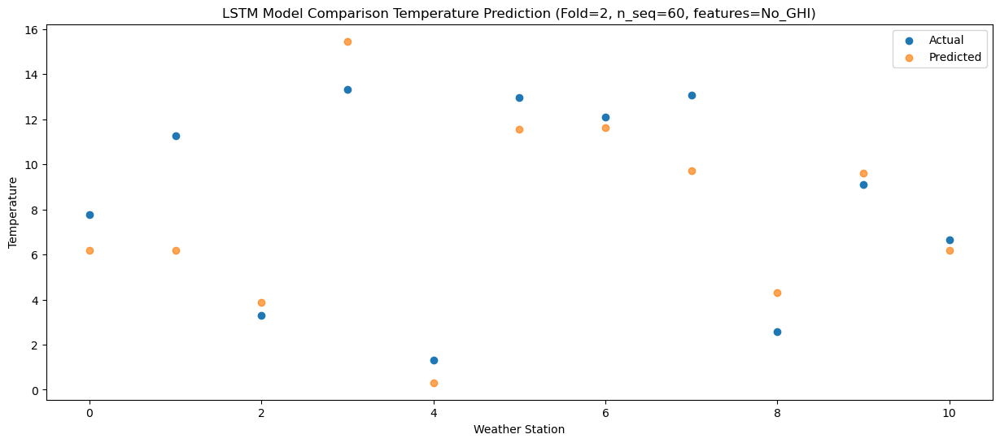

Predictions for (t+42):
    Weather_Station  Actual  Predicted
0                 0   13.84  11.001466
1                 1   16.76  11.001963
2                 2    4.28   8.677402
3                 3   16.95  20.266118
4                 4    5.35   5.116882
5                 5   18.03  16.349701
6                 6   17.85  16.431320
7                 7   17.73  14.527610
8                 8    3.80   9.100826
9                 9   11.89  14.393210
10               10    9.99  10.963238


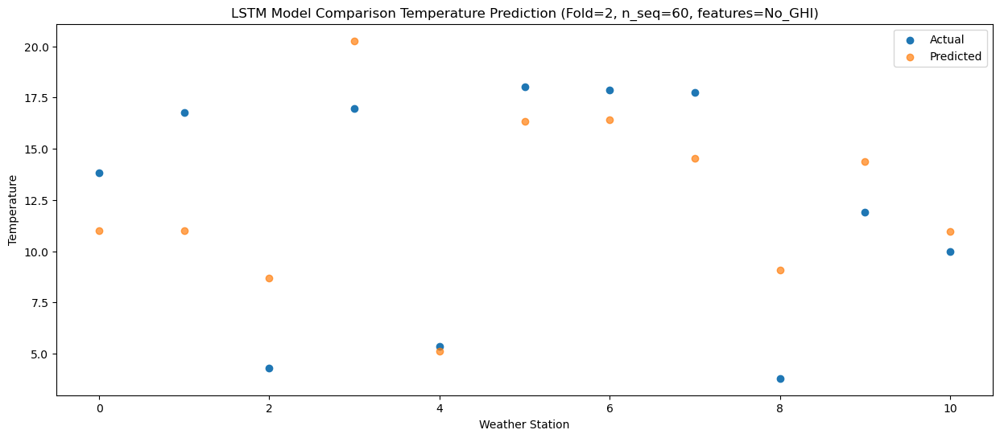

Predictions for (t+43):
    Weather_Station  Actual  Predicted
0                 0   16.47  16.097445
1                 1   19.37  16.094867
2                 2    6.69  13.782066
3                 3   20.74  25.371095
4                 4    9.00  10.225805
5                 5   22.95  21.456845
6                 6   22.00  21.539072
7                 7   22.39  19.628967
8                 8    5.76  14.200717
9                 9   15.55  19.498827
10               10   12.90  16.068773


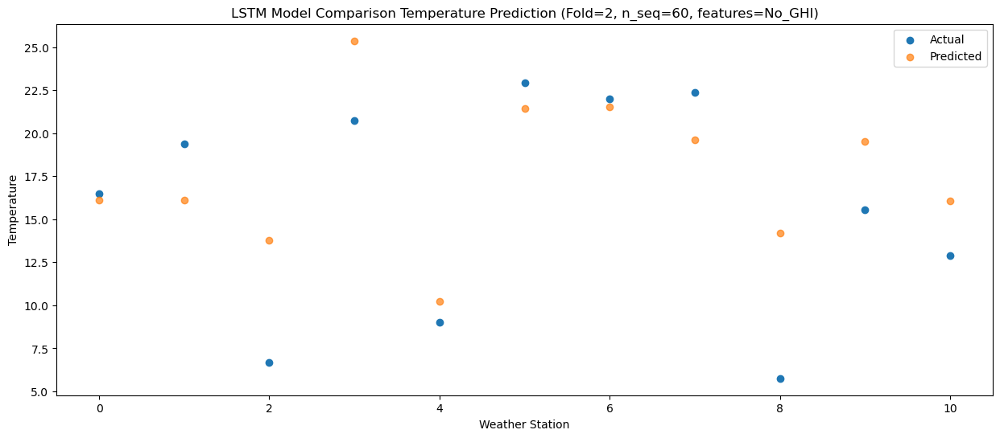

Predictions for (t+44):
    Weather_Station  Actual  Predicted
0                 0   18.22  19.471569
1                 1   23.47  19.464047
2                 2    8.60  17.159745
3                 3   26.31  28.747607
4                 4   10.44  13.605560
5                 5   25.11  24.831728
6                 6   24.56  24.909745
7                 7   27.14  22.999956
8                 8   12.68  17.565392
9                 9   19.14  22.872186
10               10   16.45  19.447141


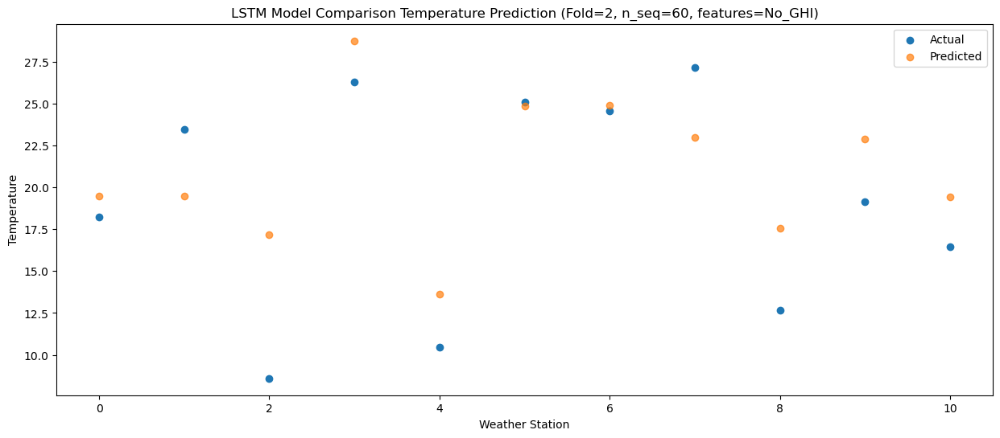

Predictions for (t+45):
    Weather_Station  Actual  Predicted
0                 0   17.73  17.813099
1                 1   23.96  17.814656
2                 2    8.78  15.511220
3                 3   24.30  27.098993
4                 4   11.74  11.957971
5                 5   26.81  23.186059
6                 6   26.90  23.264259
7                 7   24.14  21.356836
8                 8   12.31  15.921546
9                 9   18.59  21.223564
10               10   15.74  17.797101


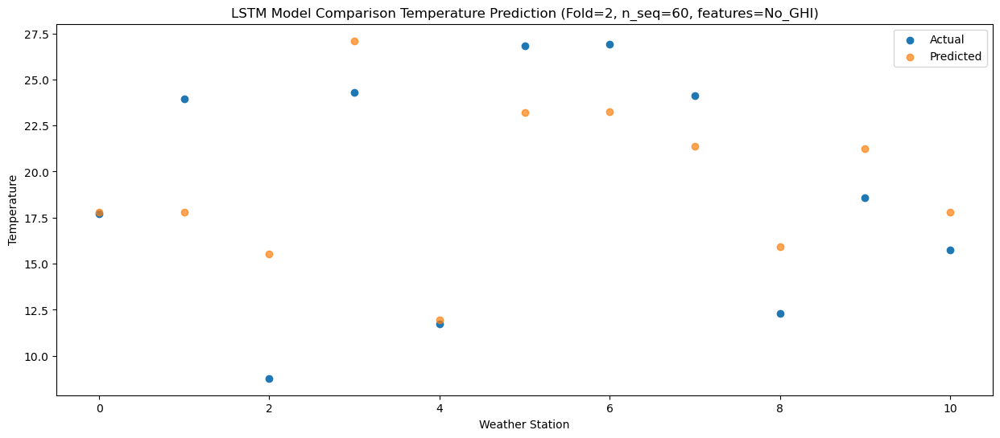

Predictions for (t+46):
    Weather_Station  Actual  Predicted
0                 0   14.44  15.447280
1                 1   21.09  15.448097
2                 2    6.83  13.152492
3                 3   21.88  24.739567
4                 4    7.31   9.600459
5                 5   22.33  20.825528
6                 6   22.12  20.903925
7                 7   21.48  18.997727
8                 8    8.81  13.562708
9                 9   14.63  18.869855
10               10   12.96  15.446234


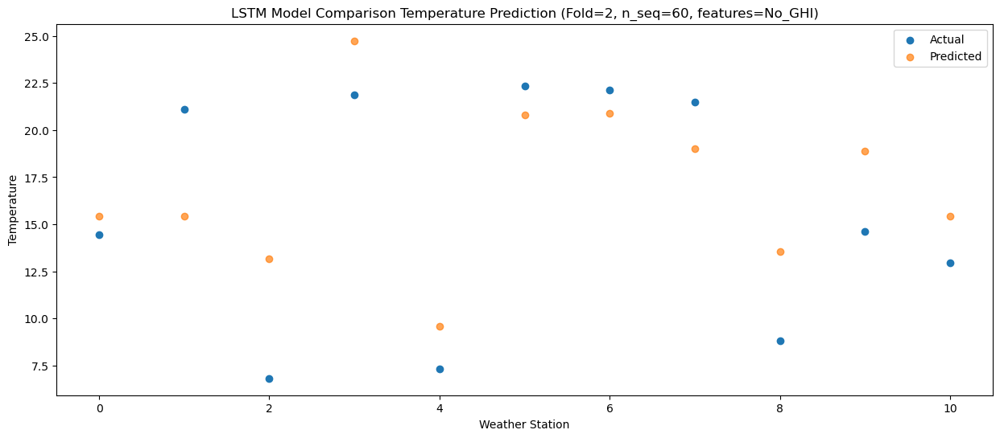

Predictions for (t+47):
    Weather_Station  Actual  Predicted
0                 0    9.28   9.652017
1                 1   12.05   9.644154
2                 2    3.25   7.346786
3                 3   16.86  18.940205
4                 4    1.15   3.800910
5                 5   14.44  15.024804
6                 6   13.40  15.104100
7                 7   14.74  13.196233
8                 8    7.22   7.761513
9                 9    9.34  13.066516
10               10    6.91   9.646288


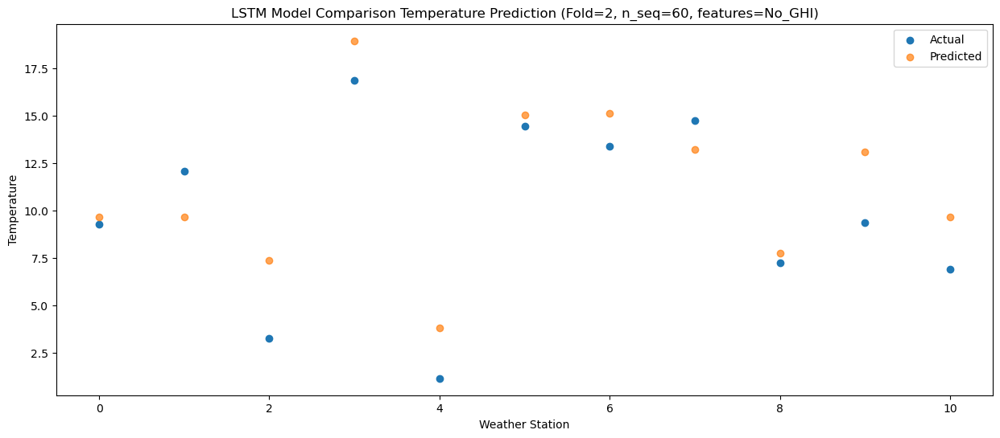

Predictions for (t+48):
    Weather_Station  Actual  Predicted
0                 0    2.17   1.799753
1                 1    5.33   1.790221
2                 2   -0.73  -0.504997
3                 3    8.88  11.091655
4                 4   -3.96  -4.052333
5                 5    8.16   7.174685
6                 6    8.06   7.255793
7                 7    7.63   5.345612
8                 8    2.83  -0.096842
9                 9    3.44   5.211451
10               10    0.70   1.789780


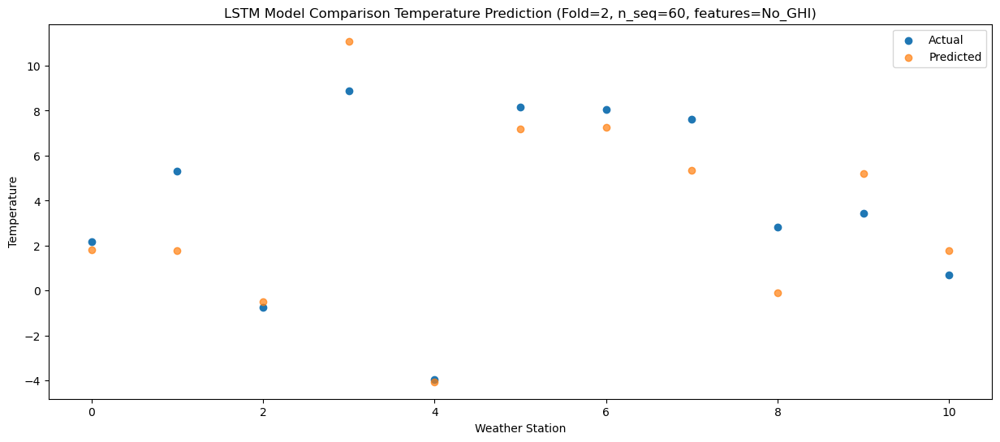

Predictions for (t+49):
    Weather_Station  Actual  Predicted
0                 0   -0.89   0.422417
1                 1    1.66   0.406126
2                 2   -2.66  -1.874931
3                 3    8.14   9.722269
4                 4   -6.56  -5.419952
5                 5    6.05   5.808143
6                 6    5.08   5.890005
7                 7    2.59   3.969028
8                 8    0.50  -1.477326
9                 9    0.97   3.845003
10               10   -2.15   0.425905


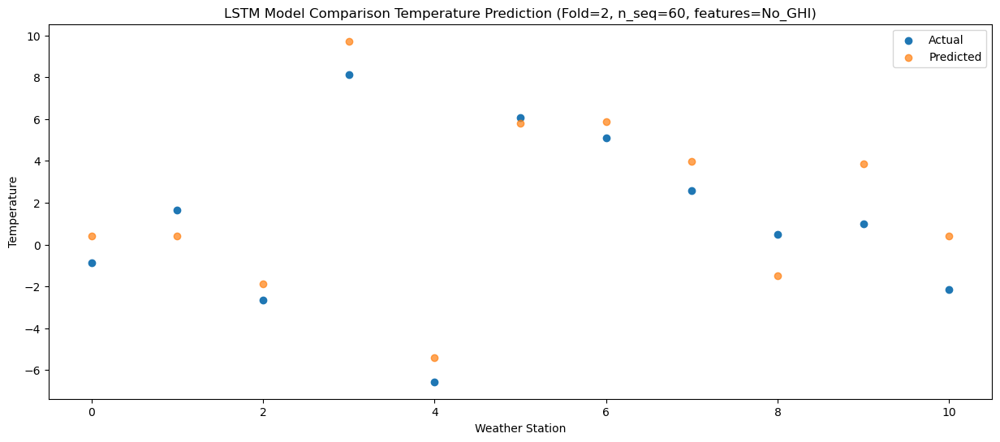

Predictions for (t+50):
    Weather_Station  Actual  Predicted
0                 0   -6.68  -4.094573
1                 1   -3.43  -4.105104
2                 2   -4.66  -6.377638
3                 3    3.97   5.209913
4                 4   -8.64  -9.923818
5                 5    1.90   1.305277
6                 6   -0.10   1.381966
7                 7    2.26  -0.535225
8                 8   -1.30  -5.978909
9                 9   -0.88  -0.662951
10               10   -5.47  -4.084026


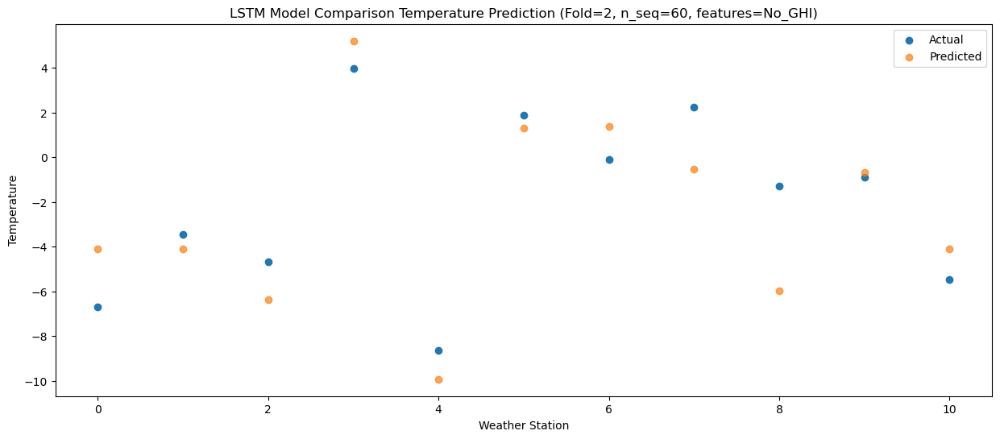

Predictions for (t+51):
    Weather_Station  Actual  Predicted
0                 0    1.64  -1.190660
1                 1    4.05  -1.202576
2                 2   -4.18  -3.479219
3                 3    4.65   8.104960
4                 4   -4.48  -7.027298
5                 5    8.66   4.206507
6                 6    8.16   4.286661
7                 7    5.47   2.361599
8                 8   -0.77  -3.088881
9                 9    2.34   2.230003
10               10   -0.93  -1.187653


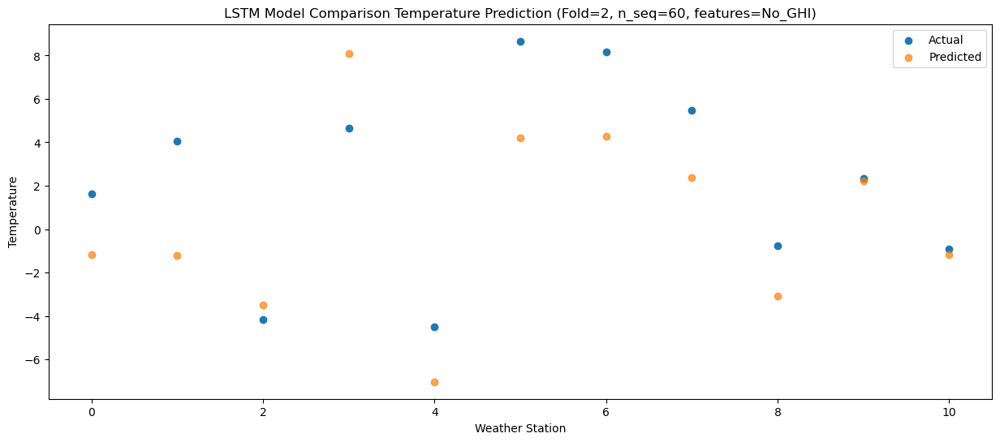

Predictions for (t+52):
    Weather_Station  Actual  Predicted
0                 0    4.53   1.687457
1                 1    6.82   1.668884
2                 2    0.24  -0.598194
3                 3    9.05  10.988742
4                 4   -1.81  -4.144228
5                 5   11.03   7.087204
6                 6   10.51   7.165493
7                 7    8.04   5.239565
8                 8    0.17  -0.210244
9                 9    5.90   5.105588
10               10    3.24   1.690119


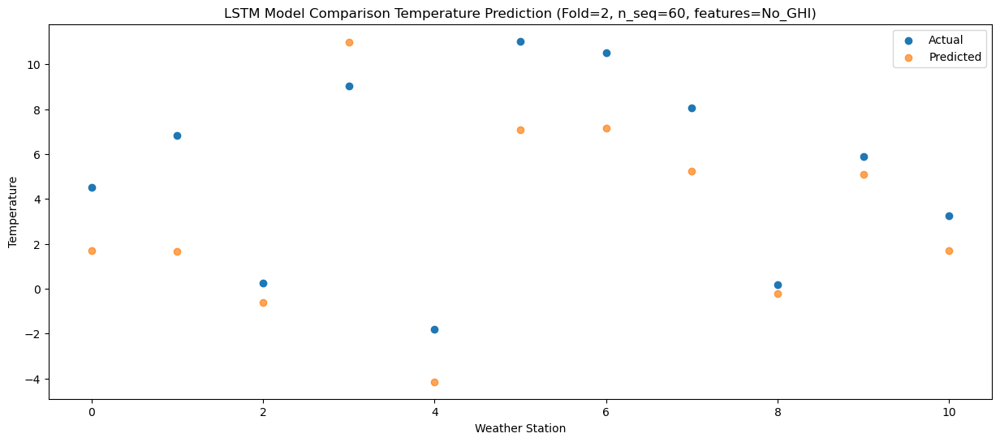

Predictions for (t+53):
    Weather_Station  Actual  Predicted
0                 0    9.29   6.554658
1                 1   12.23   6.529642
2                 2    1.63   4.261222
3                 3   11.48  15.853430
4                 4    1.85   0.714214
5                 5   14.77  11.945315
6                 6   13.96  12.024179
7                 7   12.45  10.100043
8                 8    2.28   4.653037
9                 9    9.96   9.970767
10               10    7.22   6.554521


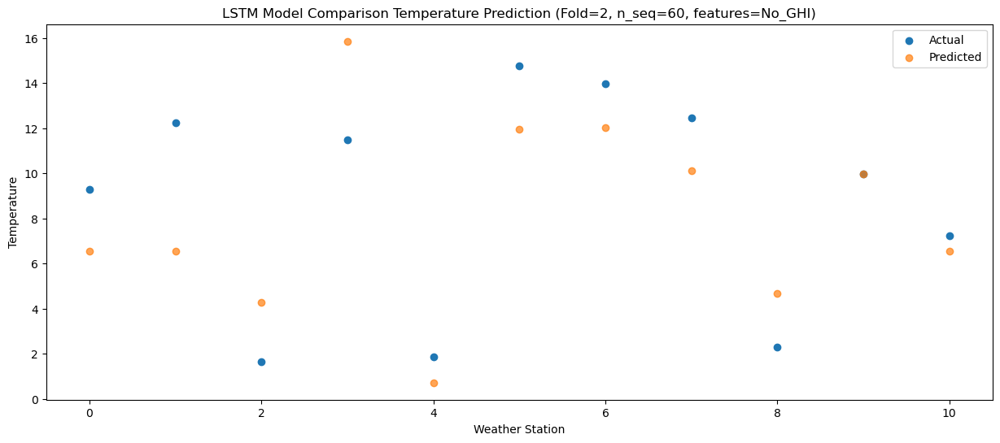

Predictions for (t+54):
    Weather_Station  Actual  Predicted
0                 0   14.22  12.834672
1                 1   16.84  12.800378
2                 2    6.48  10.535059
3                 3   17.27  22.125106
4                 4    6.90   6.988348
5                 5   18.47  18.215911
6                 6   18.85  18.291888
7                 7   18.27  16.362962
8                 8    4.08  10.910362
9                 9   14.34  16.235678
10               10   11.68  12.825750


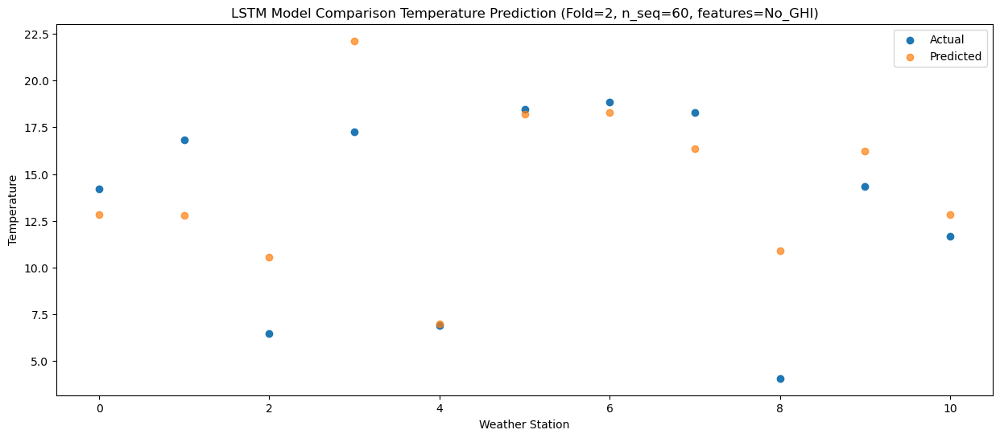

Predictions for (t+55):
    Weather_Station  Actual  Predicted
0                 0   17.30  17.802571
1                 1   23.01  17.762108
2                 2    7.39  15.502885
3                 3   23.24  27.091100
4                 4    8.73  11.955579
5                 5   21.70  23.182927
6                 6   22.35  23.257868
7                 7   24.69  21.322090
8                 8    8.76  15.872771
9                 9   18.22  21.200106
10               10   16.03  17.791591


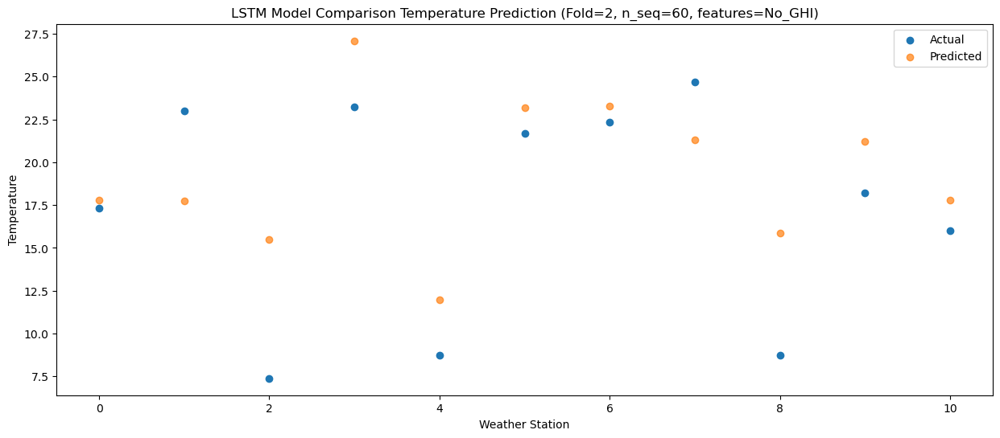

Predictions for (t+56):
    Weather_Station  Actual  Predicted
0                 0   17.79  19.831569
1                 1   23.56  19.797748
2                 2    8.23  17.531469
3                 3   26.02  29.124513
4                 4    9.34  13.983378
5                 5   20.18  25.208665
6                 6   22.66  25.284179
7                 7   24.16  23.354647
8                 8   12.49  17.901408
9                 9   19.61  23.226245
10               10   17.26  19.814029


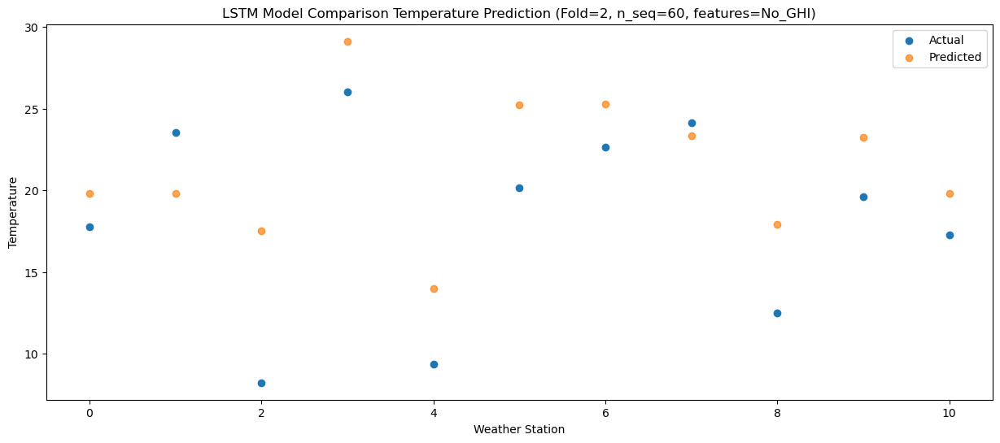

Predictions for (t+57):
    Weather_Station  Actual  Predicted
0                 0   18.02  18.417517
1                 1   23.61  18.381559
2                 2    8.19  16.124588
3                 3   24.31  27.711857
4                 4    9.69  12.581071
5                 5   21.83  23.809546
6                 6   24.46  23.883479
7                 7   24.55  21.948244
8                 8   12.07  16.491071
9                 9   17.59  21.822024
10               10   15.64  18.407099


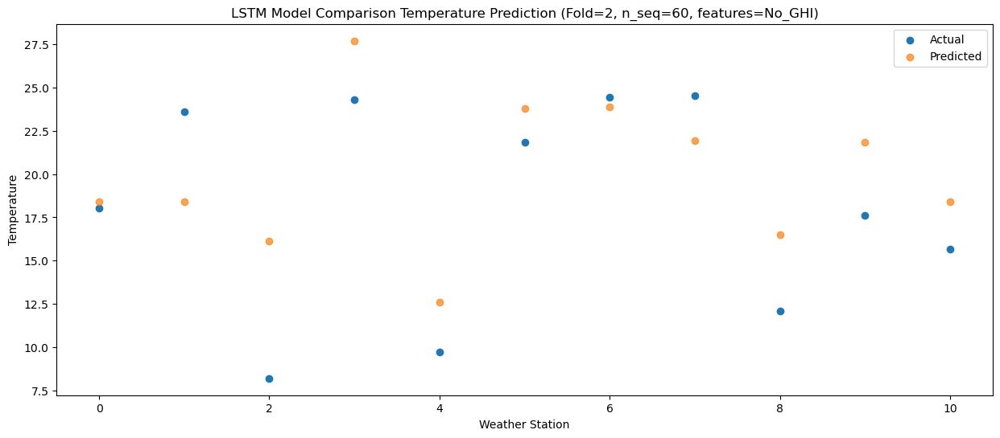

Predictions for (t+58):
    Weather_Station  Actual  Predicted
0                 0   14.04  15.474124
1                 1   19.88  15.437085
2                 2    7.87  13.191830
3                 3   20.79  24.775748
4                 4    6.89   9.649868
5                 5   19.10  20.879538
6                 6   20.23  20.949669
7                 7   20.52  19.014630
8                 8   10.22  13.554315
9                 9   14.63  18.885030
10               10   13.05  15.468638


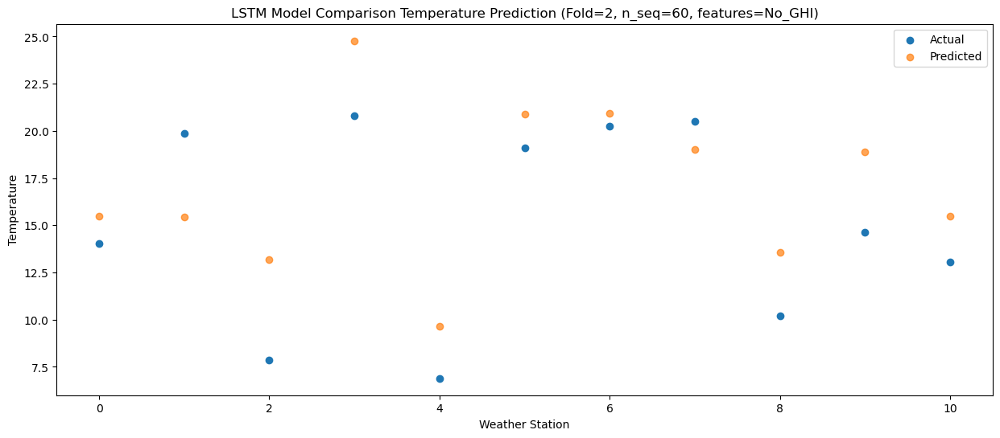

Predictions for (t+59):
    Weather_Station  Actual  Predicted
0                 0    9.77   9.882957
1                 1   14.91   9.844266
2                 2    4.40   7.593553
3                 3   15.53  19.177543
4                 4    2.20   4.054257
5                 5   16.45  15.293773
6                 6   17.26  15.362646
7                 7   16.26  13.426481
8                 8    7.23   7.968750
9                 9    9.41  13.292099
10               10    6.63   9.874072


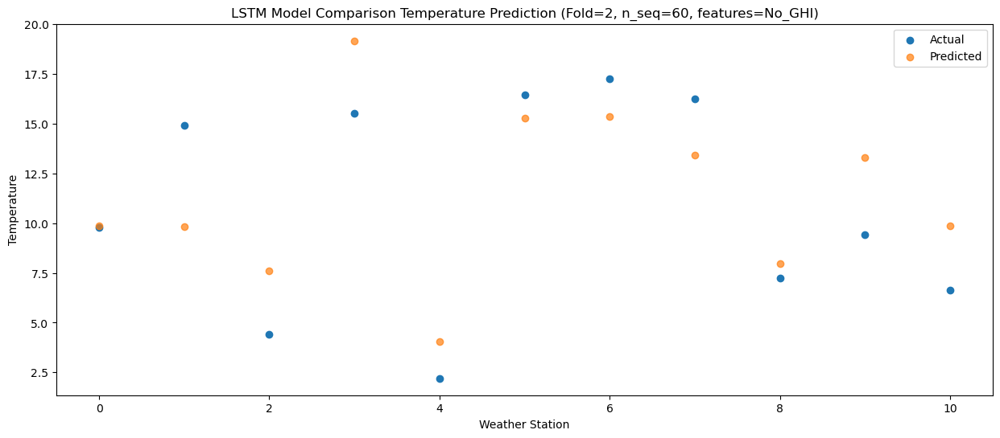

f, t:
[[-6.500e-01  3.410e+00 -1.000e-01  9.240e+00 -6.250e+00  7.270e+00
   6.650e+00  6.030e+00  2.170e+00  2.040e+00 -1.920e+00]
 [-3.100e-01  1.130e+00 -1.220e+00  6.180e+00 -5.900e+00  5.840e+00
   4.840e+00  1.500e+00 -1.370e+00  1.630e+00 -1.320e+00]
 [-9.000e-01  8.900e-01 -2.370e+00  6.450e+00 -5.560e+00  6.210e+00
   5.190e+00  2.750e+00 -8.300e-01  1.340e+00 -1.760e+00]
 [-1.090e+00  1.600e-01 -1.330e+00  6.600e+00 -4.920e+00  5.450e+00
   4.630e+00  3.560e+00  1.280e+00  2.380e+00 -1.960e+00]
 [ 5.500e+00  8.170e+00  2.290e+00  1.015e+01  1.770e+00  1.354e+01
   1.228e+01  8.060e+00  1.350e+00  7.610e+00  4.080e+00]
 [ 6.980e+00  1.040e+01  3.680e+00  1.138e+01  1.240e+00  1.351e+01
   1.259e+01  1.304e+01  4.560e+00  8.910e+00  4.510e+00]
 [ 1.227e+01  1.720e+01  4.990e+00  1.727e+01  4.210e+00  1.735e+01
   1.749e+01  1.933e+01  8.610e+00  1.151e+01  8.550e+00]
 [ 1.727e+01  2.440e+01  7.580e+00  2.333e+01  7.250e+00  2.096e+01
   2.223e+01  2.285e+01  9.900e+00  1.680e+0

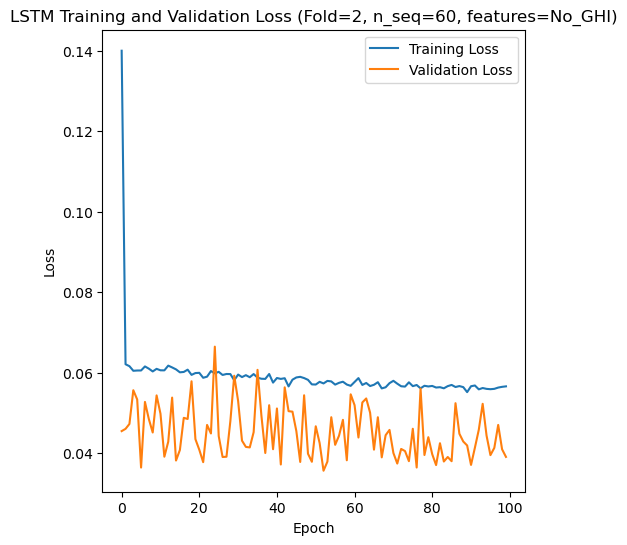

[[ 8.9   6.89 11.3  ... 22.19 16.88 13.54]
 [ 7.02  3.15 10.24 ... 22.31 18.92 11.32]
 [ 7.65  9.7   9.44 ... 25.68 20.65 11.46]
 ...
 [ 9.57 11.93 12.22 ... 30.9  25.01 12.37]
 [ 9.04  9.3   8.59 ... 17.72 17.26 10.73]
 [ 3.2   0.4   3.78 ... 18.92 14.39 10.04]]
Epoch 1/100
84/84 [==============================] - 31s 135ms/step - loss: 0.1600 - accuracy: 0.3690 - mae: 0.1305 - rmse: 0.1600 - mape: 29.2750 - pearson: 0.6542 - val_loss: 0.0712 - val_accuracy: 0.5000 - val_mae: 0.0558 - val_rmse: 0.0712 - val_mape: 12.0540 - val_pearson: 0.7919
Epoch 2/100
84/84 [==============================] - 6s 68ms/step - loss: 0.0609 - accuracy: 0.5238 - mae: 0.0483 - rmse: 0.0609 - mape: 11.3349 - pearson: 0.8492 - val_loss: 0.0843 - val_accuracy: 0.5000 - val_mae: 0.0667 - val_rmse: 0.0843 - val_mape: 15.2349 - val_pearson: 0.7240
Epoch 3/100
84/84 [==============================] - 6s 71ms/step - loss: 0.0602 - accuracy: 0.6071 - mae: 0.0476 - rmse: 0.0602 - mape: 11.1969 - pearson: 0.8524 - v

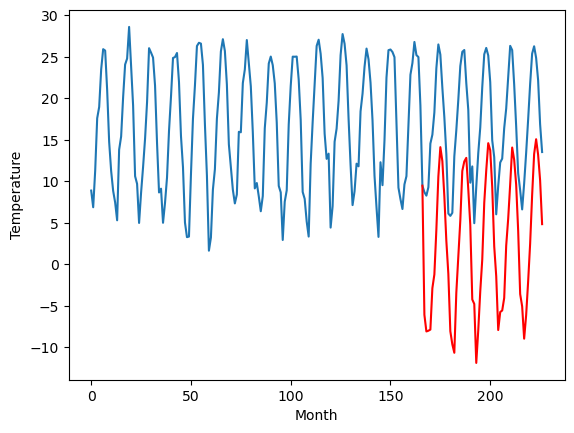

Weather Station 2:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
2.22		-0.36		-2.58
0.87		-2.37		-3.24
0.03		-2.28		-2.31
0.18		-2.14		-2.32
7.67		2.85		-4.82
8.59		4.50		-4.09
12.99		9.91		-3.08
20.09		16.31		-3.78
21.95		19.84		-2.11
20.09		18.16		-1.93
16.42		13.93		-2.49
9.31		8.56		-0.75
6.49		4.59		-1.90
-0.06		-2.32		-2.26
-1.21		-3.90		-2.69
-4.93		-4.92		0.01
7.04		2.32		-4.72
8.90		6.68		-2.22
13.12		11.03		-2.09
19.83		17.00		-2.83
21.14		18.14		-3.00
21.71		18.57		-3.14
18.98		14.78		-4.20
12.38		10.47		-1.91
4.67		1.49		-3.18
5.98		0.96		-5.02
-2.85		-6.14		-3.29
-1.63		-2.20		-0.57
5.15		2.48		-2.67
10.00		6.31		-3.69
15.43		13.15		-2.28
20.58		17.06		-3.52
24.62		20.35		-4.27
21.54		19.49		-2.05
17.68		15.04		-2.64
11.13		7.91		-3.22
3.90		4.31		0.41
-0.15		-2.16		-2.01
0.55		0.02		-0.53
2.51		0.20		-2.31
5.11		1.71		-3.40
10.16		8.00		-2.16
15.47		11.27		-4.20
19.80		15.41		-4.39
22.06		19.84		-2.22
22.24		18.35		-3.89
18.19		15.35		-2.84
1

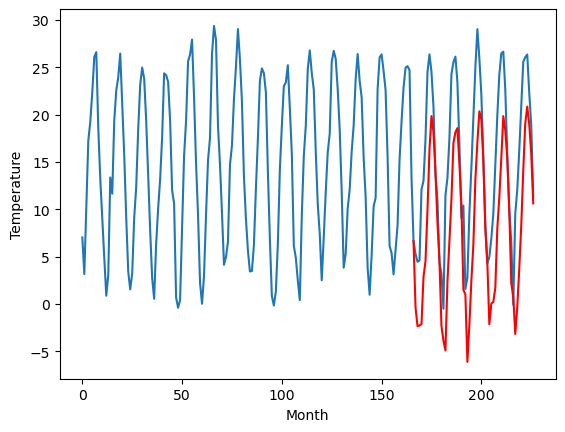

Weather Station 3:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
2.71		-2.24		-4.95
0.18		-4.24		-4.42
-1.04		-4.17		-3.13
1.38		-4.02		-5.40
3.17		0.97		-2.20
7.83		2.62		-5.21
13.02		8.02		-5.00
16.37		14.42		-1.95
19.15		17.96		-1.19
19.68		16.29		-3.39
15.35		12.05		-3.30
9.86		6.69		-3.17
1.21		2.72		1.51
-1.99		-4.19		-2.20
-0.73		-5.78		-5.05
1.57		-6.80		-8.37
2.72		0.43		-2.29
8.45		4.79		-3.66
13.25		9.12		-4.13
18.10		15.10		-3.00
21.23		16.25		-4.98
19.03		16.68		-2.35
15.72		12.90		-2.82
7.06		8.59		1.53
2.72		-0.38		-3.10
-1.20		-0.91		0.29
-1.53		-8.01		-6.48
0.17		-4.07		-4.24
4.88		0.62		-4.26
7.95		4.44		-3.51
12.19		11.29		-0.90
17.58		15.19		-2.39
20.15		18.49		-1.66
20.33		17.63		-2.70
17.51		13.19		-4.32
10.33		6.06		-4.27
-0.40		2.46		2.86
-1.36		-4.02		-2.66
0.03		-1.84		-1.87
-0.82		-1.66		-0.84
2.05		-0.14		-2.19
7.68		6.15		-1.53
12.12		9.41		-2.71
14.92		13.56		-1.36
20.58		17.99		-2.59
18.89		16.50		-2.39
15.12		13.51		-1.61
9.

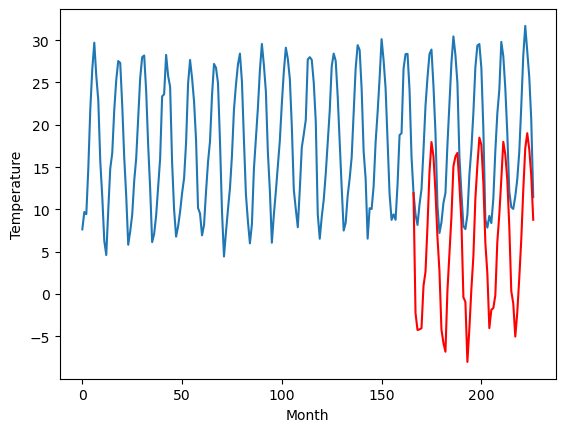

Weather Station 4:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-2.86		-1.61		1.25
-2.85		-3.62		-0.77
-3.40		-3.53		-0.13
-3.75		-3.39		0.36
3.16		1.60		-1.56
3.80		3.25		-0.55
8.37		8.65		0.28
14.19		15.05		0.86
17.99		18.59		0.60
15.57		16.91		1.34
11.51		12.67		1.16
6.09		7.30		1.21
2.17		3.33		1.16
-5.03		-3.58		1.45
-6.49		-5.16		1.33
-7.81		-6.18		1.63
2.40		1.06		-1.34
4.75		5.42		0.67
8.82		9.76		0.94
14.74		15.73		0.99
15.73		16.88		1.15
16.25		17.31		1.06
12.12		13.53		1.41
8.54		9.23		0.69
-1.12		0.26		1.38
0.37		-0.27		-0.64
-8.58		-7.38		1.20
-4.06		-3.43		0.63
1.69		1.24		-0.45
4.70		5.07		0.37
11.48		11.91		0.43
14.96		15.81		0.85
16.51		19.10		2.59
15.44		18.24		2.80
11.46		13.80		2.34
4.19		6.67		2.48
1.07		3.08		2.01
-4.20		-3.41		0.79
-2.45		-1.24		1.21
-0.11		-1.06		-0.95
0.13		0.45		0.32
6.37		6.74		0.37
9.06		10.01		0.95
12.80		14.16		1.36
16.42		18.59		2.17
15.31		17.10		1.79
12.58		14.11		1.53
7.14		8.58		1.44
0.75		0.95		0.20
-1.

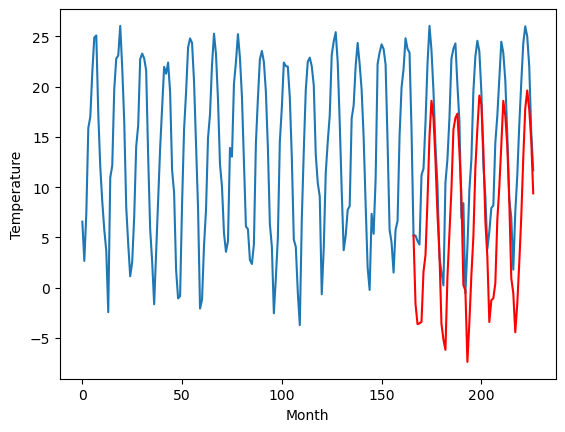

Weather Station 5:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
3.31		-2.69		-6.00
0.05		-4.70		-4.75
-2.82		-4.61		-1.79
-1.67		-4.46		-2.79
5.74		0.52		-5.22
8.77		2.18		-6.59
14.84		7.59		-7.25
21.89		13.99		-7.90
23.35		17.53		-5.82
20.79		15.84		-4.95
16.72		11.61		-5.11
8.99		6.24		-2.75
6.17		2.27		-3.90
-1.00		-4.63		-3.63
-2.47		-6.21		-3.74
-6.34		-7.23		-0.89
6.74		0.02		-6.72
10.03		4.38		-5.65
14.60		8.73		-5.87
22.08		14.70		-7.38
22.08		15.84		-6.24
22.20		16.27		-5.93
18.84		12.48		-6.36
13.42		8.17		-5.25
3.68		-0.81		-4.49
3.32		-1.34		-4.66
-6.15		-8.44		-2.29
-3.63		-4.50		-0.87
4.83		0.18		-4.65
8.96		4.01		-4.95
16.53		10.85		-5.68
21.98		14.77		-7.21
23.10		18.06		-5.04
21.28		17.20		-4.08
16.96		12.76		-4.20
9.69		5.63		-4.06
3.80		2.03		-1.77
-2.17		-4.45		-2.28
-0.45		-2.27		-1.82
6.07		-2.09		-8.16
3.11		-0.59		-3.70
10.32		5.71		-4.61
16.32		8.99		-7.33
20.42		13.14		-7.28
22.12		17.56		-4.56
20.83		16.07		-4.76
17.47		13.08		-

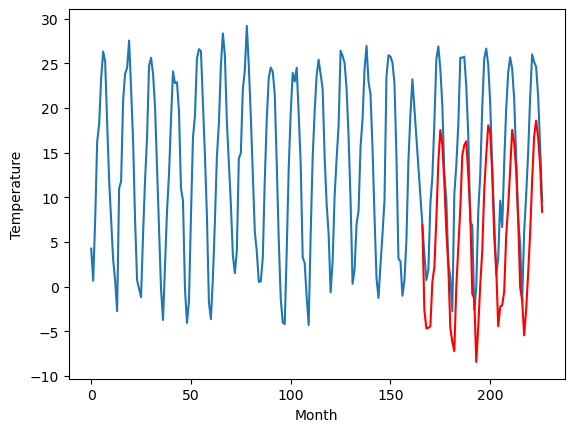

Weather Station 6:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-5.82		-5.01		0.81
-5.61		-7.02		-1.41
-7.03		-6.94		0.09
-7.44		-6.79		0.65
-0.58		-1.81		-1.23
1.69		-0.15		-1.84
7.10		5.26		-1.84
14.09		11.66		-2.43
15.98		15.20		-0.78
13.47		13.51		0.04
9.84		9.27		-0.57
3.84		3.90		0.06
-0.10		-0.05		0.05
-7.71		-6.96		0.75
-9.16		-8.54		0.62
-11.88		-9.56		2.32
-0.55		-2.31		-1.76
2.90		2.06		-0.84
7.18		6.40		-0.78
13.89		12.37		-1.52
14.27		13.51		-0.76
14.59		13.94		-0.65
11.33		10.16		-1.17
6.75		5.85		-0.90
-4.10		-3.13		0.97
-3.05		-3.66		-0.61
-11.87		-10.77		1.10
-8.68		-6.83		1.85
-1.72		-2.15		-0.43
2.13		1.69		-0.44
9.93		8.53		-1.40
13.87		12.44		-1.43
15.86		15.72		-0.14
14.21		14.87		0.66
10.26		10.42		0.16
4.22		3.29		-0.93
-2.33		-0.30		2.03
-7.87		-6.78		1.09
-5.73		-4.60		1.13
-4.01		-4.43		-0.42
-3.11		-2.92		0.19
3.12		3.38		0.26
8.53		6.66		-1.87
11.99		10.81		-1.18
15.25		15.23		-0.02
13.70		13.74		0.04
10.24		10.75		0.51
4.59		

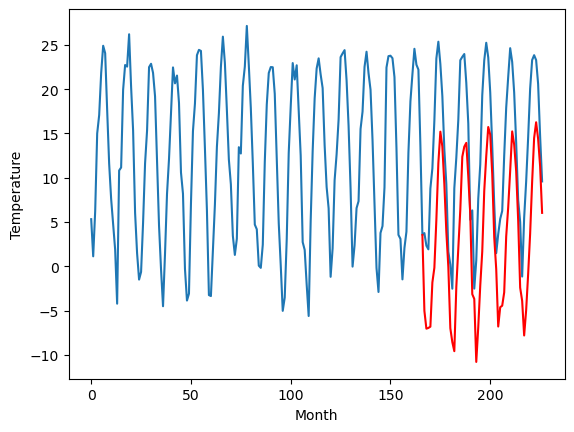

Weather Station 7:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-6.46		-3.93		2.53
-12.13		-5.94		6.19
-12.22		-5.86		6.36
-12.03		-5.71		6.32
-7.10		-0.73		6.37
-4.12		0.93		5.05
2.99		6.34		3.35
7.20		12.75		5.55
9.19		16.29		7.10
9.94		14.60		4.66
4.44		10.36		5.92
0.70		5.00		4.30
-6.49		1.05		7.54
-12.19		-5.87		6.32
-11.92		-7.45		4.47
-11.82		-8.47		3.35
-8.85		-1.23		7.62
-4.07		3.13		7.20
0.98		7.47		6.49
8.37		13.44		5.07
10.21		14.59		4.38
8.29		15.02		6.73
6.42		11.23		4.81
-1.55		6.91		8.46
-4.29		-2.06		2.23
-9.05		-2.59		6.46
-11.34		-9.70		1.64
-13.06		-5.76		7.30
-8.52		-1.07		7.45
-4.20		2.77		6.97
1.71		9.61		7.90
7.48		13.51		6.03
9.40		16.80		7.40
8.64		15.95		7.31
6.48		11.51		5.03
-1.78		4.38		6.16
-9.46		0.80		10.26
-11.63		-5.69		5.94
-12.36		-3.51		8.85
-12.33		-3.33		9.00
-10.54		-1.82		8.72
-5.20		4.47		9.67
2.01		7.75		5.74
6.59		11.90		5.31
12.73		16.32		3.59
10.14		14.84		4.70
5.99		11.85		5.86
-0.14		6.32		6.46
-6.00		-1.31

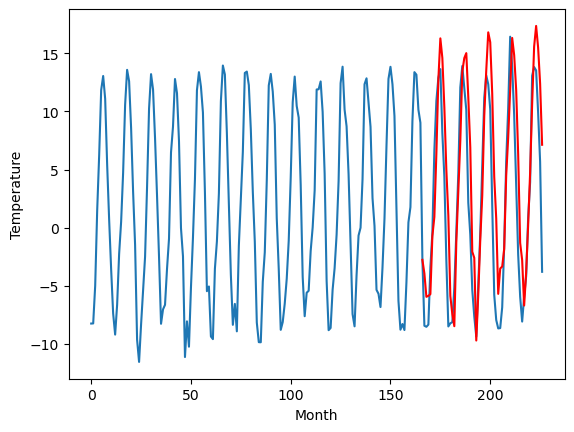

Weather Station 8:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-13.16		-17.50		-4.34
-17.89		-19.50		-1.61
-16.73		-19.42		-2.69
-15.22		-19.27		-4.05
-12.11		-14.28		-2.17
-6.20		-12.63		-6.43
1.07		-7.22		-8.29
4.53		-0.82		-5.35
8.76		2.73		-6.03
8.87		1.05		-7.82
4.06		-3.19		-7.25
-2.88		-8.55		-5.67
-11.69		-12.51		-0.82
-17.38		-19.42		-2.04
-16.83		-21.01		-4.18
-13.98		-22.03		-8.05
-12.38		-14.79		-2.41
-4.41		-10.43		-6.02
0.02		-6.10		-6.12
7.66		-0.12		-7.78
8.74		1.03		-7.71
7.51		1.46		-6.05
3.54		-2.32		-5.86
-6.81		-6.63		0.18
-9.33		-15.60		-6.27
-16.60		-16.14		0.46
-16.67		-23.24		-6.57
-14.63		-19.30		-4.67
-9.92		-14.61		-4.69
-5.29		-10.78		-5.49
-0.62		-3.93		-3.31
5.86		-0.03		-5.89
8.09		3.28		-4.81
6.50		2.43		-4.07
4.14		-2.01		-6.15
-3.75		-9.13		-5.38
-15.17		-12.73		2.44
-17.50		-19.21		-1.71
-18.01		-17.04		0.97
-17.10		-16.86		0.24
-14.27		-15.34		-1.07
-6.32		-9.05		-2.73
-0.52		-5.78		-5.26
1.98		-1.63		-3.61
10.34		2.8

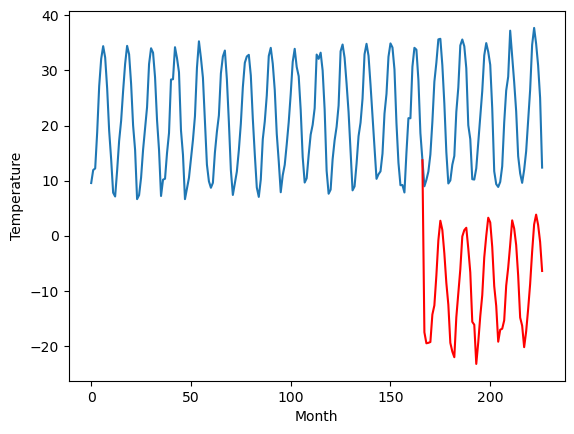

Weather Station 9:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
5.28		0.32		-4.96
4.03		-1.68		-5.71
3.40		-1.60		-5.00
5.42		-1.45		-6.87
4.86		3.54		-1.32
8.48		5.20		-3.28
10.88		10.60		-0.28
13.42		16.99		3.57
12.61		20.54		7.93
14.49		18.87		4.38
13.91		14.63		0.72
11.69		9.28		-2.41
4.53		5.32		0.79
2.48		-1.60		-4.08
3.70		-3.19		-6.89
4.63		-4.21		-8.84
4.41		3.02		-1.39
6.60		7.39		0.79
10.89		11.72		0.83
12.59		17.71		5.12
11.77		18.86		7.09
12.32		19.29		6.97
11.77		15.51		3.74
9.01		11.20		2.19
6.19		2.22		-3.97
2.49		1.69		-0.80
3.11		-5.41		-8.52
4.07		-1.47		-5.54
6.30		3.22		-3.08
7.74		7.05		-0.69
10.73		13.89		3.16
13.88		17.78		3.90
12.23		21.09		8.86
13.65		20.24		6.59
13.88		15.80		1.92
9.15		8.67		-0.48
3.42		5.08		1.66
2.22		-1.41		-3.63
3.89		0.76		-3.13
2.09		0.96		-1.13
3.55		2.47		-1.08
7.63		8.77		1.14
8.66		12.04		3.38
10.56		16.18		5.62
13.57		20.61		7.04
14.60		19.13		4.53
11.99		16.14		4.15
10.53		10.60		0.07
6.49		2.98		-3

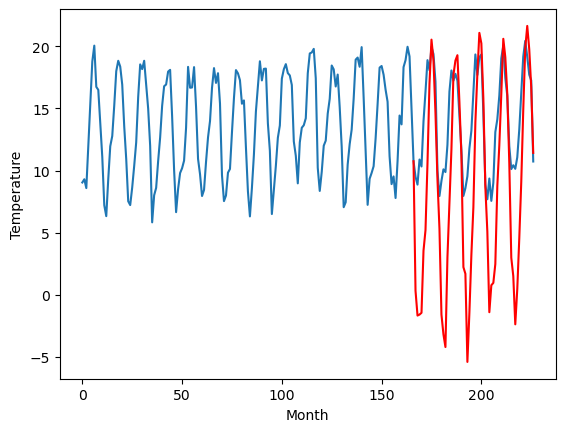

Weather Station 10:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
0.63		-0.22		-0.85
-2.13		-2.22		-0.09
-2.10		-2.13		-0.03
-1.66		-1.98		-0.32
1.92		3.01		1.09
3.36		4.67		1.31
8.92		10.08		1.16
15.90		16.48		0.58
19.85		20.03		0.18
18.67		18.34		-0.33
14.33		14.10		-0.23
9.01		8.75		-0.26
4.94		4.78		-0.16
-1.40		-2.13		-0.73
-4.42		-3.71		0.71
-4.54		-4.72		-0.18
0.46		2.51		2.05
5.08		6.88		1.80
9.91		11.22		1.31
15.78		17.20		1.42
17.92		18.36		0.44
18.54		18.79		0.25
15.22		15.00		-0.22
10.78		10.70		-0.08
1.86		1.72		-0.14
0.26		1.18		0.92
-6.29		-5.92		0.37
-3.53		-1.98		1.55
0.43		2.70		2.27
4.72		6.52		1.80
10.51		13.37		2.86
14.83		17.26		2.43
19.38		20.56		1.18
19.30		19.71		0.41
14.39		15.27		0.88
8.13		8.14		0.01
4.17		4.55		0.38
-2.19		-1.94		0.25
-0.21		0.23		0.44
-1.94		0.41		2.35
0.03		1.92		1.89
6.08		8.22		2.14
9.72		11.49		1.77
13.71		15.64		1.93
19.39		20.07		0.68
17.14		18.59		1.45
14.57		15.60		1.03
9.14		10.06		0.92
1.29		2.43		1.

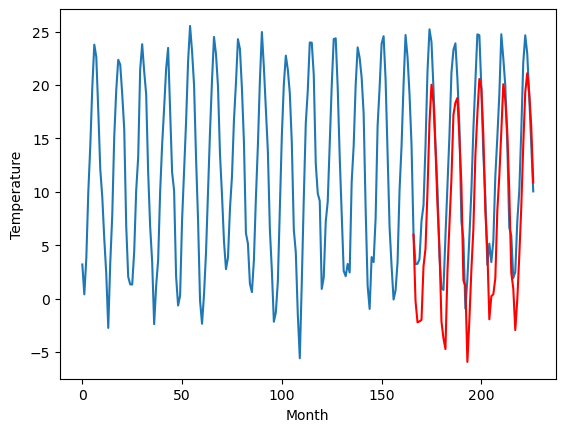

Weather Station 11:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-6.46		-6.06		0.40
-9.42		-8.06		1.36
-9.01		-7.97		1.04
-8.09		-7.83		0.26
-3.68		-2.84		0.84
-1.74		-1.18		0.56
4.03		4.23		0.20
10.75		10.64		-0.11
14.52		14.18		-0.34
12.65		12.50		-0.15
7.68		8.25		0.57
2.19		2.90		0.71
-2.09		-1.06		1.03
-8.91		-7.97		0.94
-10.47		-9.55		0.92
-11.27		-10.55		0.72
-4.08		-3.32		0.76
0.79		1.05		0.26
5.05		5.39		0.34
11.22		11.37		0.15
12.86		12.52		-0.34
12.59		12.95		0.36
8.33		9.17		0.84
4.21		4.86		0.65
-6.01		-4.11		1.90
-6.42		-4.65		1.77
-13.40		-11.75		1.65
-9.59		-7.81		1.78
-4.41		-3.13		1.28
-0.59		0.69		1.28
6.19		7.53		1.34
10.18		11.44		1.26
13.96		14.72		0.76
13.09		13.87		0.78
7.86		9.43		1.57
0.25		2.30		2.05
-2.87		-1.29		1.58
-9.90		-7.77		2.13
-7.25		-5.61		1.64
-7.04		-5.43		1.61
-5.48		-3.93		1.55
2.09		2.37		0.28
4.56		5.64		1.08
8.49		9.79		1.30
13.33		14.22		0.89
11.36		12.74		1.38
8.07		9.75		1.68
2.78		4.21		1.43
-5.49		-3.42		

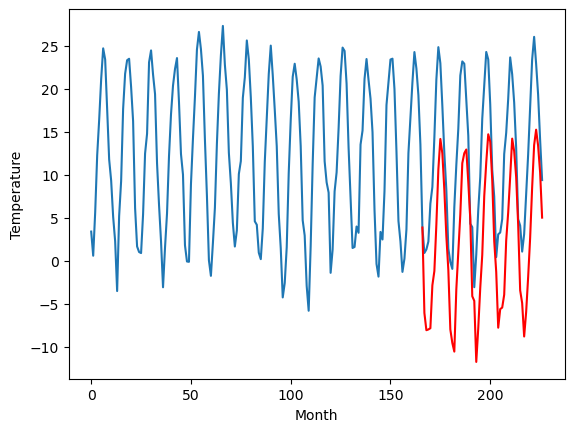

Predictions for (t+0):
    Weather_Station  Actual  Predicted
0                 0   -6.46  -6.062548
1                 1    2.22  -0.357604
2                 2    2.71  -2.239657
3                 3   -2.86  -1.613170
4                 4    3.31  -2.688369
5                 5   -5.82  -5.011909
6                 6   -6.46  -3.934525
7                 7  -13.16 -17.500736
8                 8    5.28   0.319494
9                 9    0.63  -0.216312
10               10   -6.46  -6.059742


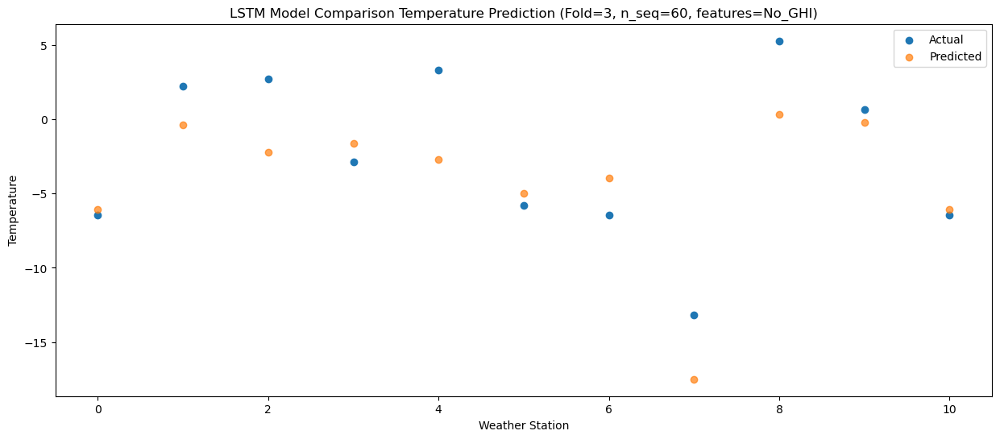

Predictions for (t+1):
    Weather_Station  Actual  Predicted
0                 0   -7.24  -8.068537
1                 1    0.87  -2.365846
2                 2    0.18  -4.243095
3                 3   -2.85  -3.620006
4                 4    0.05  -4.695972
5                 5   -5.61  -7.018843
6                 6  -12.13  -5.940524
7                 7  -17.89 -19.501161
8                 8    4.03  -1.675265
9                 9   -2.13  -2.215749
10               10   -9.42  -8.063851


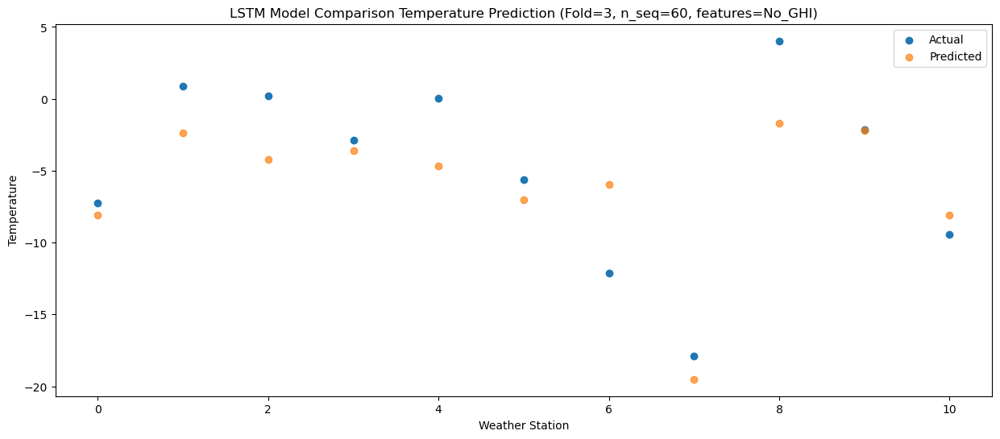

Predictions for (t+2):
    Weather_Station  Actual  Predicted
0                 0   -7.66  -7.980059
1                 1    0.03  -2.283185
2                 2   -1.04  -4.165704
3                 3   -3.40  -3.534419
4                 4   -2.82  -4.609943
5                 5   -7.03  -6.936584
6                 6  -12.22  -5.857274
7                 7  -16.73 -19.417235
8                 8    3.40  -1.595718
9                 9   -2.10  -2.125459
10               10   -9.01  -7.973725


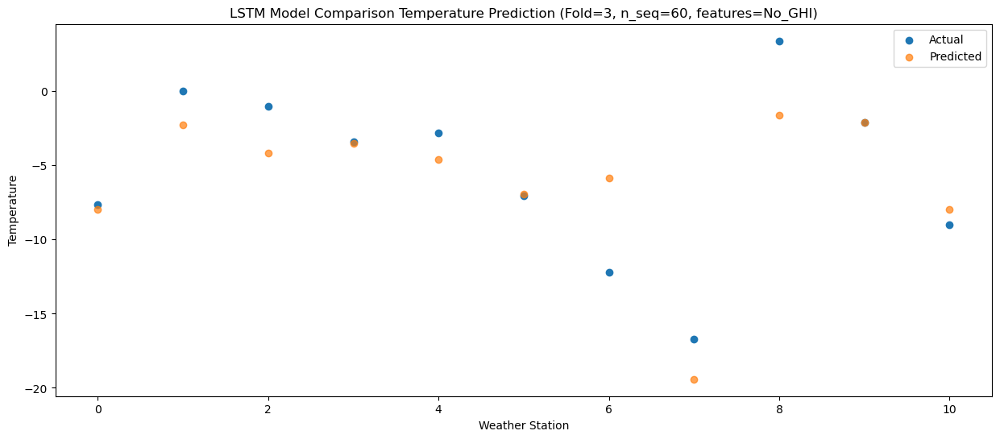

Predictions for (t+3):
    Weather_Station  Actual  Predicted
0                 0   -6.65  -7.842715
1                 1    0.18  -2.139928
2                 2    1.38  -4.024938
3                 3   -3.75  -3.392189
4                 4   -1.67  -4.464929
5                 5   -7.44  -6.792163
6                 6  -12.03  -5.712333
7                 7  -15.22 -19.271233
8                 8    5.42  -1.453655
9                 9   -1.66  -1.984391
10               10   -8.09  -7.831851


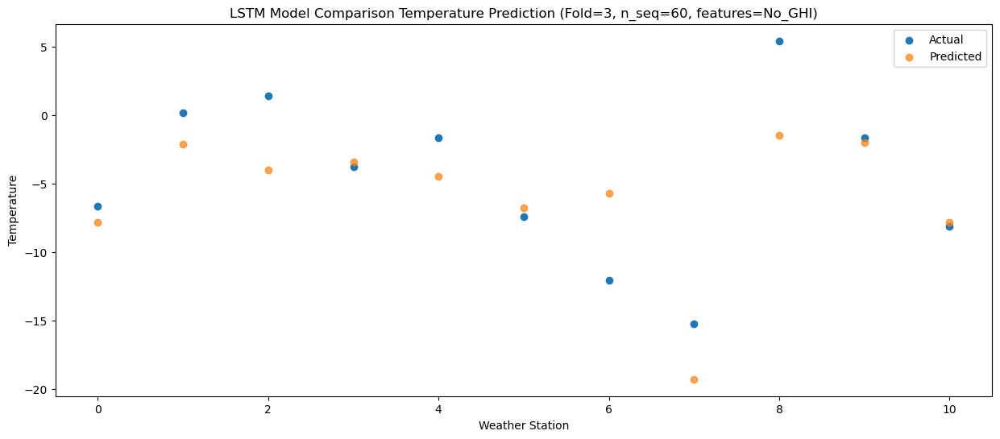

Predictions for (t+4):
    Weather_Station  Actual  Predicted
0                 0   -1.39  -2.854991
1                 1    7.67   2.849434
2                 2    3.17   0.967230
3                 3    3.16   1.595159
4                 4    5.74   0.522776
5                 5   -0.58  -1.807600
6                 6   -7.10  -0.725043
7                 7  -12.11 -14.280836
8                 8    4.86   3.543814
9                 9    1.92   3.012896
10               10   -3.68  -2.838349


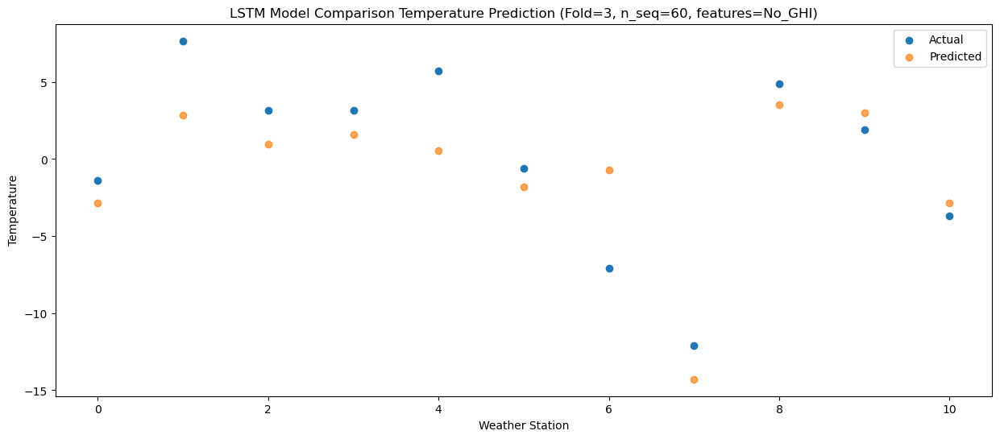

Predictions for (t+5):
    Weather_Station  Actual  Predicted
0                 0   -0.32  -1.203775
1                 1    8.59   4.503339
2                 2    7.83   2.617362
3                 3    3.80   3.245693
4                 4    8.77   2.177949
5                 5    1.69  -0.150244
6                 6   -4.12   0.932517
7                 7   -6.20 -12.626393
8                 8    8.48   5.197707
9                 9    3.36   4.666059
10               10   -1.74  -1.182748


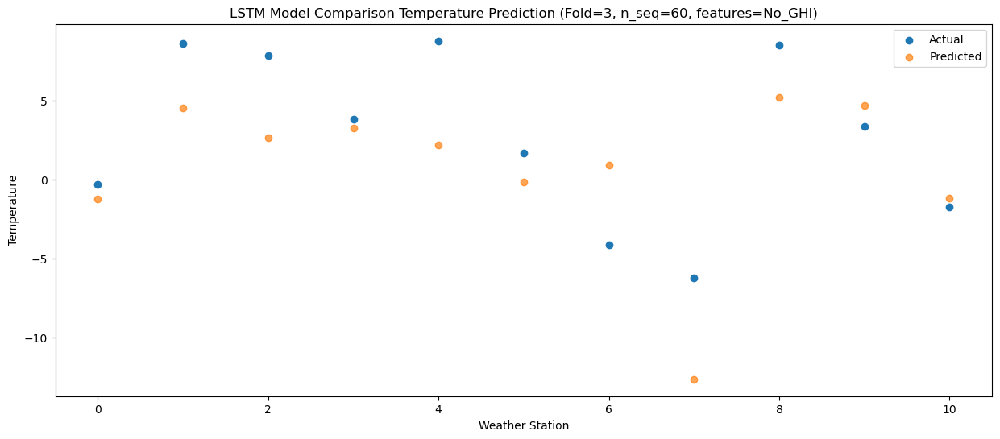

Predictions for (t+6):
    Weather_Station  Actual  Predicted
0                 0    2.37   4.195031
1                 1   12.99   9.907058
2                 2   13.02   8.021228
3                 3    8.37   8.651038
4                 4   14.84   7.586977
5                 5    7.10   5.258156
6                 6    2.99   6.342946
7                 7    1.07  -7.217508
8                 8   10.88  10.597893
9                 9    8.92  10.076929
10               10    4.03   4.232360


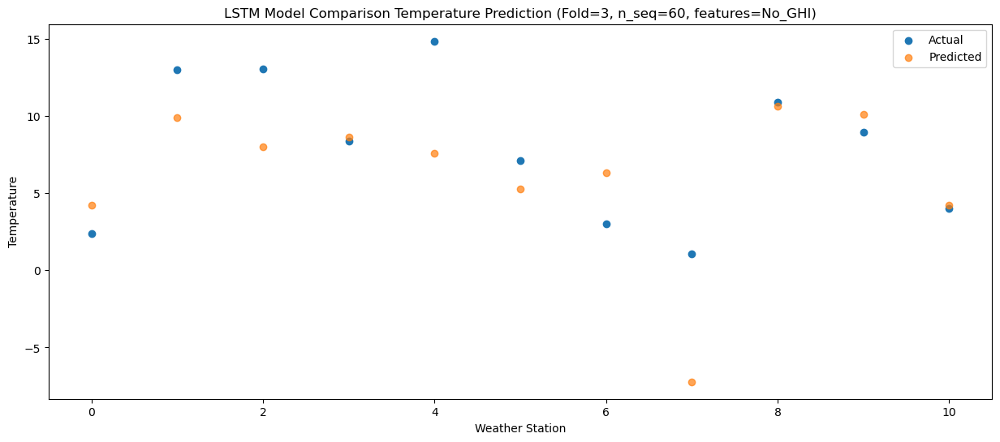

Predictions for (t+7):
    Weather_Station  Actual  Predicted
0                 0    7.69  10.590941
1                 1   20.09  16.306524
2                 2   16.37  14.416897
3                 3   14.19  15.050052
4                 4   21.89  13.989824
5                 5   14.09  11.664608
6                 6    7.20  12.746774
7                 7    4.53  -0.815544
8                 8   13.42  16.994892
9                 9   15.90  16.477118
10               10   10.75  10.635134


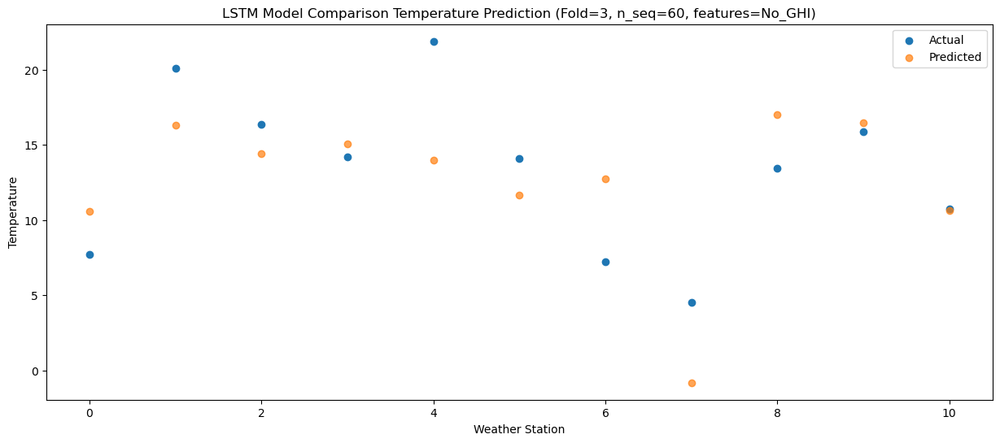

Predictions for (t+8):
    Weather_Station  Actual  Predicted
0                 0   10.55  14.129587
1                 1   21.95  19.844608
2                 2   19.15  17.962325
3                 3   17.99  18.587860
4                 4   23.35  17.530103
5                 5   15.98  15.201791
6                 6    9.19  16.286013
7                 7    8.76   2.728941
8                 8   12.61  20.543281
9                 9   19.85  20.025841
10               10   14.52  14.181738


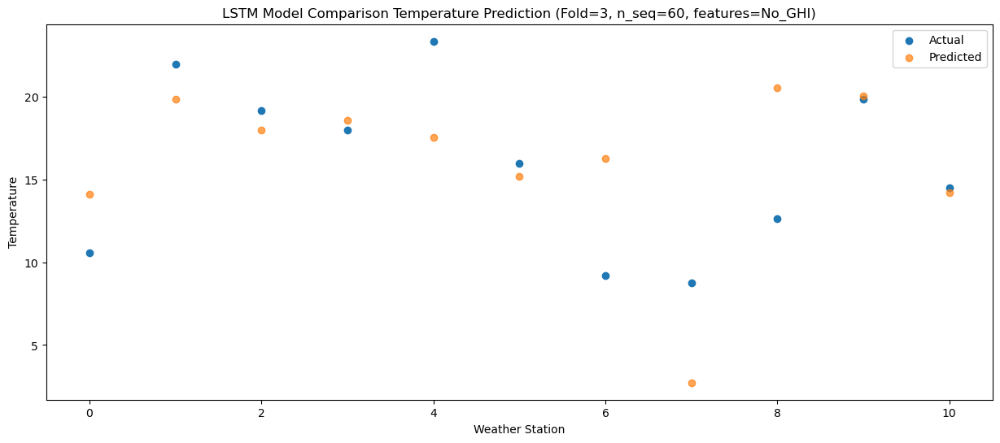

Predictions for (t+9):
    Weather_Station  Actual  Predicted
0                 0    9.32  12.453519
1                 1   20.09  18.160088
2                 2   19.68  16.288520
3                 3   15.57  16.906422
4                 4   20.79  15.840718
5                 5   13.47  13.509498
6                 6    9.94  14.599512
7                 7    8.87   1.050693
8                 8   14.49  18.873145
9                 9   18.67  18.344917
10               10   12.65  12.499935


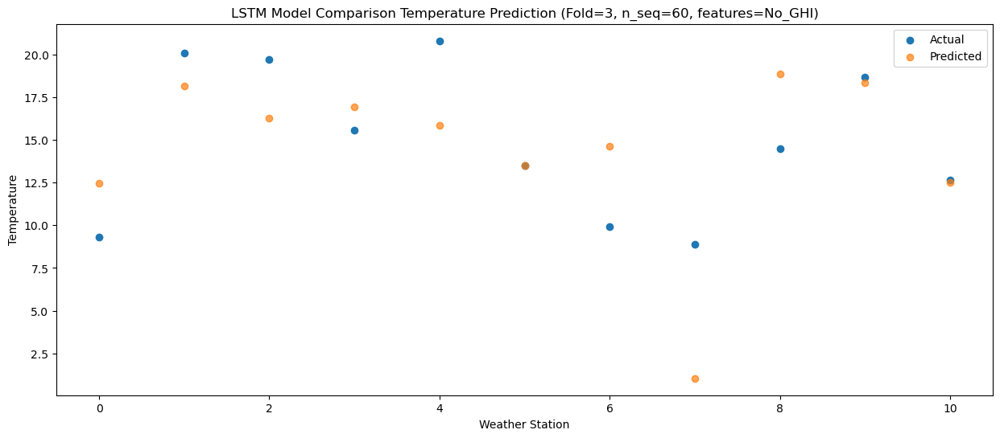

Predictions for (t+10):
    Weather_Station  Actual  Predicted
0                 0    5.35   8.212882
1                 1   16.42  13.926473
2                 2   15.35  12.048205
3                 3   11.51  12.666043
4                 4   16.72  11.606378
5                 5    9.84   9.272129
6                 6    4.44  10.363054
7                 7    4.06  -3.188372
8                 8   13.91  14.634031
9                 9   14.33  14.098554
10               10    7.68   8.250585


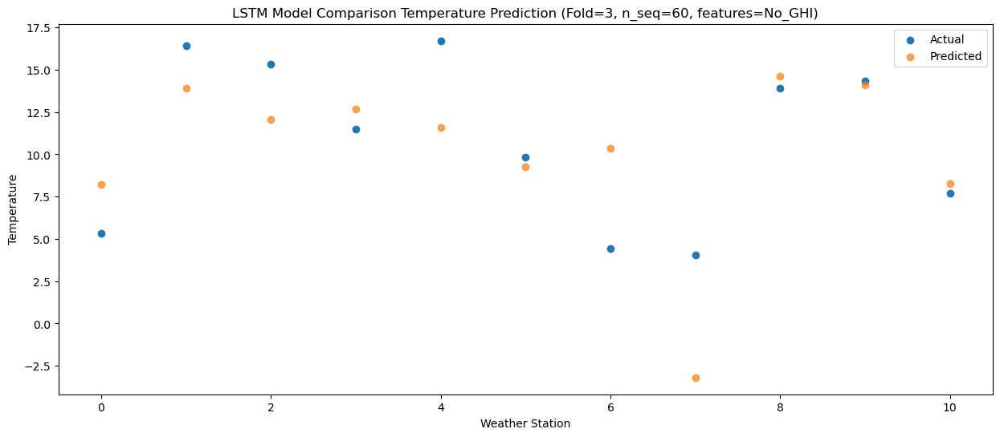

Predictions for (t+11):
    Weather_Station  Actual  Predicted
0                 0    1.78   2.848791
1                 1    9.31   8.556804
2                 2    9.86   6.685396
3                 3    6.09   7.303456
4                 4    8.99   6.235554
5                 5    3.84   3.903405
6                 6    0.70   5.001325
7                 7   -2.88  -8.549046
8                 8   11.69   9.282566
9                 9    9.01   8.748882
10               10    2.19   2.899166


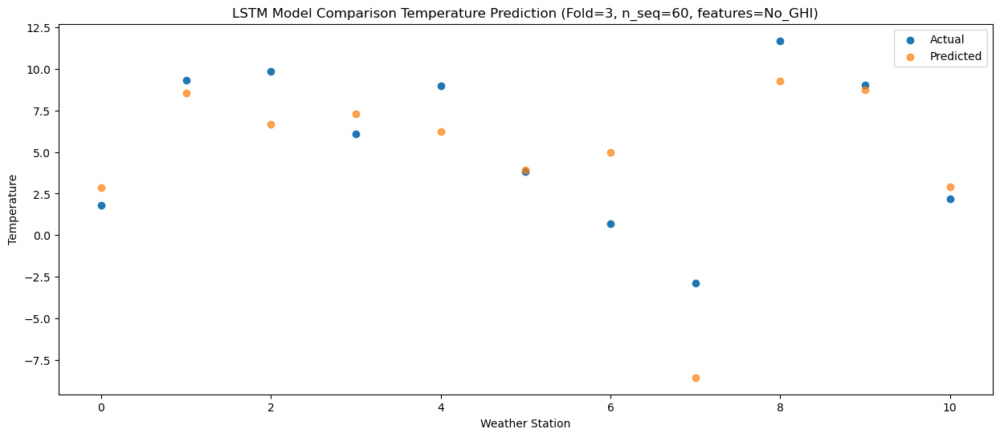

Predictions for (t+12):
    Weather_Station  Actual  Predicted
0                 0   -2.64  -1.123415
1                 1    6.49   4.592748
2                 2    1.21   2.721491
3                 3    2.17   3.333687
4                 4    6.17   2.274843
5                 5   -0.10  -0.054975
6                 6   -6.49   1.045194
7                 7  -11.69 -12.506997
8                 8    4.53   5.315408
9                 9    4.94   4.784374
10               10   -2.09  -1.061197


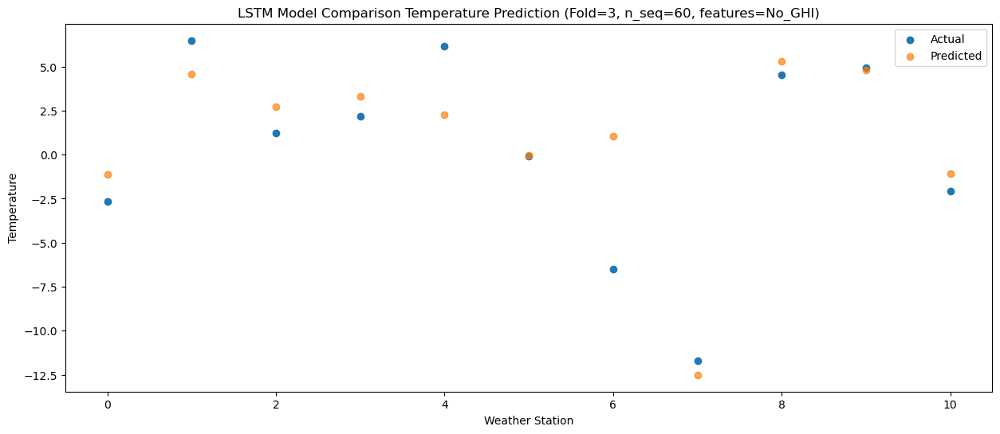

Predictions for (t+13):
    Weather_Station  Actual  Predicted
0                 0   -9.82  -8.039580
1                 1   -0.06  -2.322187
2                 2   -1.99  -4.193844
3                 3   -5.03  -3.583194
4                 4   -1.00  -4.634431
5                 5   -7.71  -6.964815
6                 6  -12.19  -5.866081
7                 7  -17.38 -19.422151
8                 8    2.48  -1.599501
9                 9   -1.40  -2.125573
10               10   -8.91  -7.967480


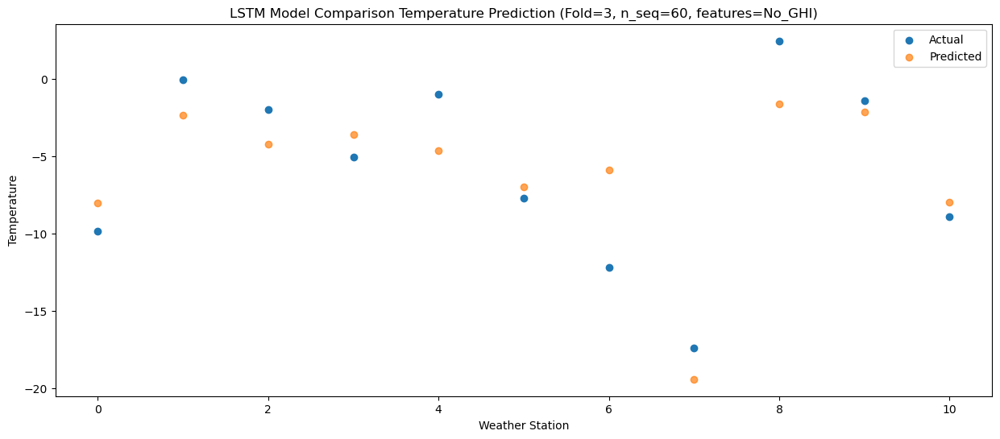

Predictions for (t+14):
    Weather_Station  Actual  Predicted
0                 0  -10.10  -9.620806
1                 1   -1.21  -3.898706
2                 2   -0.73  -5.782385
3                 3   -6.49  -5.159748
4                 4   -2.47  -6.208809
5                 5   -9.16  -8.537795
6                 6  -11.92  -7.445848
7                 7  -16.83 -21.007397
8                 8    3.70  -3.191317
9                 9   -4.42  -3.707293
10               10  -10.47  -9.545425


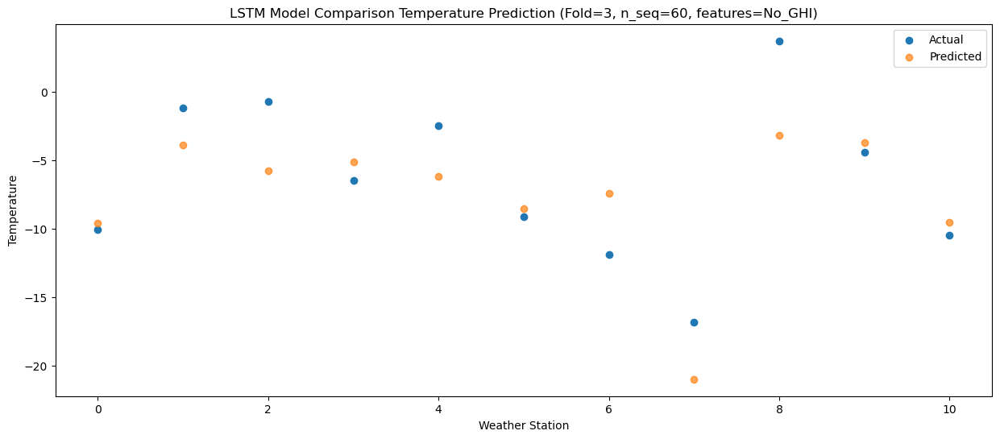

Predictions for (t+15):
    Weather_Station  Actual  Predicted
0                 0   -9.73 -10.635905
1                 1   -4.93  -4.921043
2                 2    1.57  -6.804210
3                 3   -7.81  -6.176978
4                 4   -6.34  -7.230045
5                 5  -11.88  -9.557946
6                 6  -11.82  -8.468582
7                 7  -13.98 -22.028460
8                 8    4.63  -4.209801
9                 9   -4.54  -4.718005
10               10  -11.27 -10.551322


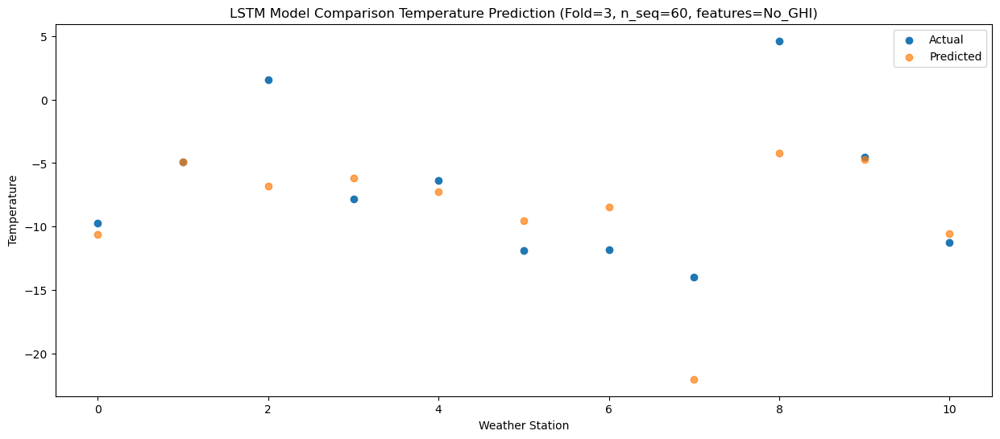

Predictions for (t+16):
    Weather_Station  Actual  Predicted
0                 0   -2.93  -3.409280
1                 1    7.04   2.320530
2                 2    2.72   0.428631
3                 3    2.40   1.058344
4                 4    6.74   0.017900
5                 5   -0.55  -2.309598
6                 6   -8.85  -1.230941
7                 7  -12.38 -14.791118
8                 8    4.41   3.019300
9                 9    0.46   2.510826
10               10   -4.08  -3.322636


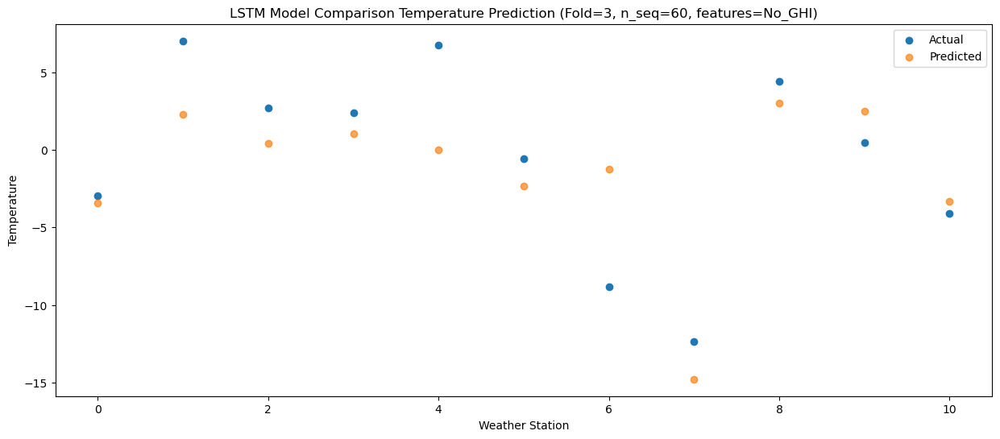

Predictions for (t+17):
    Weather_Station  Actual  Predicted
0                 0    0.23   0.947214
1                 1    8.90   6.681170
2                 2    8.45   4.790413
3                 3    4.75   5.421204
4                 4   10.03   4.384153
5                 5    2.90   2.056975
6                 6   -4.07   3.134332
7                 7   -4.41 -10.427243
8                 8    6.60   7.385573
9                 9    5.08   6.884772
10               10    0.79   1.052030


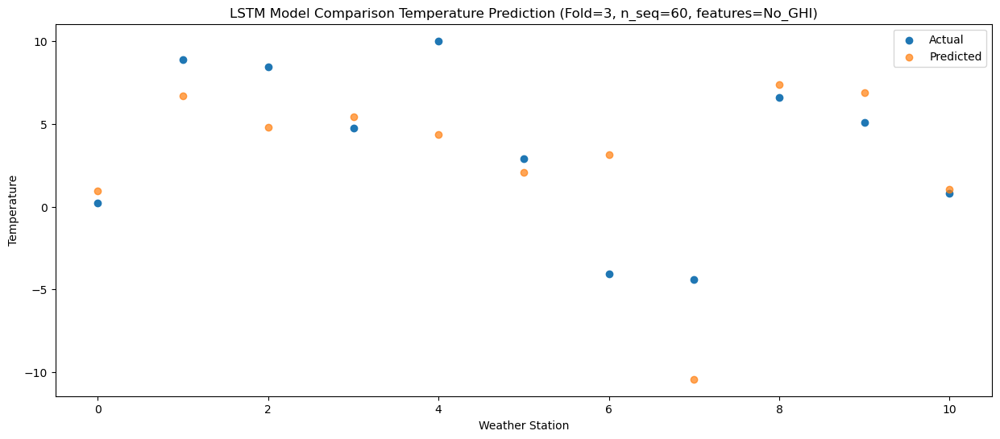

Predictions for (t+18):
    Weather_Station  Actual  Predicted
0                 0    3.89   5.287372
1                 1   13.12  11.025873
2                 2   13.25   9.123361
3                 3    8.82   9.759103
4                 4   14.60   8.726871
5                 5    7.18   6.399854
6                 6    0.98   7.470873
7                 7    0.02  -6.096913
8                 8   10.89  11.720823
9                 9    9.91  11.221337
10               10    5.05   5.389846


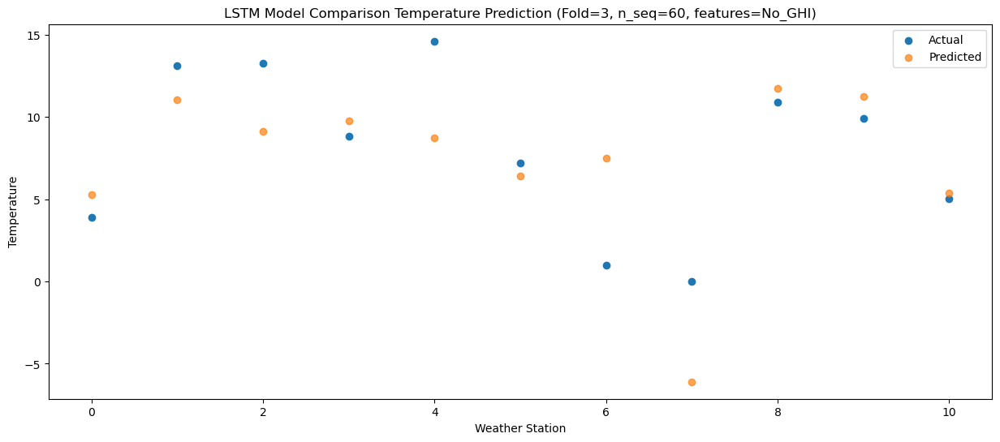

Predictions for (t+19):
    Weather_Station  Actual  Predicted
0                 0    7.95  11.262696
1                 1   19.83  16.996972
2                 2   18.10  15.102088
3                 3   14.74  15.734072
4                 4   22.08  14.697114
5                 5   13.89  12.370342
6                 6    8.37  13.441287
7                 7    7.66  -0.116636
8                 8   12.59  17.706442
9                 9   15.78  17.198977
10               10   11.22  11.365040


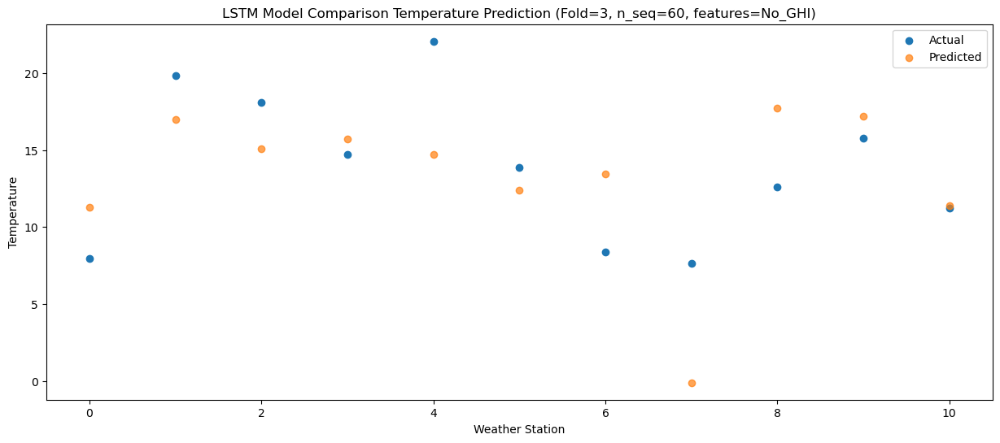

Predictions for (t+20):
    Weather_Station  Actual  Predicted
0                 0    9.66  12.410298
1                 1   21.14  18.140855
2                 2   21.23  16.248243
3                 3   15.73  16.879292
4                 4   22.08  15.842388
5                 5   14.27  13.514242
6                 6   10.21  14.590922
7                 7    8.74   1.030068
8                 8   11.77  18.857441
9                 9   17.92  18.355015
10               10   12.86  12.523288


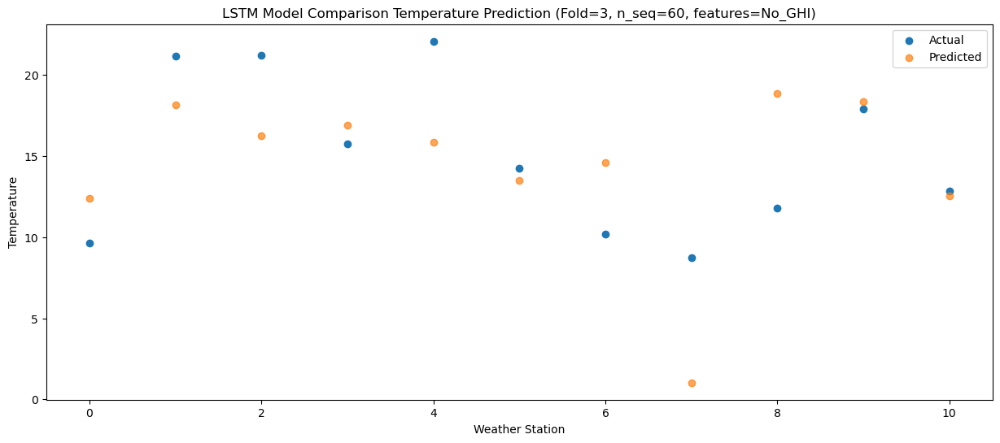

Predictions for (t+21):
    Weather_Station  Actual  Predicted
0                 0    9.88  12.839474
1                 1   21.71  18.566084
2                 2   19.03  16.677826
3                 3   16.25  17.312749
4                 4   22.20  16.266019
5                 5   14.59  13.939103
6                 6    8.29  15.016921
7                 7    7.51   1.458241
8                 8   12.32  19.290314
9                 9   18.54  18.788982
10               10   12.59  12.954762


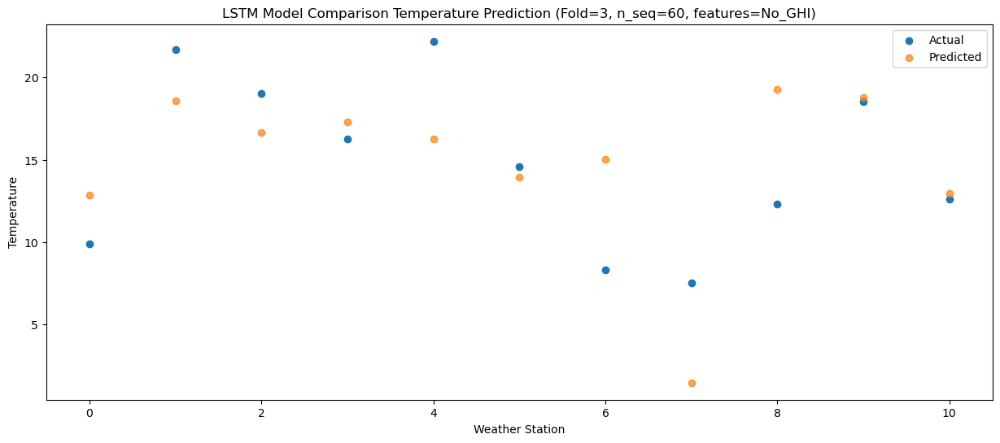

Predictions for (t+22):
    Weather_Station  Actual  Predicted
0                 0    5.89   9.061115
1                 1   18.98  14.779299
2                 2   15.72  12.899788
3                 3   12.12  13.533776
4                 4   18.84  12.483122
5                 5   11.33  10.157387
6                 6    6.42  11.230182
7                 7    3.54  -2.324841
8                 8   11.77  15.505776
9                 9   15.22  15.002404
10               10    8.33   9.170839


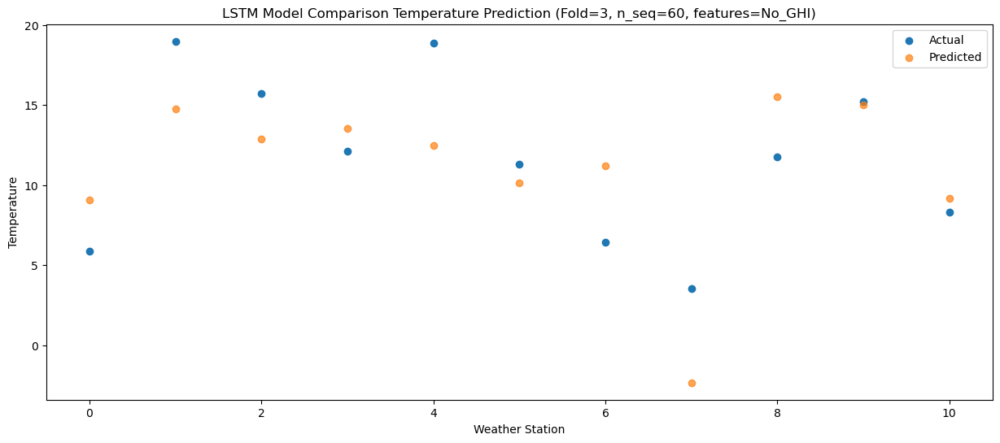

Predictions for (t+23):
    Weather_Station  Actual  Predicted
0                 0    2.66   4.757188
1                 1   12.38  10.467319
2                 2    7.06   8.591823
3                 3    8.54   9.230764
4                 4   13.42   8.168740
5                 5    6.75   5.845614
6                 6   -1.55   6.914253
7                 7   -6.81  -6.634982
8                 8    9.01  11.197986
9                 9   10.78  10.696811
10               10    4.21   4.864056


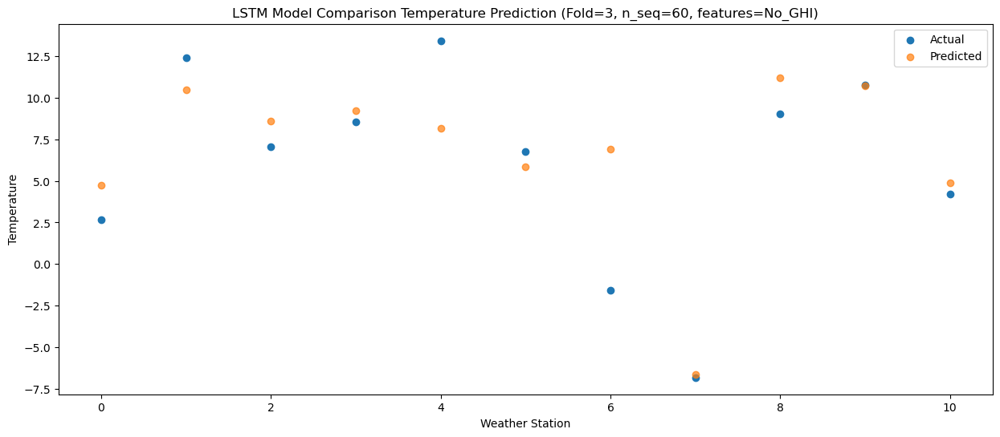

Predictions for (t+24):
    Weather_Station  Actual  Predicted
0                 0   -6.10  -4.216073
1                 1    4.67   1.494310
2                 2    2.72  -0.378742
3                 3   -1.12   0.259806
4                 4    3.68  -0.807298
5                 5   -4.10  -3.132447
6                 6   -4.29  -2.062113
7                 7   -9.33 -15.604043
8                 8    6.19   2.223262
9                 9    1.86   1.719372
10               10   -6.01  -4.113999


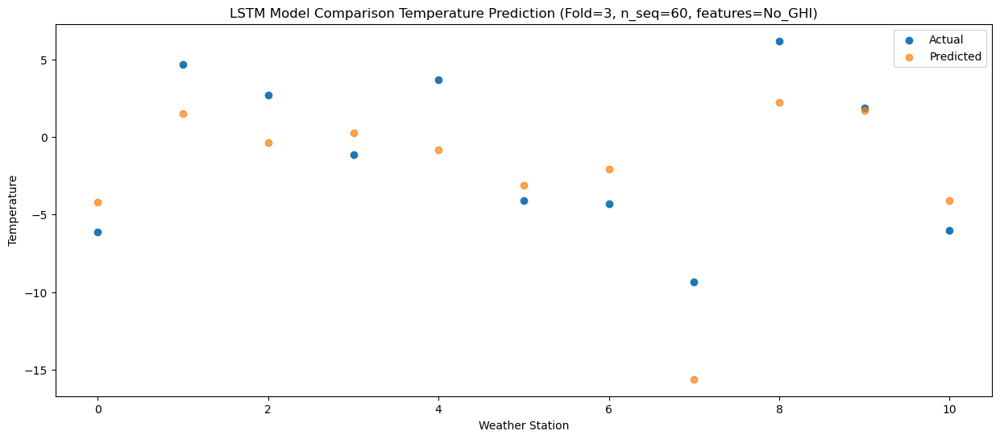

Predictions for (t+25):
    Weather_Station  Actual  Predicted
0                 0   -4.14  -4.754841
1                 1    5.98   0.961188
2                 2   -1.20  -0.911141
3                 3    0.37  -0.272175
4                 4    3.32  -1.335686
5                 5   -3.05  -3.661292
6                 6   -9.05  -2.591812
7                 7  -16.60 -16.136219
8                 8    2.49   1.689670
9                 9    0.26   1.181359
10               10   -6.42  -4.648828


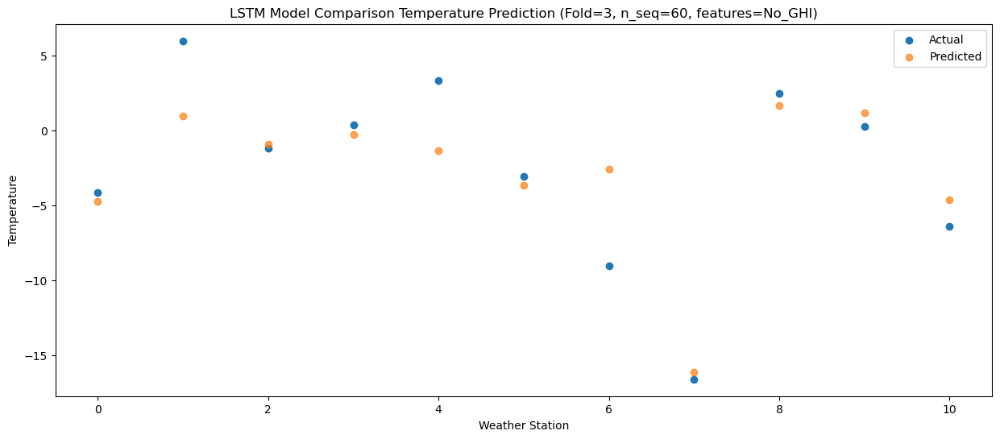

Predictions for (t+26):
    Weather_Station  Actual  Predicted
0                 0  -10.98 -11.857935
1                 1   -2.85  -6.138475
2                 2   -1.53  -8.011662
3                 3   -8.58  -7.376366
4                 4   -6.15  -8.441686
5                 5  -11.87 -10.769854
6                 6  -11.34  -9.699278
7                 7  -16.67 -23.243869
8                 8    3.11  -5.408599
9                 9   -6.29  -5.922117
10               10  -13.40 -11.752294


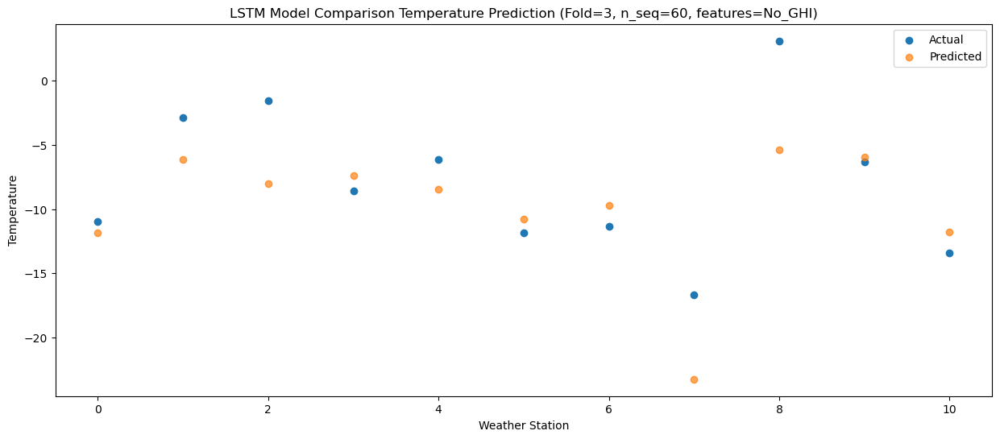

Predictions for (t+27):
    Weather_Station  Actual  Predicted
0                 0   -6.60  -7.911032
1                 1   -1.63  -2.195760
2                 2    0.17  -4.066380
3                 3   -4.06  -3.432881
4                 4   -3.63  -4.502354
5                 5   -8.68  -6.829616
6                 6  -13.06  -5.759223
7                 7  -14.63 -19.299732
8                 8    4.07  -1.465243
9                 9   -3.53  -1.982671
10               10   -9.59  -7.809005


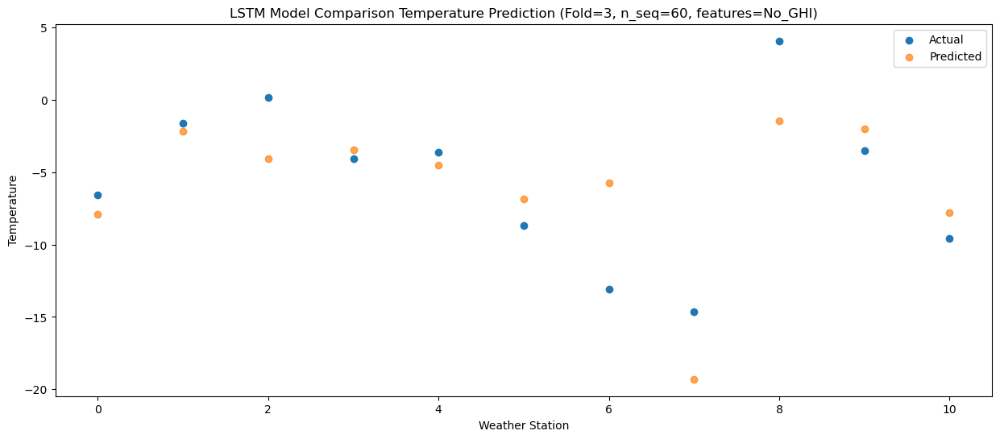

Predictions for (t+28):
    Weather_Station  Actual  Predicted
0                 0   -2.54  -3.237754
1                 1    5.15   2.481143
2                 2    4.88   0.616087
3                 3    1.69   1.243988
4                 4    4.83   0.181012
5                 5   -1.72  -2.149489
6                 6   -8.52  -1.068405
7                 7   -9.92 -14.607414
8                 8    6.30   3.218662
9                 9    0.43   2.697513
10               10   -4.41  -3.130494


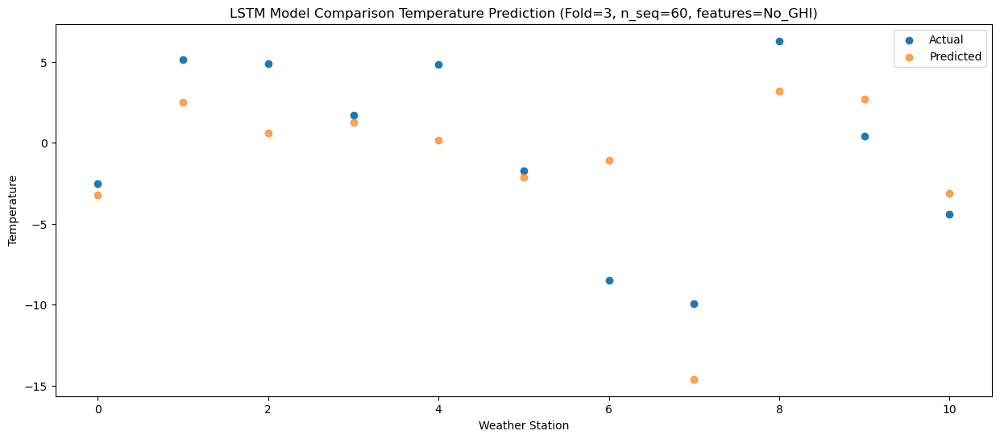

Predictions for (t+29):
    Weather_Station  Actual  Predicted
0                 0    0.56   0.584897
1                 1   10.00   6.309773
2                 2    7.95   4.444608
3                 3    4.70   5.070508
4                 4    8.96   4.014484
5                 5    2.13   1.689607
6                 6   -4.20   2.767875
7                 7   -5.29 -10.775682
8                 8    7.74   7.046658
9                 9    4.72   6.522516
10               10   -0.59   0.691085


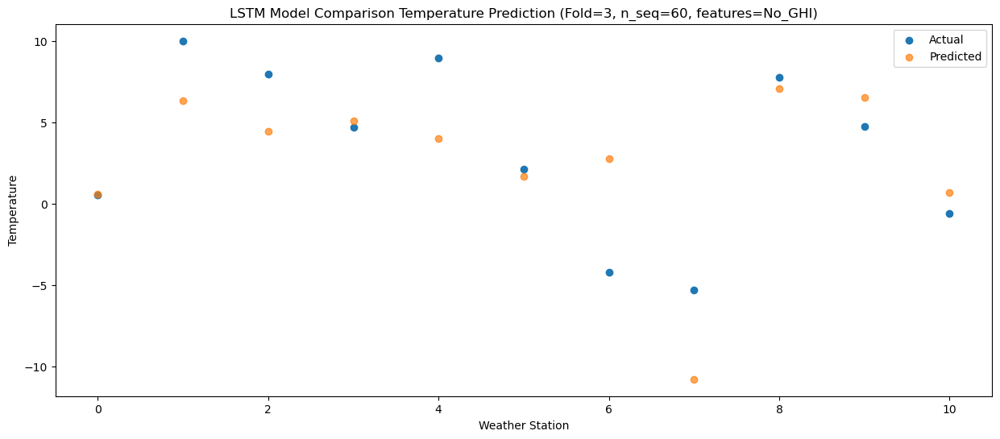

Predictions for (t+30):
    Weather_Station  Actual  Predicted
0                 0    5.40   7.429805
1                 1   15.43  13.150309
2                 2   12.19  11.285053
3                 3   11.48  11.911534
4                 4   16.53  10.854467
5                 5    9.93   8.526579
6                 6    1.71   9.606484
7                 7   -0.62  -3.931166
8                 8   10.73  13.885978
9                 9   10.51  13.365693
10               10    6.19   7.534980


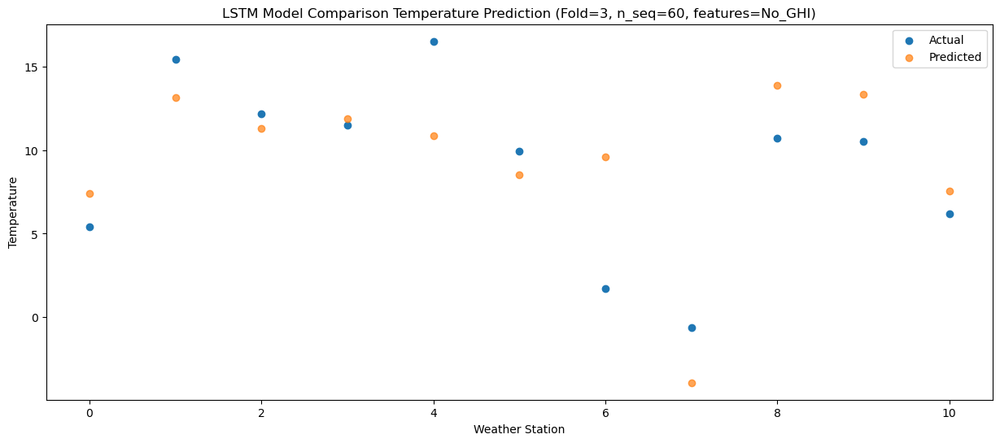

Predictions for (t+31):
    Weather_Station  Actual  Predicted
0                 0    9.36  11.324159
1                 1   20.58  17.059002
2                 2   17.58  15.185589
3                 3   14.96  15.814398
4                 4   21.98  14.769089
5                 5   13.87  12.440710
6                 6    7.48  13.510337
7                 7    5.86  -0.027204
8                 8   13.88  17.776423
9                 9   14.83  17.262164
10               10   10.18  11.436425


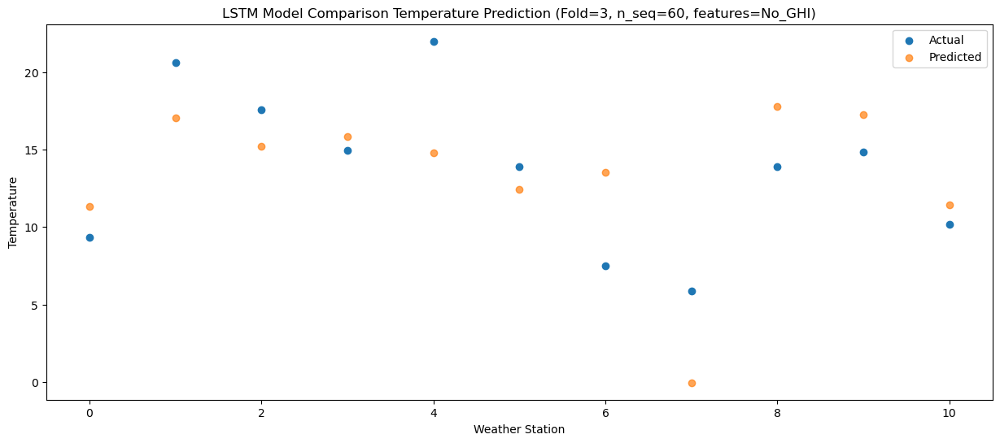

Predictions for (t+32):
    Weather_Station  Actual  Predicted
0                 0   10.13  14.611251
1                 1   24.62  20.346511
2                 2   20.15  18.485875
3                 3   16.51  19.103455
4                 4   23.10  18.056534
5                 5   15.86  15.724767
6                 6    9.40  16.804628
7                 7    8.09   3.278703
8                 8   12.23  21.087572
9                 9   19.38  20.558008
10               10   13.96  14.723627


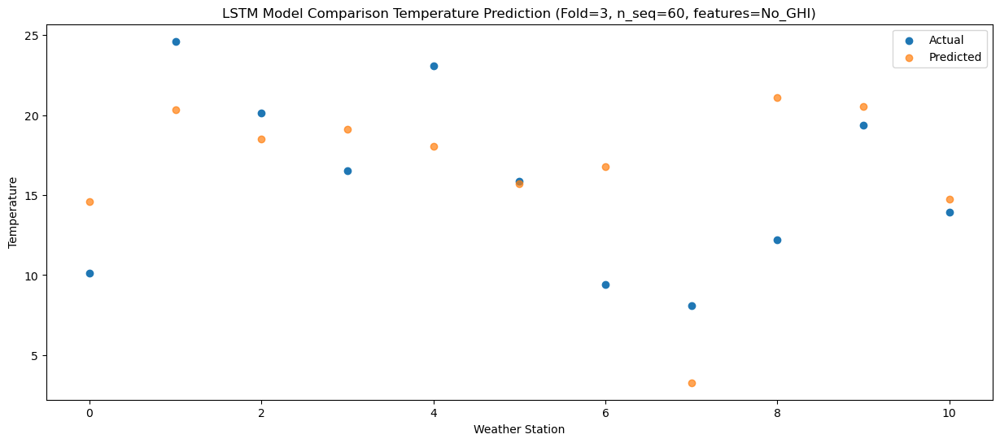

Predictions for (t+33):
    Weather_Station  Actual  Predicted
0                 0    9.22  13.755715
1                 1   21.54  19.488045
2                 2   20.33  17.628616
3                 3   15.44  18.243144
4                 4   21.28  17.198968
5                 5   14.21  14.867517
6                 6    8.64  15.954069
7                 7    6.50   2.426312
8                 8   13.65  20.239662
9                 9   19.30  19.705211
10               10   13.09  13.867092


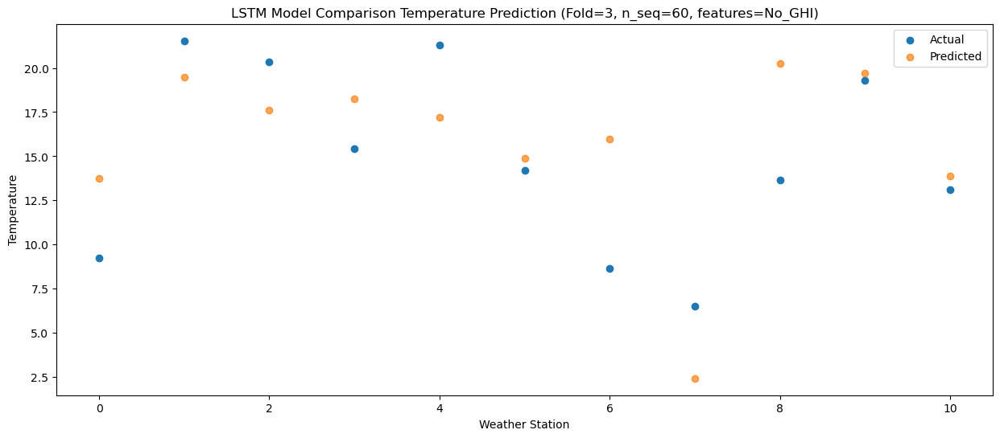

Predictions for (t+34):
    Weather_Station  Actual  Predicted
0                 0    6.01   9.315786
1                 1   17.68  15.044838
2                 2   17.51  13.193188
3                 3   11.46  13.802513
4                 4   16.96  12.755701
5                 5   10.26  10.423513
6                 6    6.48  11.514329
7                 7    4.14  -2.006542
8                 8   13.88  15.802555
9                 9   14.39  15.267098
10               10    7.86   9.429127


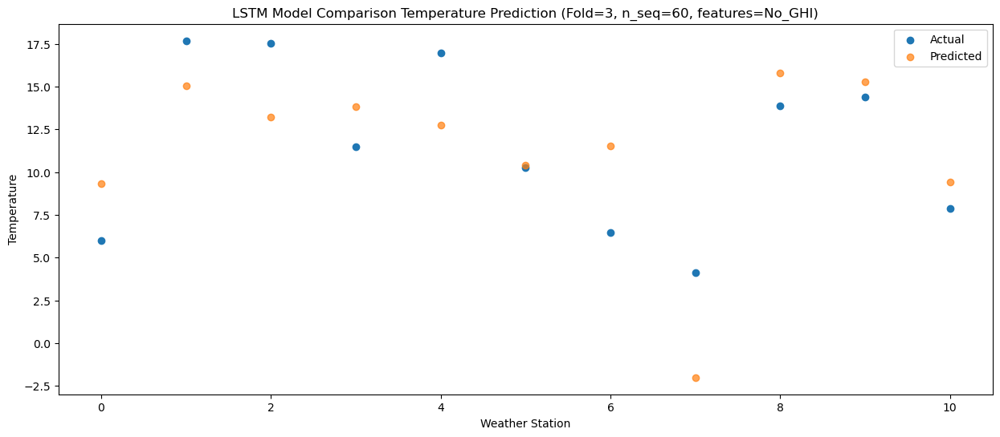

Predictions for (t+35):
    Weather_Station  Actual  Predicted
0                 0   -1.00   2.179147
1                 1   11.13   7.912324
2                 2   10.33   6.061259
3                 3    4.19   6.670382
4                 4    9.69   5.630695
5                 5    4.22   3.292818
6                 6   -1.78   4.384878
7                 7   -3.75  -9.134125
8                 8    9.15   8.670045
9                 9    8.13   8.137177
10               10    0.25   2.296969


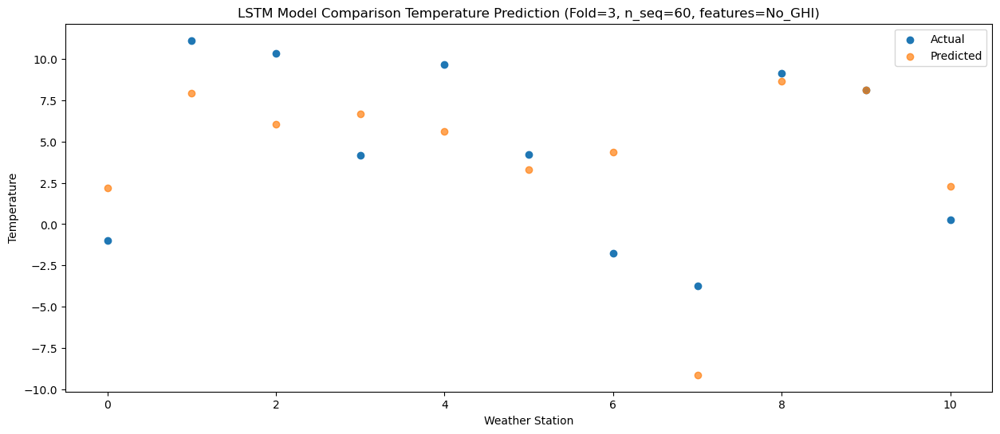

Predictions for (t+36):
    Weather_Station  Actual  Predicted
0                 0   -3.03  -1.412225
1                 1    3.90   4.313333
2                 2   -0.40   2.462314
3                 3    1.07   3.076918
4                 4    3.80   2.034354
5                 5   -2.33  -0.298230
6                 6   -9.46   0.797005
7                 7  -15.17 -12.726029
8                 8    3.42   5.081723
9                 9    4.17   4.551838
10               10   -2.87  -1.285439


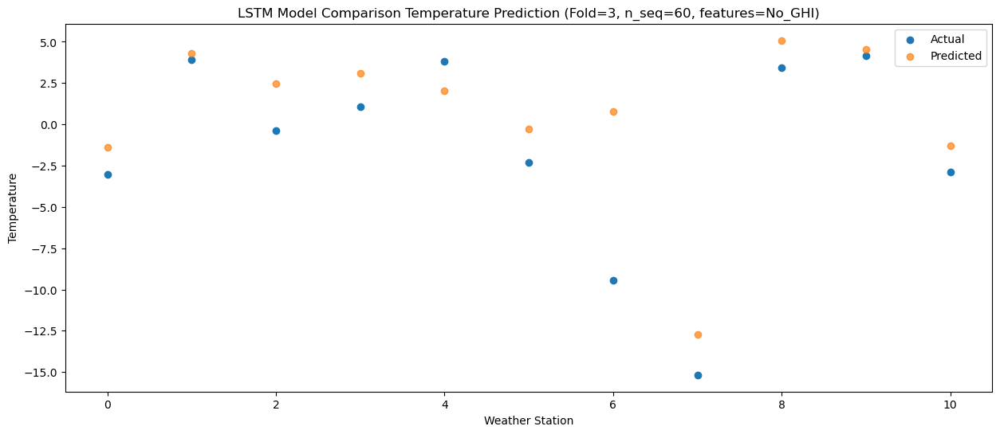

Predictions for (t+37):
    Weather_Station  Actual  Predicted
0                 0   -9.91  -7.897089
1                 1   -0.15  -2.162599
2                 2   -1.36  -4.018927
3                 3   -4.20  -3.406741
4                 4   -2.17  -4.445927
5                 5   -7.87  -6.777481
6                 6  -11.63  -5.686811
7                 7  -17.50 -19.212099
8                 8    2.22  -1.405815
9                 9   -2.19  -1.936514
10               10   -9.90  -7.771668


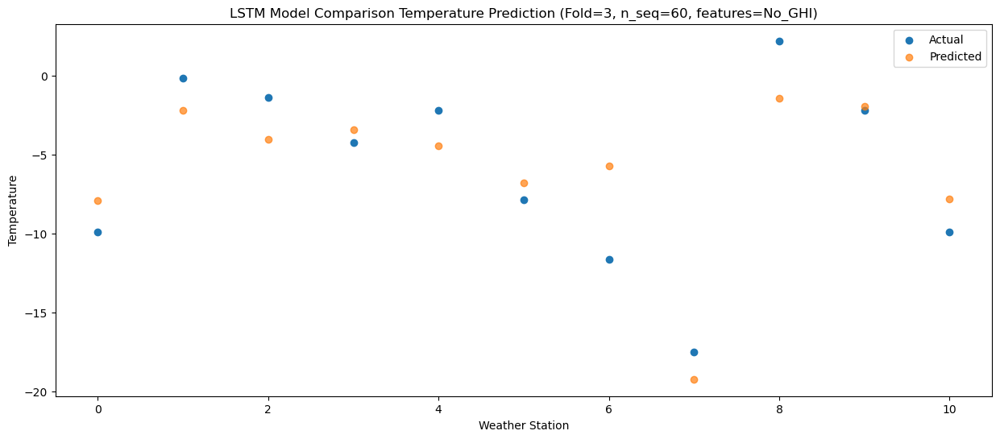

Predictions for (t+38):
    Weather_Station  Actual  Predicted
0                 0   -6.49  -5.727535
1                 1    0.55   0.015231
2                 2    0.03  -1.844606
3                 3   -2.45  -1.235534
4                 4   -0.45  -2.265872
5                 5   -5.73  -4.598631
6                 6  -12.36  -3.511188
7                 7  -18.01 -17.041154
8                 8    3.89   0.764786
9                 9   -0.21   0.227803
10               10   -7.25  -5.607553


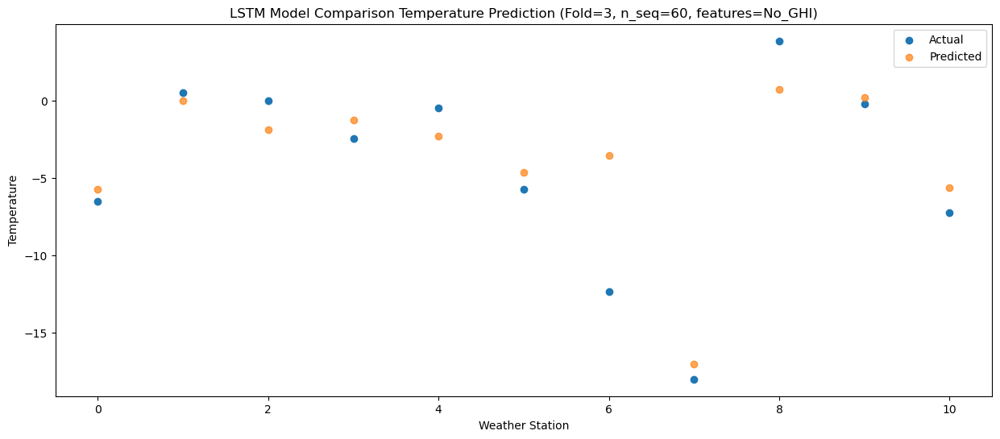

Predictions for (t+39):
    Weather_Station  Actual  Predicted
0                 0   -3.67  -5.542394
1                 1    2.51   0.197788
2                 2   -0.82  -1.655462
3                 3   -0.11  -1.055084
4                 4    6.07  -2.090145
5                 5   -4.01  -4.427174
6                 6  -12.33  -3.331687
7                 7  -17.10 -16.858597
8                 8    2.09   0.957390
9                 9   -1.94   0.412858
10               10   -7.04  -5.431137


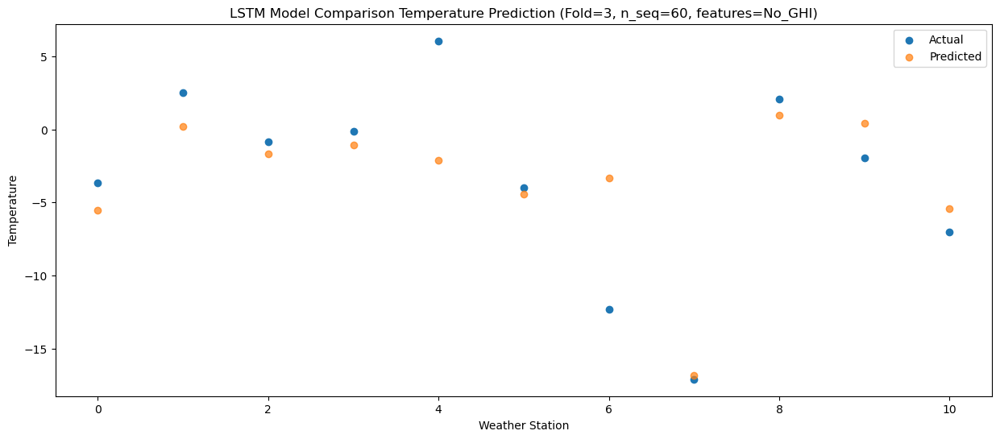

Predictions for (t+40):
    Weather_Station  Actual  Predicted
0                 0   -3.20  -4.036107
1                 1    5.11   1.706708
2                 2    2.05  -0.141381
3                 3    0.13   0.448891
4                 4    3.11  -0.585318
5                 5   -3.11  -2.922611
6                 6  -10.54  -1.823774
7                 7  -14.27 -15.344422
8                 8    3.55   2.472477
9                 9    0.03   1.917438
10               10   -5.48  -3.932724


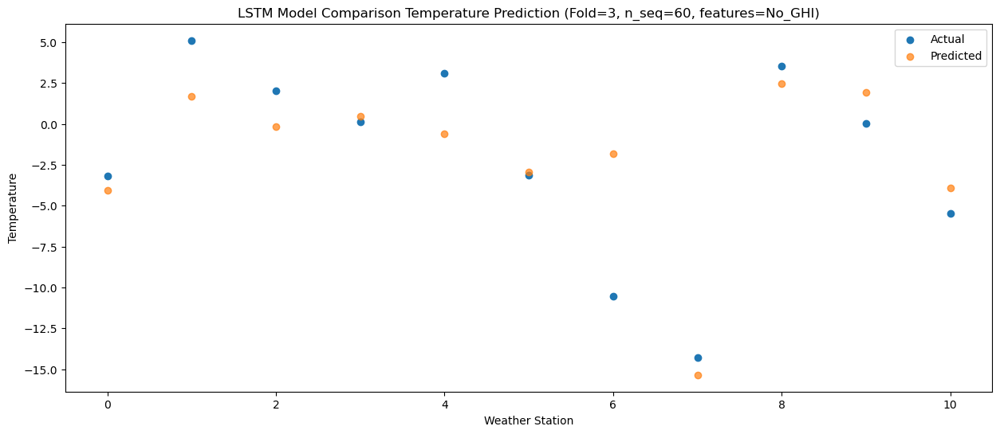

Predictions for (t+41):
    Weather_Station  Actual  Predicted
0                 0    0.47   2.257184
1                 1   10.16   7.999344
2                 2    7.68   6.147043
3                 3    6.37   6.744416
4                 4   10.32   5.711654
5                 5    3.12   3.378528
6                 6   -5.20   4.472480
7                 7   -6.32  -9.050621
8                 8    7.63   8.766326
9                 9    6.08   8.220251
10               10    2.09   2.373816


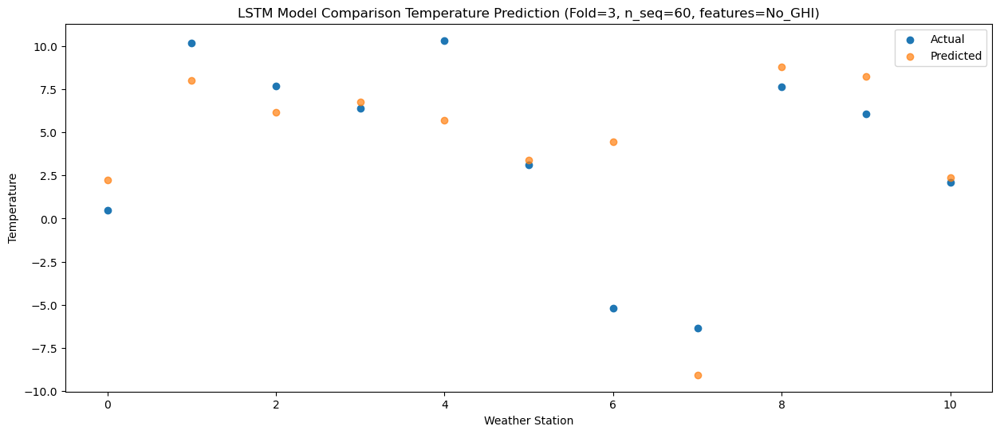

Predictions for (t+42):
    Weather_Station  Actual  Predicted
0                 0    2.83   5.517646
1                 1   15.47  11.268222
2                 2   12.12   9.411572
3                 3    9.06  10.011429
4                 4   16.32   8.987530
5                 5    8.53   6.657677
6                 6    2.01   7.749038
7                 7   -0.52  -5.779141
8                 8    8.66  12.038511
9                 9    9.72  11.489758
10               10    4.56   5.636136


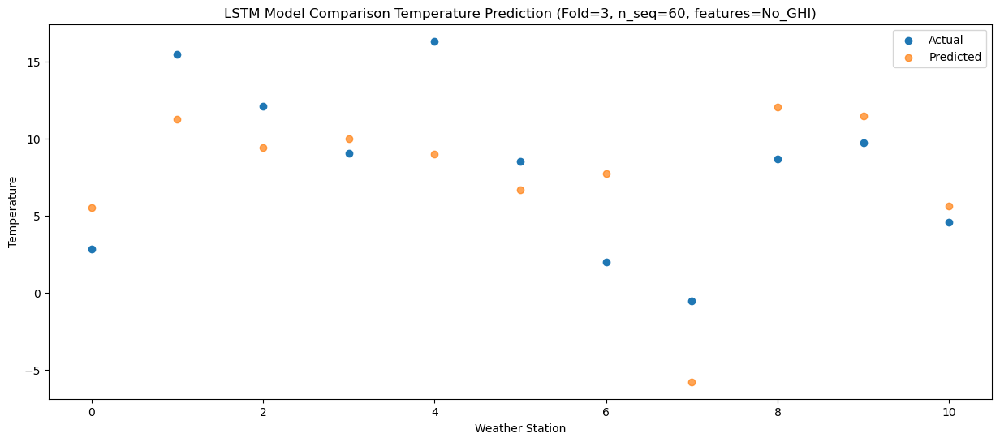

Predictions for (t+43):
    Weather_Station  Actual  Predicted
0                 0    6.60   9.658516
1                 1   19.80  15.414932
2                 2   14.92  13.555103
3                 3   12.80  14.160979
4                 4   20.42  13.140193
5                 5   11.99  10.811848
6                 6    6.59  11.900967
7                 7    1.98  -1.633162
8                 8   10.56  16.181393
9                 9   13.71  15.640205
10               10    8.49   9.788199


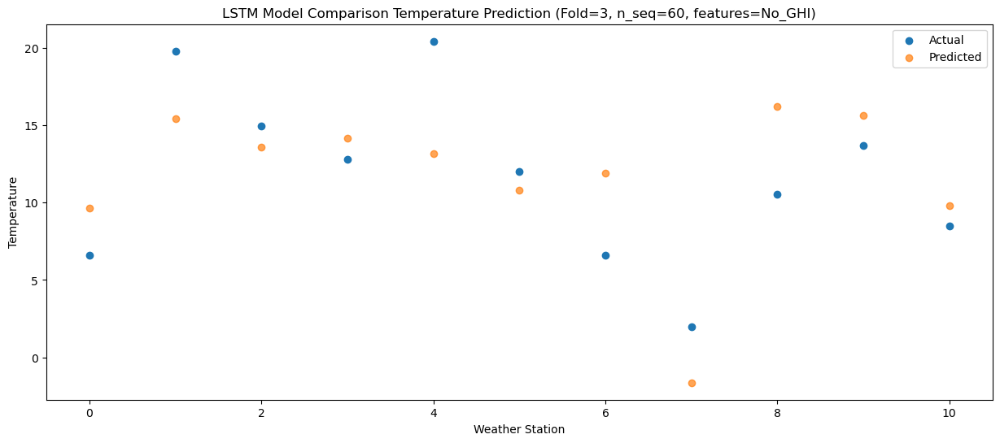

Predictions for (t+44):
    Weather_Station  Actual  Predicted
0                 0   10.38  14.084646
1                 1   22.06  19.836234
2                 2   20.58  17.985196
3                 3   16.42  18.585663
4                 4   22.12  17.560888
5                 5   15.25  15.230933
6                 6   12.73  16.323520
7                 7   10.34   2.798699
8                 8   13.57  20.610383
9                 9   19.39  20.071613
10               10   13.33  14.222422


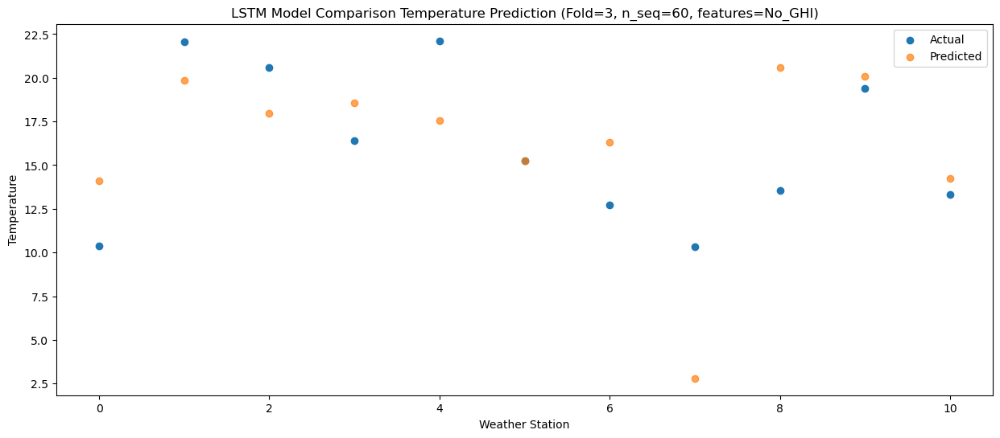

Predictions for (t+45):
    Weather_Station  Actual  Predicted
0                 0    9.87  12.597420
1                 1   22.24  18.345753
2                 2   18.89  16.495912
3                 3   15.31  17.099826
4                 4   20.83  16.072267
5                 5   13.70  13.744188
6                 6   10.14  14.838956
7                 7    5.71   1.316455
8                 8   14.60  19.133813
9                 9   17.14  18.591792
10               10   11.36  12.744554


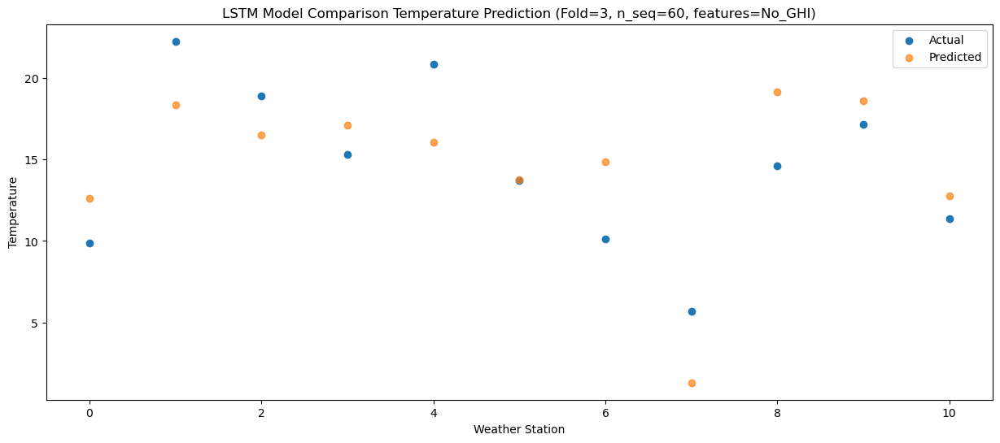

Predictions for (t+46):
    Weather_Station  Actual  Predicted
0                 0    5.73   9.600506
1                 1   18.19  15.350138
2                 2   15.12  13.506946
3                 3   12.58  14.107727
4                 4   17.47  13.078552
5                 5   10.24  10.754184
6                 6    5.99  11.847346
7                 7    1.01  -1.671606
8                 8   11.99  16.143541
9                 9   14.57  15.597419
10               10    8.07   9.747469


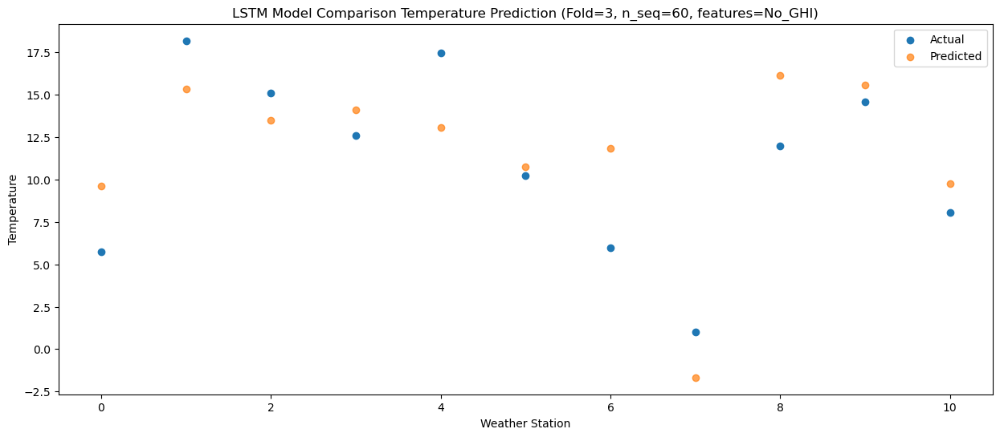

Predictions for (t+47):
    Weather_Station  Actual  Predicted
0                 0    0.70   4.067170
1                 1   11.25   9.819968
2                 2    9.81   7.973452
3                 3    7.14   8.575249
4                 4   11.01   7.553768
5                 5    4.59   5.230547
6                 6   -0.14   6.315598
7                 7   -4.28  -7.213197
8                 8   10.53  10.602427
9                 9    9.14  10.056064
10               10    2.78   4.208859


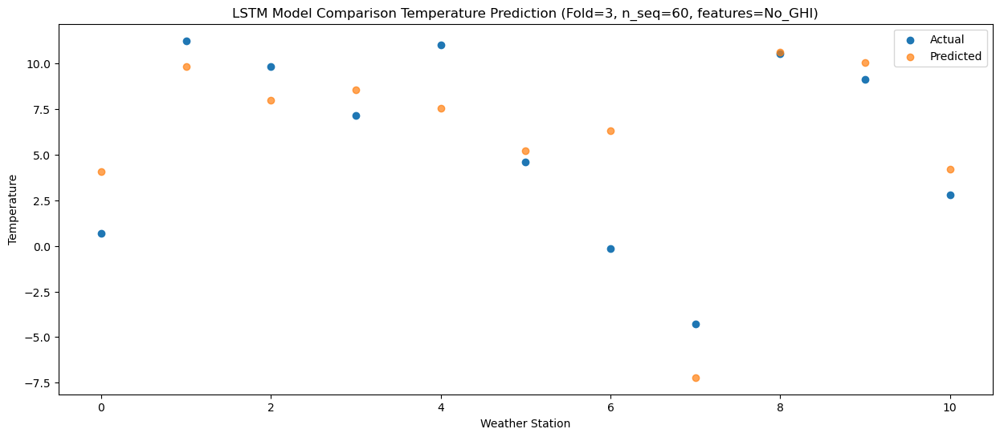

Predictions for (t+48):
    Weather_Station  Actual  Predicted
0                 0   -4.96  -3.562772
1                 1    5.47   2.195477
2                 2    2.90   0.350411
3                 3    0.75   0.948709
4                 4    4.06  -0.071132
5                 5   -1.89  -2.392412
6                 6   -6.00  -1.305740
7                 7  -12.42 -14.836668
8                 8    6.49   2.977624
9                 9    1.29   2.425877
10               10   -5.49  -3.422910


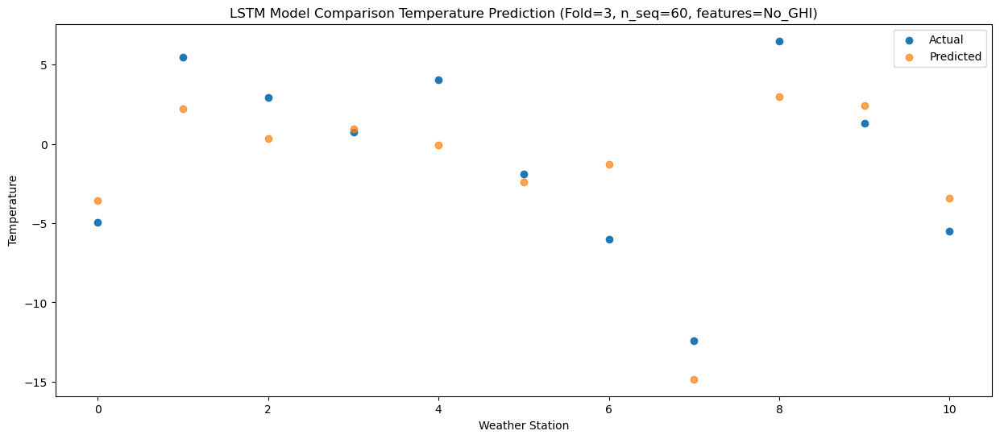

Predictions for (t+49):
    Weather_Station  Actual  Predicted
0                 0   -7.01  -5.045252
1                 1    2.12   0.717103
2                 2    1.06  -1.127344
3                 3   -1.08  -0.535924
4                 4    1.25  -1.552608
5                 5   -4.35  -3.877608
6                 6   -9.63  -2.784379
7                 7  -15.55 -16.311121
8                 8    4.65   1.503724
9                 9    0.56   0.946548
10               10   -6.24  -4.907395


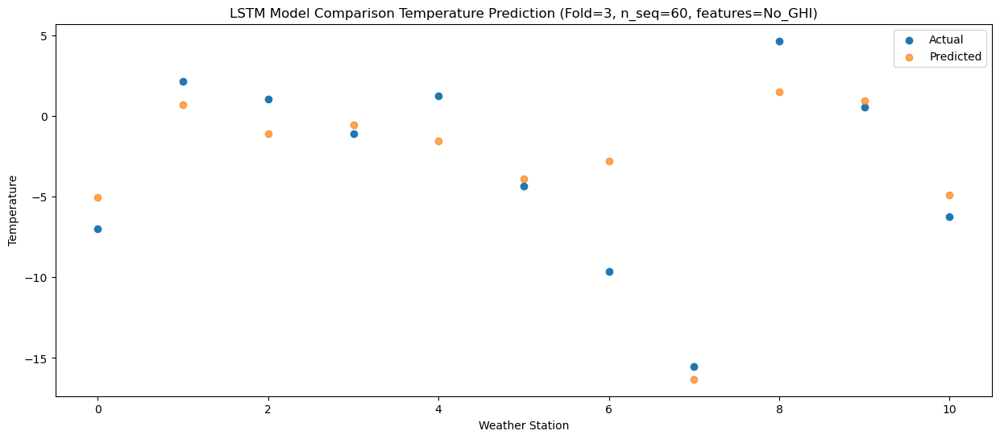

Predictions for (t+50):
    Weather_Station  Actual  Predicted
0                 0   -9.32  -8.937439
1                 1   -4.49  -3.185271
2                 2    0.85  -5.020162
3                 3   -6.24  -4.430123
4                 4   -5.25  -5.462099
5                 5  -10.51  -7.787447
6                 6  -11.77  -6.688059
7                 7  -17.27 -20.205408
8                 8    4.96  -2.381456
9                 9   -3.43  -2.941345
10               10   -9.26  -8.796074


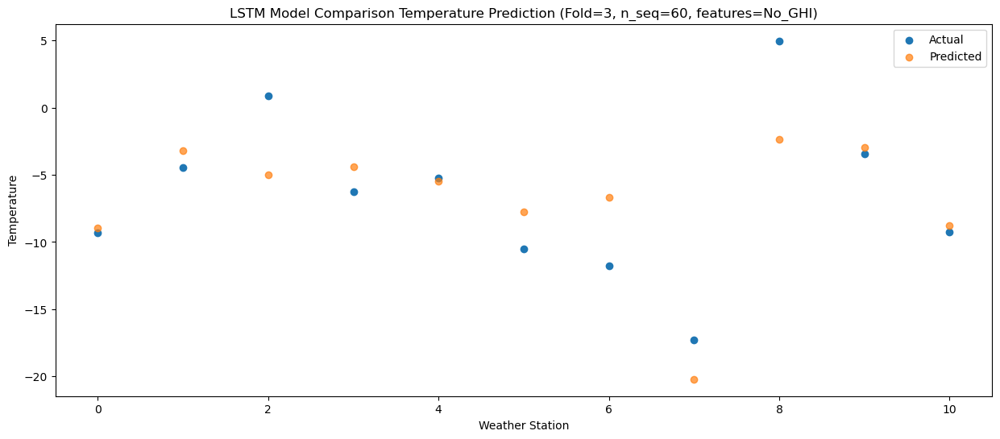

Predictions for (t+51):
    Weather_Station  Actual  Predicted
0                 0   -6.18  -6.106650
1                 1    5.16  -0.340473
2                 2    2.34  -2.175829
3                 3   -0.56  -1.588419
4                 4    2.56  -2.613368
5                 5   -3.88  -4.939366
6                 6   -9.61  -3.843491
7                 7  -14.91 -17.359829
8                 8    4.67   0.460171
9                 9   -2.86  -0.102911
10               10   -7.22  -5.958451


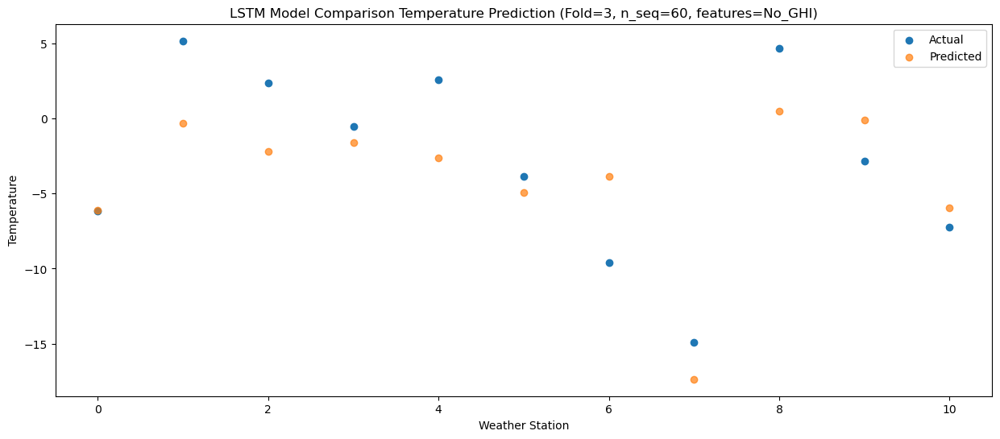

Predictions for (t+52):
    Weather_Station  Actual  Predicted
0                 0   -2.51  -2.043355
1                 1    7.64   3.724861
2                 2    4.37   1.889844
3                 3    3.09   2.478233
4                 4    6.67   1.453221
5                 5    0.19  -0.873197
6                 6   -7.87   0.222824
7                 7  -11.55 -13.293889
8                 8    5.60   4.527585
9                 9    1.84   3.955581
10               10   -2.56  -1.901127


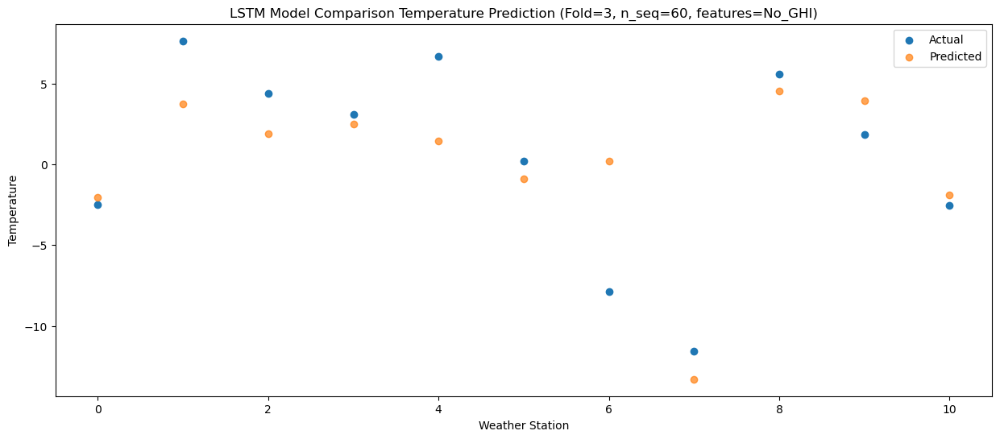

Predictions for (t+53):
    Weather_Station  Actual  Predicted
0                 0    1.51   2.510994
1                 1   11.81   8.278786
2                 2    7.56   6.439802
3                 3    8.15   7.036083
4                 4   11.42   6.011061
5                 5    5.16   3.689595
6                 6   -2.89   4.784622
7                 7   -6.05  -8.737056
8                 8    7.83   9.082214
9                 9    4.71   8.518921
10               10    2.02   2.665136


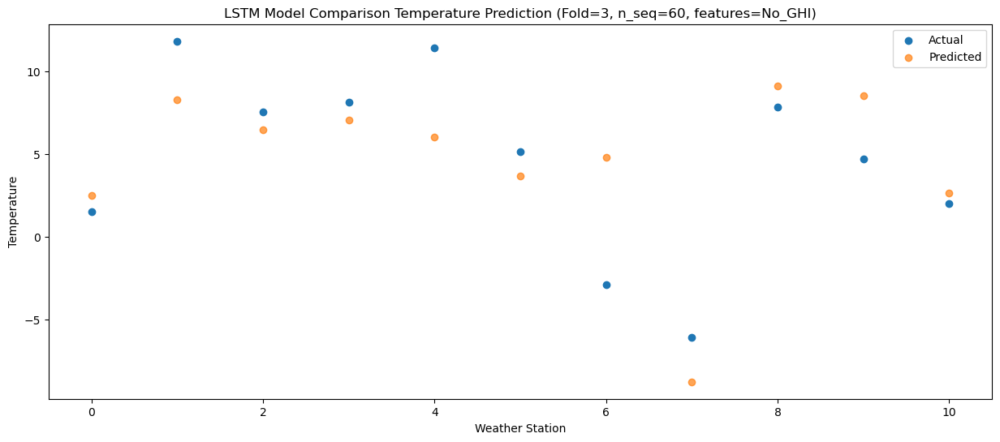

Predictions for (t+54):
    Weather_Station  Actual  Predicted
0                 0    5.78   8.337326
1                 1   16.58  14.102754
2                 2   12.95  12.257553
3                 3   12.34  12.868518
4                 4   17.58  11.840709
5                 5   10.68   9.524311
6                 6    0.22  10.612190
7                 7   -0.42  -2.909615
8                 8   10.80  14.900225
9                 9   10.26  14.351337
10               10    7.69   8.503827


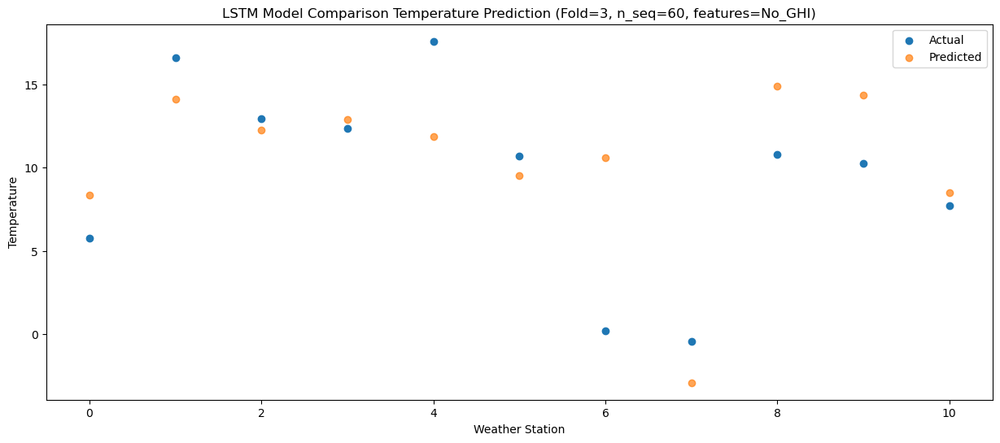

Predictions for (t+55):
    Weather_Station  Actual  Predicted
0                 0    9.44  13.295626
1                 1   21.14  19.062758
2                 2   18.90  17.216316
3                 3   16.24  17.824139
4                 4   22.45  16.801315
5                 5   13.91  14.482872
6                 6    9.37  15.572721
7                 7    7.76   2.054022
8                 8   13.71  19.855658
9                 9   16.73  19.310596
10               10   13.06  13.467996


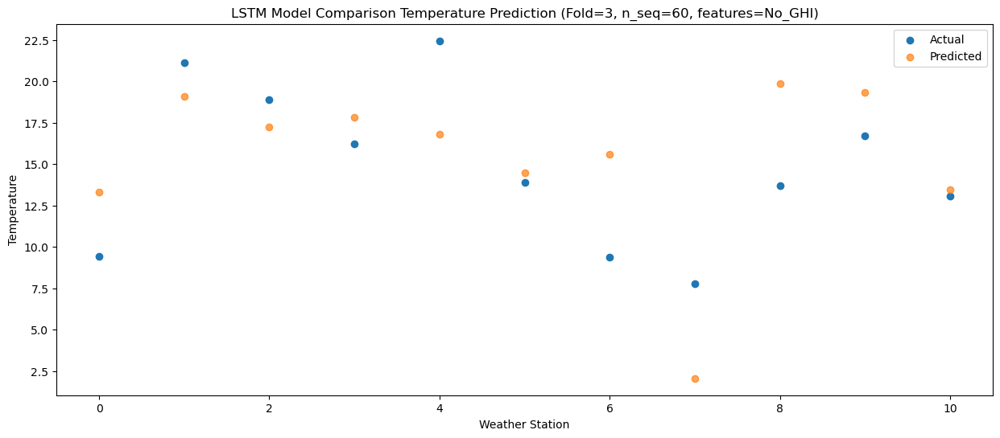

Predictions for (t+56):
    Weather_Station  Actual  Predicted
0                 0   10.33  15.082667
1                 1   21.66  20.845560
2                 2   22.47  19.004477
3                 3   17.95  19.609132
4                 4   21.61  18.581821
5                 5   14.46  16.262561
6                 6   10.12  17.356312
7                 7   10.84   3.842778
8                 8   14.97  21.647171
9                 9   19.29  21.103756
10               10   15.72  15.260386


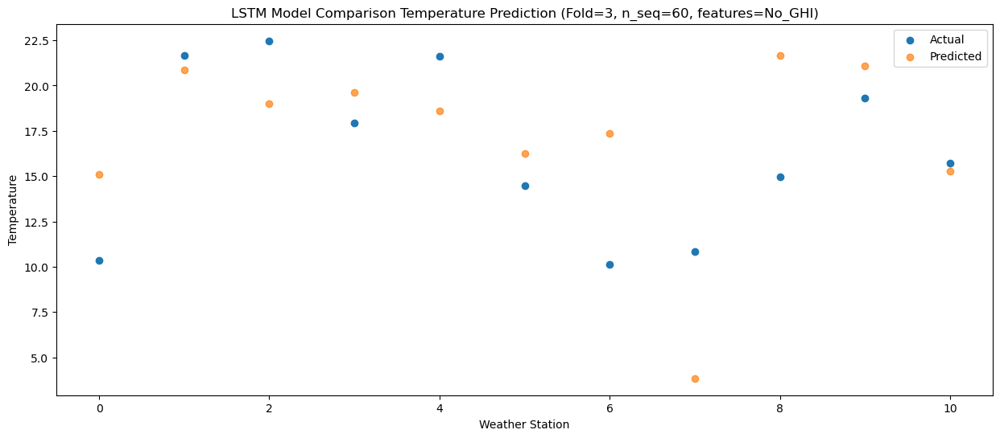

Predictions for (t+57):
    Weather_Station  Actual  Predicted
0                 0    8.93  13.209687
1                 1   21.94  18.969965
2                 2   19.50  17.130938
3                 3   16.93  17.735080
4                 4   21.06  16.712142
5                 5   13.91  14.394607
6                 6    9.83  15.487529
7                 7    7.98   1.971628
8                 8   13.69  19.772220
9                 9   17.57  19.229694
10               10   12.58  13.388269


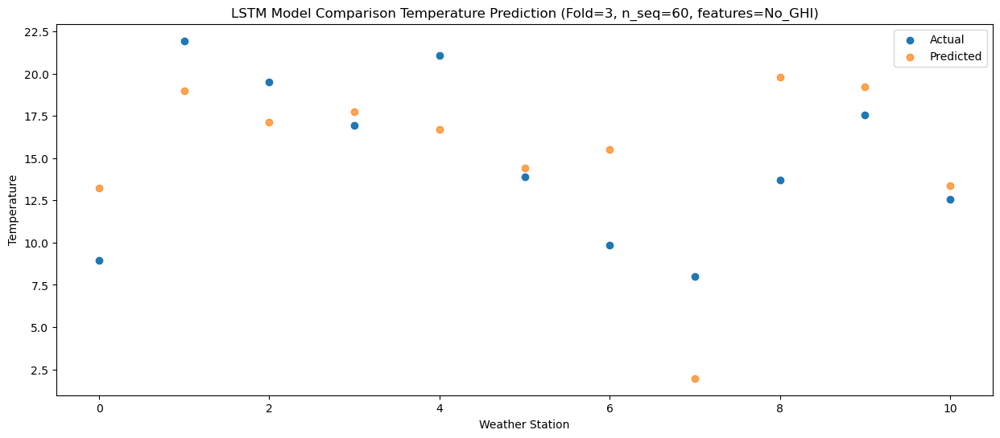

Predictions for (t+58):
    Weather_Station  Actual  Predicted
0                 0    6.24  10.126825
1                 1   17.90  15.889349
2                 2   16.47  14.049985
3                 3   13.96  14.657998
4                 4   17.80  13.639078
5                 5   11.22  11.320431
6                 6    6.21  12.407400
7                 7    4.03  -1.108404
8                 8   12.25  16.692226
9                 9   13.56  16.149823
10               10    8.99  10.304219


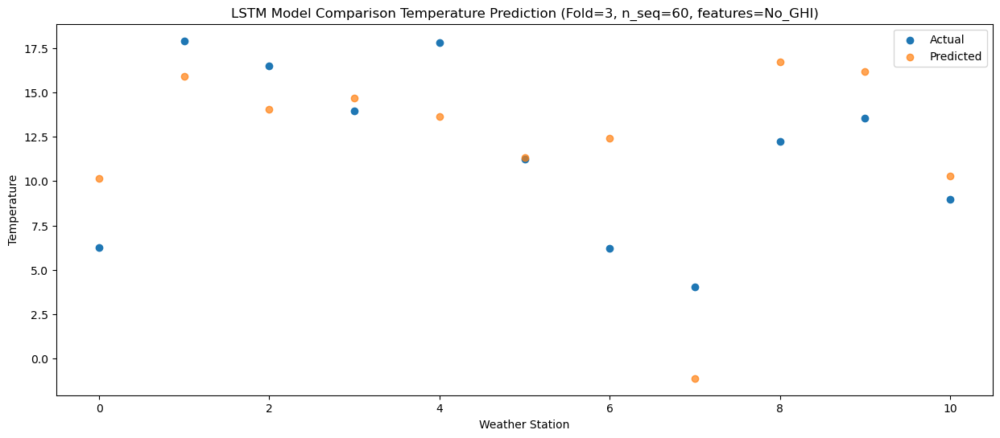

Predictions for (t+59):
    Weather_Station  Actual  Predicted
0                 0    0.93   4.856050
1                 1   14.51  10.619726
2                 2   11.44   8.780181
3                 3    7.46   9.382704
4                 4   12.17   8.367086
5                 5    5.34   6.043264
6                 6    1.98   7.135767
7                 7   -1.86  -6.380974
8                 8   11.79  11.422163
9                 9    9.03  10.878215
10               10    3.75   5.031774


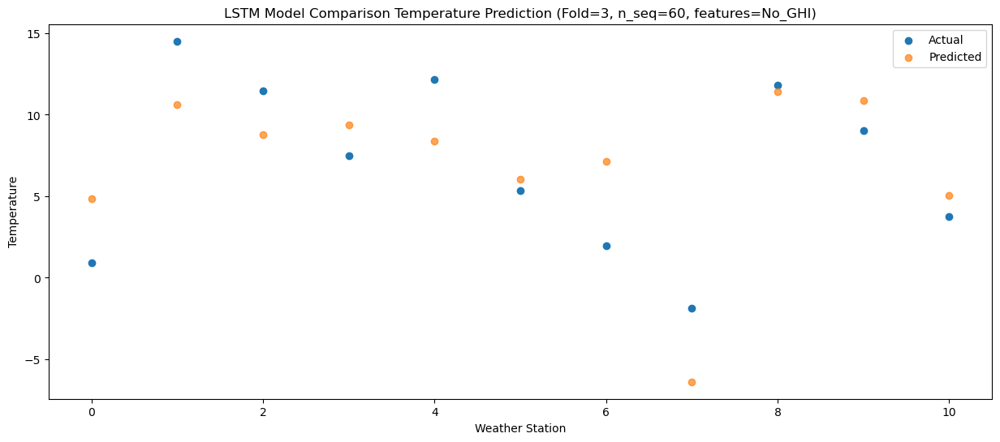

f, t:
[[-6.460e+00  2.220e+00  2.710e+00 -2.860e+00  3.310e+00 -5.820e+00
  -6.460e+00 -1.316e+01  5.280e+00  6.300e-01 -6.460e+00]
 [-7.240e+00  8.700e-01  1.800e-01 -2.850e+00  5.000e-02 -5.610e+00
  -1.213e+01 -1.789e+01  4.030e+00 -2.130e+00 -9.420e+00]
 [-7.660e+00  3.000e-02 -1.040e+00 -3.400e+00 -2.820e+00 -7.030e+00
  -1.222e+01 -1.673e+01  3.400e+00 -2.100e+00 -9.010e+00]
 [-6.650e+00  1.800e-01  1.380e+00 -3.750e+00 -1.670e+00 -7.440e+00
  -1.203e+01 -1.522e+01  5.420e+00 -1.660e+00 -8.090e+00]
 [-1.390e+00  7.670e+00  3.170e+00  3.160e+00  5.740e+00 -5.800e-01
  -7.100e+00 -1.211e+01  4.860e+00  1.920e+00 -3.680e+00]
 [-3.200e-01  8.590e+00  7.830e+00  3.800e+00  8.770e+00  1.690e+00
  -4.120e+00 -6.200e+00  8.480e+00  3.360e+00 -1.740e+00]
 [ 2.370e+00  1.299e+01  1.302e+01  8.370e+00  1.484e+01  7.100e+00
   2.990e+00  1.070e+00  1.088e+01  8.920e+00  4.030e+00]
 [ 7.690e+00  2.009e+01  1.637e+01  1.419e+01  2.189e+01  1.409e+01
   7.200e+00  4.530e+00  1.342e+01  1.590e+0

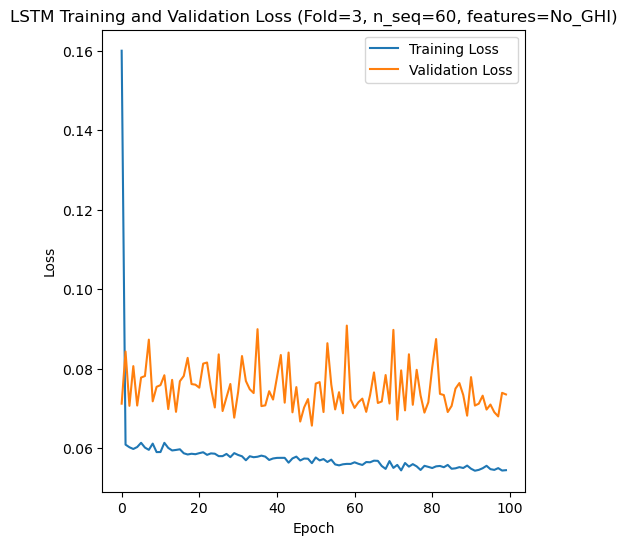

[[ 4.89  1.26  7.78 ... 22.59 18.46  9.82]
 [15.38 13.87 17.63 ... 26.66 22.89 20.2 ]
 [11.49  8.39 14.48 ... 24.97 20.83 17.82]
 ...
 [ 7.64  3.61 10.44 ... 21.3  17.62 11.34]
 [ 4.26  0.29  5.21 ... 21.47 15.54  9.34]
 [ 3.62 -0.32  6.05 ... 19.99 14.92  8.29]]
Epoch 1/100
84/84 [==============================] - 33s 145ms/step - loss: 0.1997 - accuracy: 0.2976 - mae: 0.1632 - rmse: 0.1997 - mape: inf - pearson: 0.5983 - val_loss: 0.0670 - val_accuracy: 0.6000 - val_mae: 0.0529 - val_rmse: 0.0670 - val_mape: 12.4263 - val_pearson: 0.8295
Epoch 2/100
84/84 [==============================] - 6s 77ms/step - loss: 0.0587 - accuracy: 0.4524 - mae: 0.0464 - rmse: 0.0587 - mape: inf - pearson: 0.8346 - val_loss: 0.0704 - val_accuracy: 0.6000 - val_mae: 0.0558 - val_rmse: 0.0704 - val_mape: 13.1452 - val_pearson: 0.8289
Epoch 3/100
84/84 [==============================] - 7s 80ms/step - loss: 0.0598 - accuracy: 0.4762 - mae: 0.0470 - rmse: 0.0598 - mape: inf - pearson: 0.8318 - val_loss: 0.0

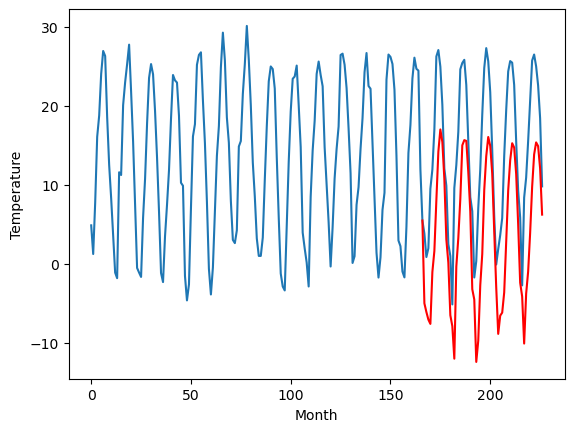

Weather Station 2:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-2.38		-3.72		-1.34
-2.56		-4.81		-2.25
-4.02		-5.77		-1.75
-2.47		-6.32		-3.85
1.60		0.24		-1.36
3.28		2.90		-0.38
4.68		9.31		4.63
6.44		15.44		9.00
6.76		18.26		11.50
6.61		16.68		10.07
6.03		12.02		5.99
4.53		4.36		-0.17
1.14		1.42		0.28
-6.61		-5.23		1.38
-5.91		-6.61		-0.70
-2.48		-10.74		-8.26
-0.88		0.90		1.78
0.56		4.52		3.96
4.60		9.45		4.85
6.23		16.24		10.01
6.60		16.90		10.30
6.88		16.80		9.92
5.59		12.85		7.26
3.75		7.90		4.15
-3.41		-1.97		1.44
-1.61		-3.27		-1.66
-6.37		-11.17		-4.80
-2.94		-8.48		-5.54
-0.12		-1.51		-1.39
2.22		2.44		0.22
5.04		10.55		5.51
6.76		14.82		8.06
7.13		17.25		10.12
7.08		16.14		9.06
5.64		12.62		6.98
1.81		5.32		3.51
0.35		-1.77		-2.12
-4.50		-7.66		-3.16
-4.65		-5.36		-0.71
-1.35		-4.97		-3.62
0.37		-2.43		-2.80
3.09		3.97		0.88
3.87		10.46		6.59
6.08		14.26		8.18
7.69		16.44		8.75
8.20		15.90		7.70
6.10		12.55		6.45
2.45		6.19		3.74
-1.26		-1.20	

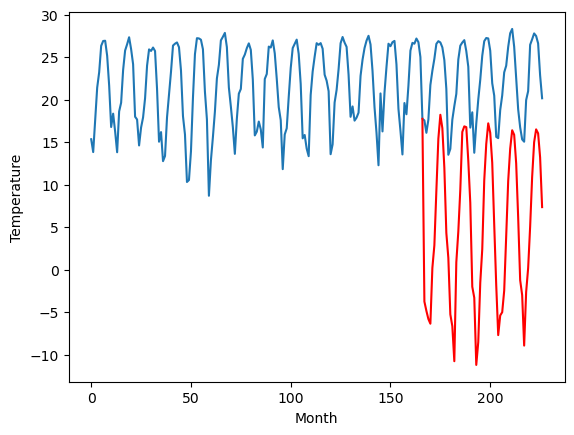

Weather Station 3:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
6.75		6.77		0.02
6.81		5.68		-1.13
6.62		4.72		-1.90
6.88		4.18		-2.70
14.68		10.75		-3.93
13.73		13.41		-0.32
17.61		19.82		2.21
21.70		25.95		4.25
23.27		28.77		5.50
22.44		27.19		4.75
20.34		22.53		2.19
15.00		14.86		-0.14
11.00		11.93		0.93
4.75		5.29		0.54
4.78		3.90		-0.88
2.86		-0.22		-3.08
12.19		11.43		-0.76
13.26		15.05		1.79
17.73		19.98		2.25
21.99		26.77		4.78
22.65		27.43		4.78
23.30		27.33		4.03
20.18		23.39		3.21
16.79		18.43		1.64
8.12		8.56		0.44
11.63		7.27		-4.36
3.35		-0.63		-3.98
5.71		2.06		-3.65
10.45		9.04		-1.41
14.66		12.98		-1.68
20.46		21.09		0.63
23.75		25.37		1.62
23.95		27.80		3.85
22.41		26.68		4.27
20.34		23.17		2.83
14.21		15.87		1.66
9.62		8.78		-0.84
7.19		2.88		-4.31
7.60		5.19		-2.41
9.54		5.58		-3.96
11.69		8.13		-3.56
13.44		14.52		1.08
18.30		21.02		2.72
21.89		24.83		2.94
23.67		27.00		3.33
25.75		26.46		0.71
22.00		23.11		1.11
15.89		16.75		0.86
8.9

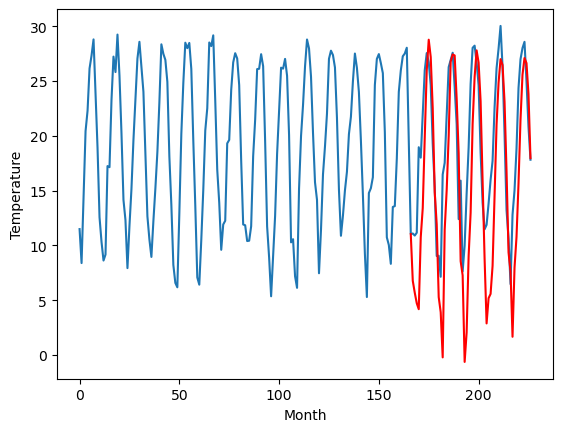

Weather Station 4:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
4.23		2.89		-1.34
2.58		1.80		-0.78
2.82		0.84		-1.98
2.49		0.30		-2.19
9.95		6.88		-3.07
10.61		9.54		-1.07
15.74		15.96		0.22
20.70		22.10		1.40
22.56		24.91		2.35
22.31		23.33		1.02
16.53		18.66		2.13
10.80		11.00		0.20
8.19		8.07		-0.12
1.91		1.43		-0.48
0.99		0.05		-0.94
-2.47		-4.07		-1.60
8.49		7.58		-0.91
10.18		11.20		1.02
14.34		16.14		1.80
20.02		22.93		2.91
21.61		23.59		1.98
21.98		23.50		1.52
19.19		19.56		0.37
14.54		14.60		0.06
6.54		4.73		-1.81
8.54		3.45		-5.09
0.07		-4.45		-4.52
0.33		-1.76		-2.09
6.51		5.22		-1.29
12.56		9.17		-3.39
17.27		17.29		0.02
21.82		21.56		-0.26
25.12		24.00		-1.12
22.39		22.88		0.49
18.96		19.38		0.42
12.09		12.08		-0.01
5.04		4.99		-0.05
2.35		-0.91		-3.26
3.34		1.40		-1.94
3.40		1.79		-1.61
7.93		4.35		-3.58
10.53		10.75		0.22
16.21		17.25		1.04
20.40		21.06		0.66
22.95		23.23		0.28
25.50		22.69		-2.81
20.80		19.35		-1.45
12.67		12.98		0.31
6.6

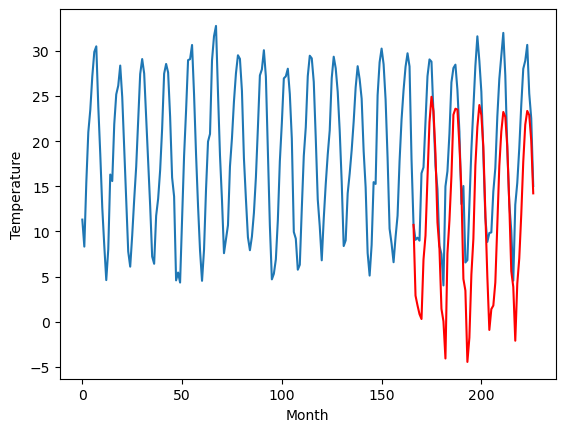

Weather Station 5:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
3.65		2.72		-0.93
1.87		1.63		-0.24
2.49		0.67		-1.82
2.11		0.13		-1.98
9.99		6.71		-3.28
10.68		9.37		-1.31
16.33		15.79		-0.54
21.04		21.93		0.89
23.48		24.74		1.26
22.80		23.15		0.35
16.50		18.49		1.99
10.75		10.84		0.09
7.99		7.90		-0.09
1.42		1.26		-0.16
0.82		-0.12		-0.94
-3.07		-4.24		-1.17
7.85		7.42		-0.43
10.03		11.04		1.01
13.56		15.97		2.41
20.41		22.77		2.36
21.90		23.43		1.53
22.27		23.34		1.07
18.84		19.40		0.56
13.97		14.44		0.47
6.13		4.58		-1.55
7.87		3.29		-4.58
-1.03		-4.61		-3.58
-0.41		-1.91		-1.50
6.51		5.07		-1.44
13.20		9.02		-4.18
18.03		17.14		-0.89
22.70		21.41		-1.29
26.12		23.85		-2.27
23.28		22.73		-0.55
19.19		19.23		0.04
12.04		11.94		-0.10
4.95		4.84		-0.11
1.98		-1.05		-3.03
2.75		1.26		-1.49
2.98		1.66		-1.32
7.83		4.21		-3.62
10.48		10.62		0.14
16.64		17.13		0.49
21.75		20.93		-0.82
24.83		23.10		-1.73
26.70		22.56		-4.14
21.61		19.23		-2.38
12.78		12.86		

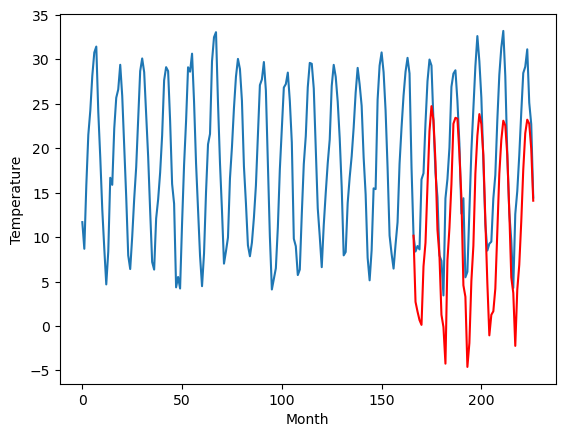

Weather Station 6:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
5.12		3.10		-2.02
3.48		2.01		-1.47
2.75		1.05		-1.70
1.99		0.51		-1.48
9.55		7.08		-2.47
12.52		9.74		-2.78
19.09		16.16		-2.93
22.42		22.30		-0.12
25.25		25.11		-0.14
24.63		23.54		-1.09
16.90		18.87		1.97
12.94		11.21		-1.73
9.06		8.28		-0.78
2.08		1.64		-0.44
0.98		0.26		-0.72
-0.59		-3.86		-3.27
8.66		7.79		-0.87
10.89		11.42		0.53
16.38		16.35		-0.03
21.34		23.14		1.80
21.08		23.81		2.73
21.40		23.71		2.31
20.71		19.78		-0.93
15.01		14.81		-0.20
8.07		4.95		-3.12
8.48		3.67		-4.81
1.11		-4.23		-5.34
0.91		-1.54		-2.45
8.23		5.44		-2.79
15.74		9.40		-6.34
21.43		17.51		-3.92
23.80		21.78		-2.02
25.70		24.22		-1.48
22.40		23.11		0.71
19.50		19.61		0.11
12.69		12.32		-0.37
4.84		5.22		0.38
3.24		-0.67		-3.91
3.61		1.65		-1.96
3.78		2.05		-1.73
8.85		4.60		-4.25
13.07		11.01		-2.06
17.99		17.52		-0.47
24.47		21.34		-3.13
25.93		23.51		-2.42
26.02		22.97		-3.05
22.54		19.64		-2.90
14.01		13.

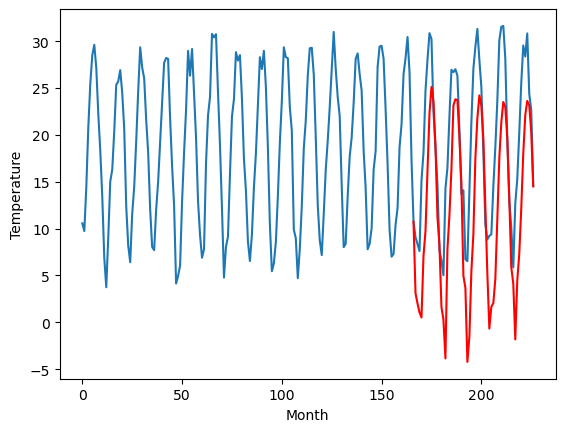

Weather Station 7:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
0.86		1.96		1.10
0.51		0.87		0.36
0.34		-0.09		-0.43
0.81		-0.63		-1.44
6.42		5.94		-0.48
7.69		8.59		0.90
10.48		15.01		4.53
15.07		21.14		6.07
18.11		23.96		5.85
16.91		22.38		5.47
13.11		17.72		4.61
9.29		10.05		0.76
4.98		7.13		2.15
-2.27		0.47		2.74
-2.04		-0.91		1.13
-1.37		-5.03		-3.66
5.03		6.63		1.60
7.76		10.25		2.49
11.21		15.18		3.97
15.23		21.97		6.74
16.97		22.64		5.67
17.10		22.55		5.45
13.13		18.61		5.48
9.33		13.65		4.32
1.17		3.78		2.61
3.08		2.49		-0.59
-2.98		-5.41		-2.43
1.30		-2.72		-4.02
4.86		4.26		-0.60
7.52		8.21		0.69
13.50		16.31		2.81
16.71		20.58		3.87
17.98		23.02		5.04
16.46		21.91		5.45
13.37		18.40		5.03
6.50		11.10		4.60
3.80		4.01		0.21
-2.15		-1.89		0.26
0.87		0.42		-0.45
4.29		0.82		-3.47
4.77		3.36		-1.41
7.88		9.76		1.88
10.50		16.26		5.76
14.14		20.07		5.93
18.01		22.24		4.23
17.45		21.71		4.26
13.61		18.36		4.75
8.17		11.99		3.82
2.44		4.60		2.16
0.23

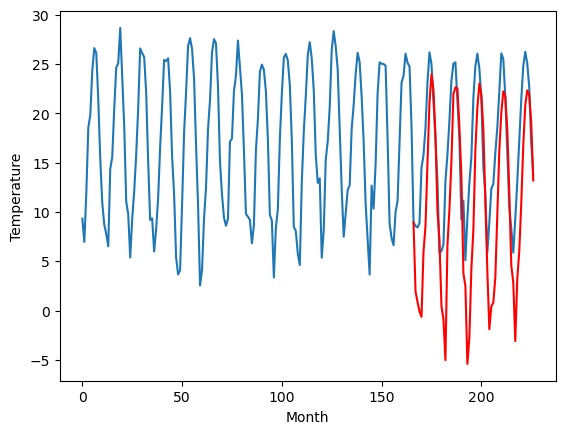

Weather Station 8:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
2.01		0.72		-1.29
1.20		-0.37		-1.57
-0.45		-1.32		-0.87
0.12		-1.87		-1.99
7.05		4.71		-2.34
8.63		7.36		-1.27
12.73		13.78		1.05
19.08		19.92		0.84
21.62		22.74		1.12
19.63		21.15		1.52
16.05		16.49		0.44
9.12		8.83		-0.29
6.57		5.90		-0.67
0.04		-0.75		-0.79
-1.63		-2.13		-0.50
-5.24		-6.25		-1.01
7.03		5.41		-1.62
8.93		9.03		0.10
12.97		13.97		1.00
19.27		20.76		1.49
20.56		21.43		0.87
21.08		21.34		0.26
18.04		17.40		-0.64
12.27		12.43		0.16
4.33		2.57		-1.76
5.79		1.29		-4.50
-3.28		-6.62		-3.34
-1.22		-3.93		-2.71
5.44		3.06		-2.38
9.30		7.01		-2.29
14.97		15.12		0.15
20.29		19.39		-0.90
23.99		21.83		-2.16
20.47		20.72		0.25
16.88		17.21		0.33
10.51		9.91		-0.60
3.96		2.82		-1.14
-0.89		-3.08		-2.19
0.76		-0.77		-1.53
2.90		-0.37		-3.27
4.62		2.18		-2.44
10.24		8.59		-1.65
15.02		15.09		0.07
19.10		18.90		-0.20
21.06		21.07		0.01
20.87		20.53		-0.34
16.93		17.19		0.26
11.03		10.82		-

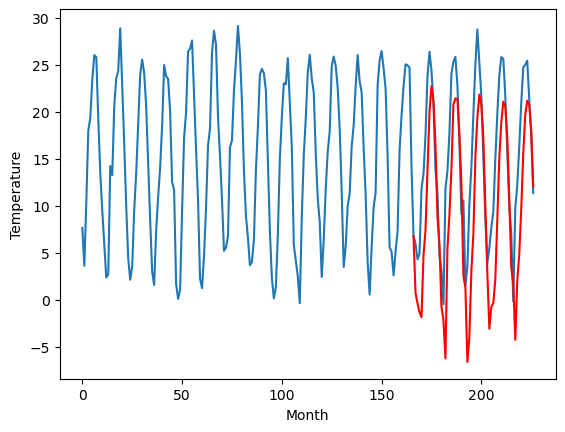

Weather Station 9:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-2.64		-0.97		1.67
-3.46		-2.06		1.40
-4.39		-3.02		1.37
-5.22		-3.56		1.66
1.60		3.02		1.42
4.59		5.67		1.08
10.17		12.09		1.92
17.46		18.23		0.77
19.50		21.05		1.55
17.30		19.46		2.16
13.54		14.80		1.26
6.70		7.13		0.43
2.86		4.21		1.35
-4.65		-2.46		2.19
-6.23		-3.84		2.39
-9.59		-7.95		1.64
2.38		3.71		1.33
6.03		7.33		1.30
10.44		12.26		1.82
17.68		19.06		1.38
18.25		19.73		1.48
19.11		19.64		0.53
15.62		15.70		0.08
10.27		10.74		0.47
-0.59		0.87		1.46
-0.27		-0.42		-0.15
-9.11		-8.33		0.78
-6.09		-5.63		0.46
1.38		1.36		-0.02
5.16		5.31		0.15
13.66		13.43		-0.23
18.14		17.70		-0.44
20.08		20.13		0.05
17.85		19.02		1.17
13.94		15.51		1.57
6.45		8.20		1.75
0.66		1.12		0.46
-5.12		-4.79		0.33
-3.16		-2.49		0.67
-1.57		-2.08		-0.51
-0.30		0.47		0.77
6.20		6.87		0.67
11.91		13.36		1.45
15.79		17.18		1.39
18.52		19.35		0.83
17.36		18.80		1.44
14.27		15.45		1.18
8.13		9.08		0.95
1.06		1.69		0.

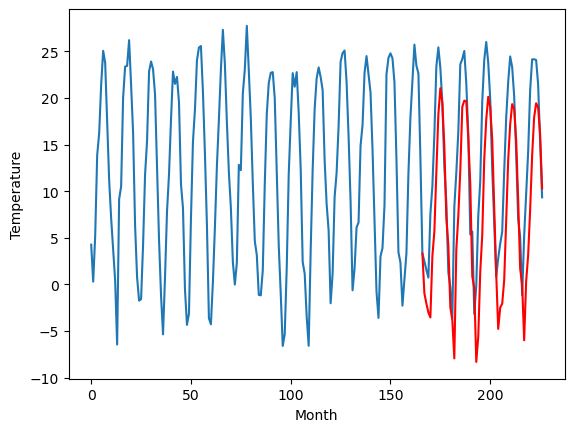

Weather Station 10:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-4.88		-4.35		0.53
-5.20		-5.44		-0.24
-7.64		-6.40		1.24
-7.89		-6.94		0.95
-0.29		-0.36		-0.07
2.82		2.29		-0.53
8.70		8.72		0.02
16.43		14.86		-1.57
17.64		17.69		0.05
15.04		16.09		1.05
11.14		11.43		0.29
3.80		3.75		-0.05
1.16		0.83		-0.33
-6.72		-5.84		0.88
-8.75		-7.22		1.53
-13.19		-11.34		1.85
0.67		0.33		-0.34
4.38		3.96		-0.42
9.16		8.89		-0.27
16.55		15.69		-0.86
16.26		16.36		0.10
16.54		16.27		-0.27
13.43		12.32		-1.11
7.97		7.36		-0.61
-2.34		-2.51		-0.17
-2.59		-3.80		-1.21
-12.07		-11.70		0.37
-9.24		-9.01		0.23
-1.03		-2.01		-0.98
3.09		1.94		-1.15
11.62		10.06		-1.56
16.23		14.33		-1.90
17.05		16.77		-0.28
15.75		15.66		-0.09
11.61		12.14		0.53
4.14		4.84		0.70
-1.40		-2.25		-0.85
-8.13		-8.15		-0.02
-5.89		-5.85		0.04
-4.70		-5.45		-0.75
-2.16		-2.89		-0.73
5.17		3.51		-1.66
10.93		10.00		-0.93
15.24		13.81		-1.43
16.77		15.98		-0.79
15.51		15.43		-0.08
12.47		12.09		-0.3

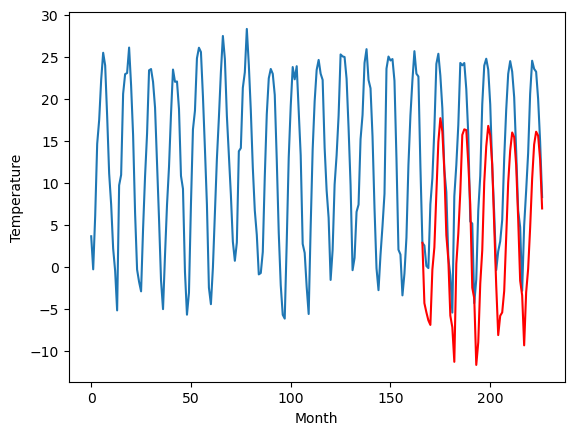

Weather Station 11:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-6.79		-5.00		1.79
-7.57		-6.08		1.49
-8.77		-7.04		1.73
-9.58		-7.58		2.00
-3.42		-1.00		2.42
-2.04		1.64		3.68
4.70		8.07		3.37
11.19		14.20		3.01
14.63		17.03		2.40
12.22		15.44		3.22
8.23		10.78		2.55
2.07		3.10		1.03
-1.16		0.17		1.33
-8.72		-6.50		2.22
-10.64		-7.88		2.76
-12.88		-11.99		0.89
-2.99		-0.33		2.66
0.81		3.29		2.48
5.34		8.23		2.89
12.23		15.03		2.80
12.39		15.70		3.31
13.59		15.61		2.02
9.30		11.66		2.36
5.77		6.70		0.93
-4.63		-3.17		1.46
-5.49		-4.47		1.02
-14.32		-12.37		1.95
-10.76		-9.67		1.09
-4.79		-2.68		2.11
-0.79		1.27		2.06
7.79		9.40		1.61
11.06		13.67		2.61
13.66		16.11		2.45
12.59		15.00		2.41
8.54		11.48		2.94
1.68		4.18		2.50
-2.40		-2.90		-0.50
-9.11		-8.81		0.30
-7.48		-6.52		0.96
-7.34		-6.12		1.22
-6.46		-3.56		2.90
2.01		2.84		0.83
5.70		9.33		3.63
10.01		13.14		3.13
13.10		15.31		2.21
11.77		14.75		2.98
9.43		11.41		1.98
4.17		5.04		0.87
-3.22		-2.35

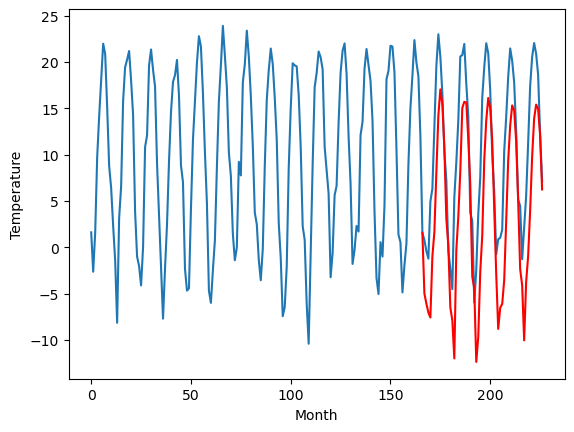

Predictions for (t+0):
    Weather_Station  Actual  Predicted
0                 0   -2.86  -4.981218
1                 1   -2.38  -3.718073
2                 2    6.75   6.772529
3                 3    4.23   2.890035
4                 4    3.65   2.716849
5                 5    5.12   3.099916
6                 6    0.86   1.959172
7                 7    2.01   0.721325
8                 8   -2.64  -0.968639
9                 9   -4.88  -4.349373
10               10   -6.79  -4.996784


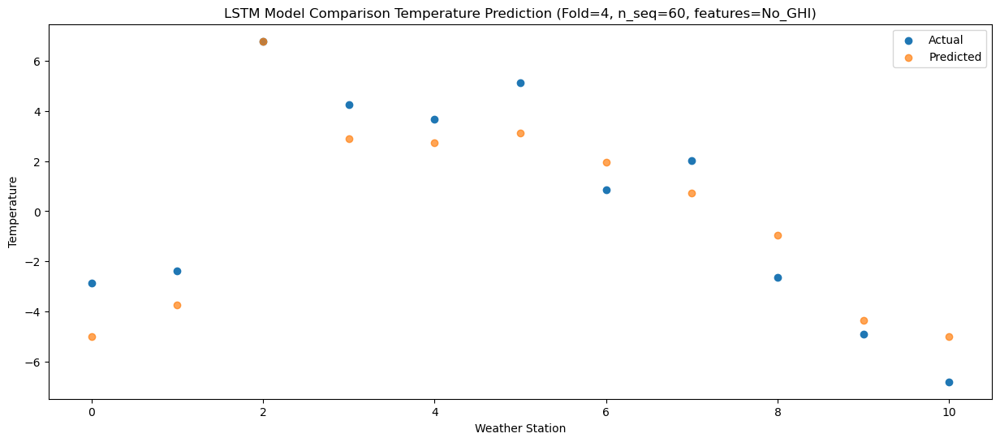

Predictions for (t+1):
    Weather_Station  Actual  Predicted
0                 0   -4.52  -6.081368
1                 1   -2.56  -4.811569
2                 2    6.81   5.684344
3                 3    2.58   1.802826
4                 4    1.87   1.626729
5                 5    3.48   2.006217
6                 6    0.51   0.869058
7                 7    1.20  -0.367829
8                 8   -3.46  -2.056878
9                 9   -5.20  -5.439074
10               10   -7.57  -6.082525


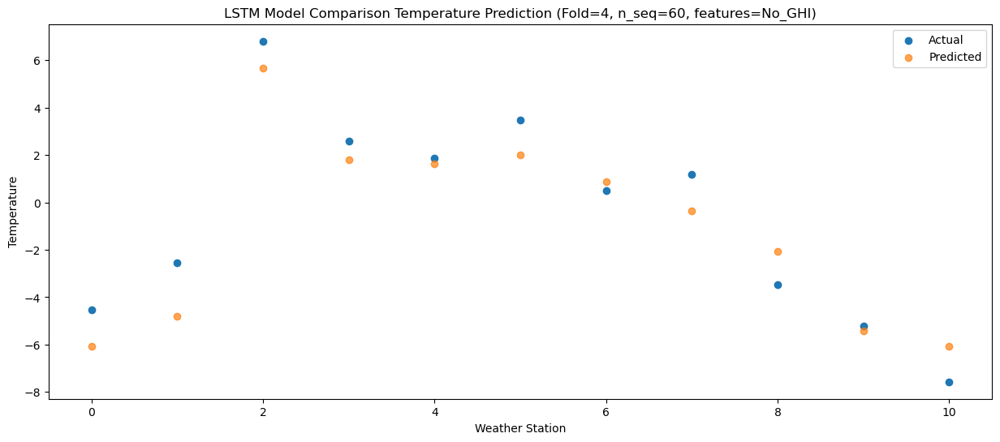

Predictions for (t+2):
    Weather_Station  Actual  Predicted
0                 0   -7.48  -7.041451
1                 1   -4.02  -5.772948
2                 2    6.62   4.724127
3                 3    2.82   0.842460
4                 4    2.49   0.666788
5                 5    2.75   1.048624
6                 6    0.34  -0.088554
7                 7   -0.45  -1.324139
8                 8   -4.39  -3.016907
9                 9   -7.64  -6.399095
10               10   -8.77  -7.038764


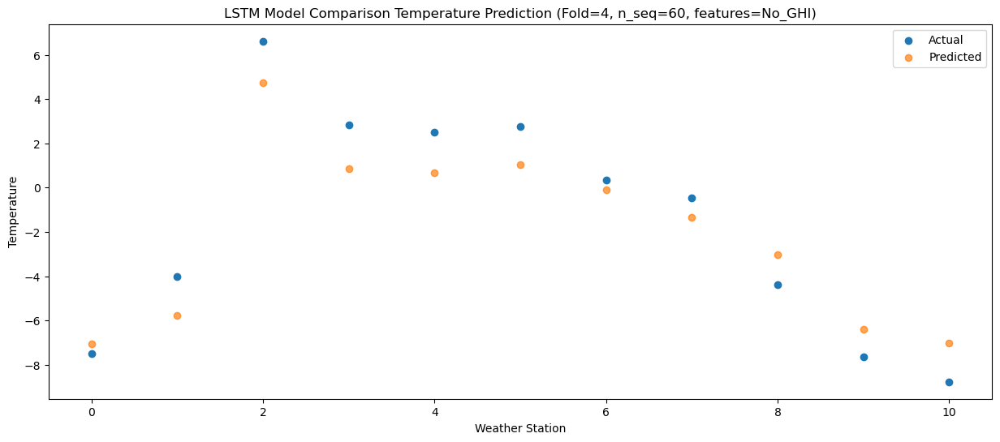

Predictions for (t+3):
    Weather_Station  Actual  Predicted
0                 0   -6.37  -7.584714
1                 1   -2.47  -6.322685
2                 2    6.88   4.179676
3                 3    2.49   0.300598
4                 4    2.11   0.125881
5                 5    1.99   0.509184
6                 6    0.81  -0.631893
7                 7    0.12  -1.866766
8                 8   -5.22  -3.559196
9                 9   -7.89  -6.940306
10               10   -9.58  -7.582900


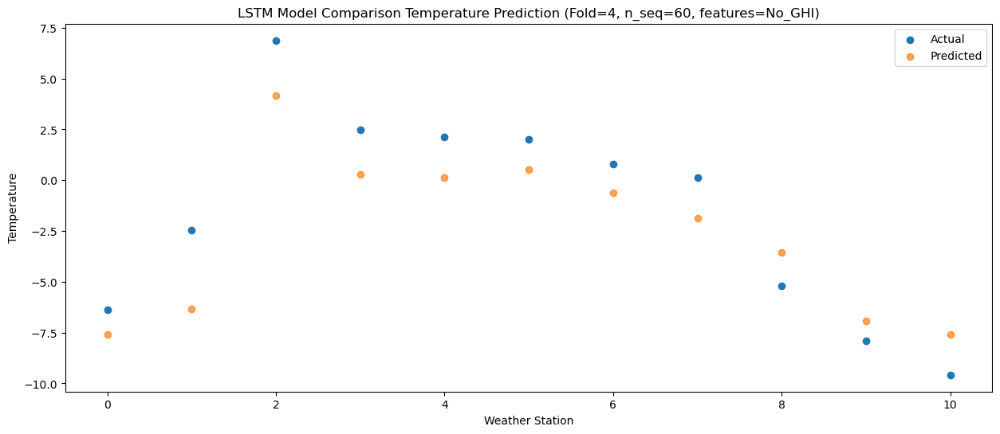

Predictions for (t+4):
    Weather_Station  Actual  Predicted
0                 0    1.16  -1.013851
1                 1    1.60   0.242160
2                 2   14.68  10.751369
3                 3    9.95   6.879154
4                 4    9.99   6.705915
5                 5    9.55   7.081882
6                 6    6.42   5.936460
7                 7    7.05   4.706220
8                 8    1.60   3.017492
9                 9   -0.29  -0.358993
10               10   -3.42  -1.003847


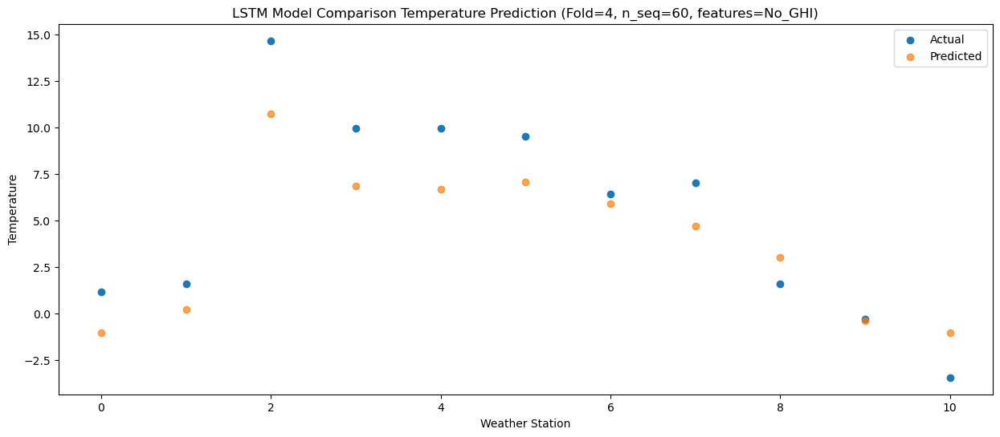

Predictions for (t+5):
    Weather_Station  Actual  Predicted
0                 0    3.59   1.643244
1                 1    3.28   2.900777
2                 2   13.73  13.405497
3                 3   10.61   9.538605
4                 4   10.68   9.367458
5                 5   12.52   9.742163
6                 6    7.69   8.591508
7                 7    8.63   7.361380
8                 8    4.59   5.669763
9                 9    2.82   2.294958
10               10   -2.04   1.644606


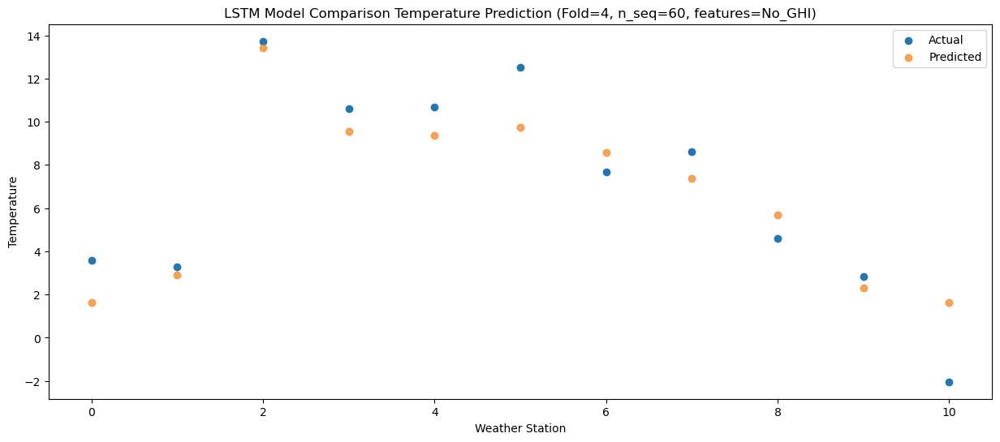

Predictions for (t+6):
    Weather_Station  Actual  Predicted
0                 0    8.66   8.067214
1                 1    4.68   9.313931
2                 2   17.61  19.820849
3                 3   15.74  15.958490
4                 4   16.33  15.788985
5                 5   19.09  16.160209
6                 6   10.48  15.008736
7                 7   12.73  13.784470
8                 8   10.17  12.093933
9                 9    8.70   8.722862
10               10    4.70   8.066751


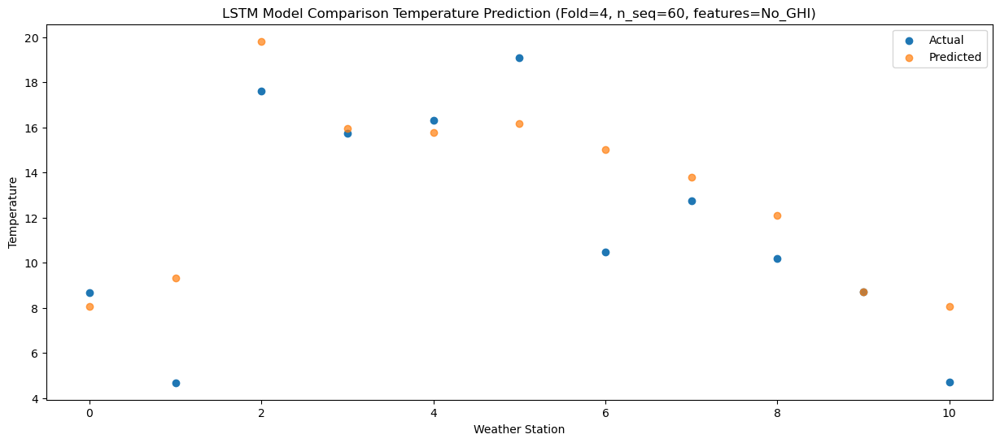

Predictions for (t+7):
    Weather_Station  Actual  Predicted
0                 0   17.91  14.212547
1                 1    6.44  15.442297
2                 2   21.70  25.950534
3                 3   20.70  22.097142
4                 4   21.04  21.931295
5                 5   22.42  22.299727
6                 6   15.07  21.138623
7                 7   19.08  19.918961
8                 8   17.46  18.228967
9                 9   16.43  14.862482
10               10   11.19  14.201486


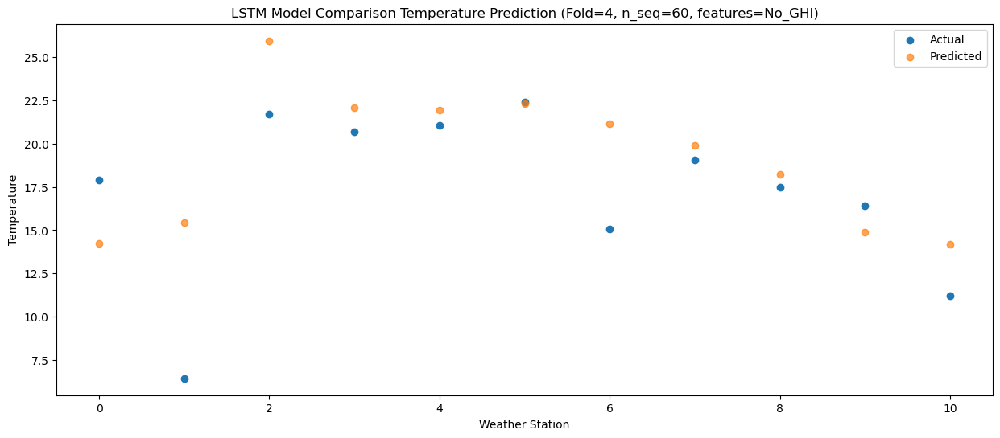

Predictions for (t+8):
    Weather_Station  Actual  Predicted
0                 0   18.72  17.027476
1                 1    6.76  18.258541
2                 2   23.27  28.772882
3                 3   22.56  24.913132
4                 4   23.48  24.741854
5                 5   25.25  25.113008
6                 6   18.11  23.960076
7                 7   21.62  22.740261
8                 8   19.50  21.053637
9                 9   17.64  17.688128
10               10   14.63  17.031069


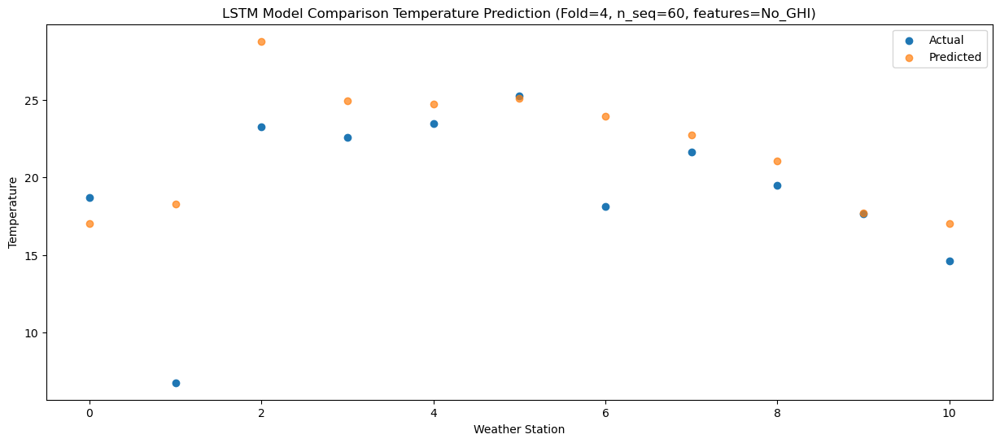

Predictions for (t+9):
    Weather_Station  Actual  Predicted
0                 0   16.62  15.442048
1                 1    6.61  16.684886
2                 2   22.44  27.192938
3                 3   22.31  23.325116
4                 4   22.80  23.154386
5                 5   24.63  23.535442
6                 6   16.91  22.377865
7                 7   19.63  21.151338
8                 8   17.30  19.458575
9                 9   15.04  16.089063
10               10   12.22  15.435441


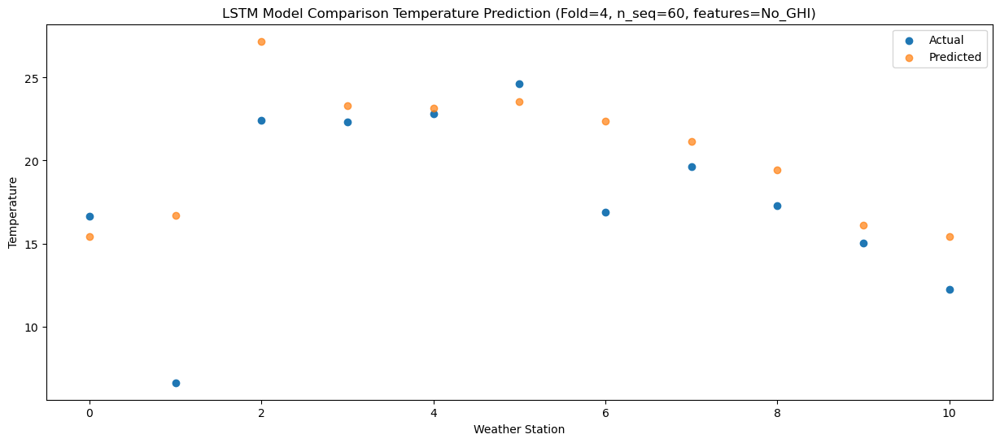

Predictions for (t+10):
    Weather_Station  Actual  Predicted
0                 0   11.78  10.772595
1                 1    6.03  12.022933
2                 2   20.34  22.529096
3                 3   16.53  18.664584
4                 4   16.50  18.493985
5                 5   16.90  18.871071
6                 6   13.11  17.715394
7                 7   16.05  16.490876
8                 8   13.54  14.798774
9                 9   11.14  11.427397
10               10    8.23  10.775469


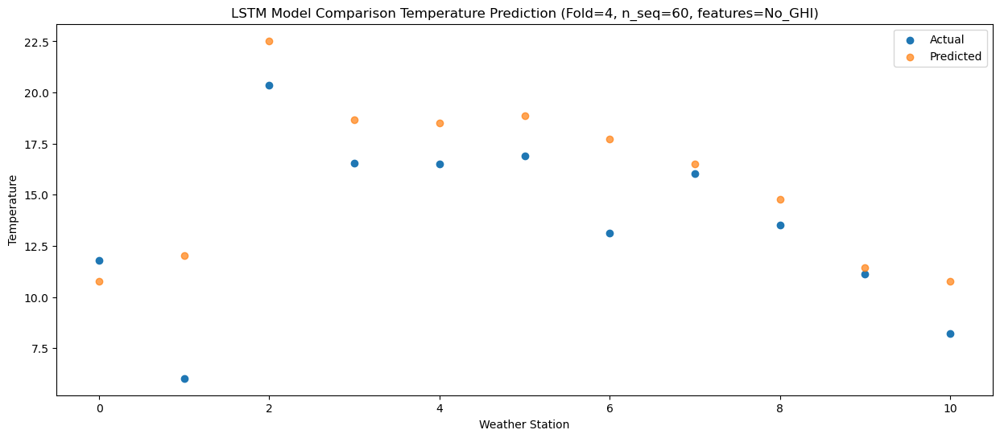

Predictions for (t+11):
    Weather_Station  Actual  Predicted
0                 0    3.73   3.105433
1                 1    4.53   4.356771
2                 2   15.00  14.862400
3                 3   10.80  11.001646
4                 4   10.75  10.835130
5                 5   12.94  11.211589
6                 6    9.29  10.052931
7                 7    9.12   8.826856
8                 8    6.70   7.130495
9                 9    3.80   3.753894
10               10    2.07   3.097905


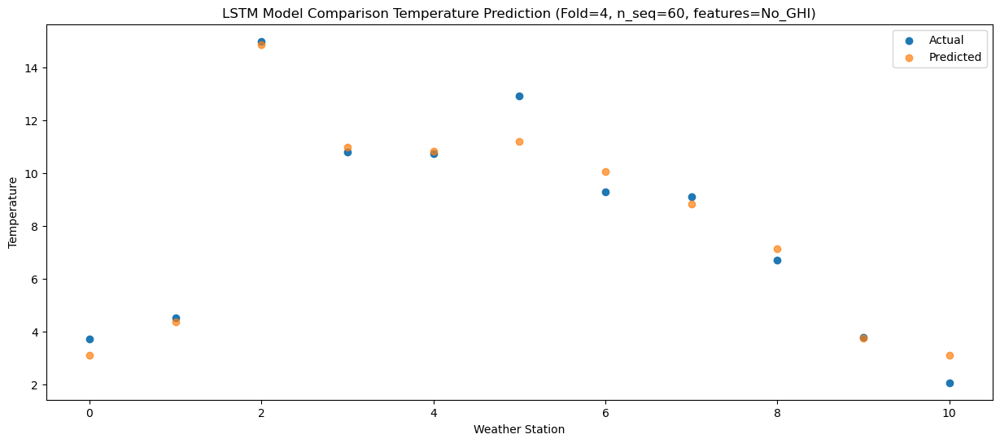

Predictions for (t+12):
    Weather_Station  Actual  Predicted
0                 0    1.54   0.166631
1                 1    1.14   1.421460
2                 2   11.00  11.932041
3                 3    8.19   8.072179
4                 4    7.99   7.904487
5                 5    9.06   8.280250
6                 6    4.98   7.125841
7                 7    6.57   5.898849
8                 8    2.86   4.205364
9                 9    1.16   0.826971
10               10   -1.16   0.172586


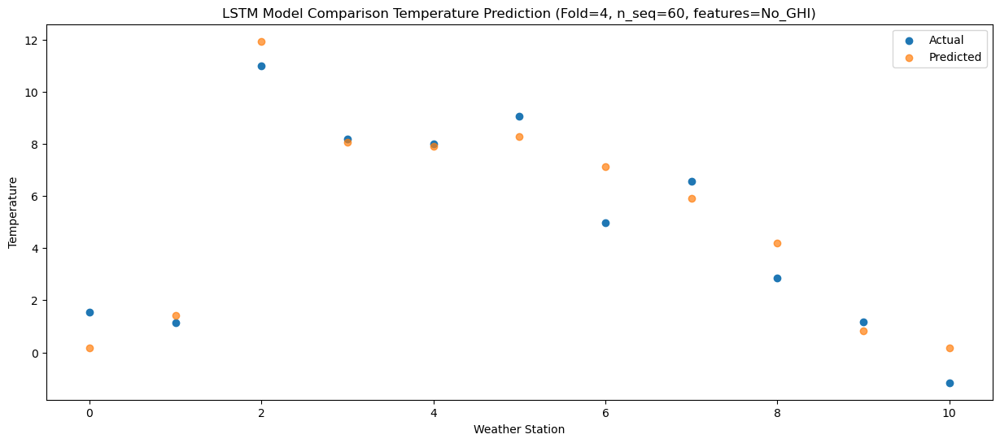

Predictions for (t+13):
    Weather_Station  Actual  Predicted
0                 0   -5.84  -6.489107
1                 1   -6.61  -5.226378
2                 2    4.75   5.286623
3                 3    1.91   1.425256
4                 4    1.42   1.257436
5                 5    2.08   1.635225
6                 6   -2.27   0.474132
7                 7    0.04  -0.753259
8                 8   -4.65  -2.455247
9                 9   -6.72  -5.836447
10               10   -8.72  -6.497669


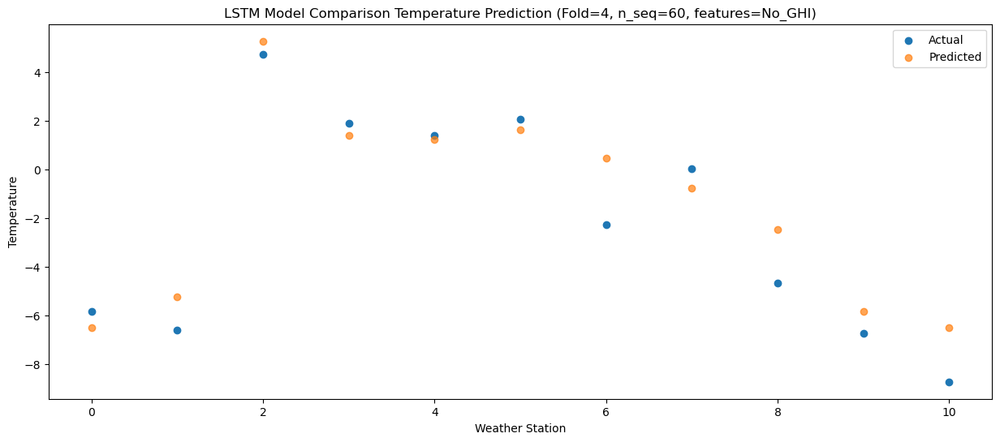

Predictions for (t+14):
    Weather_Station  Actual  Predicted
0                 0   -7.35  -7.867209
1                 1   -5.91  -6.613598
2                 2    4.78   3.903640
3                 3    0.99   0.048187
4                 4    0.82  -0.119692
5                 5    0.98   0.256374
6                 6   -2.04  -0.909038
7                 7   -1.63  -2.131121
8                 8   -6.23  -3.839189
9                 9   -8.75  -7.220778
10               10  -10.64  -7.883890


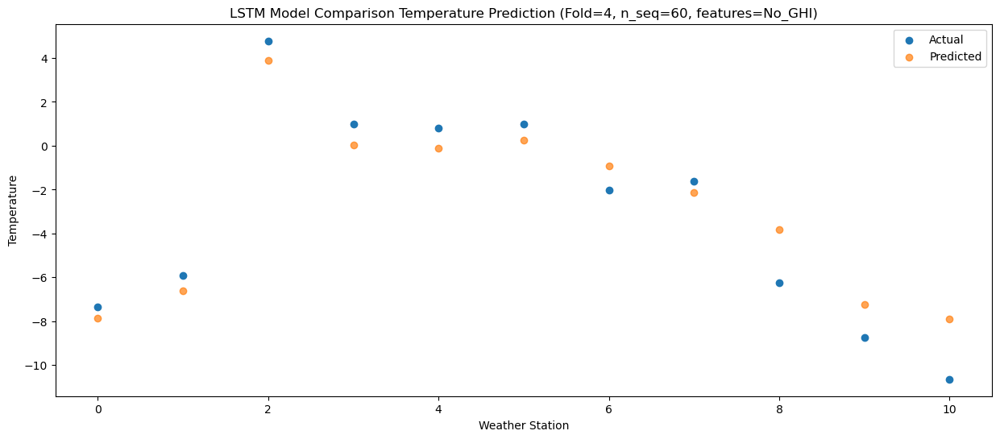

Predictions for (t+15):
    Weather_Station  Actual  Predicted
0                 0  -13.48 -11.986991
1                 1   -2.48 -10.736823
2                 2    2.86  -0.217258
3                 3   -2.47  -4.071463
4                 4   -3.07  -4.238630
5                 5   -0.59  -3.860016
6                 6   -1.37  -5.025268
7                 7   -5.24  -6.249967
8                 8   -9.59  -7.953582
9                 9  -13.19 -11.336762
10               10  -12.88 -11.993812


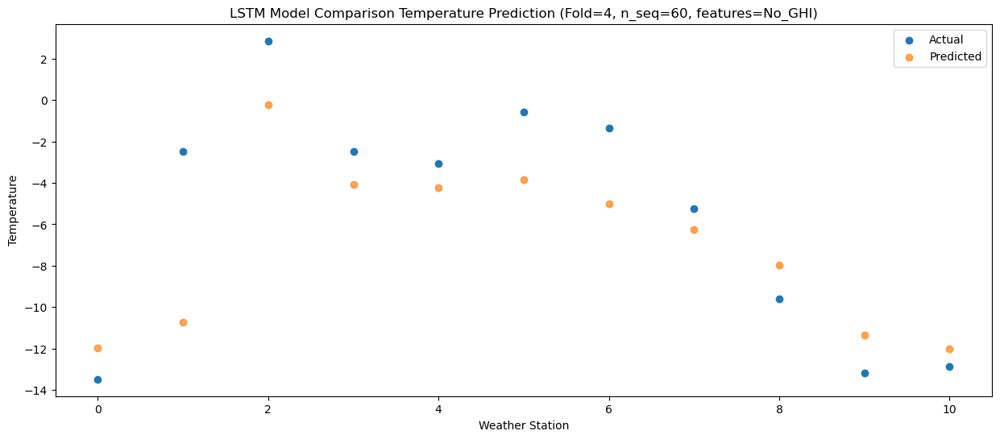

Predictions for (t+16):
    Weather_Station  Actual  Predicted
0                 0    1.25  -0.332093
1                 1   -0.88   0.904922
2                 2   12.19  11.432078
3                 3    8.49   7.582791
4                 4    7.85   7.415082
5                 5    8.66   7.793575
6                 6    5.03   6.630137
7                 7    7.03   5.412012
8                 8    2.38   3.710665
9                 9    0.67   0.329526
10               10   -2.99  -0.328446


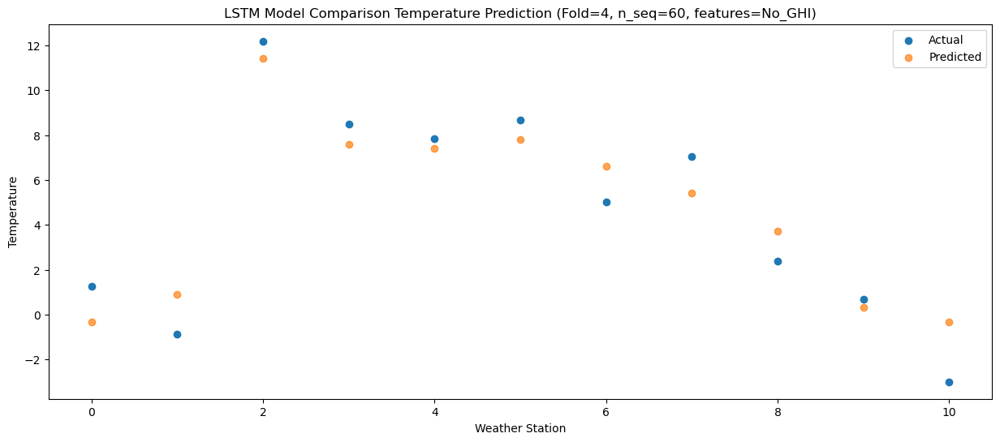

Predictions for (t+17):
    Weather_Station  Actual  Predicted
0                 0    4.16   3.290293
1                 1    0.56   4.517732
2                 2   13.26  15.046031
3                 3   10.18  11.202893
4                 4   10.03  11.037844
5                 5   10.89  11.416408
6                 6    7.76  10.245038
7                 7    8.93   9.034429
8                 8    6.03   7.330665
9                 9    4.38   3.955192
10               10    0.81   3.293068


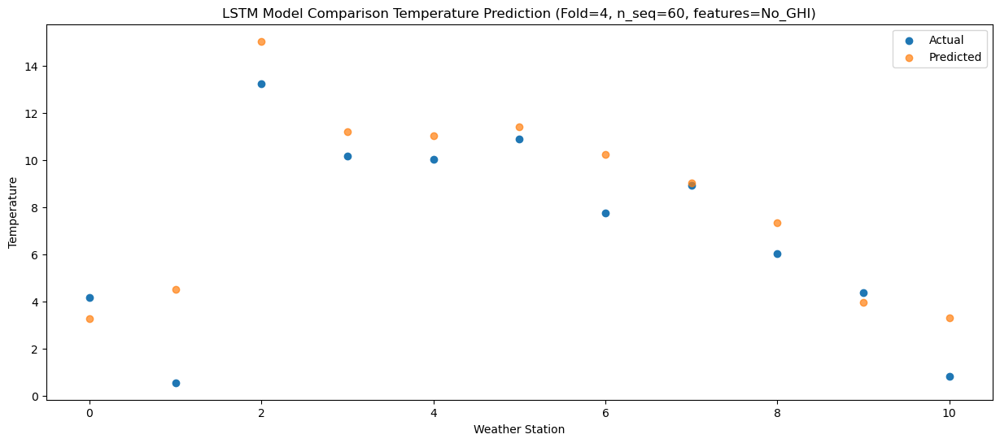

Predictions for (t+18):
    Weather_Station  Actual  Predicted
0                 0    8.37   8.221717
1                 1    4.60   9.449556
2                 2   17.73  19.978045
3                 3   14.34  16.135530
4                 4   13.56  15.972749
5                 5   16.38  16.349839
6                 6   11.21  15.181874
7                 7   12.97  13.966975
8                 8   10.44  12.263990
9                 9    9.16   8.892124
10               10    5.34   8.228034


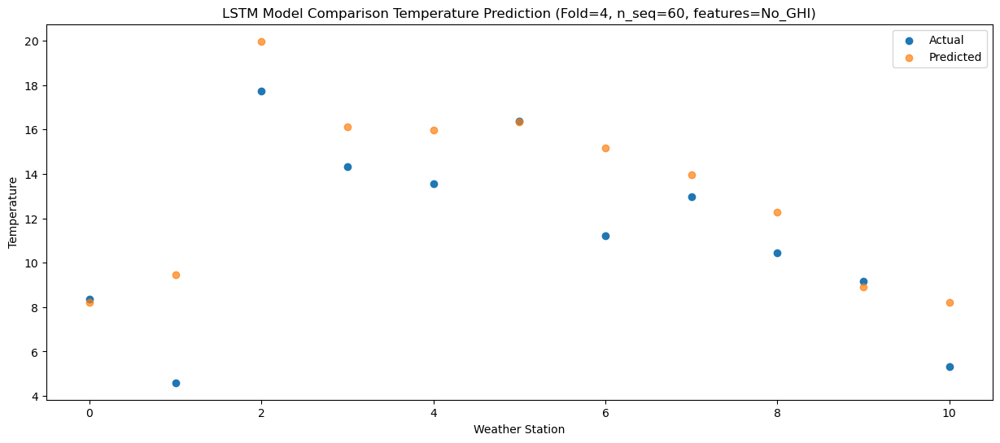

Predictions for (t+19):
    Weather_Station  Actual  Predicted
0                 0   16.28  15.017144
1                 1    6.23  16.239909
2                 2   21.99  26.772495
3                 3   20.02  22.928865
4                 4   20.41  22.765524
5                 5   21.34  23.141020
6                 6   15.23  21.971456
7                 7   19.27  20.762486
8                 8   17.68  19.062879
9                 9   16.55  15.692933
10               10   12.23  15.028864


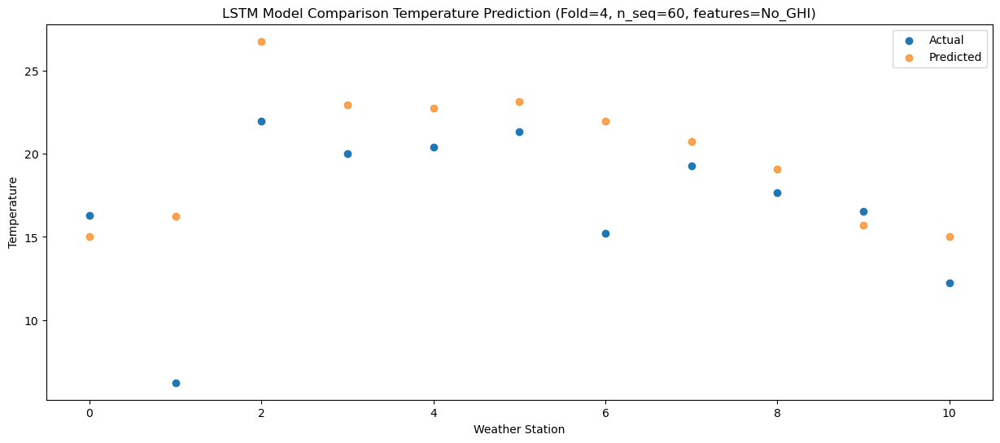

Predictions for (t+20):
    Weather_Station  Actual  Predicted
0                 0   17.08  15.675051
1                 1    6.60  16.896362
2                 2   22.65  27.428975
3                 3   21.61  23.592313
4                 4   21.90  23.430333
5                 5   21.08  23.805706
6                 6   16.97  22.635693
7                 7   20.56  21.426863
8                 8   18.25  19.726923
9                 9   16.26  16.359629
10               10   12.39  15.697273


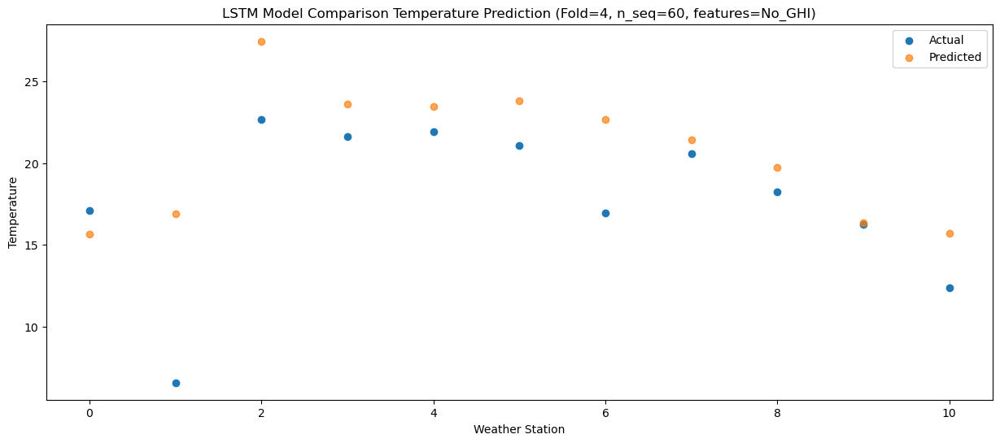

Predictions for (t+21):
    Weather_Station  Actual  Predicted
0                 0   17.48  15.578117
1                 1    6.88  16.801620
2                 2   23.30  27.334651
3                 3   21.98  23.499241
4                 4   22.27  23.339531
5                 5   21.40  23.711111
6                 6   17.10  22.545217
7                 7   21.08  21.336174
8                 8   19.11  19.637130
9                 9   16.54  16.268674
10               10   13.59  15.607303


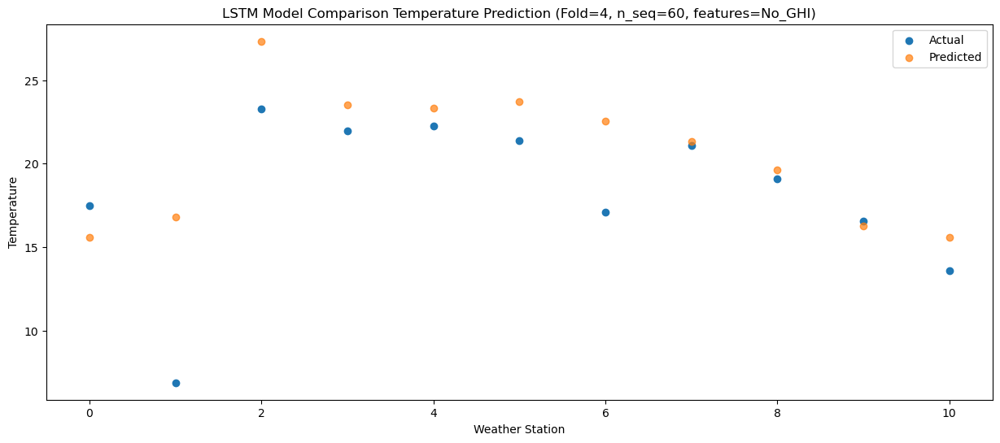

Predictions for (t+22):
    Weather_Station  Actual  Predicted
0                 0   14.29  11.638153
1                 1    5.59  12.854822
2                 2   20.18  23.389273
3                 3   19.19  19.559666
4                 4   18.84  19.403085
5                 5   20.71  19.776459
6                 6   13.13  18.607070
7                 7   18.04  17.396503
8                 8   15.62  15.696875
9                 9   13.43  12.323816
10               10    9.30  11.663114


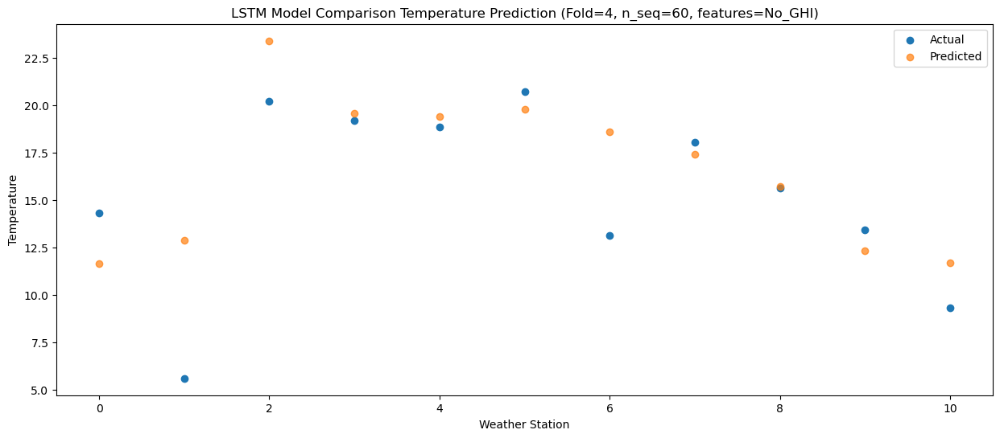

Predictions for (t+23):
    Weather_Station  Actual  Predicted
0                 0    7.16   6.676481
1                 1    3.75   7.900328
2                 2   16.79  18.429981
3                 3   14.54  14.595915
4                 4   13.97  14.437165
5                 5   15.01  14.812516
6                 6    9.33  13.645673
7                 7   12.27  12.433421
8                 8   10.27  10.735169
9                 9    7.97   7.359520
10               10    5.77   6.702672


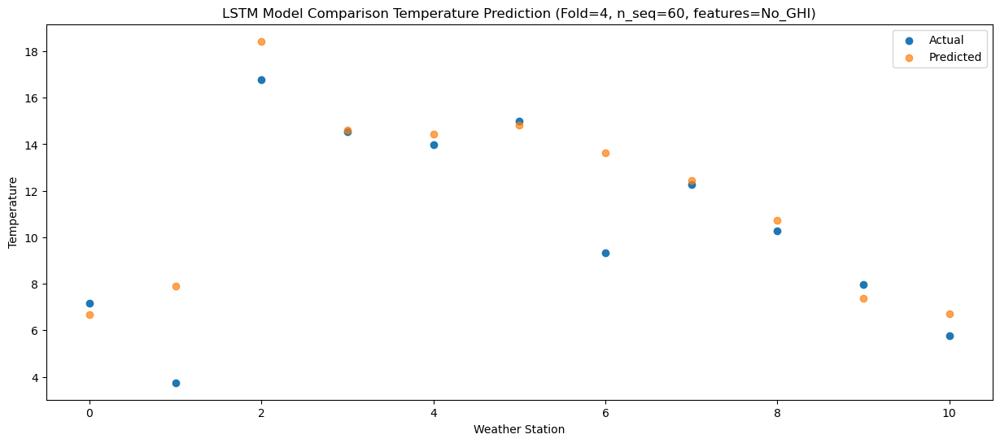

Predictions for (t+24):
    Weather_Station  Actual  Predicted
0                 0    0.10  -3.194572
1                 1   -3.41  -1.972792
2                 2    8.12   8.561425
3                 3    6.54   4.734177
4                 4    6.13   4.576410
5                 5    8.07   4.952677
6                 6    1.17   3.780600
7                 7    4.33   2.569010
8                 8   -0.59   0.866515
9                 9   -2.34  -2.510531
10               10   -4.63  -3.172261


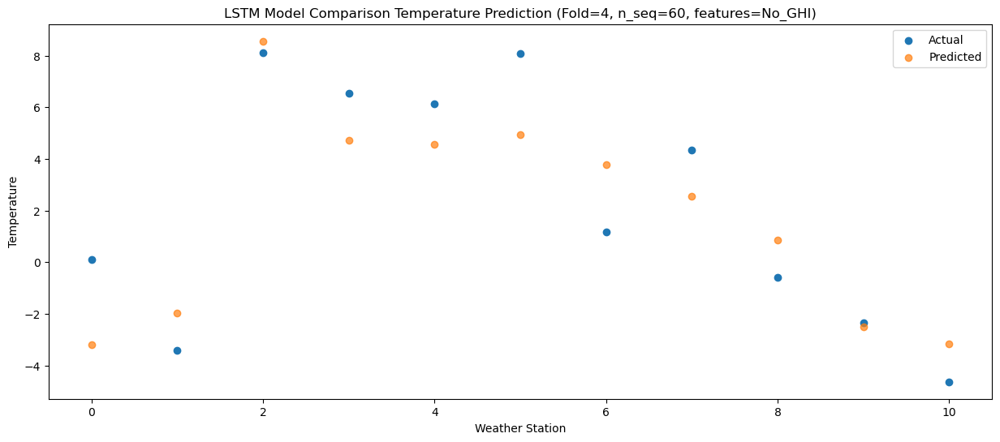

Predictions for (t+25):
    Weather_Station  Actual  Predicted
0                 0   -1.69  -4.491299
1                 1   -1.61  -3.270750
2                 2   11.63   7.269178
3                 3    8.54   3.446575
4                 4    7.87   3.291735
5                 5    8.48   3.669332
6                 6    3.08   2.492951
7                 7    5.79   1.285355
8                 8   -0.27  -0.420843
9                 9   -2.59  -3.798126
10               10   -5.49  -4.465501


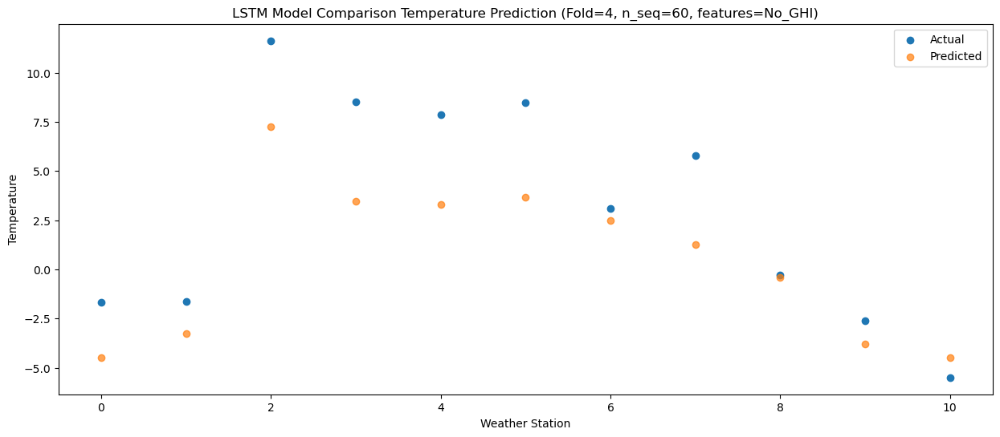

Predictions for (t+26):
    Weather_Station  Actual  Predicted
0                 0  -10.07 -12.397028
1                 1   -6.37 -11.172476
2                 2    3.35  -0.630617
3                 3    0.07  -4.451503
4                 4   -1.03  -4.606230
5                 5    1.11  -4.230636
6                 6   -2.98  -5.410652
7                 7   -3.28  -6.617327
8                 8   -9.11  -8.327455
9                 9  -12.07 -11.704637
10               10  -14.32 -12.371929


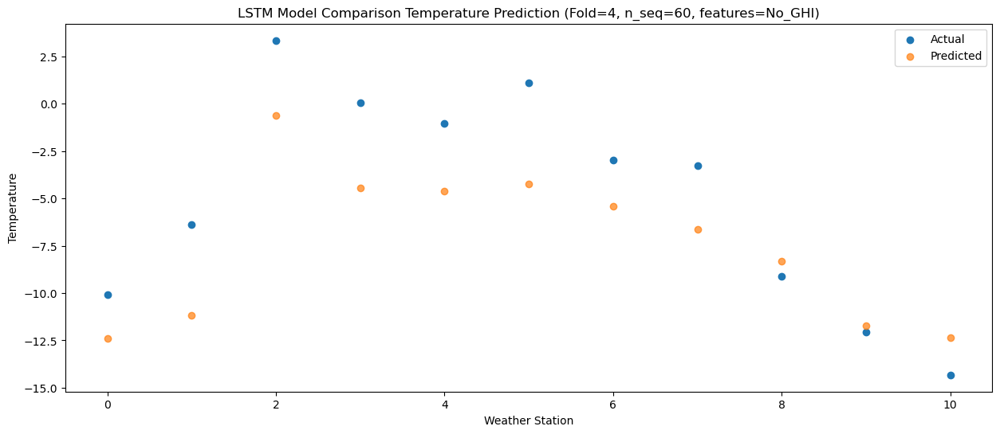

Predictions for (t+27):
    Weather_Station  Actual  Predicted
0                 0   -8.00  -9.702844
1                 1   -2.94  -8.482303
2                 2    5.71   2.061471
3                 3    0.33  -1.758836
4                 4   -0.41  -1.913540
5                 5    0.91  -1.539886
6                 6    1.30  -2.719252
7                 7   -1.22  -3.926098
8                 8   -6.09  -5.631531
9                 9   -9.24  -9.009478
10               10  -10.76  -9.673334


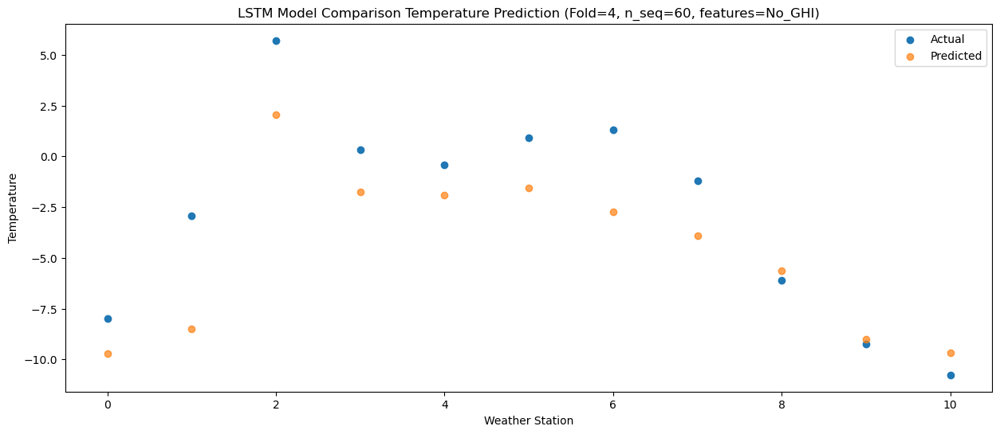

Predictions for (t+28):
    Weather_Station  Actual  Predicted
0                 0   -1.29  -2.702013
1                 1   -0.12  -1.508184
2                 2   10.45   9.037435
3                 3    6.51   5.224408
4                 4    6.51   5.071726
5                 5    8.23   5.443753
6                 6    4.86   4.256718
7                 7    5.44   3.057577
8                 8    1.38   1.357419
9                 9   -1.03  -2.014112
10               10   -4.79  -2.678912


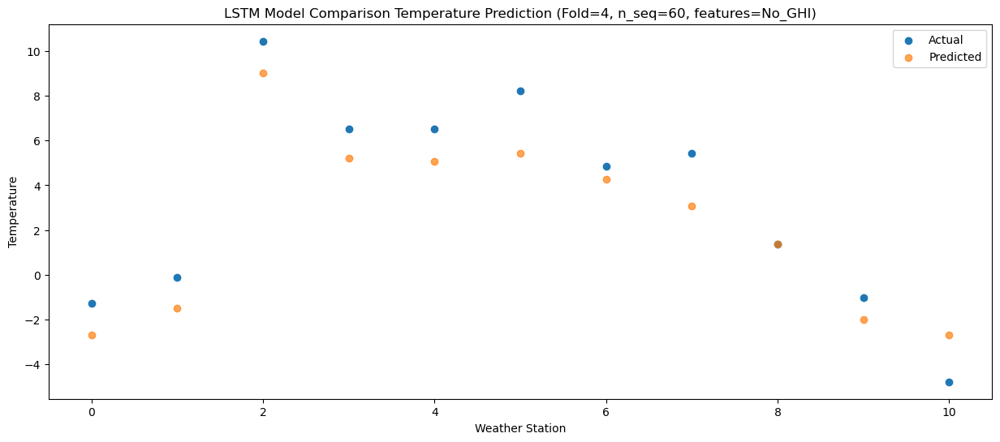

Predictions for (t+29):
    Weather_Station  Actual  Predicted
0                 0    3.59   1.251630
1                 1    2.22   2.437146
2                 2   14.66  12.983569
3                 3   12.56   9.174539
4                 4   13.20   9.023889
5                 5   15.74   9.402746
6                 6    7.52   8.205244
7                 7    9.30   7.009845
8                 8    5.16   5.308009
9                 9    3.09   1.939053
10               10   -0.79   1.274184


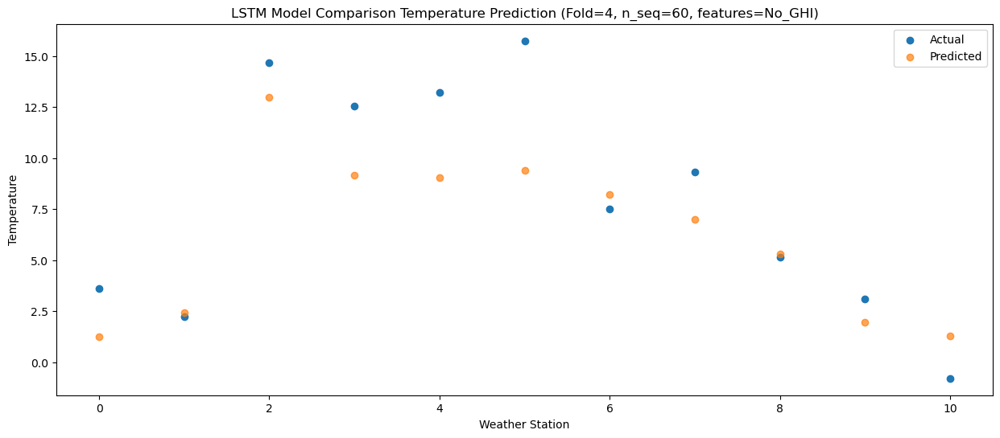

Predictions for (t+30):
    Weather_Station  Actual  Predicted
0                 0   10.53   9.369834
1                 1    5.04  10.545096
2                 2   20.46  21.094494
3                 3   17.27  17.287824
4                 4   18.03  17.136331
5                 5   21.43  17.509633
6                 6   13.50  16.313088
7                 7   14.97  15.122441
8                 8   13.66  13.425747
9                 9   11.62  10.059969
10               10    7.79   9.396989


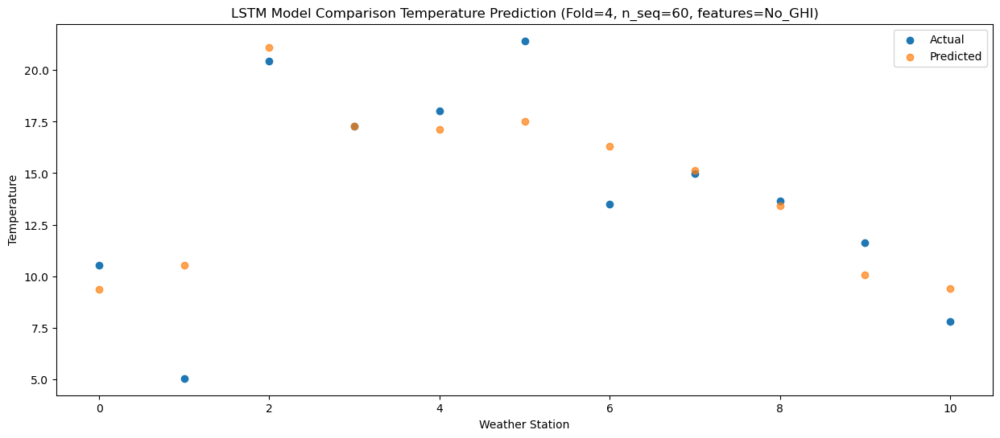

Predictions for (t+31):
    Weather_Station  Actual  Predicted
0                 0   16.44  13.640967
1                 1    6.76  14.816494
2                 2   23.75  25.366310
3                 3   21.82  21.558688
4                 4   22.70  21.406957
5                 5   23.80  21.780426
6                 6   16.71  20.584476
7                 7   20.29  19.392929
8                 8   18.14  17.696329
9                 9   16.23  14.330211
10               10   11.06  13.668972


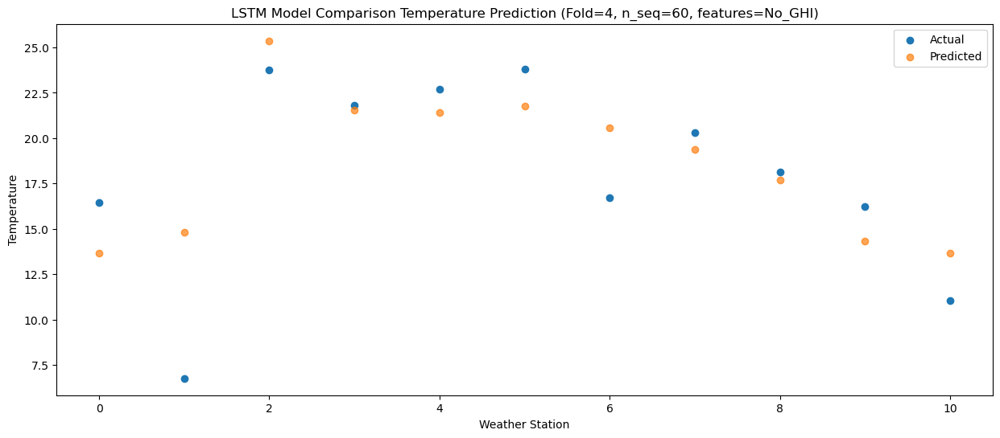

Predictions for (t+32):
    Weather_Station  Actual  Predicted
0                 0   18.96  16.069623
1                 1    7.13  17.249963
2                 2   23.95  27.798259
3                 3   25.12  23.996909
4                 4   26.12  23.845524
5                 5   25.70  24.217279
6                 6   17.98  23.020933
7                 7   23.99  21.829036
8                 8   20.08  20.133623
9                 9   17.05  16.768450
10               10   13.66  16.109306


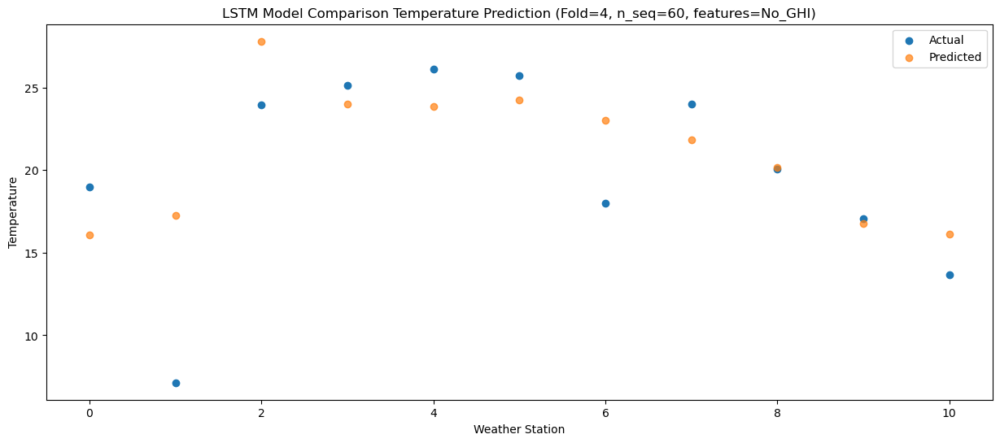

Predictions for (t+33):
    Weather_Station  Actual  Predicted
0                 0   17.30  14.952602
1                 1    7.08  16.136438
2                 2   22.41  26.683814
3                 3   22.39  22.882803
4                 4   23.28  22.733234
5                 5   22.40  23.107996
6                 6   16.46  21.912033
7                 7   20.47  20.716822
8                 8   17.85  19.022382
9                 9   15.75  15.655157
10               10   12.59  15.000057


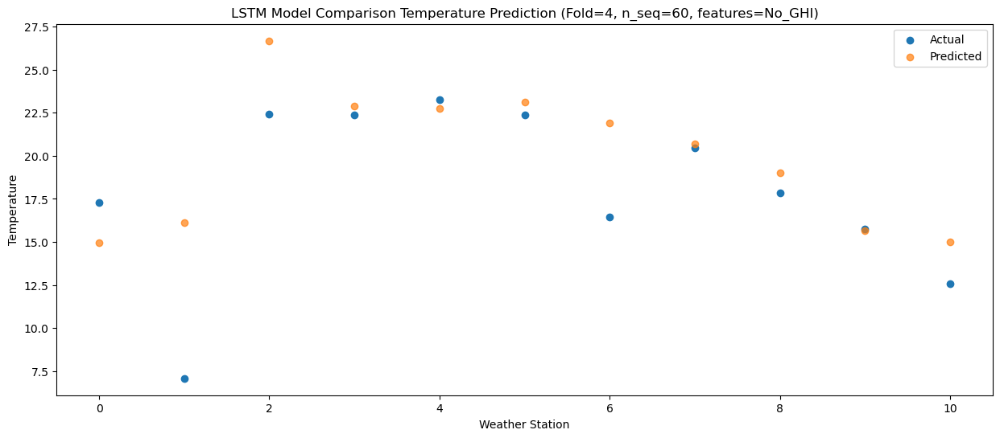

Predictions for (t+34):
    Weather_Station  Actual  Predicted
0                 0   13.39  11.444660
1                 1    5.64  12.616934
2                 2   20.34  23.166137
3                 3   18.96  19.375364
4                 4   19.19  19.231725
5                 5   19.50  19.607216
6                 6   13.37  18.398800
7                 7   16.88  17.209157
8                 8   13.94  15.507610
9                 9   11.61  12.143244
10               10    8.54  11.481250


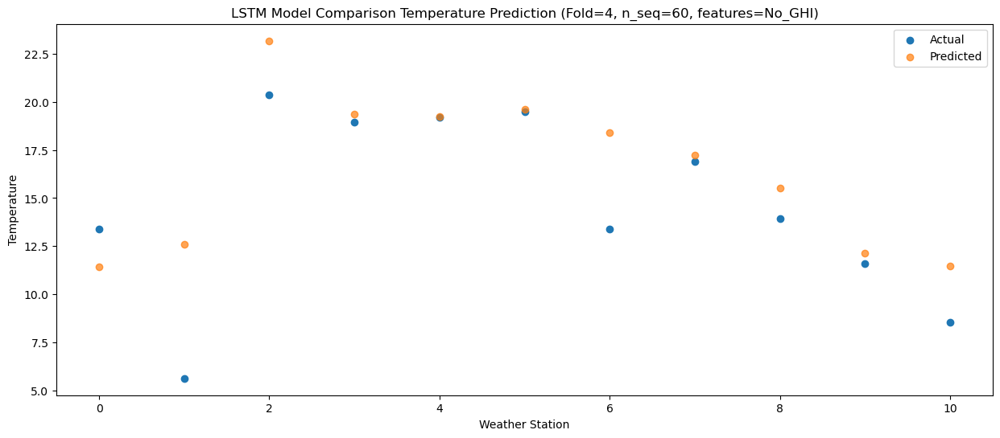

Predictions for (t+35):
    Weather_Station  Actual  Predicted
0                 0    6.04   4.150367
1                 1    1.81   5.324756
2                 2   14.21  15.872258
3                 3   12.09  12.080414
4                 4   12.04  11.935549
5                 5   12.69  12.320244
6                 6    6.50  11.100841
7                 7   10.51   9.911819
8                 8    6.45   8.204807
9                 9    4.14   4.839313
10               10    1.68   4.176103


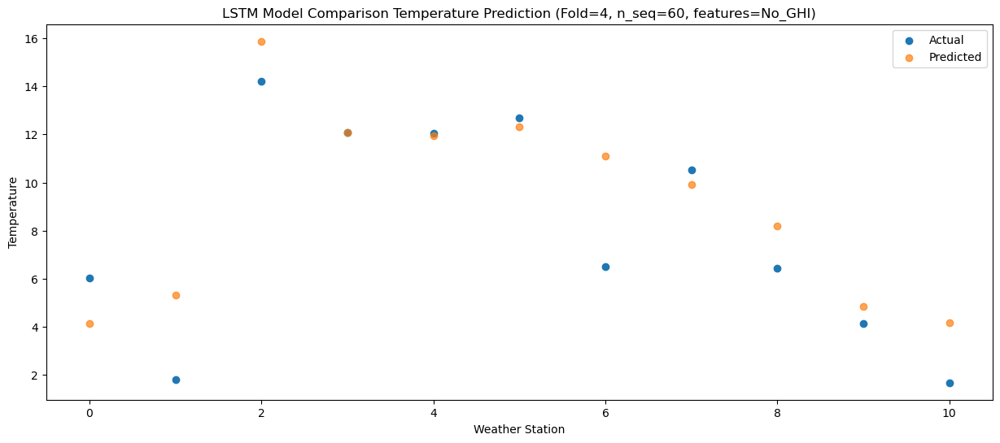

Predictions for (t+36):
    Weather_Station  Actual  Predicted
0                 0   -2.29  -2.944492
1                 1    0.35  -1.765351
2                 2    9.62   8.783667
3                 3    5.04   4.989700
4                 4    4.95   4.841073
5                 5    4.84   5.224051
6                 6    3.80   4.009395
7                 7    3.96   2.823778
8                 8    0.66   1.119455
9                 9   -1.40  -2.245209
10               10   -2.40  -2.902873


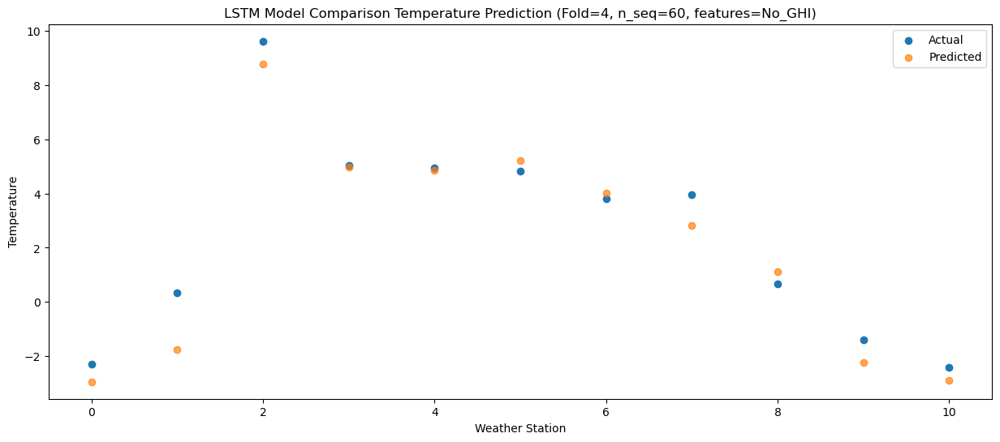

Predictions for (t+37):
    Weather_Station  Actual  Predicted
0                 0   -8.43  -8.848171
1                 1   -4.50  -7.664601
2                 2    7.19   2.882352
3                 3    2.35  -0.909217
4                 4    1.98  -1.054624
5                 5    3.24  -0.671885
6                 6   -2.15  -1.892617
7                 7   -0.89  -3.077673
8                 8   -5.12  -4.785315
9                 9   -8.13  -8.150871
10               10   -9.11  -8.812579


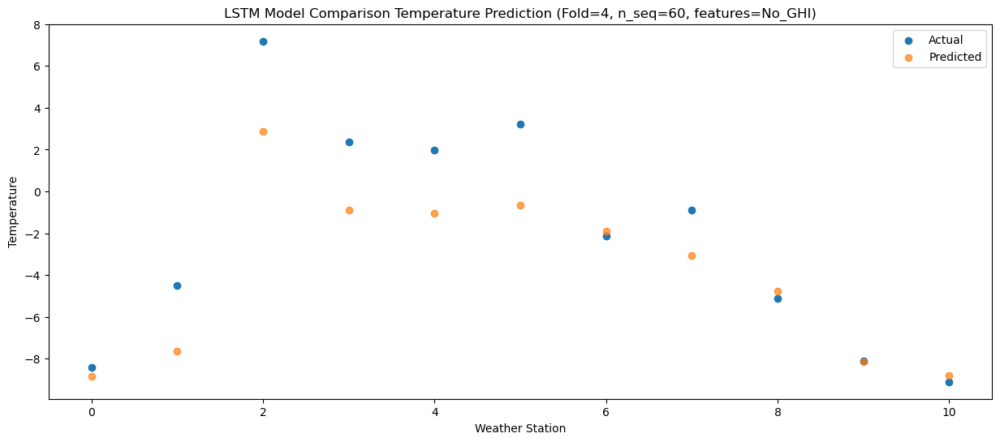

Predictions for (t+38):
    Weather_Station  Actual  Predicted
0                 0   -6.47  -6.541904
1                 1   -4.65  -5.357502
2                 2    7.60   5.185514
3                 3    3.34   1.398034
4                 4    2.75   1.259247
5                 5    3.61   1.650025
6                 6    0.87   0.417579
7                 7    0.76  -0.767599
8                 8   -3.16  -2.485087
9                 9   -5.89  -5.851973
10               10   -7.48  -6.520514


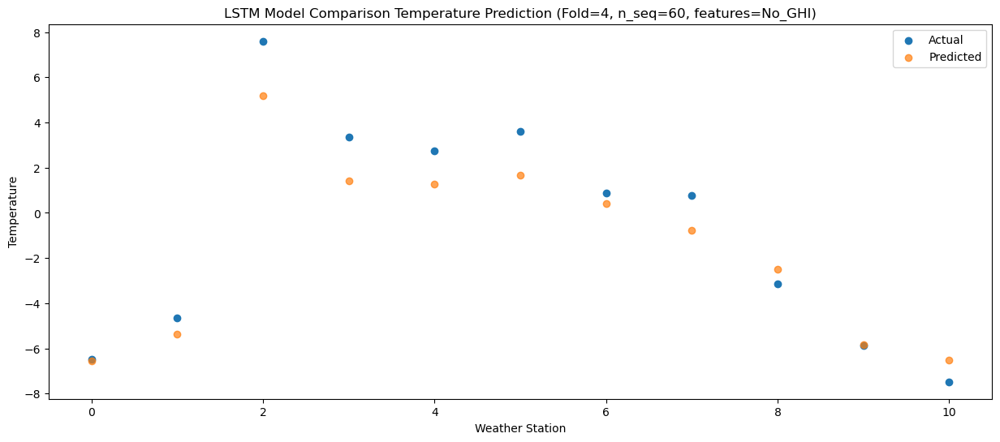

Predictions for (t+39):
    Weather_Station  Actual  Predicted
0                 0   -4.72  -6.155343
1                 1   -1.35  -4.969319
2                 2    9.54   5.577886
3                 3    3.40   1.793932
4                 4    2.98   1.655418
5                 5    3.78   2.046043
6                 6    4.29   0.815341
7                 7    2.90  -0.366491
8                 8   -1.57  -2.082019
9                 9   -4.70  -5.448793
10               10   -7.34  -6.116125


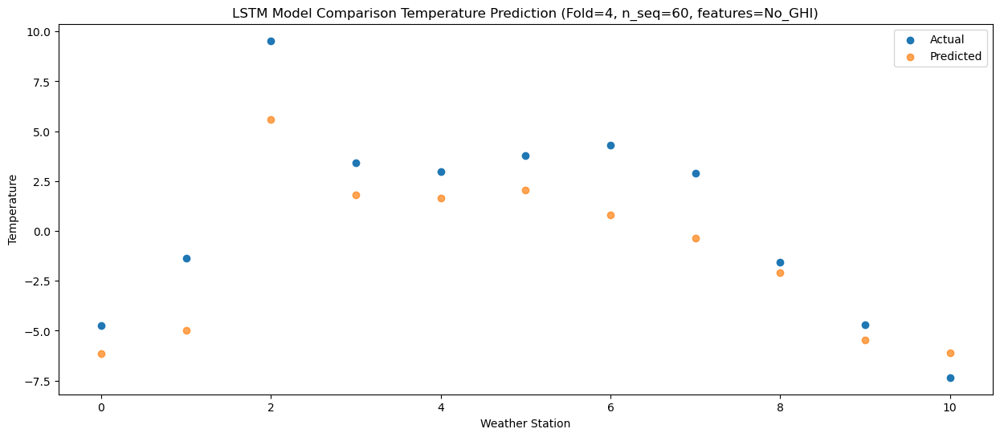

Predictions for (t+40):
    Weather_Station  Actual  Predicted
0                 0   -2.54  -3.602339
1                 1    0.37  -2.427889
2                 2   11.69   8.127751
3                 3    7.93   4.347422
4                 4    7.83   4.211160
5                 5    8.85   4.602809
6                 6    4.77   3.359936
7                 7    4.62   2.183104
8                 8   -0.30   0.468716
9                 9   -2.16  -2.894647
10               10   -6.46  -3.564093


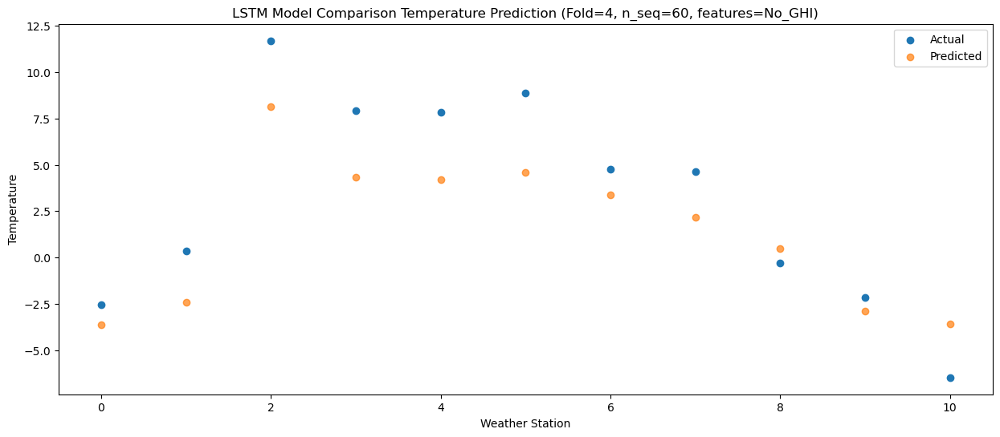

Predictions for (t+41):
    Weather_Station  Actual  Predicted
0                 0    5.29   2.804486
1                 1    3.09   3.969591
2                 2   13.44  14.524502
3                 3   10.53  10.749619
4                 4   10.48  10.617576
5                 5   13.07  11.014888
6                 6    7.88   9.764814
7                 7   10.24   8.589843
8                 8    6.20   6.874257
9                 9    5.17   3.511817
10               10    2.01   2.843623


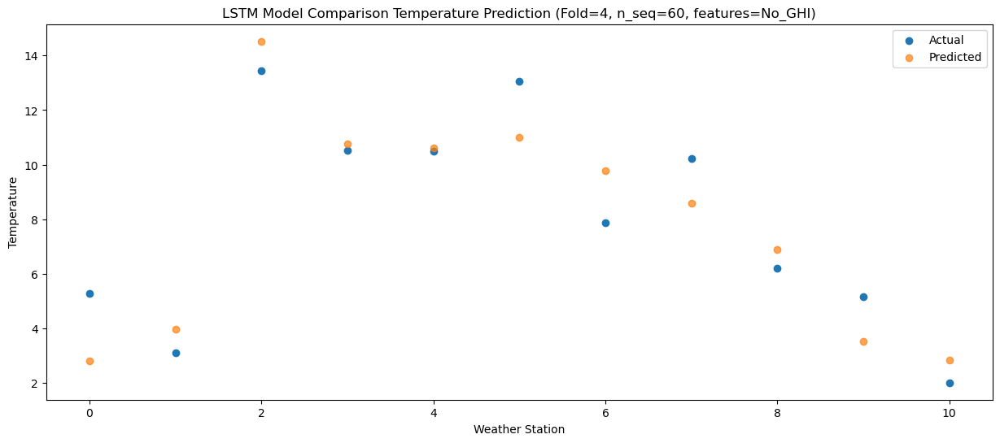

Predictions for (t+42):
    Weather_Station  Actual  Predicted
0                 0   11.10   9.303152
1                 1    3.87  10.460573
2                 2   18.30  21.021477
3                 3   16.21  17.254195
4                 4   16.64  17.125488
5                 5   17.99  17.523239
6                 6   10.50  16.258206
7                 7   15.02  15.089593
8                 8   11.91  13.364603
9                 9   10.93  10.003427
10               10    5.70   9.325627


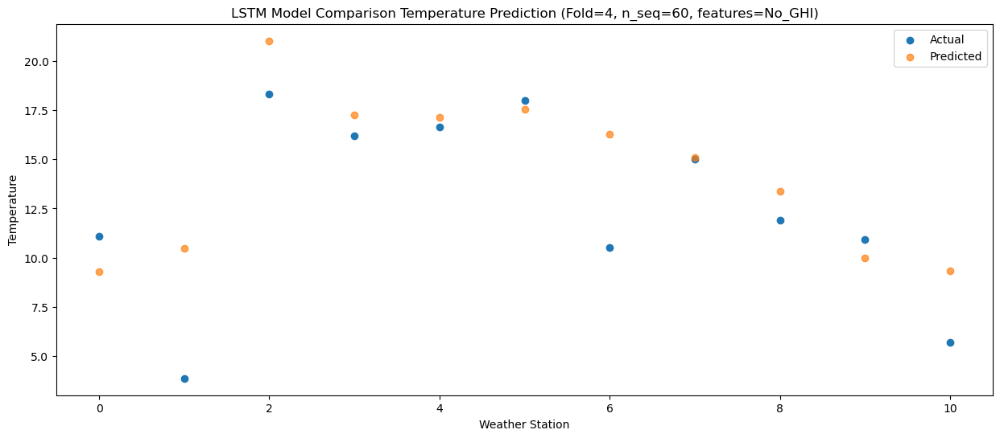

Predictions for (t+43):
    Weather_Station  Actual  Predicted
0                 0   16.01  13.109946
1                 1    6.08  14.261963
2                 2   21.89  24.829864
3                 3   20.40  21.061799
4                 4   21.75  20.933045
5                 5   24.47  21.335637
6                 6   14.14  20.068806
7                 7   19.10  18.901729
8                 8   15.79  17.175818
9                 9   15.24  13.814449
10               10   10.01  13.135048


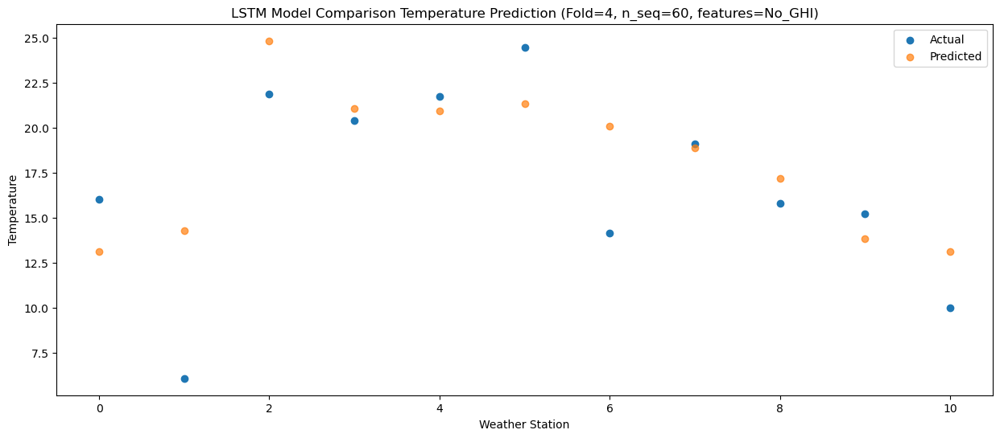

Predictions for (t+44):
    Weather_Station  Actual  Predicted
0                 0   17.32  15.281303
1                 1    7.69  16.437420
2                 2   23.67  27.000344
3                 3   22.95  23.232121
4                 4   24.83  23.103995
5                 5   25.93  23.510845
6                 6   18.01  22.244930
7                 7   21.06  21.074669
8                 8   18.52  19.346165
9                 9   16.77  15.982700
10               10   13.10  15.307665


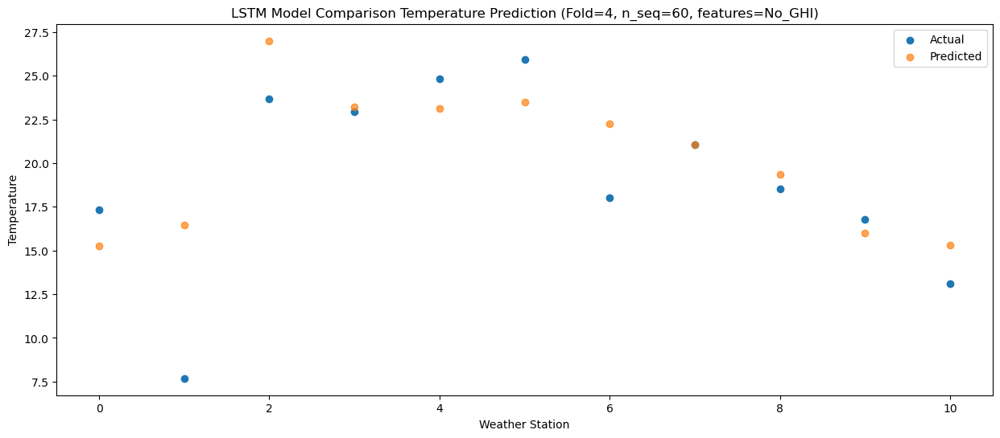

Predictions for (t+45):
    Weather_Station  Actual  Predicted
0                 0   17.12  14.733165
1                 1    8.20  15.901774
2                 2   25.75  26.460582
3                 3   25.50  22.691942
4                 4   26.70  22.564953
5                 5   26.02  22.974759
6                 6   17.45  21.708650
7                 7   20.87  20.534752
8                 8   17.36  18.797078
9                 9   15.51  15.428415
10               10   11.77  14.751787


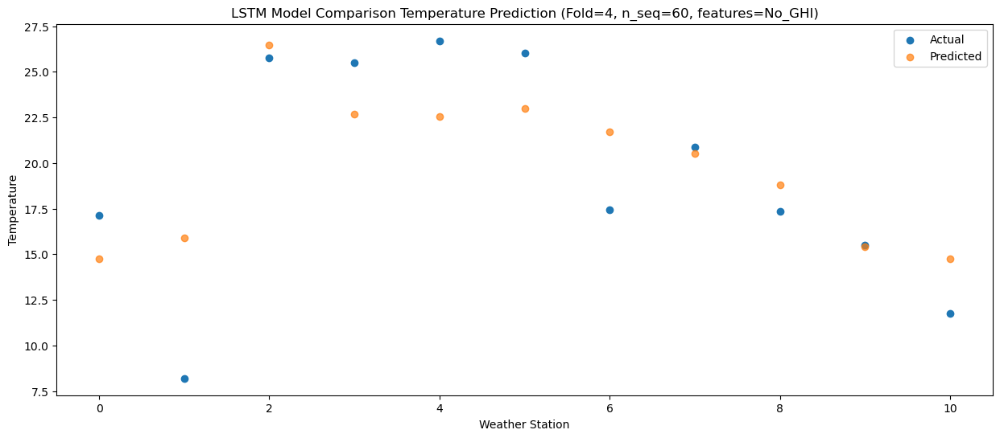

Predictions for (t+46):
    Weather_Station  Actual  Predicted
0                 0   14.29  11.388695
1                 1    6.10  12.549285
2                 2   22.00  23.113040
3                 3   20.80  19.352095
4                 4   21.61  19.228026
5                 5   22.54  19.637040
6                 6   13.61  18.359567
7                 7   16.93  17.193118
8                 8   14.27  15.453372
9                 9   12.47  12.088811
10               10    9.43  11.410211


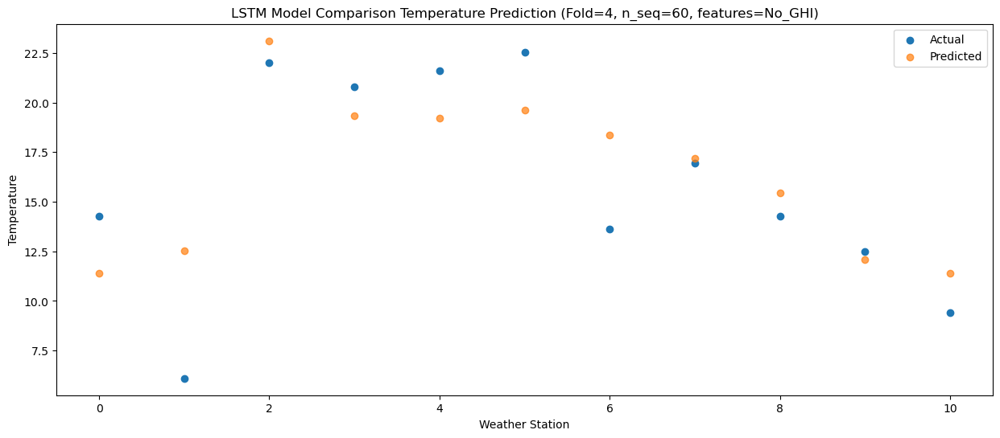

Predictions for (t+47):
    Weather_Station  Actual  Predicted
0                 0    7.17   5.017091
1                 1    2.45   6.185209
2                 2   15.89  16.747016
3                 3   12.67  12.983503
4                 4   12.78  12.856408
5                 5   14.01  13.263251
6                 6    8.17  11.990427
7                 7   11.03  10.819943
8                 8    8.13   9.082315
9                 9    6.06   5.712624
10               10    4.17   5.035550


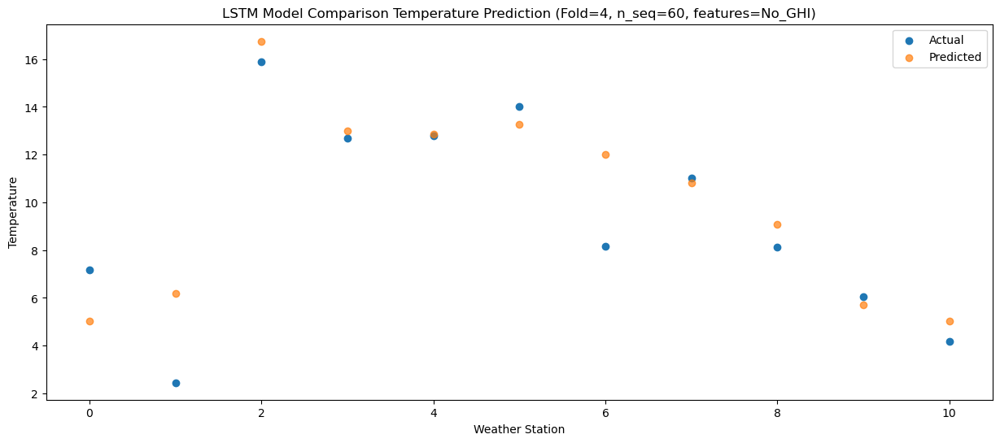

Predictions for (t+48):
    Weather_Station  Actual  Predicted
0                 0    0.92  -2.366249
1                 1   -1.26  -1.196471
2                 2    8.93   9.363561
3                 3    6.60   5.598765
4                 4    6.25   5.468126
5                 5    7.30   5.878450
6                 6    2.44   4.604085
7                 7    5.13   3.435401
8                 8    1.06   1.694794
9                 9   -1.03  -1.673407
10               10   -3.22  -2.351169


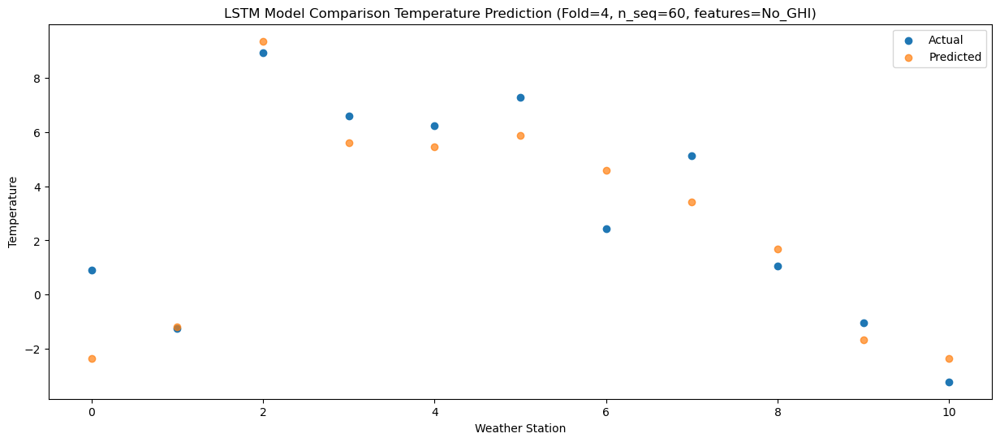

Predictions for (t+49):
    Weather_Station  Actual  Predicted
0                 0   -2.48  -4.112887
1                 1   -3.38  -2.948434
2                 2    6.38   7.616012
3                 3    3.58   3.853776
4                 4    3.12   3.720242
5                 5    4.50   4.127652
6                 6    0.23   2.852010
7                 7    2.25   1.691237
8                 8   -0.83  -0.049472
9                 9   -3.02  -3.413250
10               10   -3.88  -4.093146


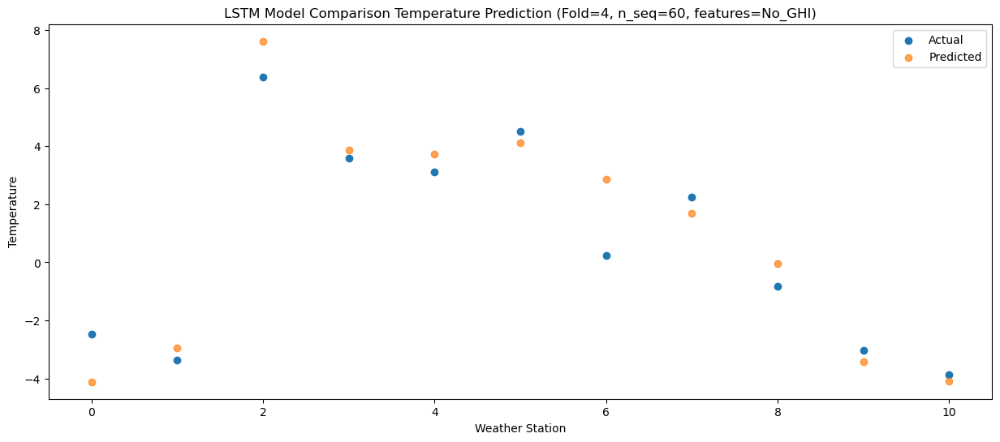

Predictions for (t+50):
    Weather_Station  Actual  Predicted
0                 0  -11.07 -10.072681
1                 1   -4.80  -8.898858
2                 2    2.19   1.664130
3                 3   -1.94  -2.102344
4                 4   -2.23  -2.238383
5                 5    0.25  -1.830293
6                 6   -2.21  -3.098785
7                 7   -4.91  -4.267192
8                 8   -7.11  -6.005185
9                 9  -10.60  -9.373721
10               10   -9.65 -10.044914


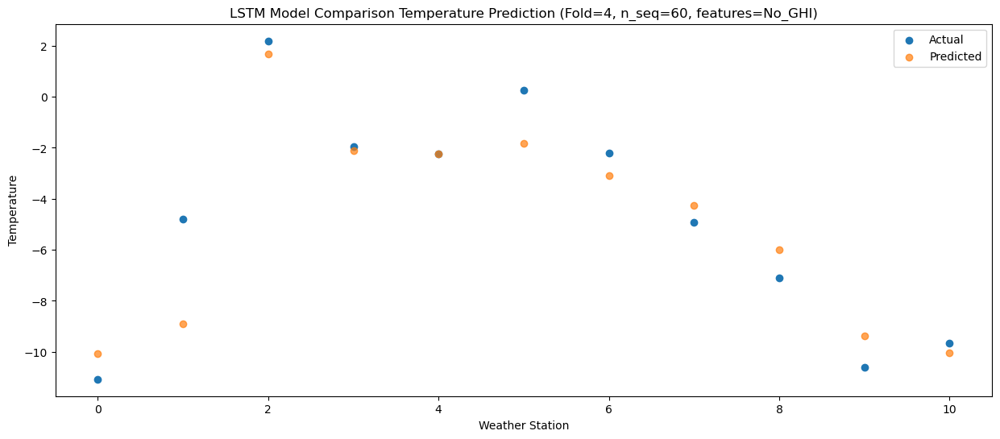

Predictions for (t+51):
    Weather_Station  Actual  Predicted
0                 0    0.04  -3.764387
1                 1   -5.07  -2.594000
2                 2    8.51   7.968618
3                 3    6.47   4.206459
4                 4    6.09   4.074391
5                 5    7.07   4.481797
6                 6    1.20   3.207354
7                 7    5.00   2.041144
8                 8   -0.77   0.298907
9                 9   -2.83  -3.070914
10               10   -6.17  -3.744623


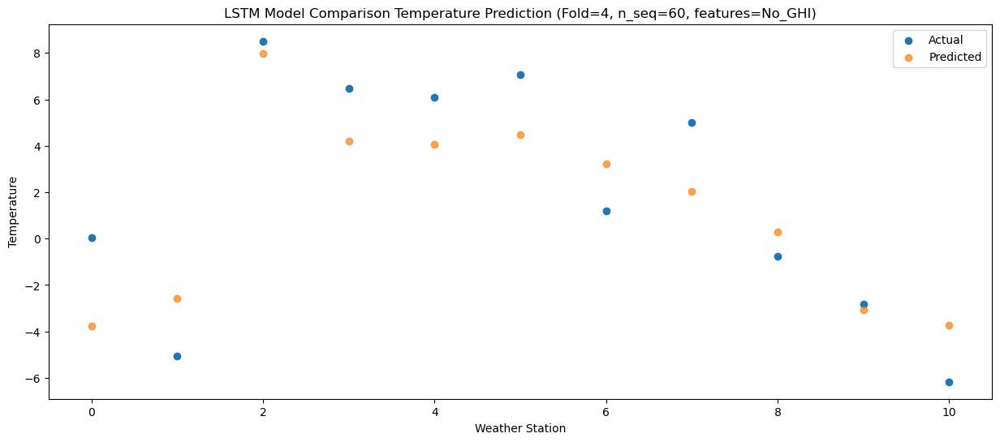

Predictions for (t+52):
    Weather_Station  Actual  Predicted
0                 0    2.57  -0.959184
1                 1   -0.17   0.217514
2                 2   10.74  10.778775
3                 3    8.88   7.015481
4                 4    8.66   6.884169
5                 5    9.67   7.292160
6                 6    4.99   6.017842
7                 7    7.43   4.852029
8                 8    3.67   3.111419
9                 9    1.32  -0.261062
10               10   -2.82  -0.933646


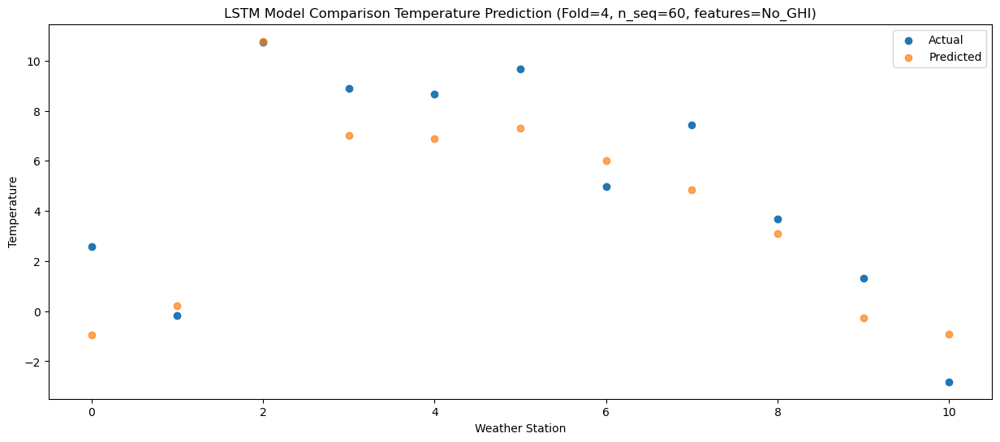

Predictions for (t+53):
    Weather_Station  Actual  Predicted
0                 0    7.19   3.917579
1                 1    0.88   5.086918
2                 2   14.56  15.644990
3                 3   12.73  11.882120
4                 4   12.71  11.753410
5                 5   14.63  12.162438
6                 6    9.22  10.885813
7                 7   11.57   9.723696
8                 8    8.25   7.981917
9                 9    5.81   4.612019
10               10    2.90   3.935542


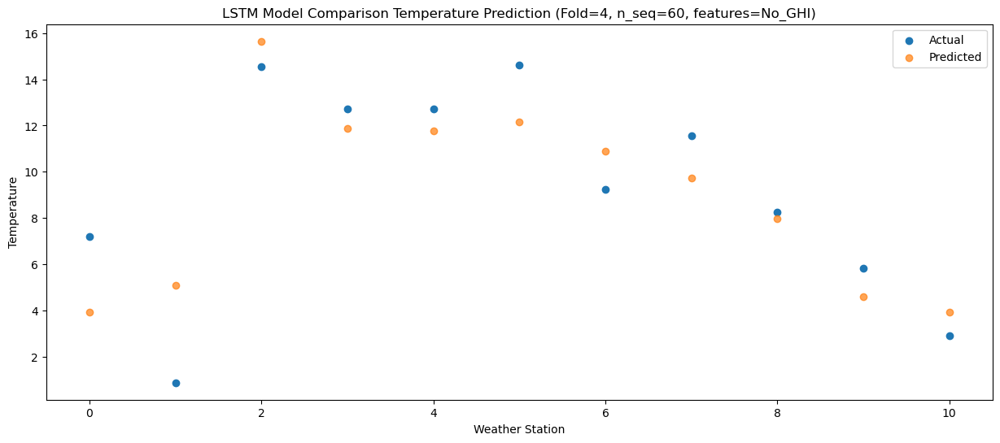

Predictions for (t+54):
    Weather_Station  Actual  Predicted
0                 0   12.20   9.742609
1                 1    6.33  10.917734
2                 2   20.08  21.473142
3                 3   17.49  17.711826
4                 4   17.51  17.582312
5                 5   19.92  17.990714
6                 6   13.29  16.714817
7                 7   16.22  15.553039
8                 8   14.85  13.810627
9                 9   12.84  10.439060
10               10    9.00   9.765990


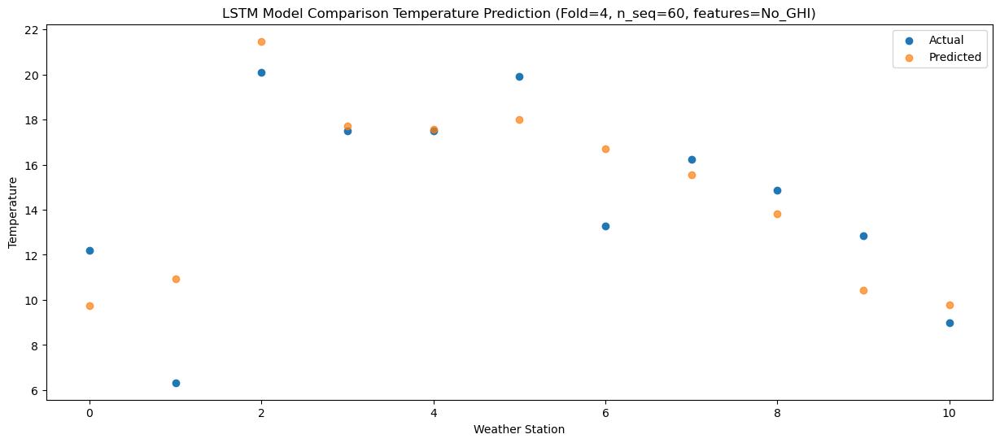

Predictions for (t+55):
    Weather_Station  Actual  Predicted
0                 0   17.39  13.860396
1                 1    6.98  15.024709
2                 2   22.71  25.579079
3                 3   21.52  21.816670
4                 4   21.96  21.689791
5                 5   23.93  22.098719
6                 6   16.71  20.818511
7                 7   19.94  19.657977
8                 8   18.21  17.916004
9                 9   16.81  14.545952
10               10   12.16  13.872818


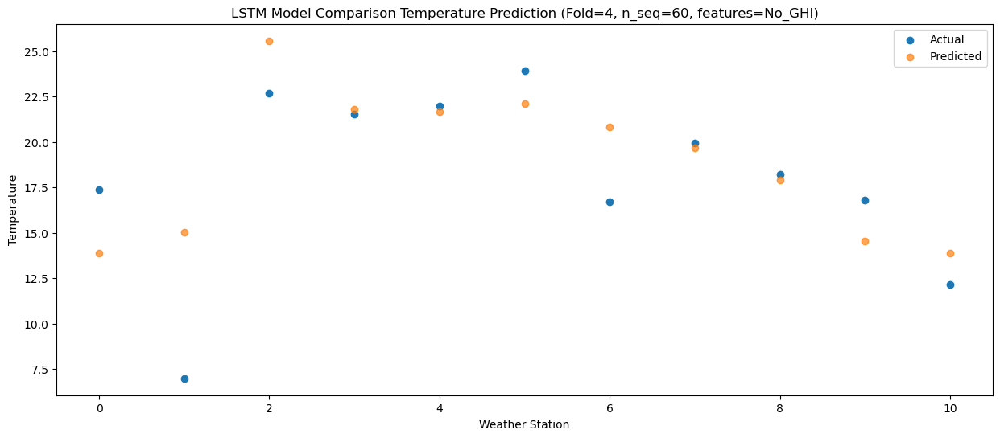

Predictions for (t+56):
    Weather_Station  Actual  Predicted
0                 0   18.15  15.387937
1                 1    7.67  16.541260
2                 2   23.73  27.099774
3                 3   22.42  23.344319
4                 4   22.67  23.220929
5                 5   22.76  23.624700
6                 6   18.17  22.338551
7                 7   20.24  21.180148
8                 8   18.22  19.438874
9                 9   15.84  16.074775
10               10   13.68  15.393560


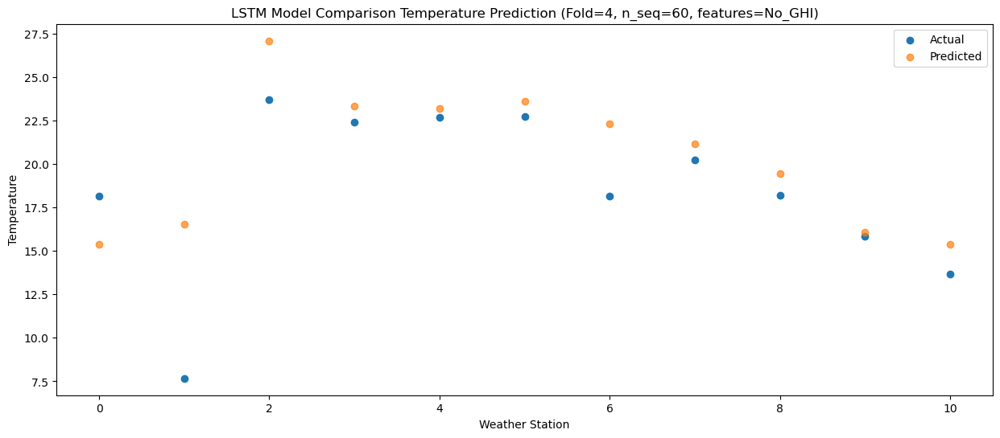

Predictions for (t+57):
    Weather_Station  Actual  Predicted
0                 0   16.66  14.914908
1                 1    7.37  16.072763
2                 2   24.30  26.636043
3                 3   24.17  22.886418
4                 4   24.63  22.765767
5                 5   25.22  23.165062
6                 6   17.01  21.872234
7                 7   20.68  20.716005
8                 8   18.14  18.971995
9                 9   15.50  15.607960
10               10   12.54  14.921203


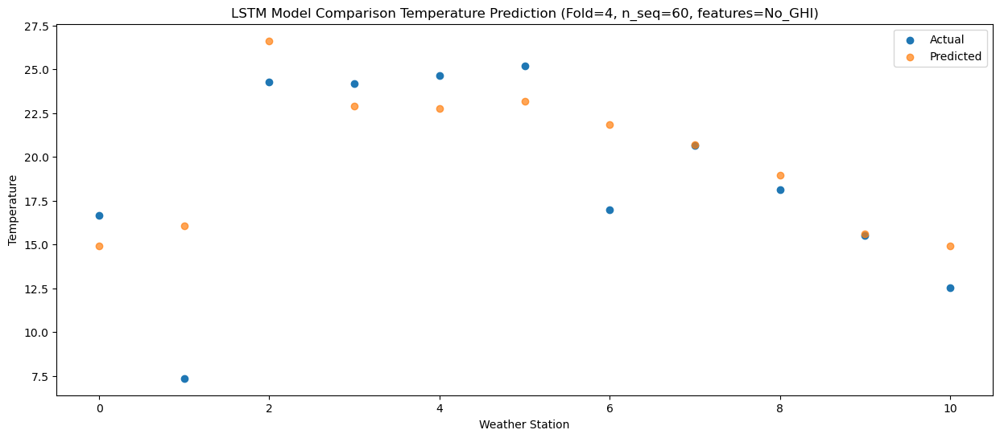

Predictions for (t+58):
    Weather_Station  Actual  Predicted
0                 0   14.23  12.089640
1                 1    6.50  13.246318
2                 2   20.69  23.811733
3                 3   18.78  20.064337
4                 4   18.62  19.945065
5                 5   18.77  20.343354
6                 6   14.57  19.046762
7                 7   16.54  17.893653
8                 8   15.53  16.147898
9                 9   12.27  12.783819
10               10   10.27  12.092201


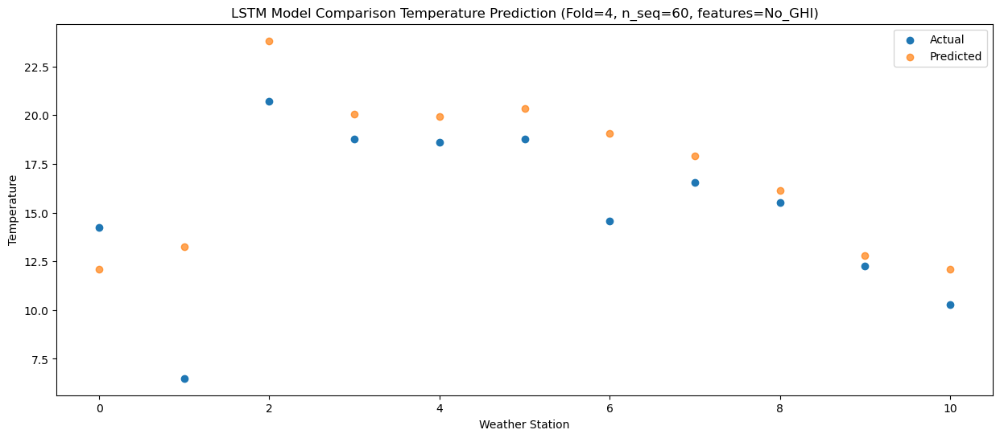

Predictions for (t+59):
    Weather_Station  Actual  Predicted
0                 0   10.10   6.245932
1                 1    2.73   7.395070
2                 2   16.55  17.963844
3                 3   16.03  14.217222
4                 4   16.20  14.101936
5                 5   17.06  14.500496
6                 6    8.95  13.196350
7                 7   12.86  12.045681
8                 8    9.60  10.294984
9                 9    7.20   6.932975
10               10    3.80   6.234449


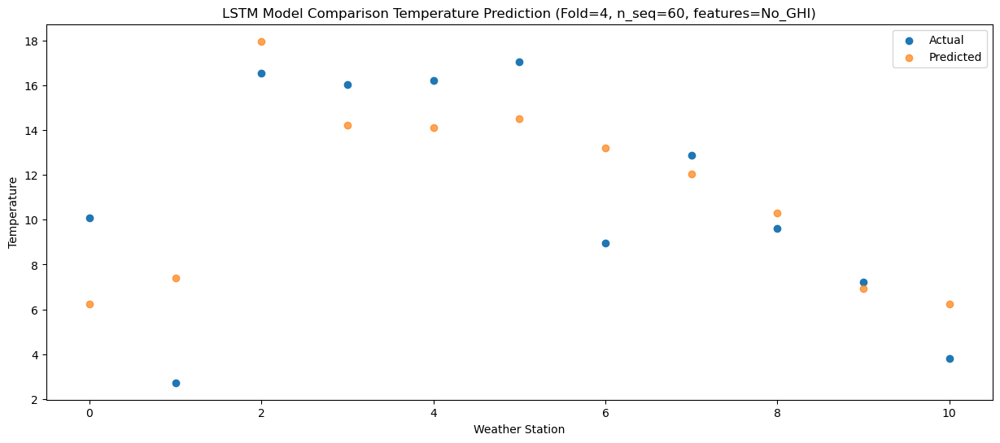

f, t:
[[ -2.86  -2.38   6.75   4.23   3.65   5.12   0.86   2.01  -2.64  -4.88
   -6.79]
 [ -4.52  -2.56   6.81   2.58   1.87   3.48   0.51   1.2   -3.46  -5.2
   -7.57]
 [ -7.48  -4.02   6.62   2.82   2.49   2.75   0.34  -0.45  -4.39  -7.64
   -8.77]
 [ -6.37  -2.47   6.88   2.49   2.11   1.99   0.81   0.12  -5.22  -7.89
   -9.58]
 [  1.16   1.6   14.68   9.95   9.99   9.55   6.42   7.05   1.6   -0.29
   -3.42]
 [  3.59   3.28  13.73  10.61  10.68  12.52   7.69   8.63   4.59   2.82
   -2.04]
 [  8.66   4.68  17.61  15.74  16.33  19.09  10.48  12.73  10.17   8.7
    4.7 ]
 [ 17.91   6.44  21.7   20.7   21.04  22.42  15.07  19.08  17.46  16.43
   11.19]
 [ 18.72   6.76  23.27  22.56  23.48  25.25  18.11  21.62  19.5   17.64
   14.63]
 [ 16.62   6.61  22.44  22.31  22.8   24.63  16.91  19.63  17.3   15.04
   12.22]
 [ 11.78   6.03  20.34  16.53  16.5   16.9   13.11  16.05  13.54  11.14
    8.23]
 [  3.73   4.53  15.    10.8   10.75  12.94   9.29   9.12   6.7    3.8
    2.07]
 [  1.54   1.

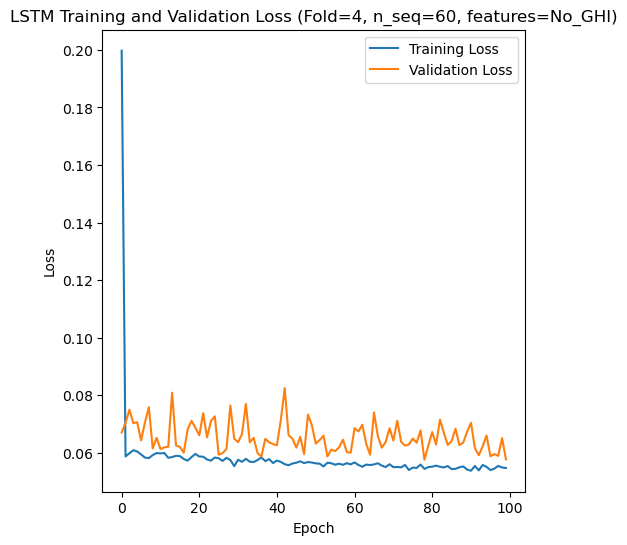

[[2.2966482702536246], [2.9719122407266565], [3.401599734087205], [3.5984660458986757], [2.678676863596338]]
[[array(2.29664827)], [array(2.97191224)], [array(3.40159973)], [array(3.59846605)], [array(2.67867686)]]
[[1.8704537493196423], [2.395772950036959], [2.741700407136571], [2.8091495157516344], [1.9549843564132843]]
[[1.154726927497238], [0.9107488844215809], [1.4052446817133808], [1.8977605617993707], [0.8283122129871927]]
[[0.9152601914798112], [0.8632554411214987], [0.837335347696082], [0.8525438516672109], [0.9134833324490024]]
[[array(-0.56917916)], [array(0.24583371)], [array(-0.08955054)], [array(1.10200853)], [array(0.54019535)]]
[[array(0.93195456)], [array(0.90013383)], [array(0.8752715)], [array(0.85917138)], [array(0.92501256)]]
[-2.98 -3.45 -3.72 ... 12.54 10.27  3.8 ]
[-2.64130827 -3.9866223  -5.09006473 ... 14.9212035  12.09220088
  6.23444903]
Accuracy Results:
RMSE for each fold:
[[2.2966482702536246], [2.9719122407266565], [3.401599734087205], [3.598466045898675

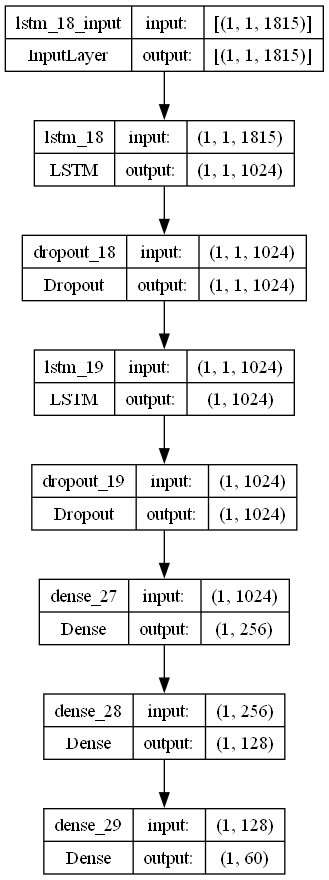

In [5]:
from sklearn.metrics import mean_squared_error, mean_absolute_error, mean_absolute_percentage_error, r2_score
from tensorflow.keras.utils import plot_model

def rmse (y_true, y_pred):
    return K.sqrt(K.mean(K.square(y_pred - y_true)))

def kmape (y_true, y_pred):
    return K.mean(K.sqrt(K.square(y_true - y_pred))/y_true)
    
def kpearson (y_true, y_pred):
    mean_true = K.mean(y_true)
    mean_pred = K.mean(y_pred)
    return (K.square(K.mean((y_true - mean_true)*(y_pred - mean_pred))))/(K.mean(K.square(y_true - mean_true))*K.mean(K.square(y_pred - mean_pred)))

# fit the best LSTM model using parameters found by Optuna
def create_best_model(X, y, n_lag, n_seq, n_batch, nb_epoch):
    
    #Parameters:
    #trial (array-like): Optuna parameters.
    #train (array-like): Target values.
    #n_lag (int): Number of lag observations.
    #n_seq (int): Number of sequence observations
    #nb_epoch (int): Maximum number of epochs
    
    # Hyperparameters from the best model
    lr = 0.049784509261696225
    optimizer = SGD(learning_rate = lr)
    activation_function = 'sigmoid'
    lstm_units = 1024
    dropout_rate = 0.1726097624786438

    # design network
    model = Sequential()
    model.add(LSTM(lstm_units, return_sequences=True, batch_input_shape=(n_batch, X.shape[1], X.shape[2]), stateful=True))
    model.add(Dropout(dropout_rate))
    model.add(LSTM(lstm_units))
    model.add(Dropout(dropout_rate))
    model.add(Dense(256, input_dim=y.shape[1], activation=activation_function))
    model.add(Dense(128, activation=activation_function))
    model.add(Dense(n_seq))
    model.compile(loss=rmse, optimizer=optimizer, metrics=['accuracy', 'mae', rmse, mape, pearson])
        
    return model

# Make one forecast with LSTM
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def forecast_lstm(model, X, n_seq, n_test):
    # reshape input pattern to [samples, timesteps, features]
    X = X.reshape(1, 1, X.shape[1])
    # make forecast
    forecast = model.predict(X)
    # convert to array
    return forecast
     
# Evaluate the persistence model
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def make_forecasts(model, X_test, y_test, n_lag, n_seq, n_test):
    forecasts = list()
    for i in range(len(X_test)):
        X, y = X_test[i, :], y_test[i, :]
        # make forecast
        forecast = forecast_lstm(model, X, n_seq, n_test)
        # store the forecast
        forecasts.append(forecast)
    return forecasts
     
# Invert differenced forecast
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def inverse_difference(last_ob, forecast):
    # Invert the first forecast
    inverted = list()
    inverted.append(forecast[0] + last_ob)
    # Propagate the difference forecast using the inverted first value
    for i in range(1, len(forecast)):
        inverted.append(forecast[i] + inverted[i-1])
    return inverted
     
# Inverse data transform on forecasts
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def inverse_transform(series, forecasts, scaler, n_test, n_seq):
    inverted = list()
    for i in range(len(forecasts)):
        # create an array from the forecast
        forecast = forecasts[i]
        forecast = forecast.reshape(1, n_seq)
        # invert scaling
        inv_scale = scaler.inverse_transform(forecast)
        inv_scale = inv_scale[0, :]
        # invert differencing
        index = len(series) - n_test + i
        last_ob = series.values[index]
        inv_diff = inverse_difference(last_ob, inv_scale)
        # store
        inverted.append(inv_diff)
    return inverted
     
# Evaluate the RMSE for each forecast time step
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def evaluate_forecasts(actual, forecasts, n_lag, n_seq):

    t = np.array(actual).transpose()
    f = np.array(forecasts).transpose()

    print("f, t:")
    print(t)
    print(f)
    rmse_list = []
    mae_list = []
    skmape_list = []
    mape_list = []
    r2_list = []
    pearson_list = []
    actual_list = []

    for i in range(n_seq):
        act = [row for row in t[i]]
        predicted = [forecast for forecast in f[i]]
        rmse1 = sqrt(mean_squared_error(act, predicted))
        rmse2 = np.array(rmse(tf.convert_to_tensor(np.array(act)), tf.convert_to_tensor(np.array(predicted))))
        mae = mean_absolute_error(act, predicted)
        mse = mean_squared_error(act, predicted)
        skmape = mean_absolute_percentage_error(act, predicted)
        kmape1 = np.array(kmape(tf.convert_to_tensor(np.array(act)), tf.convert_to_tensor(np.array(predicted))))
        kpearson1 = np.array(kpearson(tf.convert_to_tensor(np.array(act)), tf.convert_to_tensor(np.array(predicted))))
        r2 = r2_score(act, predicted) 
        avg_actual = np.mean(act)
        print("Year at t+"+str(i+1)+":")
        print('t+%d SKRMSE: %f' % ((i+1), rmse1))
        print('t+%d KRMSE: %f' % ((i+1), rmse2))        
        print('t+%d MAE: %f' % ((i+1), mae))
        print('t+%d SKMAPE: %f' % ((i+1), skmape))
        print('t+%d R2_SCORE: %f' % ((i+1), r2))
        print('t+%d KMAPE: %f' % ((i+1), kmape1))
        print('t+%d PEARSON: %f' % ((i+1), kpearson1))
        print('t+%d AVERAGE ACTUAL: %f' % ((i+1), avg_actual))

    y_true = tf.convert_to_tensor(np.array(actual).flatten())
    y_pred = tf.convert_to_tensor(np.array(forecasts).flatten())

    rmse1 = sqrt(mean_squared_error(np.array(y_true), np.array(y_pred)))
    rmse2 = np.array(rmse(y_true, y_pred))
    mae = mean_absolute_error(np.array(y_true), np.array(y_pred))
    mse = mean_squared_error(np.array(y_true), np.array(y_pred))
    skmape = mean_absolute_percentage_error(np.array(y_true), np.array(y_pred))
    kmape1 = np.array(kmape(y_true, y_pred))
    kpearson1 = np.array(kpearson(y_true, y_pred))
    r2 = r2_score(np.array(y_true), np.array(y_pred)) 
    avg_actual = np.mean(np.array(y_true))
    rmse1_list.append(rmse1)
    rmse2_list.append(rmse2)
    mae_list.append(mae)
    skmape_list.append(skmape)
    pearson_list.append(kpearson1)
    mape_list.append(kmape1)
    r2_list.append(r2)
    actual_list.append(avg_actual)
    print("Metrics for this Fold:")
    print('SKRMSE: %f' % (rmse1))
    print('KRMSE: %f' % (rmse2))        
    print('MAE: %f' % (mae))
    print('SKMAPE: %f' % (skmape))
    print('R2_SCORE: %f' % (r2))
    print('KMAPE: %f' % (kmape1))
    print('PEARSON: %f' % (kpearson1))
    print('AVERAGE ACTUAL: %f' % (avg_actual))

    return rmse1_list, rmse2_list, mae_list, skmape_list, r2_list, mape_list, pearson_list, actual_list
     
# plot the forecasts in the context of the original dataset
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def plot_forecasts(series, forecasts, actual, n_test, n_seq, n_lag):
    # Plot the entire dataset in blue
    plt.plot(series[:n_lag+2+len(forecasts)].values)
    # Plot the forecasts in red
    off_s = n_lag + 1
    off_e = off_s + len(forecasts) + 1
    xaxis = [x for x in range(off_s, off_e)]
    yaxis = [series.values[off_s]] + forecasts
    print(xaxis)
    print(yaxis)
    plt.plot(xaxis, yaxis, color='red')
    plt.xlabel("Month")
    plt.ylabel("Temperature")
    # show the plot
    plt.show()

n_batch = 1
n_test = 11
nb_epoch = 100
    
rmse1_avg_list = []
rmse2_avg_list = []
mae_avg_list = []
skmape_avg_list = []
r2_score_avg_list = []
mape_avg_list = []
pearson_avg_list = []
actual_avg_list = []
forecast_results = []
actual_results = []
    
for i in range(5):
    train1 = train[i]
    test1 = test[i]
    validation1 = validation[i]

    X = train1[:, 0:-n_seq]
    y = train1[:, -n_seq:]
    X_test = test1[:, 0:-n_seq]
    y_test = test1[:, -n_seq:]
    X_val = validation1[:, 0:-n_seq]
    y_val = validation1[:, -n_seq:]
    
    dataset_df = pd.DataFrame(val_y[i])
    dataset_df = dataset_df.iloc[0:10, :]
    dataset = dataset_df.values

    print(dataset)

    series = pd.Series(dataset[:, 0]) # Using first column (temperatures)

    X = X.reshape(X.shape[0], 1, X.shape[1])
    X1 = X_test
    X_test = X_test.reshape(X_test.shape[0], 1, X_test.shape[1])
    X_val = X_val.reshape(X_val.shape[0], 1, X_val.shape[1])

    best_model = create_best_model(X, y, n_lag, n_seq, n_batch, nb_epoch)
    history = best_model.fit(X, y, epochs=100, batch_size=n_batch, validation_data=(X_val, y_val))
    
    # Evaluate the model
    loss = best_model.evaluate(X_test, y_test, verbose=2)
    print(f'Test Loss: {loss}')

    # make forecasts
    forecasts = make_forecasts(best_model, X_test, y_test, n_lag, n_seq, n_test)
    
    # inverse transform forecasts and test
    forecasts = inverse_transform(series, forecasts, scaler[i], n_test, n_seq)
    actual = [row[-n_seq:] for row in test1]
    actual = inverse_transform(series, actual, scaler[i], n_test, n_seq)

    # Print out plots of actual and predicted values for weather stations
    ws = df.index[1:12]
    print(ws)
    a = []
    f = []
    for q in range(len(actual)):
        x = actual[q]
        a.append(x[0])
    for q in range(len(forecasts)):
        x = forecasts[q]
        f.append(x[0])
    print(a)
    print(f)
    # Create a DataFrame for plotting
    results_df = pd.DataFrame({
        'ws': ws,
        'Actual': a,
        'Predicted': f
    })

    print(results_df)
    
    print("Actual and Forecasts:")
    print(actual)
    print(forecasts)
    
    for j in range(11):
        print("Weather Station "+str(j+1)+":")
        print("Actual Temp\tPredicted Temp\tDifference")
        print("-----------\t--------------\t----------")
        for k in range(n_seq):
            diff = forecasts[j][k] - actual[j][k]
            print(f"{actual[j][k]:.2f}\t\t{forecasts[j][k]:.2f}\t\t{diff:.2f}")
    
        # plot forecasts
        dataset_df = pd.DataFrame(val_y[i])
        dataset_df = dataset_df.iloc[0:11, :]
        dataset_df = dataset_df.transpose()
        dataset = dataset_df.values

        series_ws = pd.Series(dataset[:, j]) # Using first column (temperatures)
        forecasts_ws = forecasts[j]
        actual_ws = actual[j]
        
        plot_forecasts(series_ws, forecasts_ws, actual_ws, n_test, n_seq, n_lag)

    for k in range(n_seq):
        print("Predictions for (t+"+str(k)+"):")
        # Print out plots of actual and predicted values for each weather station
        results = []

        # Create a DataFrame for plotting
        for j in range(11):
            results.append([j, actual[j][k], forecasts[j][k]])
               
        results_df = pd.DataFrame(results)
        results_df.columns = ['Weather_Station', 'Actual', 'Predicted']

        print(results_df)

        # Plotting the results
        plt.figure(figsize=(15, 6))
        plt.scatter(results_df['Weather_Station'], results_df['Actual'], label='Actual')
        plt.scatter(results_df['Weather_Station'], results_df['Predicted'], label='Predicted', alpha=0.7)
        title1='LSTM Model Comparison Temperature Prediction (Fold='+str(i)+', n_seq='+str(n_seq)+', features=No_GHI)'
        plt.title(title1)
        plt.xlabel('Weather Station')
        plt.ylabel('Temperature')
        plt.legend()
        plt.show()

    rmse1_list = [] # list stores sklearn's root mean squared errors for each future time prediction
    rmse2_list = [] # list stores root mean squared errors for each future time prediction
    mae_list = [] # list stores mean absolute errors for each future time prediction
    skmape_list = [] # list stores sklearn's mean squared percentage errors for each future time prediction
    r2_list = [] # list stores sklearn's r2 pearson values for each future time prediction
    mape_list = [] # list stores mean squared percentage errors for each future time prediction
    pearson_list = [] # list stores r2 pearson values for each future time prediction
    actual_list = [] # list stores average actual values for each future time prediction

    # evaluate forecasts
    rmse1_list, rmse2_list, mae_list, skmape_list, r2_list, mape_list, pearson_list, actual_list = evaluate_forecasts(actual, forecasts, n_lag, n_seq)

    rmse1_avg_list.append(rmse1_list)
    rmse2_avg_list.append(rmse2_list)
    mae_avg_list.append(mae_list)
    skmape_avg_list.append(skmape_list)
    r2_score_avg_list.append(r2_list)
    mape_avg_list.append(mape_list)
    pearson_avg_list.append(pearson_list)
    actual_avg_list.append(actual_list)
    forecast_results.append(forecasts)
    actual_results.append(actual)
            
    best_model.summary()

    plt.figure(figsize=(12, 6))
    plt.subplot(1, 2, 1)
    plt.plot(history.history['loss'], label='Training Loss')
    plt.plot(history.history['val_loss'], label='Validation Loss')
    title2 = 'LSTM Training and Validation Loss (Fold='+str(i)+', n_seq='+str(n_seq)+', features=No_GHI)'
    plt.title(title2)
    plt.ylabel('Loss')
    plt.xlabel('Epoch')
    plt.legend(loc='upper right')
    plt.show()

print(rmse1_avg_list)
print(rmse2_avg_list)
print(mae_avg_list)
print(skmape_avg_list)
print(r2_score_avg_list)
print(mape_avg_list)
print(pearson_avg_list)
print(np.array(actual_results).flatten())
print(np.array(forecast_results).flatten())
a2 = np.array(actual_results).flatten()
f2 = np.array(forecast_results).flatten()
p1 = np.array(pearson(tf.convert_to_tensor(a2), tf.convert_to_tensor(f2)))
print("Accuracy Results:")
print("RMSE for each fold:")
print(rmse1_avg_list)
print("Average SKRMSE:"+str(np.mean(rmse1_avg_list)))
print("Average KRMSE:"+str(np.mean(rmse2_avg_list)))
print("Average MAE:"+str(np.mean(mae_avg_list)))
print("Average SKMAPE:"+str(np.mean(skmape_avg_list)))
print("Average MAPE:"+str(np.mean(mape_avg_list)))
print("Average PEARSON:"+str(p1))
print("Average R2 Score:"+str(np.mean(r2_score_avg_list)))

# Plot model architecture
filename = "lstm_model_optimized_CV_S60_No_GHI.png"
plot_model(best_model, to_file=filename, show_shapes=True, show_layer_names=True)